## Analyze March 2022 Shearwater Cruise Data

In [1]:
import xarray as xr
import numpy as np

import hvplot.xarray


import cartopy.crs as crs

import pandas as pd
import geopandas as gpd

import glob
import hvplot.pandas  # noqa
from datetime import timedelta
from datetime import datetime
import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler

from sklearn.decomposition import PCA

In [2]:
nav_df = pd.read_csv('data/march_cruise/SW22004R_NRL02/Navigation/SW-GGA_20220308-223656.Raw',  names=['Date', 'Time', 'GPGGA','Unknown', 'SW-GGA-Lat', 'latdir', 'SW-GGA-Long', 'londir', '1', '2', '3', '4', '5', '6', '7'])

def dms2dd(degrees, minutes, seconds, direction):
    dd = degrees + minutes/60 + seconds/(60*60);
    if direction == 'W' or direction == 'S':
        dd *= -1
    return dd;

nav_df['lon'] = dms2dd(pd.to_numeric(nav_df['SW-GGA-Long'].astype(str).str[:2]).astype(float), pd.to_numeric(nav_df['SW-GGA-Long'].astype(str).str[2:]),np.array(0), 'W')
nav_df['lat'] = dms2dd(pd.to_numeric(nav_df['SW-GGA-Lat'].astype(str).str[:2]).astype(float), pd.to_numeric(nav_df['SW-GGA-Lat'].astype(str).str[2:]),np.array(0), 'E')

date_time_strs = nav_df['Date'] + ' ' + nav_df['Time']

nav_df['datetime'] = [datetime.strptime(x, '%m/%d/%Y %H:%M:%S.%f') for x in date_time_strs]
nav_df['utc_dt'] = nav_df['datetime']
nav_df  = nav_df.set_index('utc_dt')


tsg_df = pd.read_csv('data/march_cruise/SW22004R_NRL02/FlowThru/TSG-_20220308-223656.Raw', names=['DateTime', 'Temp','Sal','Unknown'], delim_whitespace=True)#sep=r"s*")# names=['Date', 'Time', 'Data'])
tsg_df['datetime'] = [datetime.strptime(x[:-1], '%m/%d/%Y,%H:%M:%S.%f') for x in tsg_df.DateTime]

chla_df = pd.read_csv('data/march_cruise/SW22004R_NRL02/FlowThru/FluorometerWETStar-Chlorophyll-DRV_20220308-223656.Raw', 
                      index_col=False,
                      names=['Date','Time','VarName','Chla','Volts'], sep=",")

chla_df['datetime'] = [datetime.strptime(x[:-1], '%m/%d/%Y%H:%M:%S.%f') for x in chla_df.Date+chla_df.Time]
chla_df['utc_dt'] = chla_df['datetime']
chla_df  = chla_df.set_index('utc_dt')

lats = []
lons = []
chla = []
for i in range(len(tsg_df)):
    row = nav_df.iloc[nav_df.index.get_loc(tsg_df.iloc[i].datetime, method='nearest')]
    lats.append(row.lat)
    lons.append(row.lon)
    row = chla_df.iloc[chla_df.index.get_loc(tsg_df.iloc[i].datetime, method='nearest')]
    chla.append(row.Chla)
    
tsg_df['lat'] = lats
tsg_df['lon'] = lons
tsg_df['chla'] = chla

tsg_df['utc_dt'] = tsg_df['datetime']
tsg_df  = tsg_df.set_index('utc_dt')

tsg_df = tsg_df.sort_index(ascending=True)

In [3]:
tsg_df.head()

,DateTime,Temp,Sal,Unknown,datetime,lat,lon,chla
utc_dt,,,,,,,,
2022-03-09 00:36:05.508,"03/09/2022,00:36:05.508,",16.2645,36.1202,1512.70,2022-03-09 00:36:05.508,34.544948,-76.605212,1.07
2022-03-09 00:36:15.445,"03/09/2022,00:36:15.445,",16.2730,36.1207,1512.73,2022-03-09 00:36:15.445,34.544650,-76.604837,1.07
2022-03-09 00:36:25.440,"03/09/2022,00:36:25.440,",16.2819,36.1212,1512.76,2022-03-09 00:36:25.440,34.544407,-76.604545,1.07
2022-03-09 00:36:35.463,"03/09/2022,00:36:35.463,",16.2967,36.1226,1512.80,2022-03-09 00:36:35.463,34.544113,-76.604195,1.07
2022-03-09 00:36:45.437,"03/09/2022,00:36:45.437,",16.3054,36.1229,1512.83,2022-03-09 00:36:45.437,34.543843,-76.603883,1.02


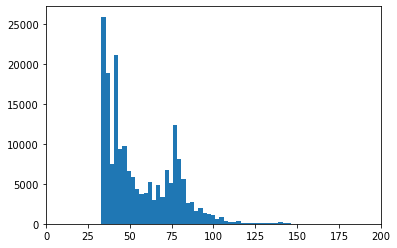

In [4]:

plt.hist(chla_df.Volts,bins=300)
plt.xlim(0,200)
plt.show()

(0.0, 3.0)

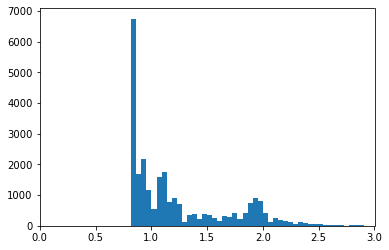

In [5]:
plt.hist(tsg_df.chla,bins=300)
plt.xlim(0,3)

In [6]:
len(tsg_df)

26518

<AxesSubplot:>

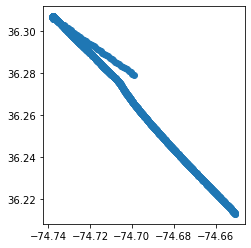

In [7]:
gdf = gpd.GeoDataFrame(
    tsg_df, geometry=gpd.points_from_xy(tsg_df.lon, tsg_df.lat))
gdf.loc['2022-03-10 13:00:00':'2022-03-10 15:45:00'].plot()

In [8]:
tsg_df.hvplot.points('lon', 'lat', geo=True, c='chla', alpha=1,tiles='EsriNatGeo')

:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [lon,lat]   (chla)

#### pull in the SST data from GOES

In [226]:
goes_ds = xr.open_dataset('data/march_cruise/jplStarG16SSTv270_114c_3593_e68a.nc')

/srv/conda/envs/notebook/lib/python3.8/site-packages/xarray/conventions.py:492: SerializationWarning: variable 'sea_surface_temperature' has multiple fill values {-327.67, -327.68}, decoding all values to NaN.
  new_vars[k] = decode_cf_variable(


In [247]:
goes_ds

<xarray.Dataset>
Dimensions:                  (latitude: 401, longitude: 551, time: 239)
Coordinates:
  * time                     (time) object 2022-03-04 13:00:00 ... 2022-03-14...
  * latitude                 (latitude) float32 38.01 37.99 ... 30.03 30.01
  * longitude                (longitude) float32 -82.99 -82.97 ... -72.01 -71.99
Data variables:
    sea_surface_temperature  (time, latitude, longitude) float32 ...
Attributes:
    acknowledgement:            Please acknowledge the use of these data with...
    cdm_data_type:              Grid
    col_count:                  5920
    col_start:                  2290
    comment:                    SSTs are a weighted average of the SSTs of co...
    Conventions:                CF-1.7, COARDS, ACDD-1.3
    creator_email:              Alex.Ignatov@noaa.gov
    creator_name:               Alex Ignatov
    creator_type:               person
    creator_url:                http://www.star.nesdis.noaa.gov
    date_created:               2019-05-02T23:19:39Z
    Easternmost_Easting:        -71.990005
    gds_version_id:             02.0
    geospatial_lat_max:         38.010002
    geospatial_lat_min:         30.010002
    geospatial_lat_resolution:  0.02
    geospatial_lat_units:       degrees_north
    geospatial_lon_max:         -71.990005
    geospatial_lon_min:         -82.990005
    geospatial_lon_resolution:  0.02
    geospatial_lon_units:       degrees_east
    history:                    Created by the L2P-to-L3U conversion tool,  w...
    id:                         ABI_G16-STAR-L3C-v2.7
    infoUrl:                    https://podaac.jpl.nasa.gov/dataset/ABI_G16-S...
    institution:                NOAA/NESDIS/STAR
    keywords:                   abi, angle, atmosphere, atmospheric, bias, co...
    keywords_vocabulary:        GCMD Science Keywords
    license:                    GHRSST protocol describes data use as free an...
    metadata_link:              <TBD>
    naming_authority:           org.ghrsst
    Northernmost_Northing:      38.010002
    platform:                   GOES-16
    processing_level:           L3U
    product_version:            L2P algorithm V2.70; L3U algorithm V4.1.5
    project:                    Group for High Resolution Sea Surface Tempera...
    publisher_email:            ghrsst-po@nceo.ac.uk
    publisher_name:             The GHRSST Project Office
    publisher_type:             group
    publisher_url:              https://www.ghrsst.org
    references:                 Data convention: GHRSST Data Specification (G...
    row_count:                  5920
    row_start:                  1540
    sensor:                     ABI
    source:                     l2p_source : 20171218030000-STAR-L2P_GHRSST-S...
    sourceUrl:                  https://thredds.jpl.nasa.gov/thredds/dodsC/Oc...
    Southernmost_Northing:      30.010002
    spatial_resolution:         0.02 deg
    sst_luts:                   LUT_ABI_G16_L2C_DEPTH_DAYNIGHT_V01.06_2019042...
    standard_name_vocabulary:   CF Standard Name Table v70
    Sub_Lon:                    -75.0
    summary:                    Sea surface temperature retrievals produced b...
    testOutOfDate:              now-1day
    time_coverage_end:          2022-03-14T13:00:00Z
    time_coverage_start:        2022-03-04T13:00:00Z
    title:                      GOES-16 ABI L3C SST (ABI G16-STAR-L3C-v2.70),...
    Westernmost_Easting:        -82.990005

In [231]:
goes_ds.sea_surface_temperature.hvplot.quadmesh(
    'longitude', 'latitude', projection=crs.PlateCarree(), project=True,
    cmap='inferno', dynamic=True, 
    frame_height=600, clim=(15, 24), rasterize=True, coastline=True)

:DynamicMap   [time]
   :Overlay
      .Image.I     :Image   [longitude,latitude]   (sea_surface_temperature)
      .Coastline.I :Feature   [Longitude,Latitude]

In [ ]:
ax.set_xlim(-77.5,-72.5)
ax.set_ylim(33,38)

In [3]:
coord_ds = xr.open_dataset('data/march_cruise/goesl2p/G16_075_0_W.nc')

In [308]:
# goesl2_sst_ds = xr.open_dataset('data/march_cruise/goesl2p/20220311150000-STAR-L2P_GHRSST-SSTsubskin-ABI_G16-ACSPO_V2.70-v02.0-fv01.0.nc')#.sel(lat=slice(33,38),lon=slice(-77.5,-72.5))
# goesl2_sst_ds

In [258]:
goesl2_sst_ds = goesl2_sst_ds.set_coords(("lat", "lon"))
# goesl2_sst_ds = goesl2_sst_ds.set_index(index=("lat", "lon"))

In [309]:
# ! pip install goes2go

In [268]:
from goes2go import GOES

 ╭─────────────────────────────────────────────────╮
 │ I'm building goes2go's default config file.     │
 ╰╥────────────────────────────────────────────────╯
 👷🏻‍♂️
⚙ Created config file [/home/jovyan/.config/goes2go/config.toml] with default values.


In [285]:
# ABI Level 1b Data
G = GOES(satellite=16, product="ABI-L1b-Rad", domain='F', bands=[13])

In [338]:
# Download data for a specified time range
ds = G.timerange(start='2022-03-11 14:00', end='2022-03-11 15:00')

ERROR! Session/line number was not unique in database. History logging moved to new session 1065
📦 Finished downloading [6] files to [/home/jovyan/data/noaa-goes16/ABI-L1b-RadF].


In [300]:
ds.file[0]

'noaa-goes16/ABI-L1b-RadF/2022/070/14/OR_ABI-L1b-RadF-M6C13_G16_s20220701400206_e20220701409525_c20220701409595.nc'

In [306]:
'/home/jovyan/data/'+ds.file[0]

'/home/jovyan/data/noaa-goes16/ABI-L1b-RadF/2022/070/14/OR_ABI-L1b-RadF-M6C13_G16_s20220701400206_e20220701409525_c20220701409595.nc'

In [2]:
l1_band13_ds = xr.open_dataset('/home/jovyan/data/noaa-goes16/ABI-L1b-RadF/2022/070/14/OR_ABI-L1b-RadF-M6C13_G16_s20220701400206_e20220701409525_c20220701409595.nc')

In [4]:
l1_band13_ds['lat'] = coord_ds['lat']

In [5]:
l1_band13_ds['lon'] = coord_ds['lon']

In [6]:
l1_band13_ds = l1_band13_ds.set_coords(("lat", "lon"))

In [7]:
l1_band13_ds.lat.values

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)

In [12]:
import numpy.ma as ma
Zm = ma.masked_invalid(l1_band13_ds.Rad.values)

Zy = ma.masked_invalid(l1_band13_ds.lat.values[:,0])

Zx = ma.masked_invalid(l1_band13_ds.lon.values[0,:])

In [9]:
Zm

masked_array(
  data=[[--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --],
        ...,
        [--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --]],
  mask=[[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]],
  fill_value=1e+20,
  dtype=float32)

In [13]:
Zx

masked_array(data=[--, --, --, ..., --, --, --],
             mask=[ True,  True,  True, ...,  True,  True,  True],
       fill_value=1e+20,
            dtype=float32)

In [11]:
l1_band13_ds.lat.values[:,0]

array([nan, nan, nan, ..., nan, nan, nan], dtype=float32)

ValueError: x and y arguments to pcolormesh cannot have non-finite values or be of type numpy.ma.core.MaskedArray with masked values

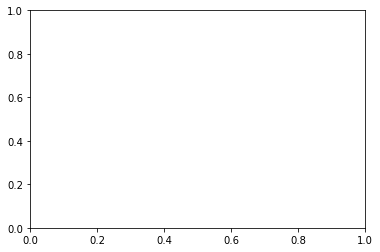

In [14]:
import numpy.ma as ma
Zm = ma.masked_invalid(l1_band13_ds.Rad.values)

plt.pcolormesh(Zx,Zy, Zm.T)

📦 Finished downloading [1] files to [/home/jovyan/data/noaa-goes16/ABI-L2-MCMIPC].
📚 Finished reading [1] files into xarray.Dataset.                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    

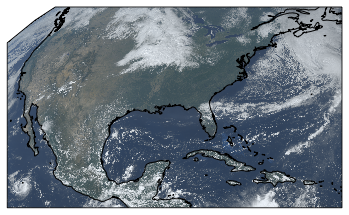

In [333]:
import matplotlib.pyplot as plt
ds = GOES().
ax = plt.subplot(projection=ds.rgb.crs)
ax.imshow(ds.rgb.TrueColor(), **ds.rgb.imshow_kwargs)
ax.coastlines()

In [ ]:
ax = plt.subplot(projection=ds.rgb.crs)
ax.imshow(ds.rgb.TrueColor(), **ds.rgb.imshow_kwargs)
ax.coastlines()

In [322]:
l1_band13_ds.Rad

<xarray.DataArray 'Rad' (y: 5424, x: 5424)>
[29419776 values with dtype=float32]
Coordinates:
    t        datetime64[ns] 2022-03-11T14:05:06.615970048
  * y        (y) float32 0.1518 0.1518 0.1517 0.1517 ... -0.1517 -0.1518 -0.1518
  * x        (x) float32 -0.1518 -0.1518 -0.1517 ... 0.1517 0.1518 0.1518
    y_image  float32 0.0
    x_image  float32 0.0
Attributes:
    long_name:              ABI L1b Radiances
    standard_name:          toa_outgoing_radiance_per_unit_wavenumber
    sensor_band_bit_depth:  12
    valid_range:            [   0 4094]
    units:                  mW m-2 sr-1 (cm-1)-1
    resolution:             y: 0.000056 rad x: 0.000056 rad
    grid_mapping:           goes_imager_projection
    cell_methods:           t: point area: point
    ancillary_variables:    DQF

In [326]:
l1_band13_ds.Rad.hvplot.quadmesh(
    'x', 'y',
    cmap='inferno', dynamic=True, 
    frame_height=600,    frame_width=600, rasterize=True)

:DynamicMap   []
   :Image   [x,y]   (Rad)

In [318]:
l1_band13_ds.Rad.hvplot.quadmesh(
    'lon', 'lat', projection=crs.PlateCarree(), project=True,
    cmap='inferno', dynamic=True, 
    frame_height=600, rasterize=True, 
    coastline=True, xlim=(-77.5,-72.5), ylim=(33,38))

DataError: xarray Dataset must define coordinates for all defined kdims, [Dimension('lon'), Dimension('lat')] coordinates not found.

XArrayInterface expects gridded data, for more information on supported datatypes see http://holoviews.org/user_guide/Gridded_Datasets.html

In [315]:
goesl2_sst_ds

<xarray.Dataset>
Dimensions:                       (ni: 5424, nj: 5424, time: 1)
Coordinates:
  * time                          (time) object 2022-03-11 15:00:00
  * nj                            (nj) float32 0.1518 0.1518 ... -0.1518 -0.1518
  * ni                            (ni) float32 -0.1518 -0.1518 ... 0.1518 0.1518
    lat                           (nj, ni) float32 nan nan nan ... nan nan nan
    lon                           (nj, ni) float32 ...
Data variables:
    sst_dtime                     (time, nj, ni) timedelta64[ns] ...
    satellite_zenith_angle        (time, nj, ni) float32 ...
    sea_surface_temperature       (time, nj, ni) float32 ...
    brightness_temperature_08um6  (time, nj, ni) float32 ...
    brightness_temperature_10um4  (time, nj, ni) float32 ...
    brightness_temperature_11um2  (time, nj, ni) float32 ...
    brightness_temperature_12um3  (time, nj, ni) float32 ...
    sses_bias                     (time, nj, ni) float32 ...
    sses_standard_deviation       (time, nj, ni) float32 ...
    dt_analysis                   (time, nj, ni) float32 ...
    wind_speed                    (time, nj, ni) float32 ...
    sea_ice_fraction              (time, nj, ni) float32 ...
    l2p_flags                     (time, nj, ni) int16 ...
    quality_level                 (time, nj, ni) float32 ...
    geostationary                 int32 -2147483647
Attributes:
    CFAC:                       20425339
    COFF:                       2712.4998
    Coefficient_for_Sd:         1737135756.914831
    Dist_Virt_Sat:              42164.16
    Earth_Radius_Equator:       6378.137
    Earth_Radius_Polar:         6356.752314140001
    LFAC:                       20425339
    LOFF:                       2712.4998
    Nadir_latitude:             0.0
    Nadir_longitude:            -75.0
    Req2_info:                  1.0067394967755916
    Req_info:                   0.00669438002301188
    Rpol_info:                  0.9933056199769882
    SSP_latitude:               0.0
    SSP_longitude:              -75.19999694824219
    Sub_Lon:                    -75.0
    Sun_Pos:                    [0. 0. 0.]
    destripe:                   no
    easternmost_longitude:      6.1988506
    northernmost_latitude:      81.14685
    southernmost_latitude:      -81.14883
    westernmost_longitude:      -156.19511
    Conventions:                CF-1.7
    Metadata_Conventions:       Unidata Dataset Discovery v1.0
    acknowledgment:             Please acknowledge the use of these data with...
    cdm_data_type:              swath
    comment:                    This file contains sea surface temperature da...
    creator_email:              Alex.Ignatov@noaa.gov
    creator_name:               Alex Ignatov
    creator_url:                http://www.star.nesdis.noaa.gov
    gds_version_id:             02.0
    geospatial_lat_units:       degrees_north
    geospatial_lon_units:       degrees_east
    institution:                NOAA/NESDIS/STAR
    keywords:                   Oceans > Ocean Temperature > Sea Surface Temp...
    keywords_vocabulary:        NASA Global Change Master Directory (GCMD) Sc...
    license:                    GHRSST protocol describes data use as free an...
    naming_authority:           org.ghrsst
    netcdf_version_id:          4.6.3 of Apr  2 2019 11:58:26 $
    processing_level:           L2P
    project:                    Group for High Resolution Sea Surface Tempera...
    publisher_email:            ghrsst-po@nceo.ac.uk
    publisher_name:             The GHRSST Project Office
    publisher_url:              http://www.ghrsst.org
    standard_name_vocabulary:   CF Standard Name Table (v26, 08 November 2013)
    history:                    Created by Advanced Clear-Sky Processor for O...
    id:                         ABI_G16-STAR-L2P-v2.7
    metadata_link:              https://podaac.jpl.nasa.gov/ws/metadata/datas...
    platform:                   GOES-16
    references:                 Data conventio

ValueError: x and y arguments to pcolormesh cannot have non-finite values or be of type numpy.ma.core.MaskedArray with masked values

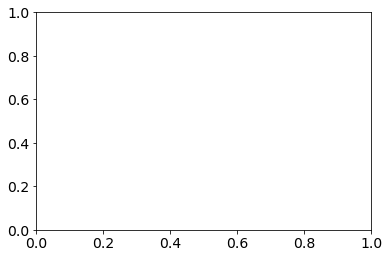

In [261]:
fig,ax=plt.subplots()
goesl2_sst_ds.sea_surface_temperature.plot(x='lon',y='lat',ax=ax)

# ax.set_xlim(-77.5,-72.5)
# ax.set_ylim(33,38)

In [236]:
mur_sst_ds = xr.open_dataset('data/march_cruise/20220311090000-JPL-L4_GHRSST-SSTfnd-MUR-GLOB-v02.0-fv04.1.nc').sel(lat=slice(33,38),lon=slice(-77.5,-72.5))

In [241]:
mur_sst_ds.analysed_sst.hvplot.quadmesh(
    'lon', 'lat', projection=crs.PlateCarree(), project=True,
    cmap='inferno', dynamic=True, 
    frame_height=600, clim=(5+273, 24+273), rasterize=True, coastline=True)

:DynamicMap   [time]
   :Overlay
      .Image.I     :Image   [lon,lat]   (analysed_sst)
      .Coastline.I :Feature   [Longitude,Latitude]

#### Pull in the TriOS radiometer data

In [376]:
del trios_lt
del trios_lsky
del trios_ed


In [407]:
trios_lt = pd.read_csv('data/march_cruise/TriOS/lt_trios_march_2022.csv')
trios_lsky = pd.read_csv('data/march_cruise/TriOS/lsky_trios_march_2022.csv')
trios_ed = pd.read_csv('data/march_cruise/TriOS/ed_trios_march_2022.csv')

In [453]:
df_subset

,TimeStamp,320,321,322,323,324,325,326,327,328,...,942,943,944,945,946,947,948,949,950,datetime
utc_dt,,,,,,,,,,,,,,,,,,,,,
2022-03-11 14:03:00,03/11/2022 10:03:00,-0.000170,-0.000087,-0.000003,0.000081,0.000109,0.000133,0.000156,0.000184,0.000214,...,0.002278,0.002640,0.003003,0.003365,0.003731,0.004098,0.004464,0.004183,0.003518,2022-03-11 14:03:00
2022-03-11 14:03:20,03/11/2022 10:03:20,1.689899,1.820246,1.950594,2.080941,2.209783,2.338490,2.467197,2.571291,2.659917,...,0.554350,0.556078,0.557807,0.559535,0.561431,0.563351,0.565270,0.565413,0.564508,2022-03-11 14:03:20
2022-03-11 14:03:40,03/11/2022 10:03:40,1.685675,1.816262,1.946849,2.077435,2.204123,2.330464,2.456804,2.559434,2.647162,...,0.392376,0.396858,0.401340,0.405822,0.408502,0.410937,0.413373,0.419995,0.429093,2022-03-11 14:03:40
2022-03-11 14:03:50,03/11/2022 10:03:50,1.992830,2.148239,2.303648,2.459057,2.609268,2.759015,2.908762,3.029177,3.131157,...,0.366767,0.370807,0.374847,0.378887,0.389726,0.401490,0.413254,0.423374,0.432522,2022-03-11 14:03:50
2022-03-11 14:04:00,03/11/2022 10:04:00,1.773631,1.911267,2.048902,2.186537,2.320142,2.453388,2.586633,2.694751,2.787076,...,0.444441,0.444270,0.444099,0.443929,0.450864,0.458766,0.466667,0.474556,0.482437,2022-03-11 14:04:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-11 14:35:10,03/11/2022 10:35:10,2.310611,2.484822,2.659033,2.833244,3.003806,3.174042,3.344278,3.482061,3.599447,...,0.833978,0.829346,0.824715,0.820084,0.834751,0.852043,0.869334,0.872440,0.867159,2022-03-11 14:35:10
2022-03-11 14:35:20,03/11/2022 10:35:20,2.335492,2.511530,2.687568,2.863605,3.037846,3.211927,3.386008,3.525661,3.643678,...,0.680469,0.669484,0.658498,0.647513,0.655588,0.666255,0.676922,0.688591,0.700852,2022-03-11 14:35:20
2022-03-11 14:35:30,03/11/2022 10:35:30,2.031096,2.185901,2.340705,2.495510,2.643742,2.791388,2.939033,3.058800,3.161046,...,0.542159,0.543590,0.545022,0.546454,0.558072,0.571075,0.584079,0.590605,0.593301,2022-03-11 14:35:30


no rows
no rows
no rows
no rows
no rows
no rows
no rows
no rows
no rows
no rows
no rows
no rows
------


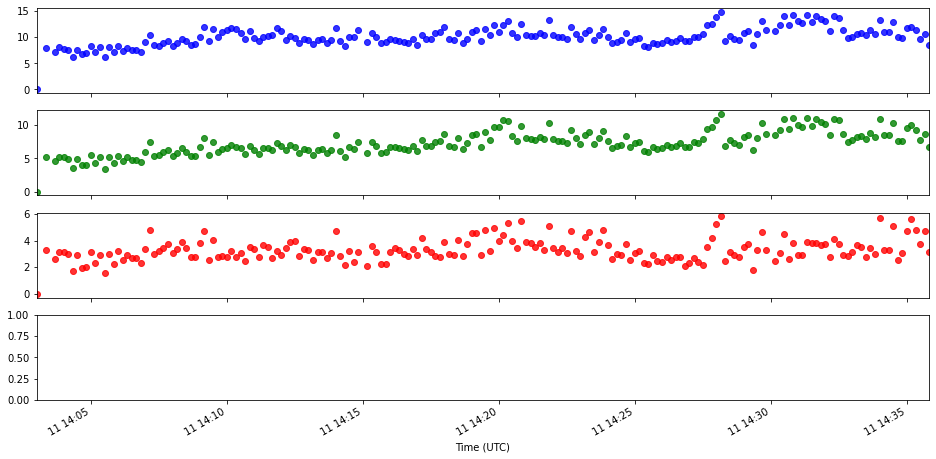

------


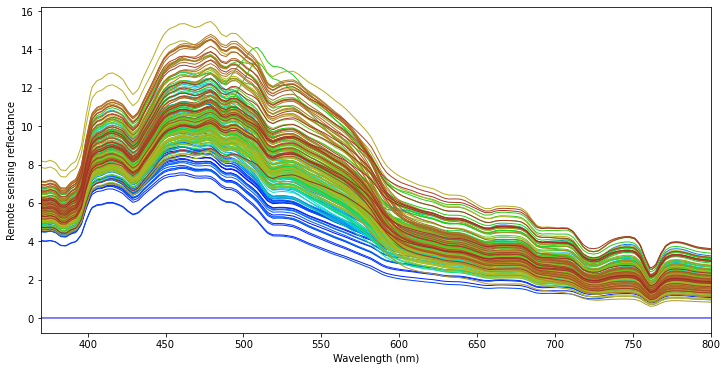

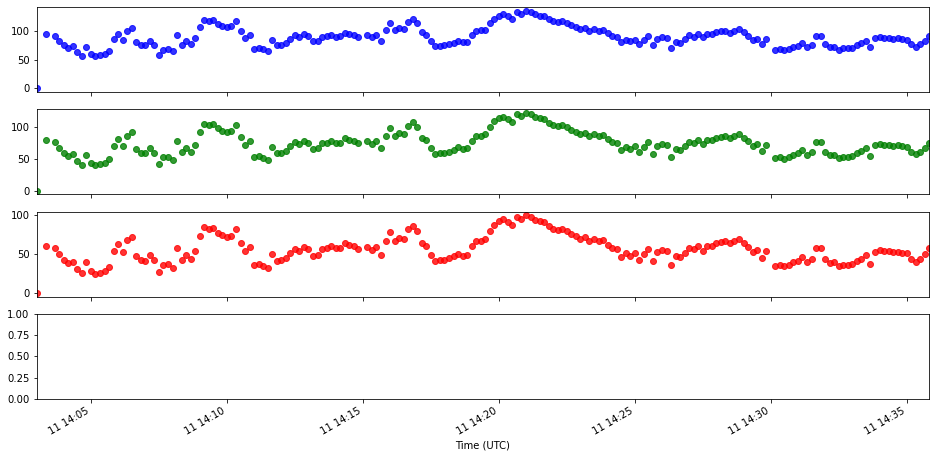

------


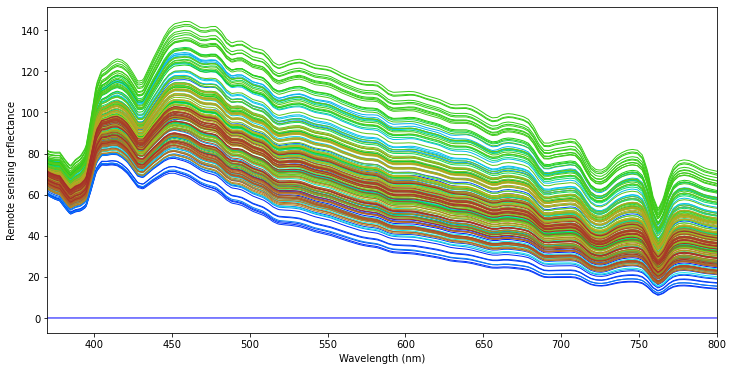

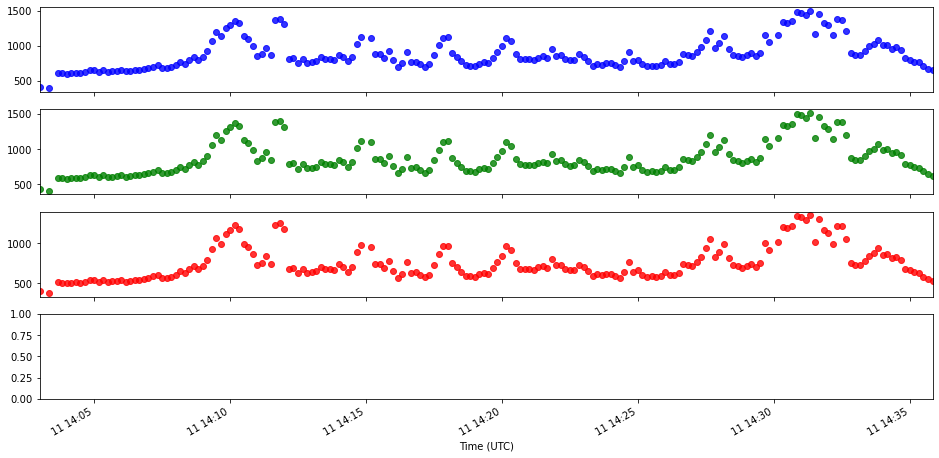

------


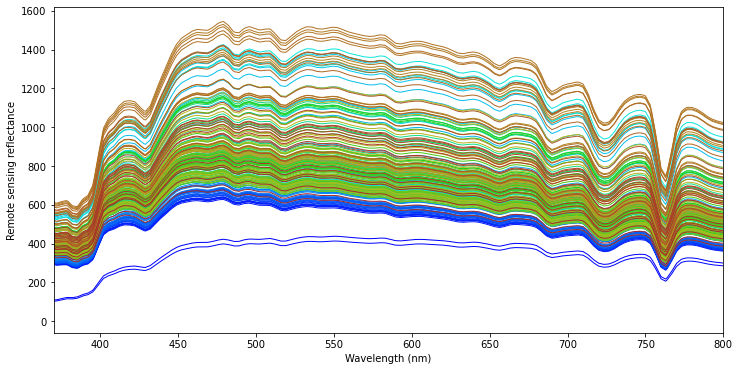

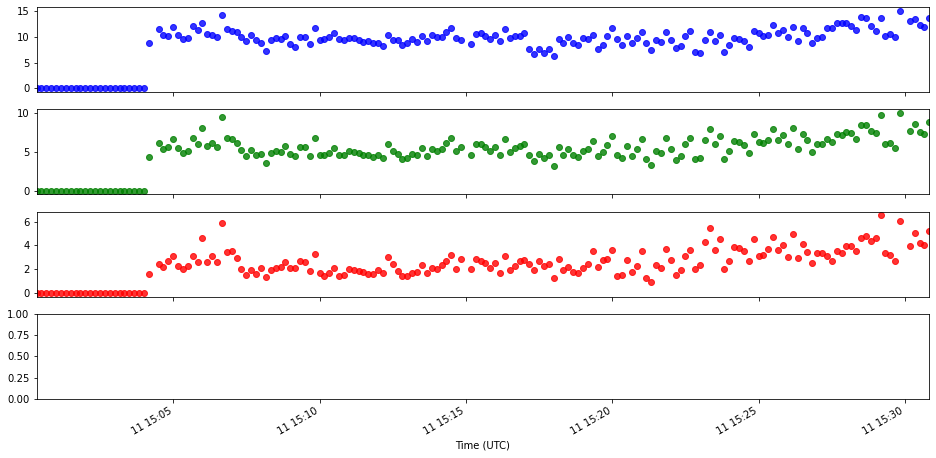

------


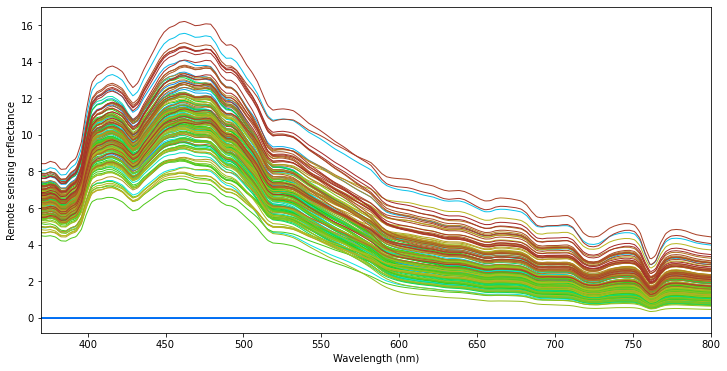

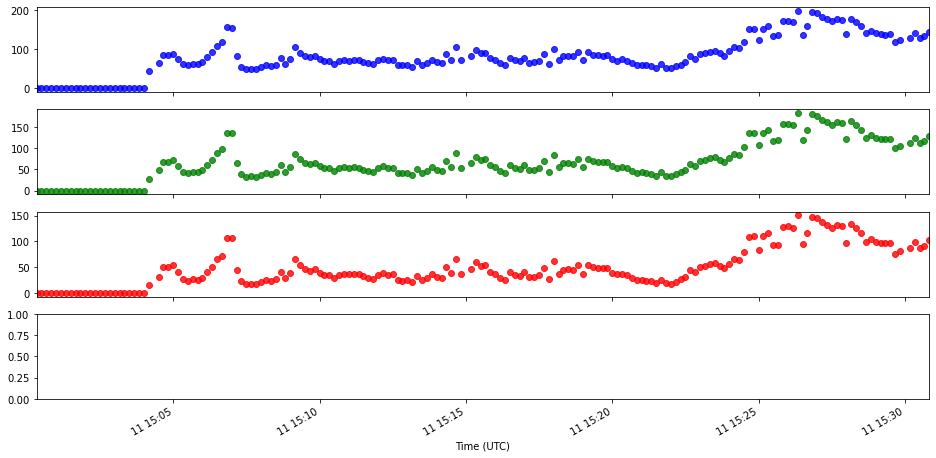

------


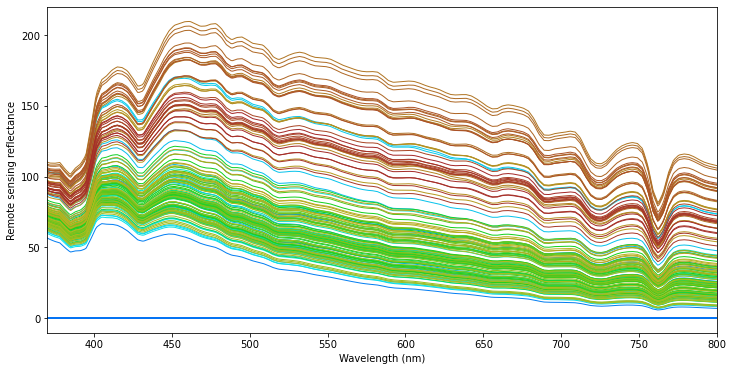

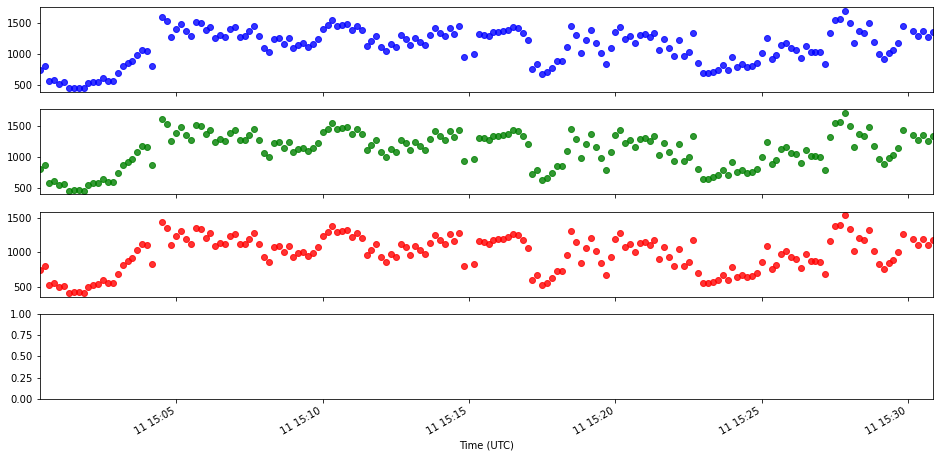

------


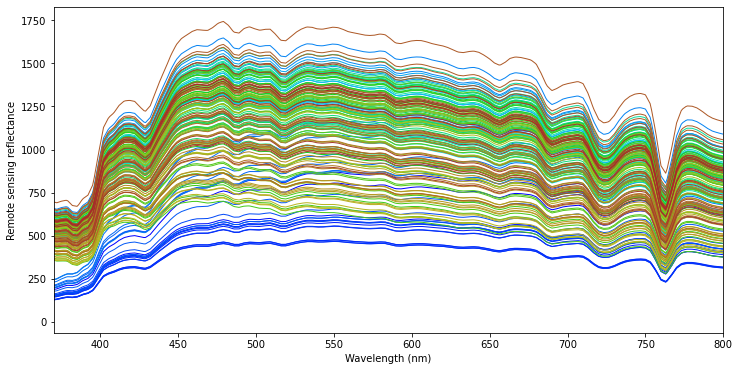

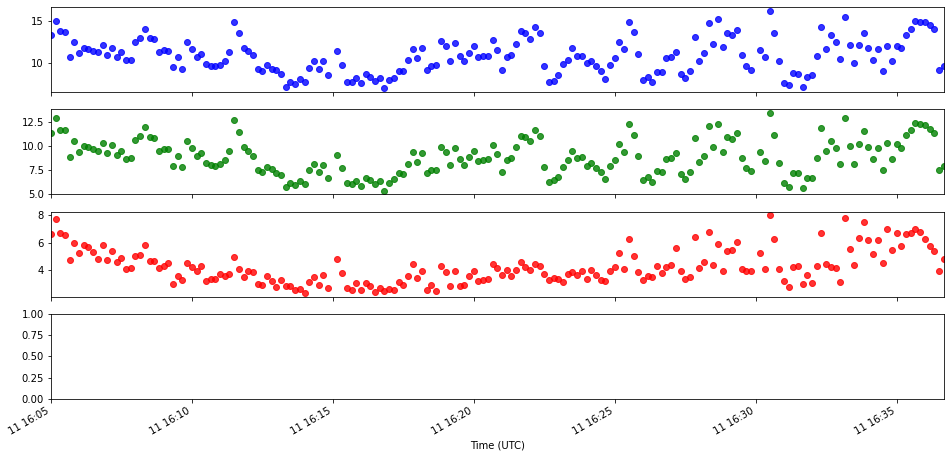

------


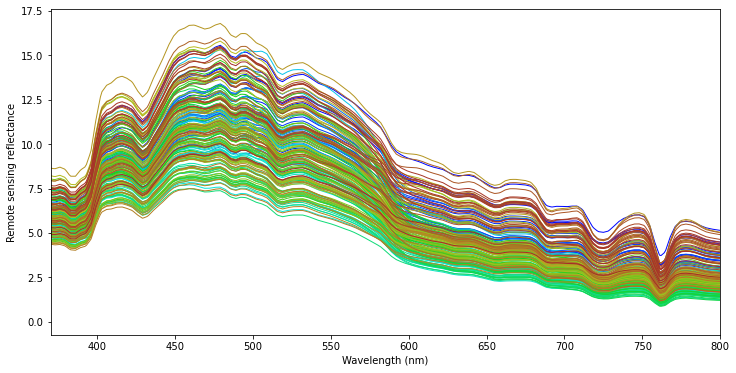

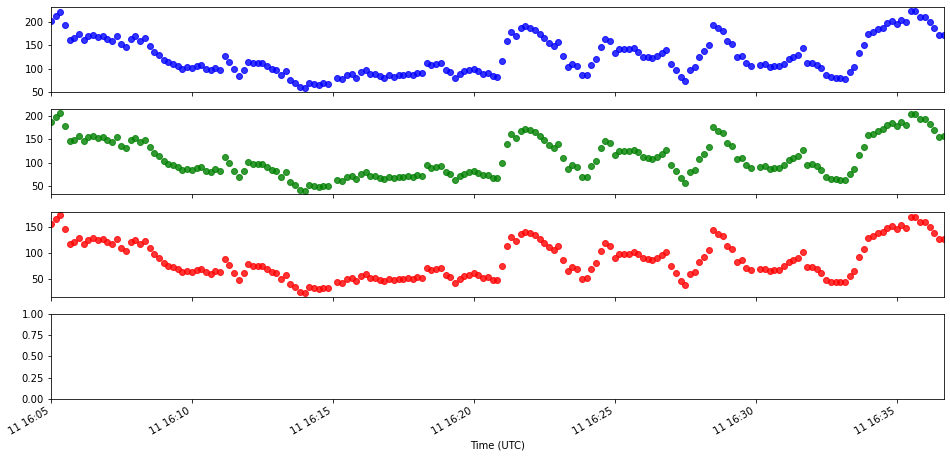

------


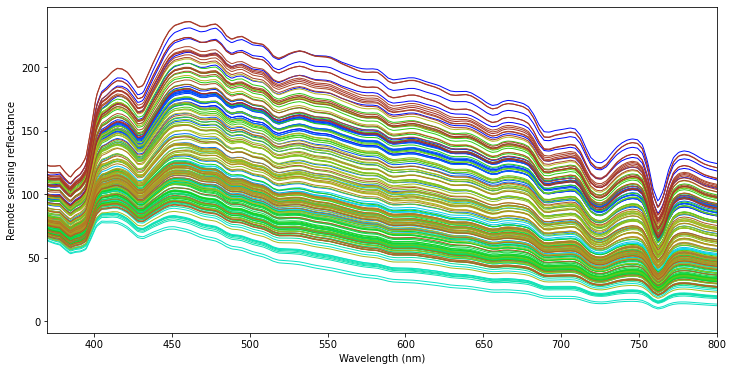

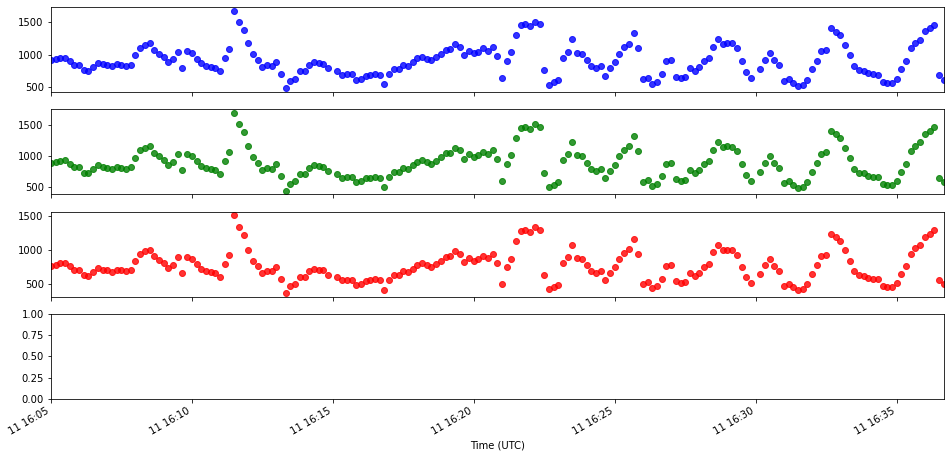

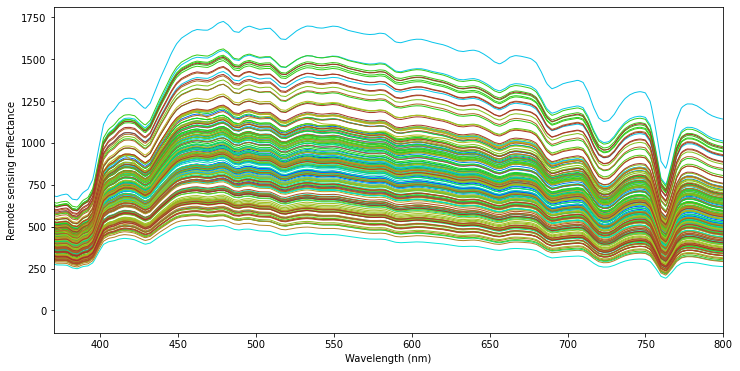

In [456]:
for i in range(len(start_times)):
    for df_of_choice in [trios_lt,trios_lsky,trios_ed]:
        df_of_choice['datetime'] = pd.to_datetime(df_of_choice['TimeStamp'])+ timedelta(hours=4) # moving it to UTC
        df_of_choice['utc_dt'] = df_of_choice['datetime'] 
        df_of_choice = df_of_choice.set_index('utc_dt')
        
        df_subset = df_of_choice.loc[start_times[i]:end_times[i]]
        if len(df_subset) == 0:
            print('no rows')
            continue

        print('------')
    #     print(str(df_subset.iloc[0].datetime) + ' -> ' + str(df_subset.iloc[-1].datetime))
    #     print(len(df_subset))

        df_times = pd.to_datetime(df_subset.TimeStamp) + timedelta(hours=4)



        fig, ax = plt.subplots(4,1,figsize=(16,8))
        ax[0].scatter(df_times,df_subset.iloc[:,165:174].mean(axis=1), label='440nm', color='blue', alpha=0.8)
        ax[1].scatter(df_times,df_subset.iloc[:,231:240].mean(axis=1), label='550nm', color='green', alpha=0.8)
        ax[2].scatter(df_times,df_subset.iloc[:,343:352].mean(axis=1), label='675nm', color='red', alpha=0.8) 
#         ax[3].scatter(df_times,df_subset.iloc[:,-1], label='L2 chla', color='green', alpha=0.8) 
        for idx in range(4):
            ax[idx].set_xlabel('Time (UTC)')
            ax[idx].set_xlim(df_times.min(), df_times.max())
            fig.autofmt_xdate(rotation=30)


#         ax[0].set_ylim(0,0.008)
#         ax[1].set_ylim(0,.006)
#         ax[2].set_ylim(0,.001)
    #     ax[0].set_ylabel('ap [$m^{-1}$]')
    #     ax[1].set_ylabel('cp [$m^{-1}$]')
    #     ax[2].set_ylabel('bbp [$m^{-1}$]')
        # ax.xaxis.set_major_locator(plt.MaxNLocator(10))
        # fig.savefig('acs_abs.png')
        plt.show()

        ### full spectra

        colors = list(Color("blue").range_to(Color("brown"),len(df_subset)))
        hex_colors = [j.hex for j in colors]

        fig, ax = plt.subplots(figsize=(12,6))
        ax.set_xlim(370,800)
#         ax.set_ylim(-0.0001,0.009)
        # ax.axvline(120, c='k', ls='--')
        # ax.axvline(535-125, c='k', ls='--')
        # ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==0].iloc[:,:-7].values.T,c=color_list[1], alpha=.01)
        # ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==1].iloc[:,:-7].values.T,c=color_list[0], alpha=.01)
        # ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==2].iloc[:,:-7].values.T,c=color_list[2], alpha=.01)

        for j in range(len(df_subset)):
            ax.plot(df_subset.columns[1:-1].astype(int), df_subset.iloc[j,1:-1].values,c=hex_colors[j], alpha=1, lw=1)
        #     ax.plot(df_subset.columns[:-7].astype(int), df_subset[kmeans.labels_==1].iloc[:,:-7].values.T.mean(axis=1),c=color_list[0], alpha=1, lw=2)
        #     ax.plot(df_subset.columns[:-7].astype(int), df_subset[kmeans.labels_==2].iloc[:,:-7].values.T.mean(axis=1),c=color_list[2], alpha=1, lw=2)

        # trios_subset[kmeans.labels_==0].iloc[:,:-8].plot(label='Pelagic side of front', ax=ax, c=color_list[1], lw=3)
        # trios_subset[kmeans.labels_==1].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[0], lw=3)
        # trios_subset[kmeans.labels_==2].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[2], lw=3)

        ax.set_xlabel('Wavelength (nm)')
        ax.set_ylabel('Remote sensing reflectance')

        # fig.savefig('figs/aug2916_trios_clusters_spectra.png',dpi=300)

run the mobley correction on this

 Lt - Lsky*0.028 / Ed

In [408]:
df1 = (trios_lt.iloc[:,1:] - trios_lsky.iloc[:,1:]*0.028)/trios_ed.iloc[:,1:]
df2 = trios_lt.iloc[:,0]
trios_df = pd.concat([df2,df1],axis=1)

My notes say that the TriOS data was saved as LST so moving to UTC. I have not included the offset compared to the inline but that is around 20 seconds.

In [409]:
trios_df['datetime'] = pd.to_datetime(trios_df['TimeStamp'])+ timedelta(hours=4) # moving it to UTC
trios_df['utc_dt'] =trios_df['datetime'] 
trios_df = trios_df.set_index('utc_dt')

In [410]:
# we have some 0 values when the cap was on

<AxesSubplot:xlabel='utc_dt'>

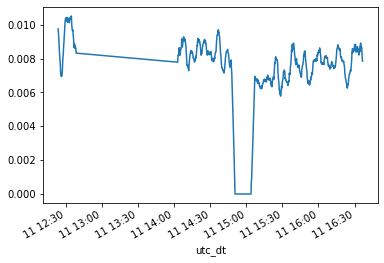

In [411]:
trios_df['450'].rolling(window=6*3).mean().plot()

In [412]:
trios_df['450'].min()

-4.0672776122476487e-07

In [413]:
trios_df.drop(trios_df[trios_df['450'] < 0.0001].index, inplace=True)

<AxesSubplot:xlabel='utc_dt'>

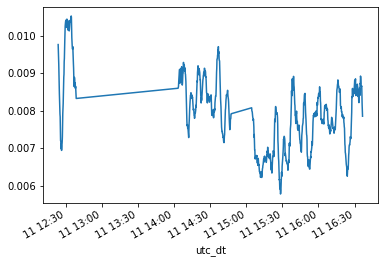

In [414]:
trios_df['450'].rolling(window=6*3).mean().plot()

In [415]:
# these are the coefficients based on the Hu et al 2012 paper

ci1 = -0.49
ci2 = 191.6590

# these are some coefficients that I calculated using the same exact method but trying to optimize for the Micasense bands

# ci1 = -0.38152295986028695
# ci2 = 271.37634868

# average of 443*.5 + 489*1.5
# ci1 = -0.30002281538304754
# ci2 = 310.5772338

# ci1 = -0.21380600002416383
# ci2 = 572.01573044



def oc_index(blue, green, red):
    blue, green, red = blue, green, red
    CI = green - ( blue + (555 - 477)/(667 - 477) * (red - blue) )
    ChlCI = 10**(ci1 + ci2*CI)
    return(ChlCI)

#### Filter all TriOS data for outliers and make dataset that is just the transects

In [416]:
i=6

In [417]:
start_times = ['2022-03-09 15:25', '2022-03-09 20:50','2022-03-10 12:59','2022-03-10 17:35','2022-03-11 14:02','2022-03-11 15:00','2022-03-11 16:05',]
end_times =   ['2022-03-09 18:30', '2022-03-09 22:59','2022-03-10 15:30','2022-03-10 20:30','2022-03-11 14:35','2022-03-11 15:30','2022-03-11 17:35',]

In [418]:
tsg_df.loc[start_times[i]:end_times[i]].hvplot.points('lon', 'lat', geo=True, c='chla', cmap='viridis', alpha=1,tiles='EsriNatGeo', width=700)

:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [lon,lat]   (chla)

This block is cutting off major outliers by doing a rolling median and eliminating anything that jumps substantually from that median assuming it is due to glint

In [419]:
trios_df

,TimeStamp,320,321,322,323,324,325,326,327,328,...,942,943,944,945,946,947,948,949,950,datetime
utc_dt,,,,,,,,,,,,,,,,,,,,,
2022-03-11 12:05:20,03/11/2022 08:05:20,0.009903,0.010093,0.010150,0.010050,0.009970,0.009914,0.009944,0.009769,0.009481,...,0.002700,0.002575,0.002538,0.002503,0.002647,0.002657,0.002601,0.002534,0.002415,2022-03-11 12:05:20
2022-03-11 12:21:00,03/11/2022 08:21:00,0.009202,0.009350,0.009401,0.009271,0.009172,0.009097,0.009142,0.009036,0.008832,...,0.003960,0.004026,0.003997,0.003948,0.003909,0.003874,0.003836,0.003878,0.003943,2022-03-11 12:21:00
2022-03-11 12:21:10,03/11/2022 08:21:10,0.007820,0.007973,0.008033,0.007941,0.007842,0.007764,0.007790,0.007690,0.007508,...,0.002104,0.002182,0.002265,0.002344,0.002496,0.002619,0.002724,0.002863,0.003015,2022-03-11 12:21:10
2022-03-11 12:21:20,03/11/2022 08:21:20,0.010316,0.010459,0.010503,0.010393,0.010282,0.010195,0.010236,0.010108,0.009874,...,0.003273,0.003167,0.003062,0.002951,0.003096,0.003233,0.003350,0.003400,0.003412,2022-03-11 12:21:20
2022-03-11 12:21:30,03/11/2022 08:21:30,0.008531,0.008689,0.008751,0.008659,0.008563,0.008487,0.008523,0.008420,0.008228,...,0.002896,0.003009,0.003014,0.003012,0.003079,0.003056,0.002992,0.002912,0.002841,2022-03-11 12:21:30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-11 16:36:00,03/11/2022 12:36:00,0.006538,0.006627,0.006656,0.006588,0.006513,0.006453,0.006468,0.006387,0.006242,...,-0.000034,-0.000012,-0.000002,0.000008,0.000004,0.000014,0.000030,0.000064,0.000078,2022-03-11 16:36:00
2022-03-11 16:36:10,03/11/2022 12:36:10,0.005814,0.005904,0.005934,0.005881,0.005825,0.005783,0.005804,0.005724,0.005584,...,0.000327,0.000313,0.000330,0.000348,0.000374,0.000368,0.000350,0.000337,0.000337,2022-03-11 16:36:10
2022-03-11 16:36:20,03/11/2022 12:36:20,0.005380,0.005468,0.005504,0.005456,0.005408,0.005372,0.005393,0.005324,0.005201,...,0.000304,0.000302,0.000271,0.000238,0.000229,0.000241,0.000262,0.000285,0.000293,2022-03-11 16:36:20


In [386]:
trios_transects = []
timestamps = []

for i in range(len(start_times)):
    if trios_df.loc[start_times[i]:end_times[i]]['450'].empty:
        pass
    else:
        print(i)
        
        trios_df_transect = trios_df.loc[start_times[i]:end_times[i]]
        
        # Calculate rolling median and filter everything based on 440nm
        rolling_440 = trios_df_transect['440'].rolling(window=6*2).median()
        upper_threshold = 0.1
        lower_threshold = -0.1
        # filter based on threshold all in one line 
        df_filtered = trios_df_transect.drop(trios_df_transect[(trios_df_transect['440']-rolling_440>upper_threshold)|(trios_df_transect['440']- rolling_440<lower_threshold)].index) 

        trios_transects.append(df_filtered)
        timestamps.append(df_filtered['TimeStamp'])
        
trios_transects = pd.concat(trios_transects)

ValueError: No objects to concatenate

In [420]:
trios_df

,TimeStamp,320,321,322,323,324,325,326,327,328,...,942,943,944,945,946,947,948,949,950,datetime
utc_dt,,,,,,,,,,,,,,,,,,,,,
2022-03-11 12:05:20,03/11/2022 08:05:20,0.009903,0.010093,0.010150,0.010050,0.009970,0.009914,0.009944,0.009769,0.009481,...,0.002700,0.002575,0.002538,0.002503,0.002647,0.002657,0.002601,0.002534,0.002415,2022-03-11 12:05:20
2022-03-11 12:21:00,03/11/2022 08:21:00,0.009202,0.009350,0.009401,0.009271,0.009172,0.009097,0.009142,0.009036,0.008832,...,0.003960,0.004026,0.003997,0.003948,0.003909,0.003874,0.003836,0.003878,0.003943,2022-03-11 12:21:00
2022-03-11 12:21:10,03/11/2022 08:21:10,0.007820,0.007973,0.008033,0.007941,0.007842,0.007764,0.007790,0.007690,0.007508,...,0.002104,0.002182,0.002265,0.002344,0.002496,0.002619,0.002724,0.002863,0.003015,2022-03-11 12:21:10
2022-03-11 12:21:20,03/11/2022 08:21:20,0.010316,0.010459,0.010503,0.010393,0.010282,0.010195,0.010236,0.010108,0.009874,...,0.003273,0.003167,0.003062,0.002951,0.003096,0.003233,0.003350,0.003400,0.003412,2022-03-11 12:21:20
2022-03-11 12:21:30,03/11/2022 08:21:30,0.008531,0.008689,0.008751,0.008659,0.008563,0.008487,0.008523,0.008420,0.008228,...,0.002896,0.003009,0.003014,0.003012,0.003079,0.003056,0.002992,0.002912,0.002841,2022-03-11 12:21:30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-11 16:36:00,03/11/2022 12:36:00,0.006538,0.006627,0.006656,0.006588,0.006513,0.006453,0.006468,0.006387,0.006242,...,-0.000034,-0.000012,-0.000002,0.000008,0.000004,0.000014,0.000030,0.000064,0.000078,2022-03-11 16:36:00
2022-03-11 16:36:10,03/11/2022 12:36:10,0.005814,0.005904,0.005934,0.005881,0.005825,0.005783,0.005804,0.005724,0.005584,...,0.000327,0.000313,0.000330,0.000348,0.000374,0.000368,0.000350,0.000337,0.000337,2022-03-11 16:36:10
2022-03-11 16:36:20,03/11/2022 12:36:20,0.005380,0.005468,0.005504,0.005456,0.005408,0.005372,0.005393,0.005324,0.005201,...,0.000304,0.000302,0.000271,0.000238,0.000229,0.000241,0.000262,0.000285,0.000293,2022-03-11 16:36:20


In [272]:
timestamps = [item for sublist in timestamps for item in sublist]

This block is subtracting the NIR from the whole spectrum AFTER doing the typical Mobley 1999 Lw = Lt - rho*Lsky

In [421]:
# subtract NIR from whole spectrum
corrected_specs = []
timestamps = []
for i in range(len(trios_df)):
    corrected_specs.append(trios_df.iloc[i,1:-2] - trios_df.iloc[i,450:480].mean())
    timestamps.append(trios_df.iloc[i,0])

corrected_specs = pd.DataFrame(corrected_specs, columns=df_filtered.columns[1:-2] )
corrected_specs['chla_oci'] = oc_index(corrected_specs.iloc[:, 156:161].mean(axis=1).values, corrected_specs.iloc[:, 232:240].mean(axis=1).values, corrected_specs.iloc[:, 346:351].mean(axis=1).values)
corrected_specs['TimeStamp'] = timestamps

lats = []
lons = []
sals = []
temps = []
for i in range(len(corrected_specs)):
    row = df.iloc[df.index.get_loc(pd.to_datetime(corrected_specs.iloc[i].TimeStamp) + timedelta(hours=4), method='nearest')]
    lats.append(row.lat)
    lons.append(row.lon)
    sals.append(row['Sal_smooth'])
    temps.append(row['Temp_smooth'])
corrected_specs['lat'] = lats
corrected_specs['lon'] = lons
corrected_specs['sal'] = sals
corrected_specs['temp'] = temps

trios_gdf = gpd.GeoDataFrame(corrected_specs, geometry=gpd.points_from_xy(corrected_specs.lon, corrected_specs.lat))

In [422]:
trios_gdf['chla_oci'] = oc_index(trios_gdf.iloc[:, 156:161].mean(axis=1).values, trios_gdf.iloc[:, 232:240].mean(axis=1).values, trios_gdf.iloc[:, 346:351].mean(axis=1).values)

(array([  3., 351.,  58.,  45.,  51., 172., 189.,  37.,  10.,   2.]),
 array([0.10067646, 0.1586817 , 0.21668695, 0.2746922 , 0.33269745,
        0.3907027 , 0.44870794, 0.50671319, 0.56471844, 0.62272369,
        0.68072894]),
 <BarContainer object of 10 artists>)

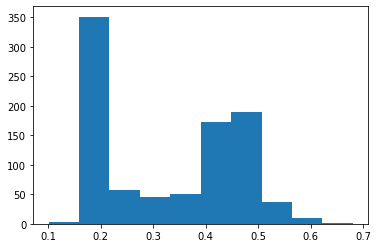

In [423]:
plt.hist(trios_gdf['chla_oci'])

(0.0, 0.65)

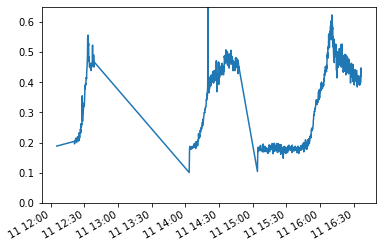

In [424]:
fig, ax = plt.subplots()
trios_gdf['chla_oci'].rolling(window=1).mean().plot(ax=ax)
ax.set_ylim(0,.65)

In [432]:
def L2chlor_a(Rrs443, Rrs488, Rrs547, Rrs555, Rrs667):
    ''' Use weighted MODIS Aqua bands to calculate chlorophyll concentration
    using oc3m blended algorithm with CI (Hu et al. 2012) '''

    thresh = [0.15, 0.20]
    a0 = 0.1977
    a1 = -1.8117
    a2 = 1.9743
    a3 = 2.5635
    a4 = -0.7218

    ci1 = -0.4909
    ci2 = 191.6590
    
    if Rrs443 > Rrs488:
        Rrsblue = Rrs443
    else:
        Rrsblue = Rrs488

    log10chl = a0 + a1 * (np.log10(Rrsblue / Rrs547)) \
        + a2 * (np.log10(Rrsblue / Rrs547))**2 \
            + a3 * (np.log10(Rrsblue / Rrs547))**3 \
                + a4 * (np.log10(Rrsblue / Rrs547))**4

    oc3m = np.power(10, log10chl)

#     CI = Rrs555 - ( Rrs443 + (555 - 443)/(667 - 443) * \
#         (Rrs667 -Rrs443) )
        
#     ChlCI = 10** (ci1 + ci2*CI)

#     if ChlCI <= thresh[0]:
#         chlor_a = ChlCI
#     elif ChlCI > thresh[1]:
#         chlor_a = oc3m
#     else:
#         chlor_a = oc3m * (ChlCI-thresh[0]) / (thresh[1]-thresh[0]) +\
#             ChlCI * (thresh[1]-ChlCI) / (thresh[1]-thresh[0])

#     return chlor_a
    return(oc3m)

In [426]:
trios_gdf.iloc[:,119:128].mean(axis=1).values[i]

0.005528341867685658

In [487]:
trios_gdf.iloc[:,119:128].mean(axis=1)

2022-03-11 12:05:20    0.006517
2022-03-11 12:21:00    0.005247
2022-03-11 12:21:10    0.005915
2022-03-11 12:21:20    0.006621
2022-03-11 12:21:30    0.005939
                         ...   
2022-03-11 16:36:00    0.005274
2022-03-11 16:36:10    0.005140
2022-03-11 16:36:20    0.004998
2022-03-11 16:36:30    0.005655
2022-03-11 16:36:40    0.005528
Length: 918, dtype: float64

In [488]:
l2_chla = []
for i in range(len(trios_gdf)):
    l2_chla.append(L2chlor_a(trios_gdf.iloc[:,122:125].mean(axis=1).values[i], trios_gdf.iloc[:,168:171].mean(axis=1).values[i], trios_gdf.iloc[:,228:230].mean(axis=1).values[i], 
          trios_gdf.iloc[:,234:237].mean(axis=1).values[i], trios_gdf.iloc[:,346:349].mean(axis=1).values[i]))

In [489]:
trios_gdf['l2_chla'] = l2_chla

<AxesSubplot:>

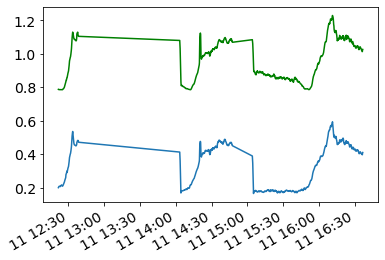

In [490]:
fig, ax = plt.subplots()
trios_gdf['chla_oci'].rolling(window=6).mean().plot(ax=ax, label='OCI')
trios_gdf['l2_chla'].rolling(window=6).mean().plot(ax=ax, label='l2_chla',c='green')

# ax.set_ylim(0,.65)

(0.005, 0.008)

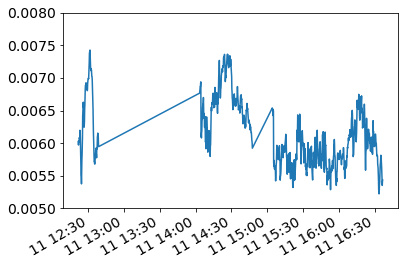

In [491]:
fig, ax = plt.subplots()
trios_gdf['450'].rolling(window=6).mean().plot(ax=ax)
ax.set_ylim(0.005,.008)

In [328]:
    trios_gdf.iloc[:,165:174].mean(axis=1).values[i], trios_gdf.iloc[:,223:232].mean(axis=1).values[i], 
          trios_gdf.iloc[:,231:240].mean(axis=1).values[i], trios_gdf.iloc[:,343:352].mean(axis=1).values[i])

(['2022-03-10 12:59',
  '2022-03-10 17:35',
  '2022-03-11 15:00',
  '2022-03-11 16:05'],
 ['2022-03-10 15:30',
  '2022-03-10 20:30',
  '2022-03-11 15:46',
  '2022-03-11 17:35'])

In [367]:
trios_gdf.loc[start_times[i]:end_times[i]].iloc[:,-1]

IndexError: list index out of range

In [405]:
i

3

In [439]:
from colour import Color

Text(0, 0.5, 'Remote sensing reflectance')

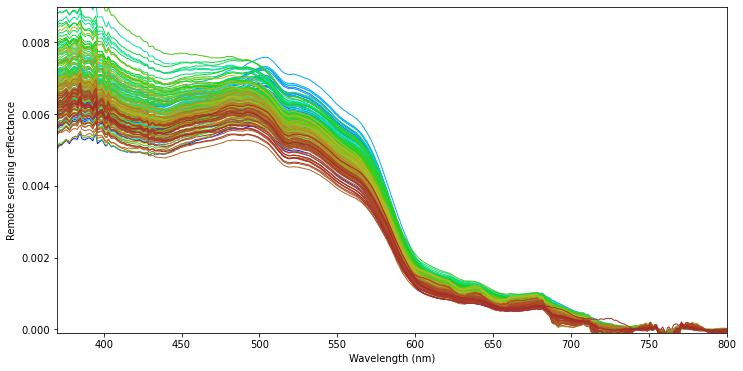

In [449]:
colors = list(Color("blue").range_to(Color("brown"),len(df_subset)))
hex_colors = [j.hex for j in colors]

fig, ax = plt.subplots(figsize=(12,6))
ax.set_xlim(370,800)
ax.set_ylim(-0.0001,0.009)
# ax.axvline(120, c='k', ls='--')
# ax.axvline(535-125, c='k', ls='--')
# ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==0].iloc[:,:-7].values.T,c=color_list[1], alpha=.01)
# ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==1].iloc[:,:-7].values.T,c=color_list[0], alpha=.01)
# ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==2].iloc[:,:-7].values.T,c=color_list[2], alpha=.01)

for i in range(len(df_subset)):
    ax.plot(df_subset.columns[:-8].astype(int), df_subset.iloc[i,:-8].values,c=hex_colors[i], alpha=1, lw=1)
#     ax.plot(df_subset.columns[:-7].astype(int), df_subset[kmeans.labels_==1].iloc[:,:-7].values.T.mean(axis=1),c=color_list[0], alpha=1, lw=2)
#     ax.plot(df_subset.columns[:-7].astype(int), df_subset[kmeans.labels_==2].iloc[:,:-7].values.T.mean(axis=1),c=color_list[2], alpha=1, lw=2)

# trios_subset[kmeans.labels_==0].iloc[:,:-8].plot(label='Pelagic side of front', ax=ax, c=color_list[1], lw=3)
# trios_subset[kmeans.labels_==1].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[0], lw=3)
# trios_subset[kmeans.labels_==2].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[2], lw=3)

ax.set_xlabel('Wavelength (nm)')
ax.set_ylabel('Remote sensing reflectance')

In [482]:
df_subset.iloc[:,:-8].mean(axis=0)

320    0.005883
321    0.005978
322    0.006016
323    0.005951
324    0.005881
         ...   
946   -0.000463
947   -0.000468
948   -0.000478
949   -0.000472
950         NaN
Length: 631, dtype: float64

no rows
no rows
------


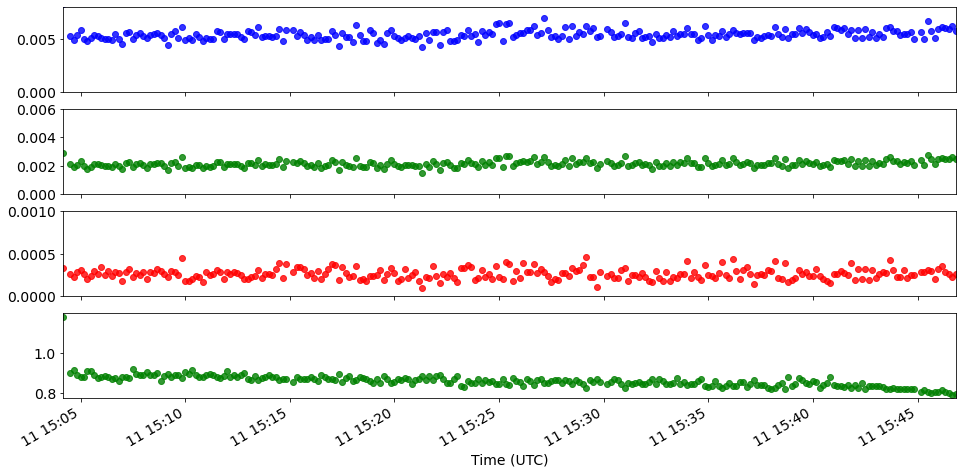

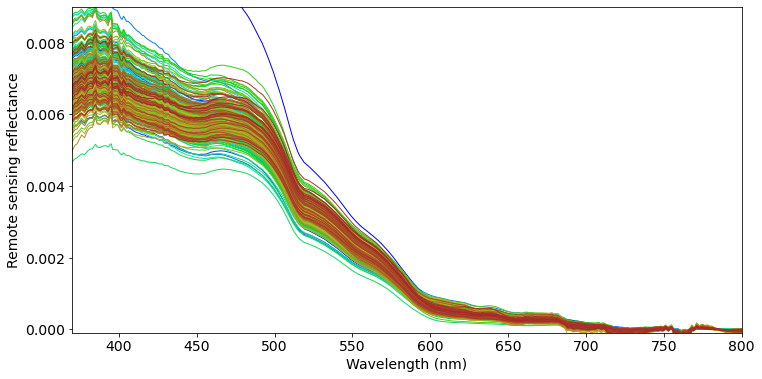

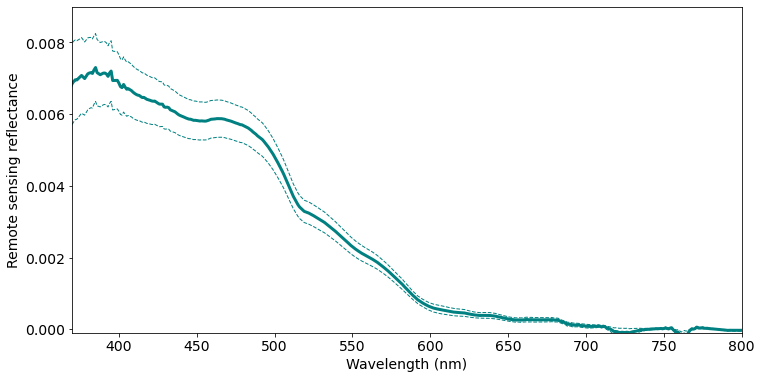

------


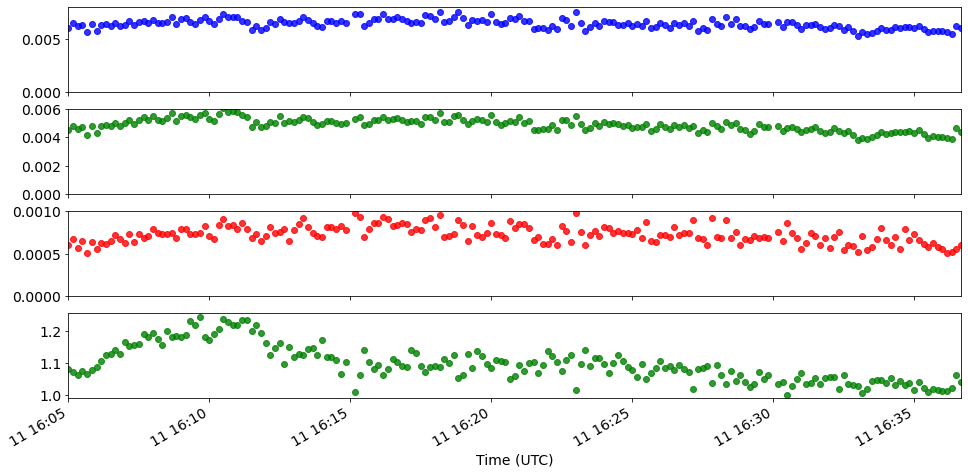

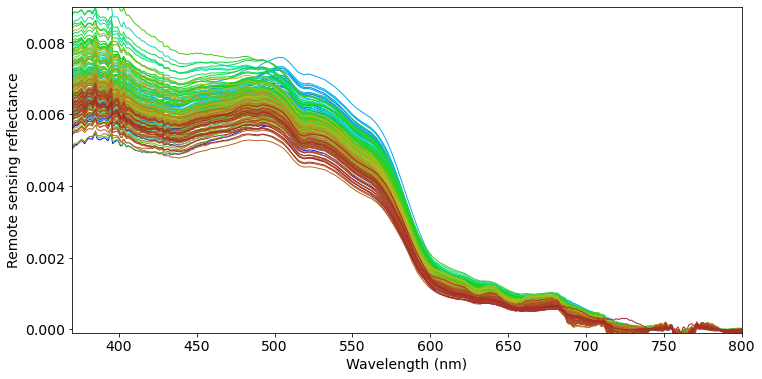

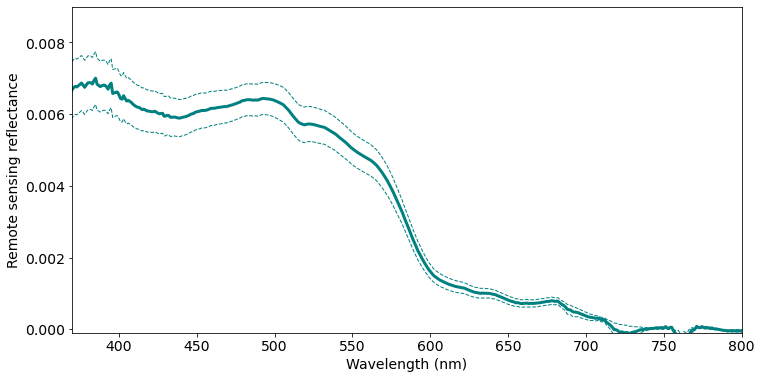

In [492]:
for i in range(len(start_times)):
    df_subset = trios_gdf.loc[start_times[i]:end_times[i]]
    if len(df_subset) == 0:
        print('no rows')
        continue
    
    print('------')
#     print(str(df_subset.iloc[0].datetime) + ' -> ' + str(df_subset.iloc[-1].datetime))
#     print(len(df_subset))

    df_times = pd.to_datetime(df_subset.TimeStamp) + timedelta(hours=4)
    

    
    fig, ax = plt.subplots(4,1,figsize=(16,8))
    ax[0].scatter(df_times,df_subset.iloc[:,165:174].mean(axis=1), label='440nm', color='blue', alpha=0.8)
    ax[1].scatter(df_times,df_subset.iloc[:,231:240].mean(axis=1), label='550nm', color='green', alpha=0.8)
    ax[2].scatter(df_times,df_subset.iloc[:,343:352].mean(axis=1), label='675nm', color='red', alpha=0.8) 
    ax[3].scatter(df_times,df_subset.iloc[:,-1], label='L2 chla', color='green', alpha=0.8) 
    for idx in range(4):
        ax[idx].set_xlabel('Time (UTC)')
        ax[idx].set_xlim(df_times.min(), df_times.max())
        fig.autofmt_xdate(rotation=30)
        
        
    ax[0].set_ylim(0,0.008)
    ax[1].set_ylim(0,.006)
    ax[2].set_ylim(0,.001)
#     ax[0].set_ylabel('ap [$m^{-1}$]')
#     ax[1].set_ylabel('cp [$m^{-1}$]')
#     ax[2].set_ylabel('bbp [$m^{-1}$]')
    # ax.xaxis.set_major_locator(plt.MaxNLocator(10))
    # fig.savefig('acs_abs.png')
    plt.show()
    
    ### full spectra
    
    colors = list(Color("blue").range_to(Color("brown"),len(df_subset)))
    hex_colors = [j.hex for j in colors]

    fig, ax = plt.subplots(figsize=(12,6))
    ax.set_xlim(370,800)
    ax.set_ylim(-0.0001,0.009)
    # ax.axvline(120, c='k', ls='--')
    # ax.axvline(535-125, c='k', ls='--')
    # ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==0].iloc[:,:-7].values.T,c=color_list[1], alpha=.01)
    # ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==1].iloc[:,:-7].values.T,c=color_list[0], alpha=.01)
    # ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==2].iloc[:,:-7].values.T,c=color_list[2], alpha=.01)

    for i in range(len(df_subset)):
        ax.plot(df_subset.columns[:-8].astype(int), df_subset.iloc[i,:-8].values,c=hex_colors[i], alpha=1, lw=1)
    #     ax.plot(df_subset.columns[:-7].astype(int), df_subset[kmeans.labels_==1].iloc[:,:-7].values.T.mean(axis=1),c=color_list[0], alpha=1, lw=2)
    #     ax.plot(df_subset.columns[:-7].astype(int), df_subset[kmeans.labels_==2].iloc[:,:-7].values.T.mean(axis=1),c=color_list[2], alpha=1, lw=2)

    # trios_subset[kmeans.labels_==0].iloc[:,:-8].plot(label='Pelagic side of front', ax=ax, c=color_list[1], lw=3)
    # trios_subset[kmeans.labels_==1].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[0], lw=3)
    # trios_subset[kmeans.labels_==2].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[2], lw=3)

    ax.set_xlabel('Wavelength (nm)')
    ax.set_ylabel('Remote sensing reflectance')
    
    
    fig, ax = plt.subplots(figsize=(12,6))
    ax.set_xlim(370,800)
    ax.set_ylim(-0.0001,0.009)
    # ax.axvline(120, c='k', ls='--')
    # ax.axvline(535-125, c='k', ls='--')
    # ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==0].iloc[:,:-7].values.T,c=color_list[1], alpha=.01)
    # ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==1].iloc[:,:-7].values.T,c=color_list[0], alpha=.01)
    # ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==2].iloc[:,:-7].values.T,c=color_list[2], alpha=.01)

    ax.plot(df_subset.columns[:-8].astype(int), df_subset.iloc[:,:-8].mean(axis=0),c='teal', alpha=1, lw=3)
    ax.plot(df_subset.columns[:-8].astype(int), df_subset.iloc[:,:-8].mean(axis=0)+df_subset.iloc[:,:-8].std(axis=0),c='teal', alpha=1, lw=1,ls='--')
    ax.plot(df_subset.columns[:-8].astype(int), df_subset.iloc[:,:-8].mean(axis=0)-df_subset.iloc[:,:-8].std(axis=0),c='teal', alpha=1, lw=1,ls='--')
    #     ax.plot(df_subset.columns[:-7].astype(int), df_subset[kmeans.labels_==1].iloc[:,:-7].values.T.mean(axis=1),c=color_list[0], alpha=1, lw=2)
    #     ax.plot(df_subset.columns[:-7].astype(int), df_subset[kmeans.labels_==2].iloc[:,:-7].values.T.mean(axis=1),c=color_list[2], alpha=1, lw=2)

    # trios_subset[kmeans.labels_==0].iloc[:,:-8].plot(label='Pelagic side of front', ax=ax, c=color_list[1], lw=3)
    # trios_subset[kmeans.labels_==1].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[0], lw=3)
    # trios_subset[kmeans.labels_==2].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[2], lw=3)

    ax.set_xlabel('Wavelength (nm)')
    ax.set_ylabel('Remote sensing reflectance')
    
#     plt.savefig('rrs_march_full_spectra.png',dpi=300)
    plt.show()

    # fig.savefig('figs/aug2916_trios_clusters_spectra.png',dpi=300)

### Pull in HPLC timings

In [99]:
# hplc_df = pd.read_csv('data/ivan_cruise/hplc_timing.csv') # this is just timings
hplc_df = pd.read_csv('data/ivan_cruise/hplc_data_Windle_aug_2021.csv')

In [100]:
hplc_df.head()

,Horn Point Lab sample code,sample #,Date,Time (LST),Cruise Notes,Vf (ml),date extracted at Horn Point (month/day/year),Vx (ml),[TChl a],[TChl b],...,[TAcc],[TPig],[DP],[TAcc]/[Tchla],[PSC]/[TCaro],[PPC]/[TCaro],[TChl]/[TCaro],[PPC]/[Tpig],[PSP]/[TPig],[TChl a]/[TPig]
0,AW 1,11,27-8,1207,beginning of transect on offshore side,500,2/23/22,2.841,0.407,0.001,...,0.145,0.552,0.100,0.36,0.10,0.90,3.09,0.22,0.78,0.74
1,AW 2,12,27-8,1300,at front,500,2/23/22,2.787,0.165,0.012,...,0.157,0.322,0.127,0.95,0.11,0.89,1.40,0.37,0.63,0.51
2,AW 3,13,27-8,1333,last profile of transect,500,2/23/22,2.795,0.228,0.007,...,0.181,0.409,0.148,0.79,0.10,0.90,1.46,0.36,0.64,0.56
3,AW 4,17,28-8,1116,beginning tow-yo survey from offshore side,500,2/23/22,2.760,0.128,0.013,...,0.129,0.257,0.106,1.01,0.11,0.89,1.36,0.38,0.62,0.50
4,AW 5,18,28-8,1217,crossing the front,500,2/23/22,2.785,0.171,0.007,...,0.158,0.329,0.127,0.92,0.13,0.87,1.33,0.37,0.63,0.52


In [101]:
hplc_df['datetime'] = pd.to_datetime([datetime.strptime(x, '%Y %d-%m %H%M') for x in '2021 ' + hplc_df.Date + ' ' + hplc_df['Time (LST)'].astype(str)])
hplc_df['datetime']   = hplc_df['datetime'] + timedelta(hours=4) # moving it to UTC
hplc_df['utc_dt']   = hplc_df['datetime']
hplc_df = hplc_df.set_index('utc_dt')

In [424]:
goes_ds.sea_surface_temperature[:,50:200, 300:450]

<xarray.DataArray 'sea_surface_temperature' (time: 239, latitude: 150, longitude: 150)>
[5377500 values with dtype=float32]
Coordinates:
  * time       (time) object 2022-03-04 13:00:00 ... 2022-03-14 13:00:00
  * latitude   (latitude) float32 37.01 36.99 36.97 36.95 ... 34.07 34.05 34.03
  * longitude  (longitude) float32 -76.99 -76.97 -76.95 ... -74.05 -74.03 -74.01
Attributes:
    colorBarMaximum:  32.0
    colorBarMinimum:  0.0
    comment:          SST obtained by regression with buoy measurements, sens...
    grid_mapping:     crs
    ioos_category:    Temperature
    long_name:        Sea Surface Sub-Skin Temperature
    source:           NOAA
    standard_name:    sea_surface_subskin_temperature
    units:            degree_C
    valid_max:        327.67
    valid_min:        -327.67

In [444]:
goes_ds.sea_surface_temperature[:,100:130, 400:430].hvplot.quadmesh(
    'longitude', 'latitude', projection=crs.PlateCarree(), project=True,
    cmap='inferno', dynamic=True, 
    frame_height=200, clim=(13, 26), rasterize=True) * tsg_df.loc[start_times[i]:end_times[i]].hvplot.points('lon', 'lat', geo=True, color='red', alpha=0.01)

:DynamicMap   [time]
   :Overlay
      .Image.I  :Image   [longitude,latitude]   (sea_surface_temperature)
      .Points.I :Points   [lon,lat]

### Grab profile data

In [110]:
import scipy.io
names=['c1t1', 'c1t2', 'c1t3', 'c1t4', 'c1t5', 'c1t6', 'c1t7', 'c1t8']
li = []
for i, fn in enumerate(glob.glob("data/VMP/Cruise1/*.mat")):
    mat = scipy.io.loadmat(fn)
    for item in list(mat.keys()):
        if item not in ['__header__', '__version__', '__globals__']:
            df = pd.DataFrame(data=mat[item], columns=['time', 'depth (dBars)', 'temp (C)','salinity (PSU)', 'potential density (kg/m^3 -1000)', 
                                                    'chla (ppb)', 'turbidity (FTU)', 'turb kinetic energy 1 (W/kg)', 'turb kinetic energy 2 (W/kg)'])
            df['transect'] = names[i]
            df['profile_num'] = item.split('profile')[-1]
            li.append(df)

profiles = pd.concat(li, axis=0, ignore_index=True)
profiles['dt'] = pd.to_datetime('2021-1-1') + pd.to_timedelta(profiles.time, unit='D') - pd.Timedelta(days=1)
profiles = profiles.set_index('dt')
profiles = profiles.sort_index(ascending=True)
profiles['datetime'] = pd.to_datetime('2021-1-1') + pd.to_timedelta(profiles.time, unit='D') - pd.Timedelta(days=1)
profiles['profile_num'] = profiles.profile_num.astype(int)

In [111]:
import numpy as np
# from scipy.interpolate import interp2d
import scipy


data_variables = ['temp (C)', 'salinity (PSU)',
       'potential density (kg/m^3 -1000)', 'chla (ppb)', 'turbidity (FTU)',
       'turb kinetic energy 1 (W/kg)', 'turb kinetic energy 2 (W/kg)']

def interpolate_profiles(df, transect, data_variables, plot=False):
    df_subset = df[df.transect == transect]
    interpolated_grids = []
    datetime_list = []
    for i in np.unique(df_subset.profile_num.values):
        datetime_list.append(df_subset[df_subset.profile_num == i].head(1).datetime.values)
    datetime_list = np.array(datetime_list)
    datetime_strings = np.datetime_as_string(datetime_list.flatten(), unit='m')
    
    # Original data (e.g. measurements)
    for data_var in data_variables:
        x_interp = np.arange(1,len(datetime_list), 1)
        y_interp = np.arange(-1,-115, -1)

        xx, yy = np.meshgrid(x_interp, y_interp)
        Z_table = df_subset[data_var].values

        Z = scipy.interpolate.griddata(np.array(list(zip(df_subset.profile_num.values , df_subset['depth (dBars)'].values ))), Z_table, (xx, yy), method='linear')

        datetime_list = []
        for i in np.unique(df_subset.profile_num.values):
            datetime_list.append(df_subset[df_subset.profile_num == i].head(1).datetime.values)
        datetime_list = np.array(datetime_list)
        datetime_strings = np.datetime_as_string(datetime_list.flatten(), unit='m')
        
        interpolated_grids.append(Z)

        if plot:
            cmap='RdYlBu_r'
            norm=None
            fig, ax = plt.subplots(figsize=(9,7))
            if data_var == 'temp (C)':
                cmap='inferno'
                vmin=15
                vmax=28.5
            elif data_var == 'salinity (PSU)':
                vmin=34.5
                vmax=36.5
            elif data_var == 'potential density (kg/m^3 -1000)':
                vmin=22
                vmax=26.3
            elif data_var == 'chla (ppb)':
                vmin=-0.3
                vmax=0.5
                cmap='viridis'
            elif data_var == 'turbidity (FTU)':
                vmin=1
                vmax=1.12
            elif data_var == 'turb kinetic energy 1 (W/kg)':
                vmin=1e-10
                vmax=1e-6
                norm=colors.LogNorm()
            elif data_var == 'turb kinetic energy 2 (W/kg)':
                vmin=1e-10
                vmax=1e-6
                norm=colors.LogNorm()
            
                
            sc = ax.scatter(df_subset['datetime'], df_subset['depth (dBars)'],c=df_subset[data_var],cmap=cmap, s=20, alpha=1, vmin=vmin,vmax=vmax, norm=norm)
            ax.set_ylim(-100,0)
#             ax.set_xlim(df_subset['datetime'].max()+timedelta(hours=.1),df_subset['datetime'].min()-timedelta(hours=.1))
            cb = fig.colorbar(sc)
            cb.set_label(data_var)
            ax.set_ylabel('Depth (m')
            ax.set_xlabel('Time (UTC)')
        #     ax[1].xaxis.set_major_locator(plt.MaxNLocator(7))
            fig.autofmt_xdate(rotation=45)
#             ax.xaxis.set_major_locator(plt.MaxNLocator(15))

            fig.savefig('figs/aug_'+transect+'_profile_'+data_var[:20]+'.png')
            plt.show()
    return(datetime_list, interpolated_grids)

In [214]:
def plot_profiles(df, start_time, end_time, data_variables, plot=False):
    df_subset = df.loc[start_time:end_time]
#     print(df_subset.head())
    interpolated_grids = []
    datetime_list = []
    for i in np.unique(df_subset.profile_num.values):
        datetime_list.append(df_subset[df_subset.profile_num == i].head(1).datetime.values)
    datetime_list = np.array(datetime_list)
    datetime_strings = np.datetime_as_string(datetime_list.flatten(), unit='m')
    
    # Original data (e.g. measurements)
    for data_var in data_variables:
        x_interp = np.arange(1,len(datetime_list), 1)
        y_interp = np.arange(-1,-115, -1)

        xx, yy = np.meshgrid(x_interp, y_interp)
        Z_table = df_subset[data_var].values

        Z = scipy.interpolate.griddata(np.array(list(zip(df_subset.profile_num.values , df_subset['depth (dBars)'].values ))), Z_table, (xx, yy), method='linear')

        datetime_list = []
        for i in np.unique(df_subset.profile_num.values):
            datetime_list.append(df_subset[df_subset.profile_num == i].head(1).datetime.values)
        datetime_list = np.array(datetime_list)
        datetime_strings = np.datetime_as_string(datetime_list.flatten(), unit='m')
        
        interpolated_grids.append(Z)

        if plot:
            cmap='RdYlBu_r'
            norm=None
            fig, ax = plt.subplots(figsize=(17.2,7))
            if data_var == 'temp (C)':
                cmap='inferno'
                vmin=15
                vmax=29
            elif data_var == 'salinity (PSU)':
                vmin=35
                vmax=36.2
            elif data_var == 'potential density (kg/m^3 -1000)':
                vmin=22
                vmax=26.3
            elif data_var == 'chla (ppb)':
                vmin=-0.3
                vmax=0.5
                cmap='viridis'
            elif data_var == 'turbidity (FTU)':
                vmin=1
                vmax=1.12
            elif data_var == 'turb kinetic energy 1 (W/kg)':
                vmin=1e-10
                vmax=1e-6
                norm=colors.LogNorm()
            elif data_var == 'turb kinetic energy 2 (W/kg)':
                vmin=1e-10
                vmax=1e-6
                norm=colors.LogNorm()
            
                
            sc = ax.scatter(df_subset['datetime'], df_subset['depth (dBars)'],c=df_subset[data_var],cmap=cmap, s=20, alpha=1, vmin=vmin,vmax=vmax, norm=norm)
            ax.set_ylim(-100,0)
#             ax.set_xlim(df_subset['datetime'].max()+timedelta(hours=.1),df_subset['datetime'].min()-timedelta(hours=.1))
            cb = fig.colorbar(sc)
            cb.set_label(data_var)
            ax.set_ylabel('Depth (m')
            ax.set_xlabel('Time (UTC)')
            ax.set_xlim(pd.to_datetime(start_time), pd.to_datetime(end_time))
        #     ax[1].xaxis.set_major_locator(plt.MaxNLocator(7))
            fig.autofmt_xdate(rotation=45)
#             ax.xaxis.set_major_locator(plt.MaxNLocator(15))

#             fig.savefig('figs/aug_'+transect+'_profile_'+data_var[:20]+'.png')
            plt.show()

In [215]:
# I've re-ordered these to be in ascending time
profile_transect_names=[ 'c1t4','c1t8', 'c1t3','c1t5', 'c1t6', 'c1t7', 'c1t2','c1t1']

In [15]:
start_times[1]

'2022-03-09 20:50'

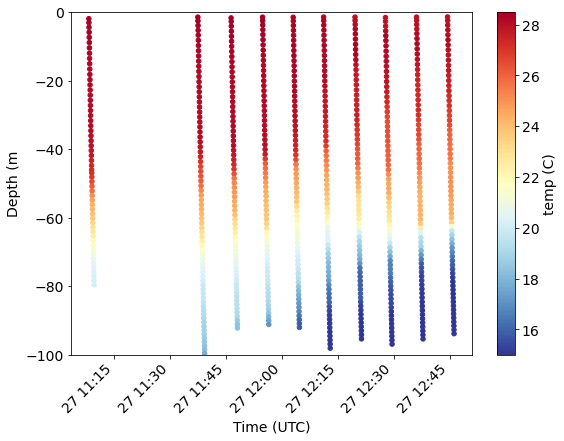

In [217]:
dates, interpolated_grids = interpolate_profiles(profiles, profile_transect_names[2], [data_variables[0]], plot=True)

### Add in density

In [10]:
tsg_df['Sal_smooth'] = tsg_df.Sal.rolling(window=7).median()
tsg_df['Temp_smooth'] = tsg_df.Temp.rolling(window=7).median()

In [11]:
import gsw
tsg_df['sigma'] = gsw.density.sigma0(tsg_df.Sal_smooth, tsg_df.Temp_smooth).rolling(window=5).mean()
tsg_df['sigma_grad'] = np.gradient(tsg_df['sigma'])

## Visualizing transects with good sample data

In [12]:
samples_df = pd.read_csv('data/feb_cruise/GSF_Sampling_Table_tidy_nuts.csv')
samples_df['datetime'] = [datetime.strptime(x[:-1], '%d-%b-%y %H:%M:%S') for x in samples_df.Date+' '+samples_df['Ship Time']]
samples_df['utc_dt'] = samples_df['datetime']
samples_df  = samples_df.set_index('utc_dt')

In [13]:
lats = []
lons = []
chlas = []
sals = []
temps = []

for i in range(len(samples_df)):
    row = tsg_df.iloc[tsg_df.index.get_loc(samples_df.iloc[i].datetime, method='nearest')]
    lats.append(row.lat)
    lons.append(row.lon)
    chlas.append(row.chla)
    sals.append(row.Sal)
    temps.append(row.Temp)
    
samples_df['lat'] = lats
samples_df['lon'] = lons
samples_df['chla'] = chlas
samples_df['sal'] = sals
samples_df['temp'] = temps

In [14]:
samples_df['sample_id'] = samples_df.Cruise+'_'+samples_df.Transect.astype(str)+'_'+samples_df.Stations.astype(str)

In [15]:
fcm_df = pd.read_csv('data/march_cruise/GSF_PhytoMarFeb_KS.csv')
fcm_df['sample_id'] = fcm_df.Cruise+'_'+fcm_df.Transect.astype(str)+'_'+fcm_df.Station.astype(str)

In [16]:
nanosa = []
picosa = []
prosa = []
synsa = []

nanosb = []
picosb = []
prosb = []
synsb = []

for i in range(len(samples_df)):
        fcm_station = fcm_df[fcm_df['sample_id'] == samples_df.iloc[i]['sample_id']]
        if len(fcm_station) == 0:
            nanosa.append(np.nan)
            picosa.append(np.nan) 
            prosa.append(np.nan)
            synsa.append(np.nan)
            nanosb.append(np.nan)
            picosb.append(np.nan) 
            prosb.append(np.nan)
            synsb.append(np.nan)
        else:
            for index, row in fcm_station.iterrows():
    #             print(row.ID)
    #             print(row.FinalEventsB)
                if row['ID']=='Nano':
                    nanosa.append(row['FinalEventsB'])
                    nanosb.append(row['FinalEventsC'])
                elif row['ID']=='Pico':
                    picosa.append(row['FinalEventsB'])
                    picosb.append(row['FinalEventsC'])
                elif row['ID']=='Pro':
                    prosa.append(row['FinalEventsB'])
                    prosb.append(row['FinalEventsC'])
                elif row['ID']=='Syn':
                    synsa.append(row['FinalEventsB'])
                    synsb.append(row['FinalEventsC'])


samples_df['nanosa'] =nanosa
samples_df['picosa'] =picosa
samples_df['prosa'] =prosa
samples_df['synsa'] =synsa

samples_df['nanosb'] =nanosb
samples_df['picosb'] =picosb
samples_df['prosb'] =prosb
samples_df['synsb'] =synsb

In [17]:
# samples_df.to_csv('GSF_Sampling_Table_tidy_combined_march.csv')

In [18]:
# samples_df = pd.read_csv('GSF_Sampling_Table_tidy_combined_march.csv')
# samples_df = 
# samples_df  = samples_df.set_index('utc_dt')

<AxesSubplot:>

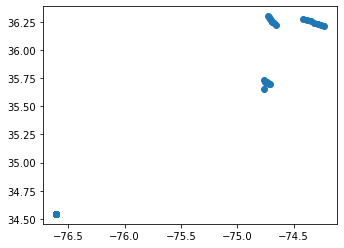

In [19]:
samples_gdf = gpd.GeoDataFrame(
    samples_df, geometry=gpd.points_from_xy(samples_df.lon, samples_df.lat))
samples_gdf.plot()

In [47]:
i=2
tsg_df.loc[start_times[i]:end_times[i]].hvplot.points('lon', 'lat', geo=True, c='chla', cmap='viridis', alpha=1,tiles='EsriNatGeo', width=700)

:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [lon,lat]   (chla)

In [462]:
start_times = ['2022-03-10 12:59','2022-03-10 17:35','2022-03-11 15:00','2022-03-11 16:05',]
end_times =   ['2022-03-10 15:30','2022-03-10 20:30','2022-03-11 15:46','2022-03-11 17:35',]

In [463]:
plt.rcParams.update({'font.size': 14})

In [464]:
import matplotlib.dates as mdates
myFmt = mdates.DateFormatter('%b %d %y - %H:%M')

In [125]:
samples_gdf_subset

,Cruise,Transect,Stations,Date,Ship Time,FCM,Nutrients,Viromics,Microscopy,16S/18S,...,sample_id,nanosa,picosa,prosa,synsa,nanosb,picosb,prosb,synsb,geometry
utc_dt,,,,,,,,,,,,,,,,,,,,,
2022-03-11 16:12:03,March,4,1,11-Mar-22,16:12:39,1,1,0,1,0,...,March_4_1,36.0,2207.0,1922.0,22376.0,26.0,2329.0,3123.0,23972.0,POINT (-74.71098 35.69329)
2022-03-11 16:30:05,March,4,2,11-Mar-22,16:30:56,1,1,0,1,0,...,March_4_2,51.0,2068.0,4420.0,21354.0,12.0,1925.0,4217.0,16428.0,POINT (-74.72119 35.70155)
2022-03-11 16:49:05,March,4,3,11-Mar-22,16:49:52,1,1,0,1,0,...,March_4_3,42.0,2064.0,1565.0,19810.0,29.0,2243.0,2135.0,20516.0,POINT (-74.73190 35.71004)
2022-03-11 17:09:00,March,4,4,11-Mar-22,17:09:07,1,1,0,1,0,...,March_4_4,145.0,4742.0,3921.0,19571.0,130.0,4926.0,4422.0,20467.0,POINT (-74.74589 35.71922)
2022-03-11 17:28:01,March,4,5,11-Mar-22,17:28:18,1,1,0,1,0,...,March_4_5,156.0,4592.0,2975.0,21354.0,68.0,2335.0,2120.0,11005.0,POINT (-74.75876 35.73110)


In [134]:
samples_gdf_subset.columns

Index(['Cruise', 'Transect', 'Stations', 'Date', 'Ship Time', 'FCM',
       'Nutrients', 'Viromics', 'Microscopy ', '16S/18S', 'Category',
       'datetime', 'lat', 'lon', 'chla', 'sal', 'temp', 'sample_id', 'nanosa',
       'picosa', 'prosa', 'synsa', 'nanosb', 'picosb', 'prosb', 'synsb',
       'geometry'],
      dtype='object')

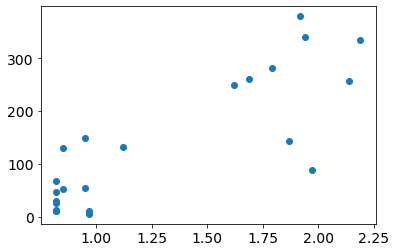

In [139]:
plt.scatter(samples_gdf.chla,samples_gdf.nanosb)

In [160]:
samples_gdf.columns

Index(['Cruise', 'Transect', 'Stations', 'Date', 'Ship Time', 'FCM',
       'Nutrients', 'Viromics', 'Microscopy ', '16S/18S', 'Category',
       'NO3+NO2A', 'NO2A', 'NH4A', 'PO4A', 'SiA', 'NO3+NO2B', 'NO2B', 'NH4B',
       'PO4B', 'SiB', 'datetime', 'lat', 'lon', 'chla', 'sal', 'temp',
       'sample_id', 'nanosa', 'picosa', 'prosa', 'synsa', 'nanosb', 'picosb',
       'prosb', 'synsb', 'geometry'],
      dtype='object')

## inline optical data

In [134]:
optical_df = pd.read_csv('data/acs_attempts/filter_edit_march2022_ACS_qc24.csv')
optical_df['dt'] = pd.to_datetime(optical_df['dt'])
optical_df['datetime']  = pd.to_datetime(optical_df['dt'])
optical_df= optical_df.set_index('dt')

In [135]:
bb3_df = pd.read_csv('data/acs_attempts/filter_edit_march2022_BB3_qc24.csv')
bb3_df['dt'] = pd.to_datetime(bb3_df['dt'])
bb3_df['datetime']  = pd.to_datetime(bb3_df['dt'])
bb3_df= bb3_df.set_index('dt')

In [136]:
bbp_1 = []
bbp_2 = []
bbp_3 = []

for i in range(len(optical_df)):
    row = bb3_df.iloc[bb3_df.index.get_loc(pd.to_datetime(optical_df.iloc[i].datetime), method='nearest')]
    bbp_1.append(row.bbp_1)
    bbp_2.append(row.bbp_2)
    bbp_3.append(row.bbp_3)
    
optical_df['bbp_1'] = bbp_1
optical_df['bbp_2'] = bbp_2
optical_df['bbp_3'] = bbp_3

optical_df['bbp_ratio_440'] = optical_df.bbp_1/(optical_df.iloc[:, 8+81:12+81].mean(axis=1) - optical_df.iloc[:, 8:12].mean(axis=1))
optical_df['bbp_ratio_440'].head(2)

# add in lat and lon
lats = []
lons = []
for i in range(len(optical_df)):
    row = tsg_df.iloc[tsg_df.index.get_loc(pd.to_datetime(optical_df.iloc[i].datetime), method='nearest')]
    lats.append(row.lat)
    lons.append(row.lon)

optical_df['lat'] = lats
optical_df['lon'] = lons

In [543]:
optical_df.columns[-15:]

Index(['ap676_lh', 'chl_ap676lh', 'gamma', 'Halh', 'chl_Halh', 'HH_G50',
       'HH_mphi', 'flag_bit', 'datetime', 'bbp_1', 'bbp_2', 'bbp_3',
       'bbp_ratio_440', 'lat', 'lon'],
      dtype='object')

In [554]:
chlas = []

for i in range(len(samples_df)):
    row = optical_df.iloc[optical_df.index.get_loc(samples_df.iloc[i].datetime, method='nearest')]
    chlas.append(row.chl_ap676lh)
    
samples_df['chla_lh'] = chlas

In [137]:
bb_part.columns

Index(['betap_1', 'betap_2', 'betap_3', 'bbp_1', 'bbp_2', 'bbp_3',
       'betap_sd_1', 'betap_sd_2', 'betap_sd_3', 'betap_n', 'gamma_bbp',
       'poc_1', 'poc_2', 'poc_3', 'cphyto_1', 'cphyto_2', 'cphyto_3',
       'datetime'],
      dtype='object')

------
2022-03-10 13:19:00 -> 2022-03-10 15:30:00
115


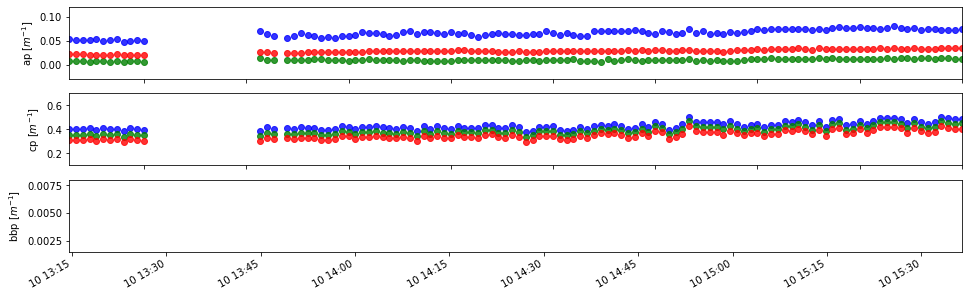

------
2022-03-10 17:47:00 -> 2022-03-10 20:30:00
155


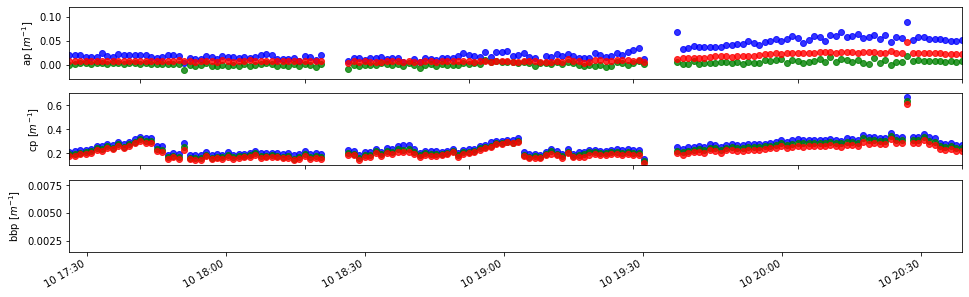

------
2022-03-11 15:08:00 -> 2022-03-11 15:42:00
35


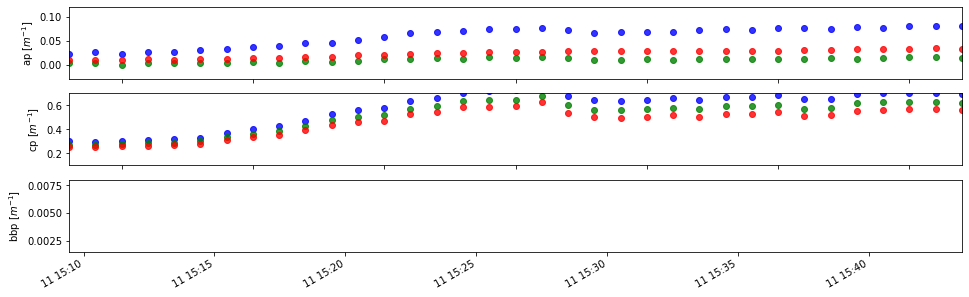

------
2022-03-11 16:09:00 -> 2022-03-11 17:35:00
80


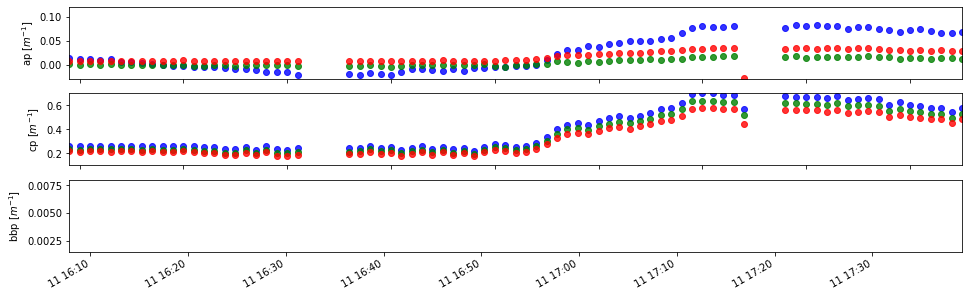

In [138]:
for i in range(len(start_times)):
    df_subset = df_part.loc[start_times[i]:end_times[i]]
    bb_subset = bb_part.loc[start_times[i]:end_times[i]]
    print('------')
    print(str(df_subset.iloc[0].datetime) + ' -> ' + str(df_subset.iloc[-1].datetime))
    print(len(df_subset))
    
    fig, ax = plt.subplots(3,1,figsize=(16,5))
    for idx, i in enumerate([0,83]):
        ax[idx].scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,8+i], label='440nm', color='blue', alpha=0.8)
        ax[idx].scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,35+i], label='550nm', color='green', alpha=0.8)
        ax[idx].scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,64+i], label='675nm', color='red', alpha=0.8)     
        ax[idx].set_xlabel('Time (UTC)')
        ax[idx].set_xlim(df_subset.datetime.min(), df_subset.datetime.max())
        fig.autofmt_xdate(rotation=30)
        
    ax[2].scatter(pd.to_datetime(bb_subset.datetime),bb_subset['betap_1'], label=' bb 440nm', color='blue', alpha=0.8)
    ax[0].set_ylim(-0.03,0.12)
    ax[1].set_ylim(.1,.7)
    ax[2].set_ylim(0.0015,0.008)
    ax[0].set_ylabel('ap [$m^{-1}$]')
    ax[1].set_ylabel('cp [$m^{-1}$]')
    ax[2].set_ylabel('bbp [$m^{-1}$]')
    # ax.xaxis.set_major_locator(plt.MaxNLocator(10))
    # fig.savefig('acs_abs.png')
    plt.show()

In [139]:
df_subset.iloc[:,8+83*2]

dt
2022-03-11 16:09:00    0.022815
2022-03-11 16:10:00    0.028668
2022-03-11 16:11:00    0.033735
2022-03-11 16:12:00    0.038201
2022-03-11 16:13:00    0.042552
                         ...   
2022-03-11 17:31:00    0.015057
2022-03-11 17:32:00    0.019508
2022-03-11 17:33:00    0.016699
2022-03-11 17:34:00    0.017581
2022-03-11 17:35:00    0.012680
Name: ap_sd_9, Length: 80, dtype: float64

In [140]:
bb_subset['betap_sd_1']

dt
2022-03-11 16:12:00    0.000053
2022-03-11 16:13:00    0.000048
2022-03-11 16:14:00    0.000102
2022-03-11 16:15:00    0.000047
2022-03-11 16:16:00    0.000043
                         ...   
2022-03-11 17:31:00    0.000055
2022-03-11 17:32:00    0.000061
2022-03-11 17:33:00    0.000057
2022-03-11 17:34:00    0.000055
2022-03-11 17:35:00    0.000053
Name: betap_sd_1, Length: 72, dtype: float64

------
2022-03-10 13:19:00 -> 2022-03-10 15:30:00
115


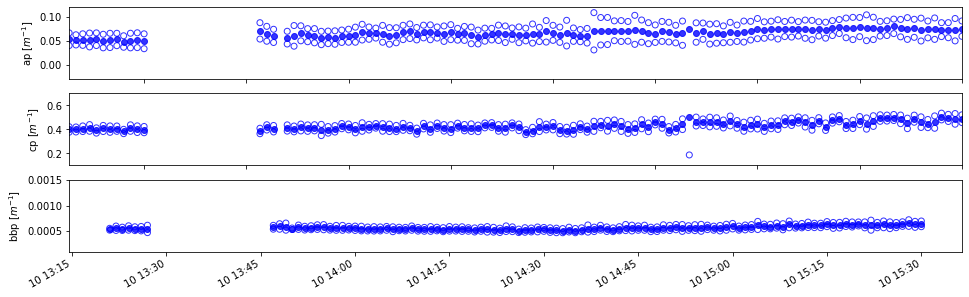

------
2022-03-10 17:47:00 -> 2022-03-10 20:30:00
155


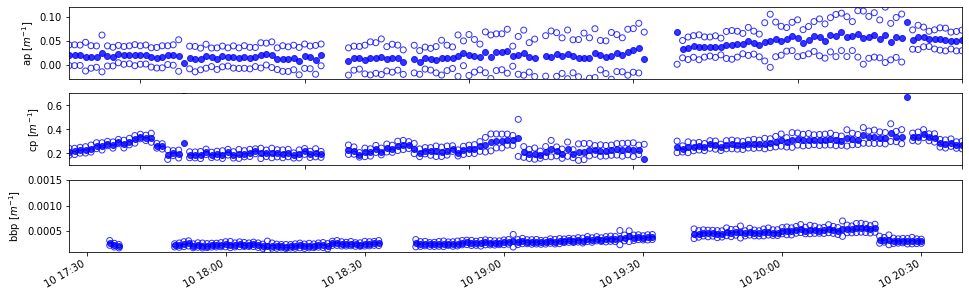

------
2022-03-11 15:08:00 -> 2022-03-11 15:42:00
35


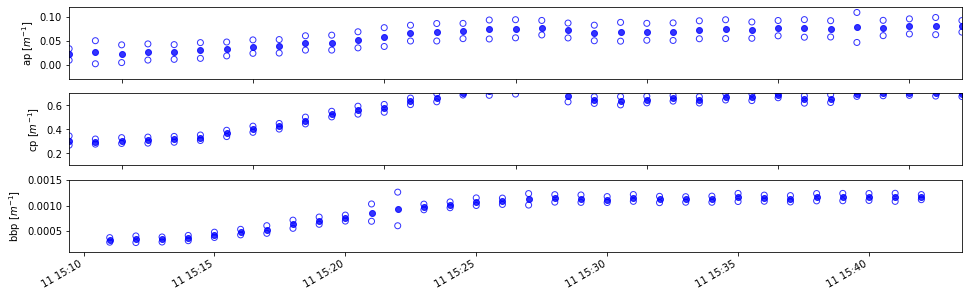

------
2022-03-11 16:09:00 -> 2022-03-11 17:35:00
80


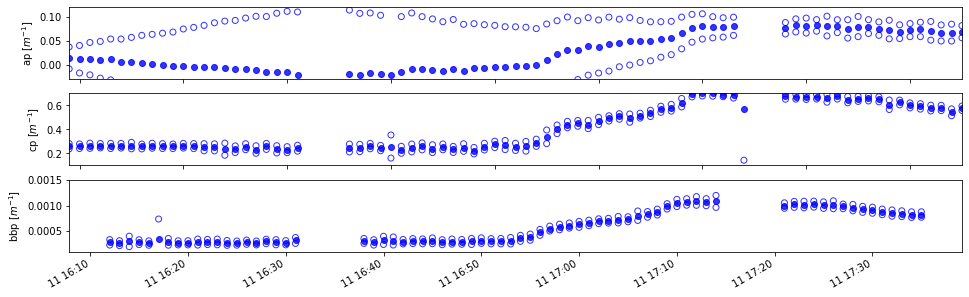

In [121]:
for i in range(len(start_times)):
    df_subset = df_part.loc[start_times[i]:end_times[i]]
    bb_subset = bb_part.loc[start_times[i]:end_times[i]]
    print('------')
    print(str(df_subset.iloc[0].datetime) + ' -> ' + str(df_subset.iloc[-1].datetime))
    print(len(df_subset))
    
    fig, ax = plt.subplots(3,1,figsize=(16,5))
    for idx, i in enumerate([0,83]):
        ax[idx].scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,8+i], label='440nm', color='blue', alpha=0.8)
        ax[idx].scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,8+i]+df_subset.iloc[:,8+i+83*2], label='440nm',  facecolors='none', edgecolors='blue', alpha=0.8)
        ax[idx].scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,8+i]-df_subset.iloc[:,8+i+83*2], label='440nm',  facecolors='none', edgecolors='blue', alpha=0.8)
#         ax[idx].scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,35+i], label='550nm', color='green', alpha=0.8)
#         ax[idx].scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,64+i], label='675nm', color='red', alpha=0.8)     
        ax[idx].set_xlabel('Time (UTC)')
        ax[idx].set_xlim(df_subset.datetime.min(), df_subset.datetime.max())
        fig.autofmt_xdate(rotation=30)
        
    ax[2].scatter(pd.to_datetime(bb_subset.datetime),bb_subset['betap_1'], label=' bb 440nm', color='blue', alpha=0.8)
    ax[2].scatter(pd.to_datetime(bb_subset.datetime),bb_subset['betap_1']+bb_subset['betap_sd_1'], label=' bb 440nm',  facecolors='none', edgecolors='blue', alpha=0.8)
    ax[2].scatter(pd.to_datetime(bb_subset.datetime),bb_subset['betap_1']-bb_subset['betap_sd_1'], label=' bb 440nm',  facecolors='none', edgecolors='blue', alpha=0.8)
    
    ax[0].set_ylim(-0.03,0.12)
    ax[1].set_ylim(.1,.7)
    ax[2].set_ylim(0.0001,0.0015)
    ax[0].set_ylabel('ap [$m^{-1}$]')
    ax[1].set_ylabel('cp [$m^{-1}$]')
    ax[2].set_ylabel('bbp [$m^{-1}$]')
    # ax.xaxis.set_major_locator(plt.MaxNLocator(10))
    # fig.savefig('acs_abs.png')
    plt.show()

In [197]:
df_subset.columns

Index(['ap_1', 'ap_2', 'ap_3', 'ap_4', 'ap_5', 'ap_6', 'ap_7', 'ap_8', 'ap_9',
       'ap_10',
       ...
       'poc', 'ap676_lh', 'chl_ap676lh', 'gamma', 'Halh', 'chl_Halh', 'HH_G50',
       'HH_mphi', 'flag_bit', 'datetime'],
      dtype='object', length=358)

In [ ]:
chl_ap676lh', 'gamma', 'Halh', 'chl_Halh', 'HH_G50

<ipython-input-495-4e60f48ef19d>:150: UserWarning: FixedFormatter should only be used together with FixedLocator
  temp_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
<ipython-input-495-4e60f48ef19d>:151: UserWarning: FixedFormatter should only be used together with FixedLocator
  density_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
<ipython-input-495-4e60f48ef19d>:152: UserWarning: FixedFormatter should only be used together with FixedLocator
  chla_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')


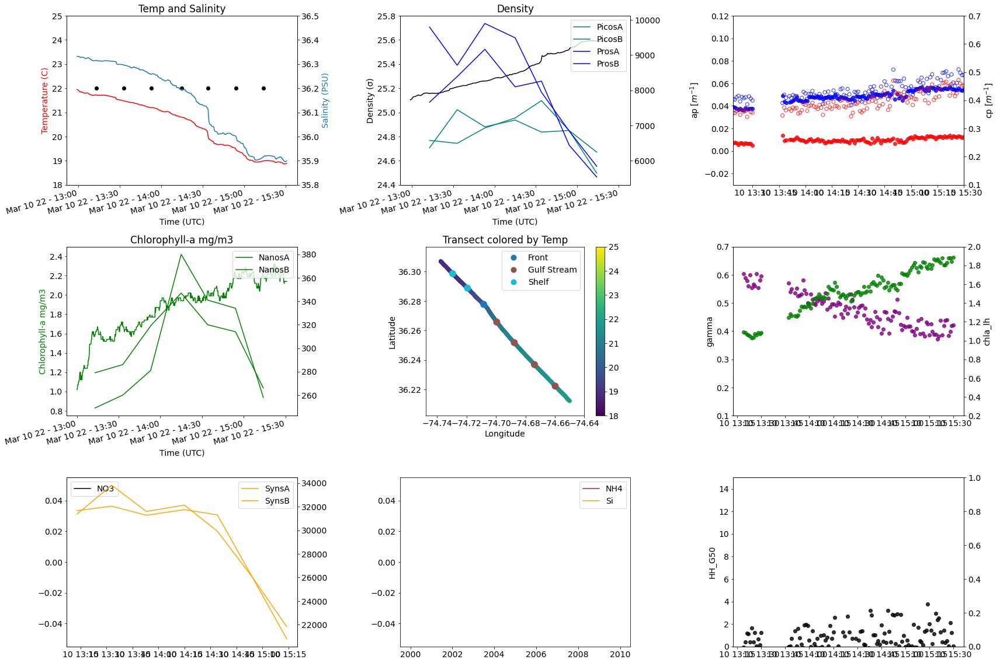

----------------------------------------------------------------------------------------------------------


<ipython-input-495-4e60f48ef19d>:150: UserWarning: FixedFormatter should only be used together with FixedLocator
  temp_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
<ipython-input-495-4e60f48ef19d>:151: UserWarning: FixedFormatter should only be used together with FixedLocator
  density_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
<ipython-input-495-4e60f48ef19d>:152: UserWarning: FixedFormatter should only be used together with FixedLocator
  chla_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')


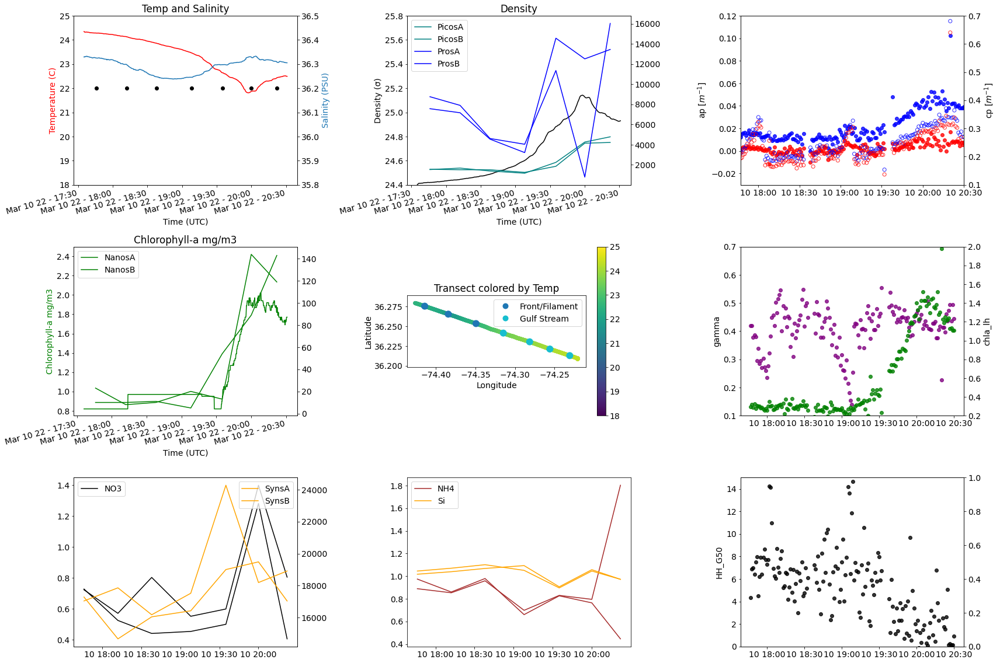

----------------------------------------------------------------------------------------------------------


<ipython-input-495-4e60f48ef19d>:150: UserWarning: FixedFormatter should only be used together with FixedLocator
  temp_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
<ipython-input-495-4e60f48ef19d>:151: UserWarning: FixedFormatter should only be used together with FixedLocator
  density_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
<ipython-input-495-4e60f48ef19d>:152: UserWarning: FixedFormatter should only be used together with FixedLocator
  chla_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')


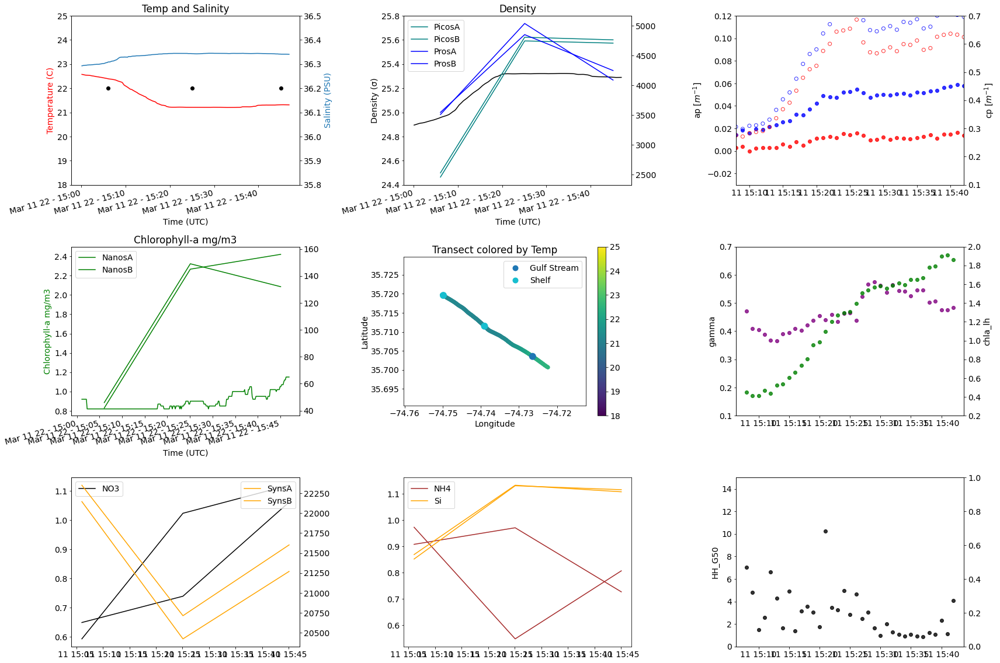

----------------------------------------------------------------------------------------------------------


<ipython-input-495-4e60f48ef19d>:150: UserWarning: FixedFormatter should only be used together with FixedLocator
  temp_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
<ipython-input-495-4e60f48ef19d>:151: UserWarning: FixedFormatter should only be used together with FixedLocator
  density_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
<ipython-input-495-4e60f48ef19d>:152: UserWarning: FixedFormatter should only be used together with FixedLocator
  chla_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')


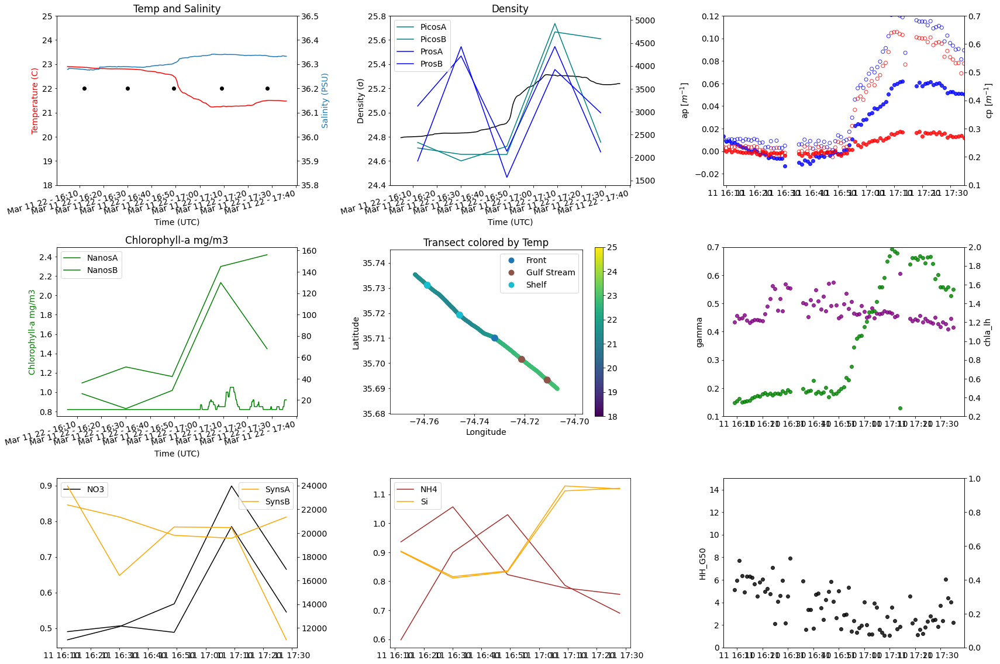

----------------------------------------------------------------------------------------------------------


In [495]:
# titles=['March 2022 T1','March 2022 T2', 'March 2022 T3','March 2022 T4']
for i in range(4):
# for i in [0,1,4,5,8]:
    # time series plot
    fig = plt.figure(figsize=(24,16))

    gs = fig.add_gridspec(3,3)

    temp_ax = fig.add_subplot(gs[0, 0]) # S/T
    density_ax = fig.add_subplot(gs[0, 1]) # density
    chla_ax = fig.add_subplot(gs[1, 0])
    map_ax = fig.add_subplot(gs[1, 1])
    nuts_ax = fig.add_subplot(gs[2, 0])
    nuts2_ax = fig.add_subplot(gs[2, 1])
    
    optical_ax = fig.add_subplot(gs[0,2])
    optical_prod_ax = fig.add_subplot(gs[1,2])
    optical_prod3_ax = fig.add_subplot(gs[2,2])
    
    
    fcm3_ax = nuts_ax.twinx()
    sal_ax = temp_ax.twinx()
    fcm_ax = density_ax.twinx()
    fcm2_ax = chla_ax.twinx()
    optical2_ax = optical_ax.twinx()
    optical_prod2_ax = optical_prod_ax.twinx()
    optical_prod4_ax = optical_prod3_ax.twinx()


    temp_ax.set_ylim(18, 25)
    sal_ax.set_ylim(35.8, 36.5)
    chla_ax.set_ylim(.75, 2.5)
    density_ax.set_ylim(24.4, 25.8)
#     density_grad_ax.set_ylim(-.1, .1)

#   ax.set_xlabel("Time (UTC)")
    temp_ax.set_title("Temp and Salinity")
    temp_ax.set_ylabel("Temperature (C)")
    sal_ax.set_ylabel("Salinity (PSU)")

    chla_ax.set_title("Chlorophyll-a mg/m3")
    chla_ax.set_ylabel("Chlorophyll-a mg/m3")

    density_ax.set_title('Density')
    density_ax.set_ylabel('Density (σ)')
#     density_grad_ax.set_ylabel('Density (∇)')
    
    temp_ax.set_xlabel("Time (UTC)")
    density_ax.set_xlabel("Time (UTC)")
    chla_ax.set_xlabel("Time (UTC)")
    
    map_ax.set_title('Transect colored by Temp')
    map_ax.set_ylabel('Latitude')
    map_ax.set_xlabel('Longitude')
    map_ax.ticklabel_format(useOffset=False)
    
    sample_len = len(samples_df.loc[start_times[i]:end_times[i]].index)
    temp_ax.scatter(samples_df.loc[start_times[i]:end_times[i]].index, [22]*sample_len, color='black', label='Sample')

    p1, = temp_ax.plot(tsg_df.loc[start_times[i]:end_times[i]].index, tsg_df.loc[start_times[i]:end_times[i]]['Temp_smooth'], color='red', label='Temp')
    p2, = sal_ax.plot(tsg_df.loc[start_times[i]:end_times[i]].index, tsg_df.loc[start_times[i]:end_times[i]]['Sal_smooth'], label='Salinity')

    p3, = density_ax.plot(tsg_df.loc[start_times[i]:end_times[i]].index, tsg_df.loc[start_times[i]:end_times[i]]['sigma'], label='Density (sigma)',  color='black')
#     p4, = density_grad_ax.plot(tsg_df.loc[start_times[i]:end_times[i]].index, tsg_df.loc[start_times[i]:end_times[i]]['sigma_grad'], label='Density (sigma)',  color='grey')

    p5, = chla_ax.plot(tsg_df[tsg_df['chla'].notnull()].loc[start_times[i]:end_times[i]].index, 
                     tsg_df[tsg_df['chla'].notnull()].loc[start_times[i]:end_times[i]]['chla'].rolling(window=7).median(), label='Chla mg/m3', color='green')
    
    gdf_subset = gdf.loc[start_times[i]:end_times[i]]
    gdf_subset.plot(column='Temp',ax=map_ax, legend=True, vmin=18, vmax=25)

    samples_gdf_subset = samples_gdf.loc[start_times[i]:end_times[i]]
    samples_gdf_subset.plot('Category',ax=map_ax,lw=2, legend=True, facecolor='none', s=100)
    
    fcm_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.picosa, color='teal', label='PicosA')
    fcm_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.picosb, color='teal', label='PicosB')
    
    fcm_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.prosa, color='blue', label='ProsA')
    fcm_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.prosb, color='blue', label='ProsB')
    
    fcm3_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.synsa, color='orange', label='SynsA')
    fcm3_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.synsb, color='orange', label='SynsB')

    fcm2_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.nanosa, color='green', label='NanosA')
    fcm2_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.nanosb, color='green', label='NanosB')

    # NO3+NO2A', 'NO2A', 'NH4A', 'PO4A', 'SiA', 'NO3+NO2B', 'NO2B', 'NH4B', 'PO4B', 'SiB'

    nuts_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset['NO3+NO2A'], color='black', label='NO3')
    nuts_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset['NO3+NO2B'], color='black')
    
    nuts2_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset['NH4A'], color='brown', label='NH4')
    nuts2_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset['NH4B'], color='brown')
    
    nuts2_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset['SiA'], color='orange', label='Si')
    nuts2_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset['SiB'], color='orange')
    
    fcm_ax.legend()
    fcm2_ax.legend()
    fcm3_ax.legend(loc='upper right')
    nuts_ax.legend(loc='upper left')
    nuts2_ax.legend()
    
    
    #####
    # optical stuff
    
    df_subset = df_part.loc[start_times[i]:end_times[i]]
    bb_subset = bb_part.loc[start_times[i]:end_times[i]]
    optical_ax.scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,16:20].mean(axis=1), label='440nm', color='blue', alpha=0.8)
    optical_ax.scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,35], label='440nm', color='red', alpha=0.8)
    optical2_ax.scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,8+81], label='440nm', facecolors='none', edgecolors='blue', alpha=0.8)
    optical2_ax.scatter(pd.to_datetime(df_subset.datetime),df_subset.iloc[:,35+81], label='440nm', facecolors='none', edgecolors='red', alpha=0.8)
    
    optical_ax.set_xlim(df_subset.datetime.min(), df_subset.datetime.max())
        
    optical_ax.set_ylim(-0.03,0.12)
    optical2_ax.set_ylim(.1,.7)

    optical_ax.set_ylabel('ap [$m^{-1}$]')
    optical2_ax.set_ylabel('cp [$m^{-1}$]')
    
    optical_prod_ax.scatter(pd.to_datetime(df_subset.datetime),df_subset['gamma'], label='gamma', color='purple', alpha=0.8)
    optical_prod_ax.set_ylabel('gamma')
    optical_prod_ax.set_ylim(0.1,0.7)
    
    optical_prod2_ax.scatter(pd.to_datetime(df_subset.datetime),df_subset['chl_ap676lh'], label='chla_lh', color='green', alpha=0.8)
    optical_prod2_ax.set_ylabel('chla_lh')
    optical_prod2_ax.set_ylim(0.2,2)
    
    optical_prod3_ax.scatter(pd.to_datetime(df_subset.datetime),df_subset['HH_G50'], label='HH_G50', color='black', alpha=0.8)
    optical_prod3_ax.set_ylabel('HH_G50')
    optical_prod3_ax.set_ylim(0,15)
    
#     optical_prod2_ax.scatter(pd.to_datetime(df_subset.datetime),df_subset['chl_ap676lh'], label='chla_lh', color='green', alpha=0.8)
#     optical_prod2_ax.set_ylabel('chla_lh')
#     optical_prod2_ax.set_ylim(0.2,2)
#     optical_ax.scatter(pd.to_datetime(bb_subset.datetime),bb_subset['bbp_1'], label=' bb 440nm', color='blue', alpha=0.8)
#     ax[2].set_ylim(0.0015,0.008)
#     ax[2].set_ylabel('bbp [$m^{-1}$]')


    
    
    #####
    
    map_ax.set_ylim(gdf_subset.lat.min()-0.01, gdf_subset.lat.max()+0.01)
    map_ax.set_xlim(gdf_subset.lon.min()-0.01, gdf_subset.lon.max()+0.01)
    
    temp_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
    density_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')
    chla_ax.set_xticklabels(temp_ax.get_xticklabels(), rotation=15, ha='right')

    temp_ax.xaxis.set_major_formatter(myFmt)
    density_ax.xaxis.set_major_formatter(myFmt)
    chla_ax.xaxis.set_major_formatter(myFmt)

    temp_ax.yaxis.label.set_color(p1.get_color())
    sal_ax.yaxis.label.set_color(p2.get_color())
    density_ax.yaxis.label.set_color(p3.get_color())
#     density_grad_ax.yaxis.label.set_color(p4.get_color())
    chla_ax.yaxis.label.set_color(p5.get_color())

    # Adjust spacings w.r.t. figsize
    fig.tight_layout()
#     fig.savefig('figs/march_transects'+titles[i] +'.png',dpi=600)
#     plt.close()
    plt.show()
    print('----------------------------------------------------------------------------------------------------------')

#         fig, ax = plt.subplots(figsize=(10,8))
#         sc = ax.scatter(df.loc[start_times[i]:end_times[i]]['TSG--sal'],  df.loc[start_times[i]:end_times[i]]['TSG--temp-SBE38'], alpha=0.8,c=df.loc[start_times[i]:end_times[i]]['lon'], cmap='cividis', label='chla')
#         ax.set_xlim(33,37)
#         ax.set_ylim(25,31)

#         ax.set_xlabel("Salinity")
#         ax.set_ylabel("Temperature")
#         ax.axvline(35.7)
#         ax.axvline(34.5)

#         fig.savefig('figs/march_transects'+titles[i] +'.png')
#         fig.colorbar(sc)

In [496]:
samples_df

,Cruise,Transect,Stations,Date,Ship Time,FCM,Nutrients,Viromics,Microscopy,16S/18S,...,sample_id,nanosa,picosa,prosa,synsa,nanosb,picosb,prosb,synsb,geometry
utc_dt,,,,,,,,,,,,,,,,,,,,,
2022-01-31 16:58:04,Feb,2,1,31-Jan-22,16:58:42,1,1,1,1,0,...,Feb_2_1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-76.60521 34.54495)
2022-01-31 17:42:02,Feb,2,2,31-Jan-22,17:42:24,1,1,1,1,0,...,Feb_2_2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-76.60521 34.54495)
2022-01-31 18:04:01,Feb,2,3,31-Jan-22,18:04:15,1,1,0,1,0,...,Feb_2_3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-76.60521 34.54495)
2022-01-31 18:35:02,Feb,2,4,31-Jan-22,18:35:25,1,1,1,1,0,...,Feb_2_4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-76.60521 34.54495)
2022-02-02 15:05:00,Feb,4,1,2-Feb-22,15:05:01,1,1,0,0,0,...,Feb_4_1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-76.60521 34.54495)
2022-02-02 15:28:03,Feb,4,2,2-Feb-22,15:28:31,0,1,0,0,0,...,Feb_4_2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-76.60521 34.54495)
2022-02-02 15:38:05,Feb,4,3,2-Feb-22,15:38:52,1,1,0,0,0,...,Feb_4_3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-76.60521 34.54495)
2022-02-02 16:01:05,Feb,4,4,2-Feb-22,16:01:51,1,1,0,0,0,...,Feb_4_4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-76.60521 34.54495)
2022-02-02 16:24:05,Feb,4,5,2-Feb-22,16:24:51,1,1,0,0,0,...,Feb_4_5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-76.60521 34.54495)


In [326]:
trios_gdf.loc[start_times[i]:end_times[i]]

,320,321,322,323,324,325,326,327,328,329,...,949,950,chla_oci,TimeStamp,lat,lon,sal,temp,geometry,l2_chla
2022-03-11 16:05:00,0.004687,0.004794,0.004818,0.004710,0.004616,0.004543,0.004566,0.004471,0.004301,0.004375,...,-0.000452,-0.000403,0.452580,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968),1.097678
2022-03-11 16:05:00,0.005936,0.006066,0.006113,0.006019,0.005909,0.005820,0.005840,0.005733,0.005543,0.005609,...,-0.001371,-0.001309,0.449187,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968),1.084853
2022-03-11 16:05:00,0.005911,0.006005,0.006022,0.005939,0.005852,0.005781,0.005792,0.005674,0.005476,0.005536,...,-0.000854,-0.000848,0.444586,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968),1.078581
2022-03-11 16:05:00,0.004300,0.004413,0.004449,0.004378,0.004315,0.004268,0.004299,0.004209,0.004042,0.004117,...,-0.000103,-0.000193,0.451366,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968),1.090956
2022-03-11 16:05:00,0.003982,0.004064,0.004078,0.003997,0.003930,0.003880,0.003910,0.003837,0.003698,0.003781,...,-0.000064,-0.000012,0.434928,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968),1.083333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-11 16:36:00,0.005626,0.005715,0.005744,0.005675,0.005601,0.005541,0.005556,0.005475,0.005330,0.005398,...,-0.000848,-0.000834,0.397696,3/11/2022 12:36,35.704203,-74.724397,36.2870,22.7628,POINT (-74.72440 35.70420),1.026841
2022-03-11 16:36:00,0.005081,0.005171,0.005201,0.005148,0.005092,0.005050,0.005071,0.004991,0.004851,0.004907,...,-0.000396,-0.000396,0.398682,3/11/2022 12:36,35.704203,-74.724397,36.2870,22.7628,POINT (-74.72440 35.70420),1.025823
2022-03-11 16:36:00,0.004782,0.004871,0.004907,0.004859,0.004811,0.004774,0.004795,0.004727,0.004604,0.004665,...,-0.000312,-0.000304,0.402135,3/11/2022 12:36,35.704203,-74.724397,36.2870,22.7628,POINT (-74.72440 35.70420),1.037987
2022-03-11 16:36:00,0.004699,0.004804,0.004823,0.004745,0.004675,0.004624,0.004653,0.004569,0.004415,0.004509,...,0.000573,0.000568,0.447891,3/11/2022 12:36,35.704203,-74.724397,36.2870,22.7628,POINT (-74.72440 35.70420),1.078208


In [58]:
from geopy import distance

def get_dist(df, df_start):
    distances = []
    first_row = df_start.iloc[0]
    for row in df.itertuples(index=False):
        distances.append(distance.distance((row.lat, row.lon),(first_row.lat,first_row.lon)).meters)
    return(distances)

In [131]:
acs_wavelength[16:20]

array([466.6, 471.3, 475.9, 481. ])

In [123]:
optical_df.iloc[:,16:20]

,ap_17,ap_18,ap_19,ap_20
dt,,,,
2022-03-09 18:42:00,0.039958,0.035367,0.032703,0.031237
2022-03-09 18:43:00,0.050621,0.047961,0.045834,0.043521
2022-03-09 18:44:00,0.050369,0.047690,0.045511,0.043554
2022-03-09 18:45:00,0.051559,0.048719,0.046357,0.043797
2022-03-09 18:46:00,0.050680,0.047969,0.045437,0.043244
...,...,...,...,...
2022-03-11 17:37:00,0.055116,0.052183,0.050061,0.048111
2022-03-11 17:38:00,0.052866,0.049898,0.048031,0.046269
2022-03-11 17:39:00,0.053588,0.050781,0.048627,0.046896


In [143]:
optical_df.iloc[:,16:20].mean(axis=1)

dt
2022-03-09 18:42:00    0.034816
2022-03-09 18:43:00    0.046984
2022-03-09 18:44:00    0.046781
2022-03-09 18:45:00    0.047608
2022-03-09 18:46:00    0.046833
                         ...   
2022-03-11 17:37:00    0.051368
2022-03-11 17:38:00    0.049266
2022-03-11 17:39:00    0.049973
2022-03-11 17:40:00    0.052741
2022-03-11 17:41:00    0.049641
Length: 836, dtype: float64

In [590]:
optical_df.columns[-35:]

Index(['cp_sd_81', 'cp_sd_82', 'cp_sd_83', 'ap_n', 'cp_n', 'ad_model400',
       'agaus406', 'agaus434', 'agaus453', 'agaus470', 'agaus492', 'agaus523',
       'agaus550', 'agaus584', 'agaus617', 'agaus638', 'agaus660', 'agaus675',
       'agaus-mae', 'poc', 'ap676_lh', 'chl_ap676lh', 'gamma', 'Halh',
       'chl_Halh', 'HH_G50', 'HH_mphi', 'flag_bit', 'datetime', 'bbp_1',
       'bbp_2', 'bbp_3', 'bbp_ratio_440', 'lat', 'lon'],
      dtype='object')

0.0020720857821066

In [145]:
optical_df.drop(optical_df[optical_df.iloc[:,16:20].mean(axis=1)<0].index,inplace=True)
# df.drop(df[df.score < 50].index, inplace=True)


In [267]:
trios_gdf.loc[start_times[i]:end_times[i]]

,320,321,322,323,324,325,326,327,328,329,...,948,949,950,chla_oci,TimeStamp,lat,lon,sal,temp,geometry
2022-03-11 16:05:00,0.004687,0.004794,0.004818,0.004710,0.004616,0.004543,0.004566,0.004471,0.004301,0.004375,...,-0.000507,-0.000452,-0.000403,0.452580,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968)
2022-03-11 16:05:00,0.005936,0.006066,0.006113,0.006019,0.005909,0.005820,0.005840,0.005733,0.005543,0.005609,...,-0.001420,-0.001371,-0.001309,0.449187,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968)
2022-03-11 16:05:00,0.005911,0.006005,0.006022,0.005939,0.005852,0.005781,0.005792,0.005674,0.005476,0.005536,...,-0.000864,-0.000854,-0.000848,0.444586,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968)
2022-03-11 16:05:00,0.004300,0.004413,0.004449,0.004378,0.004315,0.004268,0.004299,0.004209,0.004042,0.004117,...,-0.000080,-0.000103,-0.000193,0.451366,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968)
2022-03-11 16:05:00,0.003982,0.004064,0.004078,0.003997,0.003930,0.003880,0.003910,0.003837,0.003698,0.003781,...,-0.000139,-0.000064,-0.000012,0.434928,3/11/2022 12:05,35.689685,-74.706858,36.2786,22.9047,POINT (-74.70686 35.68968)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-11 16:36:00,0.005626,0.005715,0.005744,0.005675,0.005601,0.005541,0.005556,0.005475,0.005330,0.005398,...,-0.000882,-0.000848,-0.000834,0.397696,3/11/2022 12:36,35.704203,-74.724397,36.2870,22.7628,POINT (-74.72440 35.70420)
2022-03-11 16:36:00,0.005081,0.005171,0.005201,0.005148,0.005092,0.005050,0.005071,0.004991,0.004851,0.004907,...,-0.000383,-0.000396,-0.000396,0.398682,3/11/2022 12:36,35.704203,-74.724397,36.2870,22.7628,POINT (-74.72440 35.70420)
2022-03-11 16:36:00,0.004782,0.004871,0.004907,0.004859,0.004811,0.004774,0.004795,0.004727,0.004604,0.004665,...,-0.000336,-0.000312,-0.000304,0.402135,3/11/2022 12:36,35.704203,-74.724397,36.2870,22.7628,POINT (-74.72440 35.70420)
2022-03-11 16:36:00,0.004699,0.004804,0.004823,0.004745,0.004675,0.004624,0.004653,0.004569,0.004415,0.004509,...,0.000656,0.000573,0.000568,0.447891,3/11/2022 12:36,35.704203,-74.724397,36.2870,22.7628,POINT (-74.72440 35.70420)


In [527]:
np.max((samples_gdf.synsa+samples_gdf.synsb)/2)

32930.5

In [ ]:
ax.set_ylim(1200,8000)
ax2.set_ylim(1800,15000)
ax3.set_ylim(16000,34000)
ax4.set_ylim(8,370)

In [ ]:

        ax2.plot(sample_df_distances, (samples_gdf_subset.prosa+samples_gdf_subset.prosb)/2, color='blue', label='Pros')
#         fcm_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.prosb, color='blue', label='ProsB')

        ax3.plot(sample_df_distances, (samples_gdf_subset.synsa+samples_gdf_subset.synsb)/2, color='orange', label='Syns')
#         fcm3_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.synsb, color='orange', label='SynsB')

        ax4.plot(sample_df_distances, (samples_gdf_subset.nanosa+samples_gdf_subset.nanosb)/2, color='green', label='Nanos')
#         fcm2_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.nanosb, color='green', label='NanosB')

In [553]:
samples_gdf_subset

,Cruise,Transect,Stations,Date,Ship Time,FCM,Nutrients,Viromics,Microscopy,16S/18S,...,nanosa,picosa,prosa,synsa,nanosb,picosb,prosb,synsb,geometry,chla_lh
utc_dt,,,,,,,,,,,,,,,,,,,,,
2022-03-10 13:13:00,March,1,1,10-Mar-22,13:13:02,1,0,0,1,0,...,279.0,6368.0,9794.0,31370.0,249.0,6578.0,7662.0,31663.0,POINT (-74.65980 36.22227),dt 2022-03-09 18:42:00 1.244862 2022-03-09 ...
2022-03-10 13:33:00,March,1,2,10-Mar-22,13:33:07,1,0,0,1,0,...,286.0,7448.0,8709.0,33818.0,260.0,6494.0,8388.0,32043.0,POINT (-74.67386 36.23684),dt 2022-03-09 18:42:00 1.244862 2022-03-09 ...
2022-03-10 13:53:02,March,1,3,10-Mar-22,13:53:23,1,0,0,1,0,...,319.0,6963.0,9897.0,31593.0,281.0,6929.0,9164.0,31272.0,POINT (-74.68758 36.25180),dt 2022-03-09 18:42:00 1.244862 2022-03-09 ...
2022-03-10 14:15:00,March,1,4,10-Mar-22,14:15:09,1,0,0,1,0,...,347.0,7155.0,9489.0,32132.0,380.0,7214.0,8098.0,31744.0,POINT (-74.69948 36.26578),dt 2022-03-09 18:42:00 1.244862 2022-03-09 ...
2022-03-10 14:34:01,March,1,5,10-Mar-22,14:34:17,1,0,0,1,0,...,320.0,6813.0,7945.0,29922.0,341.0,7706.0,8260.0,31309.0,POINT (-74.70834 36.27779),dt 2022-03-09 18:42:00 1.244862 2022-03-09 ...
2022-03-10 14:54:04,March,1,6,10-Mar-22,14:54:40,1,0,0,1,0,...,314.0,6859.0,6846.0,26049.0,334.0,6856.0,6445.0,26056.0,POINT (-74.71931 36.28881),dt 2022-03-09 18:42:00 1.244862 2022-03-09 ...
2022-03-10 15:14:03,March,1,7,10-Mar-22,15:14:31,1,0,0,1,0,...,266.0,6244.0,5841.0,21836.0,258.0,5648.0,5535.0,20801.0,POINT (-74.72944 36.29868),dt 2022-03-09 18:42:00 1.244862 2022-03-09 ...


In [625]:
optical_df

,ap_1,ap_2,ap_3,ap_4,ap_5,ap_6,ap_7,ap_8,ap_9,ap_10,...,HH_G50,HH_mphi,flag_bit,datetime,bbp_1,bbp_2,bbp_3,bbp_ratio_440,lat,lon
dt,,,,,,,,,,,,,,,,,,,,,
2022-03-09 18:42:00,0.054286,0.053967,0.055583,0.060051,0.054838,0.051890,0.054721,0.053628,0.050787,0.052055,...,5.502615,-3.879361,29,2022-03-09 18:42:00,0.003455,0.004721,0.002685,0.006414,35.860632,-74.857568
2022-03-09 18:43:00,0.051842,0.051306,0.059608,0.059226,0.057682,0.061378,0.061073,0.060683,0.062038,0.062314,...,1.073018,-4.461004,0,2022-03-09 18:43:00,0.003455,0.004721,0.002685,0.006907,35.861697,-74.850428
2022-03-09 18:44:00,0.067635,0.062139,0.066465,0.066111,0.062873,0.065419,0.064398,0.062804,0.063652,0.062608,...,2.257454,-4.258983,0,2022-03-09 18:44:00,0.003455,0.004721,0.002685,0.007708,35.863058,-74.843455
2022-03-09 18:45:00,0.053720,0.058458,0.065586,0.062781,0.063789,0.067014,0.066339,0.064828,0.065836,0.065036,...,1.527433,-4.384732,0,2022-03-09 18:45:00,0.003455,0.004721,0.002685,0.005359,35.864225,-74.836513
2022-03-09 18:46:00,0.067145,0.070152,0.070659,0.069063,0.069031,0.070461,0.069130,0.066024,0.067746,0.065526,...,1.121356,-4.419614,0,2022-03-09 18:46:00,0.004335,0.005273,0.002890,0.007490,35.865298,-74.829327
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-11 17:37:00,0.075266,0.068586,0.076273,0.070636,0.068023,0.072657,0.069881,0.068011,0.068648,0.068224,...,2.226551,-4.204405,0,2022-03-11 17:37:00,0.005511,0.004918,0.002384,0.010968,35.735447,-74.763570
2022-03-11 17:38:00,0.067108,0.063084,0.071370,0.069987,0.069465,0.072557,0.070377,0.068121,0.067808,0.066938,...,2.829214,-4.100244,0,2022-03-11 17:38:00,0.005576,0.004822,0.002333,0.011191,35.735497,-74.763430
2022-03-11 17:39:00,0.067761,0.064856,0.074594,0.073374,0.072141,0.073952,0.071790,0.069086,0.069759,0.069019,...,2.292454,-4.162403,0,2022-03-11 17:39:00,0.005432,0.004809,0.002260,0.011194,35.735530,-74.763302


In [613]:
samples_gdf_subset['NO3+NO2A']

utc_dt
2022-03-11 15:06:03    0.593
2022-03-11 15:25:05    1.023
2022-03-11 15:45:04    1.119
Name: NO3+NO2A, dtype: float64

In [632]:
samples_gdf_subset.columns

Index(['Cruise', 'Transect', 'Stations', 'Date', 'Ship Time', 'FCM',
       'Nutrients', 'Viromics', 'Microscopy ', '16S/18S', 'Category',
       'NO3+NO2A', 'NO2A', 'NH4A', 'PO4A', 'SiA', 'NO3+NO2B', 'NO2B', 'NH4B',
       'PO4B', 'SiB', 'datetime', 'lat', 'lon', 'chla', 'sal', 'temp',
       'sample_id', 'nanosa', 'picosa', 'prosa', 'synsa', 'nanosb', 'picosb',
       'prosb', 'synsb', 'geometry', 'chla_lh'],
      dtype='object')

In [688]:
import math
def v_for_sphere(r):
    return(4/3*math.pi*r**3)

In [770]:
optical_df['bbp_ratio_532'] = optical_df.bbp_2/(optical_df.iloc[:, 29+81:31+81].mean(axis=1) - optical_df.iloc[:, 29:31].mean(axis=1))
optical_df['bbp_ratio_532']

dt
2022-03-09 18:42:00    0.008656
2022-03-09 18:43:00    0.009368
2022-03-09 18:44:00    0.010545
2022-03-09 18:45:00    0.007560
2022-03-09 18:46:00    0.009210
                         ...   
2022-03-11 17:37:00    0.009600
2022-03-11 17:38:00    0.009476
2022-03-11 17:39:00    0.009702
2022-03-11 17:40:00    0.009871
2022-03-11 17:41:00    0.010223
Name: bbp_ratio_532, Length: 833, dtype: float64

In [727]:
cb_colors = ['#000000',
'#E69F00',
'#56B4E9',
'#009E73',
'#F0E442',
'#0072B2',
'#D55E00',
'#CC79A7']

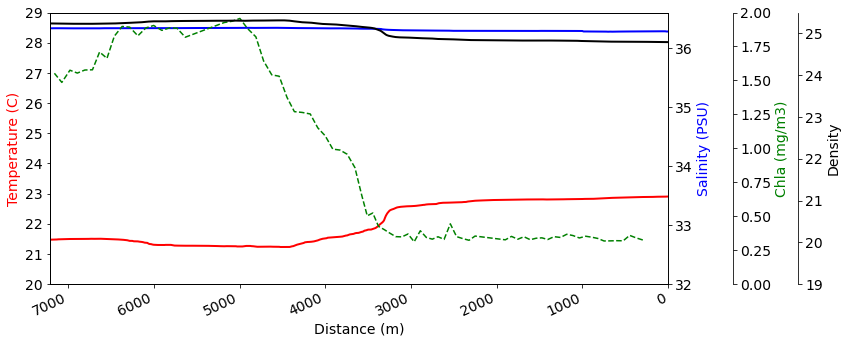

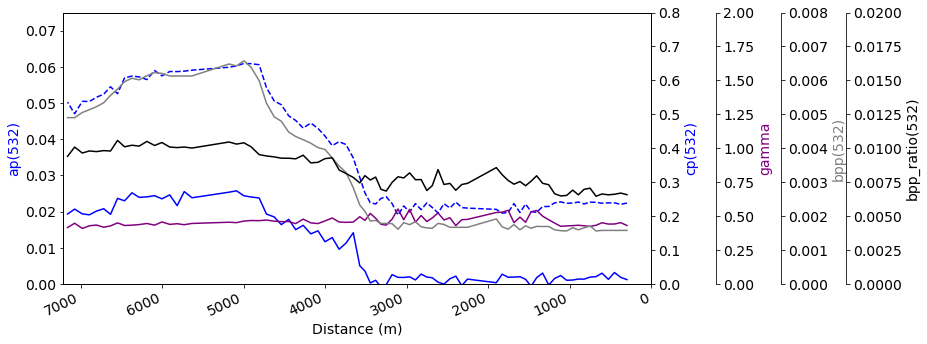

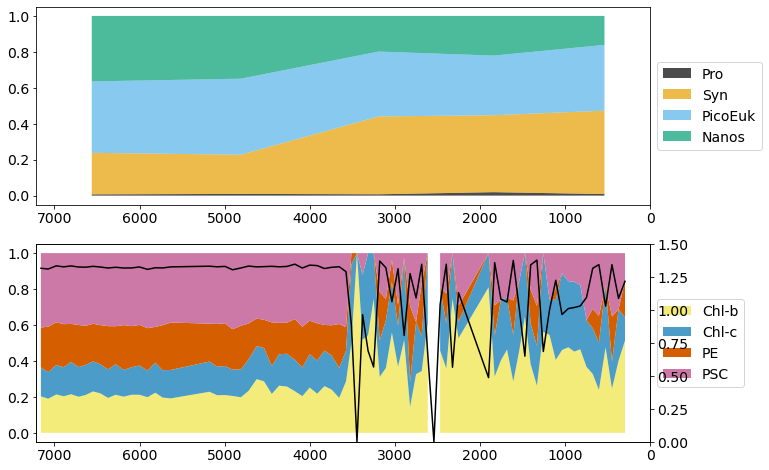

#######################################################################


In [772]:
df = tsg_df
for i in range(len(start_times)):
    if i != 3:
        pass
    else:
        fig, ax = plt.subplots(figsize=(12,5))

        ax1 = ax.twinx()
        ax2 = ax.twinx()
        ax3 = ax.twinx()

        ax.set_ylim(20, 29)
        ax1.set_ylim(32, 36.6)
        ax2.set_ylim(.0, 2)
        ax3.set_ylim(19, 25.5)


        ax.set_xlabel("Distance (m)")
        ax.set_ylabel("Temperature (C)")
        ax1.set_ylabel("Salinity (PSU)")
        ax2.set_ylabel("Chla (mg/m3)")
        ax3.set_ylabel("Density")
        
        df_distances = get_dist(df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        optical_df_distances = get_dist(optical_df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        
        ax.set_xlim(df_distances[-1], df_distances[0])

        p1, = ax.plot(df_distances, df.loc[start_times[i]:end_times[i]]['Temp_smooth'], color='red', label='Temp', lw=2)
        p2, = ax1.plot(df_distances, df.loc[start_times[i]:end_times[i]]['Sal_smooth'], label='Salinity', color='blue', lw=2)
        p3,  = ax2.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['chl_ap676lh'], label='chl_ap676lh',  color='green', ls='--')
        p4, = ax3.plot(df_distances, tsg_df.loc[start_times[i]:end_times[i]]['sigma'],  color='black', lw=2)

        ax2.spines['right'].set_position(('outward', 65)) 
        ax3.spines['right'].set_position(('outward', 130)) 


        fig.autofmt_xdate(rotation=25)
  

        ax.yaxis.label.set_color(p1.get_color())
        ax1.yaxis.label.set_color(p2.get_color())
        ax2.yaxis.label.set_color(p3.get_color())
        ax3.yaxis.label.set_color(p4.get_color())

        fig.tight_layout()

        plt.savefig('simple_physical_march.png',dpi=300)
        
        plt.show()
        
        ################################
        
        fig, ax = plt.subplots(figsize=(13.1,5))
                    
      
        ax1 = ax.twinx()
        ax2 = ax.twinx()
        ax3 = ax.twinx()
        ax4 = ax.twinx()

        ax.set_ylim(0,.075)
        ax1.set_ylim(0,.8)
        ax2.set_ylim(0,2)
        ax3.set_ylim(0, 0.008)
        ax4.set_ylim(0.000,0.02)
        
        p1, = ax.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]].iloc[:,29:32].mean(axis=1), label='ap(532)',  color='blue')
        p2, = ax1.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]].iloc[:,29+83:32+83].mean(axis=1), label='cp(532)',  color='blue', ls='--')
        p3, = ax2.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['gamma'], label='gamma',  color='purple')
        p4, = ax3.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['bbp_2'], label='bbp_2',  color='grey')
        p5, = ax4.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['bbp_ratio_532'], label='bbp_ratio_532',  color='black')


        ax.set_xlabel("Distance (m)")
        
        ax.set_ylabel("ap(532)")
        ax1.set_ylabel("cp(532)")
        ax2.set_ylabel("gamma")
        ax3.set_ylabel("bpp(532)")
        ax4.set_ylabel("bpp_ratio(532)")
        
        
        df_distances = get_dist(df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        optical_df_distances = get_dist(optical_df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        
        ax.set_xlim(df_distances[-1], df_distances[0])

        ax2.spines['right'].set_position(('outward', 65)) 
        ax3.spines['right'].set_position(('outward', 130)) 
        ax4.spines['right'].set_position(('outward', 195)) 


        fig.autofmt_xdate(rotation=25)
  

        ax.yaxis.label.set_color(p1.get_color())
        ax1.yaxis.label.set_color(p2.get_color())
        ax2.yaxis.label.set_color(p3.get_color())
        ax3.yaxis.label.set_color(p4.get_color())
        ax4.yaxis.label.set_color(p5.get_color())

        fig.tight_layout()
        
        plt.savefig('simple_optical_march.png',dpi=300)
        
        plt.show()
        
    
        ###########################
        
        # gaussian decomp section
            
        
        samples_gdf_subset = samples_gdf.loc[start_times[i]:end_times[i]]
        sample_df_distances = get_dist(samples_gdf_subset,df.loc[start_times[i]:end_times[i]])
        optical_df_distances = get_dist(optical_df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])

        
        fig, (ax,ax1) = plt.subplots(2,1,figsize=(11,8))
        # normalize by the total
        total_pop = samples_gdf_subset.prosa*v_for_sphere(.3) + samples_gdf_subset.synsa*v_for_sphere(.5) + samples_gdf_subset.picosa*v_for_sphere(1) +  samples_gdf_subset.nanosa*v_for_sphere(3)
        # total_pop = total_pop / samples_gdf_subset.chla_lh
        
        y = np.row_stack((samples_gdf_subset.prosa*v_for_sphere(.3)/total_pop, samples_gdf_subset.synsa*v_for_sphere(.5)/total_pop, samples_gdf_subset.picosa*v_for_sphere(1)/total_pop,  samples_gdf_subset.nanosa*v_for_sphere(3)/total_pop))  
        # this call to 'cumsum' (cumulative sum), passing in your y data, 
        # is necessary to avoid having to manually order the datasets
        x = sample_df_distances
        y_stack = np.cumsum(y, axis=0)   # a 3x10 array


        ax.fill_between(x, 0, y_stack[0,:], facecolor=cb_colors[0], alpha=.7, label='Pro')
        ax.fill_between(x, y_stack[0,:], y_stack[1,:], facecolor=cb_colors[1], alpha=.7, label='Syn')
        ax.fill_between(x, y_stack[1,:], y_stack[2,:], facecolor=cb_colors[2],alpha=0.7, label='PicoEuk')
        ax.fill_between(x, y_stack[2,:], y_stack[3,:], facecolor=cb_colors[3],alpha=0.7,label='Nanos')
        
        ax.set_xlim(df_distances[-1], df_distances[0])
        
        ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
        
        if optical_df.loc[start_times[i]:end_times[i]].empty:
            pass
        else:
                        
            chlb = optical_df.loc[start_times[i]:end_times[i]]['agaus660']
            PSC = optical_df.loc[start_times[i]:end_times[i]]['agaus523']
            PPC = optical_df.loc[start_times[i]:end_times[i]]['agaus492']
            chlc = optical_df.loc[start_times[i]:end_times[i]]['agaus638']
            PE = optical_df.loc[start_times[i]:end_times[i]]['agaus550']

            total_pigment = chlb + chlc + PE +PSC# +PPC

            y = np.row_stack((chlb/total_pigment, chlc/total_pigment, PE/total_pigment, PSC/total_pigment))#, PPC/total_pigment))   
            # this call to 'cumsum' (cumulative sum), passing in your y data, 
            # is necessary to avoid having to manually order the datasets
            x = optical_df_distances
            y_stack = np.cumsum(y, axis=0)   # a 3x10 array


            ax1.fill_between(x, 0, y_stack[0,:], facecolor=cb_colors[4], alpha=.7, label='Chl-b')
            ax1.fill_between(x, y_stack[0,:], y_stack[1,:], facecolor=cb_colors[5], alpha=.7, label='Chl-c')
            ax1.fill_between(x, y_stack[1,:], y_stack[2,:], facecolor=cb_colors[6], label='PE')
            ax1.fill_between(x, y_stack[2,:], y_stack[3,:], facecolor=cb_colors[7], label='PSC')
#             ax1.fill_between(x, y_stack[3,:], y_stack[4,:], facecolor="blue", label='PPC')

            ax1.set_xlim(df_distances[-1], df_distances[0])
            ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
        
            ppc_dict = {
                'chlb':optical_df.loc[start_times[i]:end_times[i]]['agaus660'].values,
                'PSC' : optical_df.loc[start_times[i]:end_times[i]]['agaus523'].values,
                'chlc' : optical_df.loc[start_times[i]:end_times[i]]['agaus638'].values,
                'PE' : optical_df.loc[start_times[i]:end_times[i]]['agaus550'].values}

            ax_shannon = ax1.twinx()
            shannon_h = []
            for i in range(len(optical_df.loc[start_times[i]:end_times[i]]['agaus660'].values)):
                elems = [elem[i] for elem in ppc_dict.values()]
                keys = ['chlb', 'PSC', 'chlc', 'PE']
                single_dict = {
                    keys[0] : elems[0],
                    keys[1] : elems[1],
                    keys[2] : elems[2],
                    keys[3] : elems[3],
                }
                shannon_h.append(sdi(single_dict))
            ax_shannon.plot(optical_df_distances,shannon_h, c='k')
            ax_shannon.set_ylim(0,1.5)

            
        plt.savefig('pcc_gauss_march.png',dpi=300)
        
        plt.show()
        
        print('#######################################################################')
                

In [789]:
plt.rcParams.update({'font.size': 20})

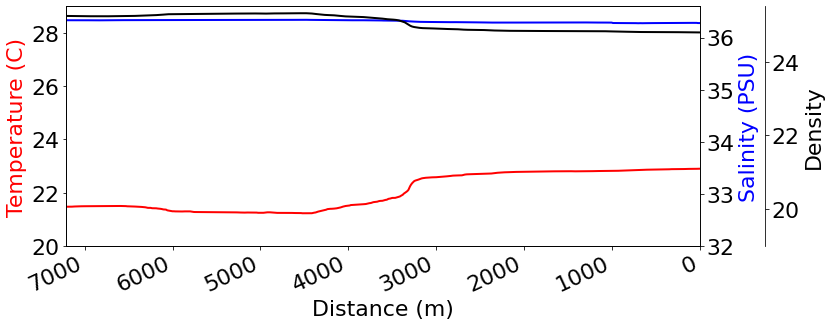

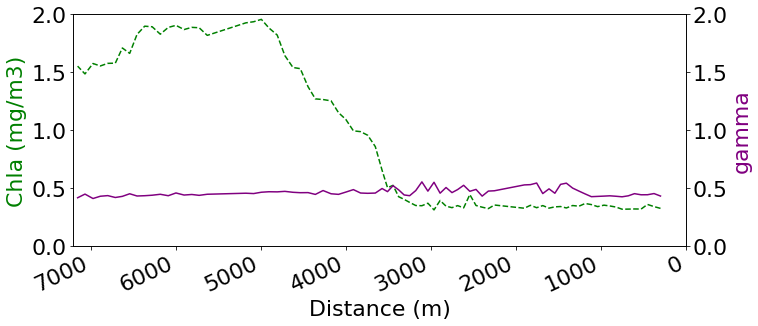

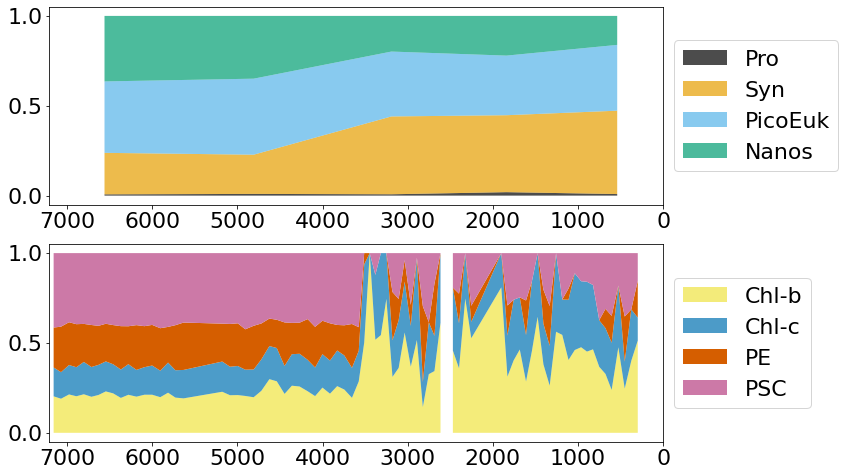

#######################################################################


In [793]:
df = tsg_df
for i in range(len(start_times)):
    if i != 3:
        pass
    else:
        fig, ax = plt.subplots(figsize=(12,5))

        ax1 = ax.twinx()
#         ax2 = ax.twinx()
        ax3 = ax.twinx()

        ax.set_ylim(20, 29)
        ax1.set_ylim(32, 36.6)
#         ax2.set_ylim(.0, 2)
        ax3.set_ylim(19, 25.5)


        ax.set_xlabel("Distance (m)")
        ax.set_ylabel("Temperature (C)")
        ax1.set_ylabel("Salinity (PSU)")
#         ax2.set_ylabel("Chla (mg/m3)")
        ax3.set_ylabel("Density")
        
        df_distances = get_dist(df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        optical_df_distances = get_dist(optical_df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        
        ax.set_xlim(df_distances[-1], df_distances[0])

        p1, = ax.plot(df_distances, df.loc[start_times[i]:end_times[i]]['Temp_smooth'], color='red', label='Temp', lw=2)
        p2, = ax1.plot(df_distances, df.loc[start_times[i]:end_times[i]]['Sal_smooth'], label='Salinity', color='blue', lw=2)
#         p3,  = ax2.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['chl_ap676lh'], label='chl_ap676lh',  color='green', ls='--')
        p4, = ax3.plot(df_distances, tsg_df.loc[start_times[i]:end_times[i]]['sigma'],  color='black', lw=2)

#         ax2.spines['right'].set_position(('outward', 65)) 
        ax3.spines['right'].set_position(('outward', 65)) 


        fig.autofmt_xdate(rotation=25)
  

        ax.yaxis.label.set_color(p1.get_color())
        ax1.yaxis.label.set_color(p2.get_color())
#         ax2.yaxis.label.set_color(p3.get_color())
        ax3.yaxis.label.set_color(p4.get_color())

        fig.tight_layout()

        plt.savefig('simplest_physical_march.png',dpi=300)
        
        plt.show()
        
        ################################
        
        fig, ax = plt.subplots(figsize=(11,5))
                    

        ax2 = ax.twinx()

        ax.set_ylim(0,2)
        ax2.set_ylim(0,2)
        
        p1, = ax.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['chl_ap676lh'], label='chl_ap676lh',  color='green', ls='--')
        p2, = ax2.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['gamma'], label='gamma',  color='purple')
    

        ax.set_xlabel("Distance (m)")
        
        ax.set_ylabel("Chla (mg/m3)")
        ax2.set_ylabel("gamma")
        
        
        df_distances = get_dist(df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        optical_df_distances = get_dist(optical_df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        
        ax.set_xlim(df_distances[-1], df_distances[0])

#         ax2.spines['right'].set_position(('outward', 65)) 


        fig.autofmt_xdate(rotation=25)
  

        ax.yaxis.label.set_color(p1.get_color())
        ax2.yaxis.label.set_color(p2.get_color())

        fig.tight_layout()
        
        plt.savefig('simplest_optical_march.png',dpi=300)
        
        plt.show()
        
    
        ###########################
        
        # gaussian decomp section
            
        
        samples_gdf_subset = samples_gdf.loc[start_times[i]:end_times[i]]
        sample_df_distances = get_dist(samples_gdf_subset,df.loc[start_times[i]:end_times[i]])
        optical_df_distances = get_dist(optical_df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])

        
        fig, (ax,ax1) = plt.subplots(2,1,figsize=(11,8))
        # normalize by the total
        total_pop = samples_gdf_subset.prosa*v_for_sphere(.3) + samples_gdf_subset.synsa*v_for_sphere(.5) + samples_gdf_subset.picosa*v_for_sphere(1) +  samples_gdf_subset.nanosa*v_for_sphere(3)
        # total_pop = total_pop / samples_gdf_subset.chla_lh
        
        y = np.row_stack((samples_gdf_subset.prosa*v_for_sphere(.3)/total_pop, samples_gdf_subset.synsa*v_for_sphere(.5)/total_pop, samples_gdf_subset.picosa*v_for_sphere(1)/total_pop,  samples_gdf_subset.nanosa*v_for_sphere(3)/total_pop))  
        # this call to 'cumsum' (cumulative sum), passing in your y data, 
        # is necessary to avoid having to manually order the datasets
        x = sample_df_distances
        y_stack = np.cumsum(y, axis=0)   # a 3x10 array


        ax.fill_between(x, 0, y_stack[0,:], facecolor=cb_colors[0], alpha=.7, label='Pro')
        ax.fill_between(x, y_stack[0,:], y_stack[1,:], facecolor=cb_colors[1], alpha=.7, label='Syn')
        ax.fill_between(x, y_stack[1,:], y_stack[2,:], facecolor=cb_colors[2],alpha=0.7, label='PicoEuk')
        ax.fill_between(x, y_stack[2,:], y_stack[3,:], facecolor=cb_colors[3],alpha=0.7,label='Nanos')
        
        ax.set_xlim(df_distances[-1], df_distances[0])
        
        ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
        
        if optical_df.loc[start_times[i]:end_times[i]].empty:
            pass
        else:
                        
            chlb = optical_df.loc[start_times[i]:end_times[i]]['agaus660']
            PSC = optical_df.loc[start_times[i]:end_times[i]]['agaus523']
            PPC = optical_df.loc[start_times[i]:end_times[i]]['agaus492']
            chlc = optical_df.loc[start_times[i]:end_times[i]]['agaus638']
            PE = optical_df.loc[start_times[i]:end_times[i]]['agaus550']

            total_pigment = chlb + chlc + PE +PSC# +PPC

            y = np.row_stack((chlb/total_pigment, chlc/total_pigment, PE/total_pigment, PSC/total_pigment))#, PPC/total_pigment))   
            # this call to 'cumsum' (cumulative sum), passing in your y data, 
            # is necessary to avoid having to manually order the datasets
            x = optical_df_distances
            y_stack = np.cumsum(y, axis=0)   # a 3x10 array


            ax1.fill_between(x, 0, y_stack[0,:], facecolor=cb_colors[4], alpha=.7, label='Chl-b')
            ax1.fill_between(x, y_stack[0,:], y_stack[1,:], facecolor=cb_colors[5], alpha=.7, label='Chl-c')
            ax1.fill_between(x, y_stack[1,:], y_stack[2,:], facecolor=cb_colors[6], label='PE')
            ax1.fill_between(x, y_stack[2,:], y_stack[3,:], facecolor=cb_colors[7], label='PSC')
#             ax1.fill_between(x, y_stack[3,:], y_stack[4,:], facecolor="blue", label='PPC')

            ax1.set_xlim(df_distances[-1], df_distances[0])
            ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
        
            ppc_dict = {
                'chlb':optical_df.loc[start_times[i]:end_times[i]]['agaus660'].values,
                'PSC' : optical_df.loc[start_times[i]:end_times[i]]['agaus523'].values,
                'chlc' : optical_df.loc[start_times[i]:end_times[i]]['agaus638'].values,
                'PE' : optical_df.loc[start_times[i]:end_times[i]]['agaus550'].values}

#             ax_shannon = ax1.twinx()
#             shannon_h = []
#             for i in range(len(optical_df.loc[start_times[i]:end_times[i]]['agaus660'].values)):
#                 elems = [elem[i] for elem in ppc_dict.values()]
#                 keys = ['chlb', 'PSC', 'chlc', 'PE']
#                 single_dict = {
#                     keys[0] : elems[0],
#                     keys[1] : elems[1],
#                     keys[2] : elems[2],
#                     keys[3] : elems[3],
#                 }
#                 shannon_h.append(sdi(single_dict))
#             ax_shannon.plot(optical_df_distances,shannon_h, c='k')
#             ax_shannon.set_ylim(0,1.5)

            
        plt.savefig('simplest_pcc_gauss_march.png',dpi=300)
        
        plt.show()
        
        print('#######################################################################')
                

78

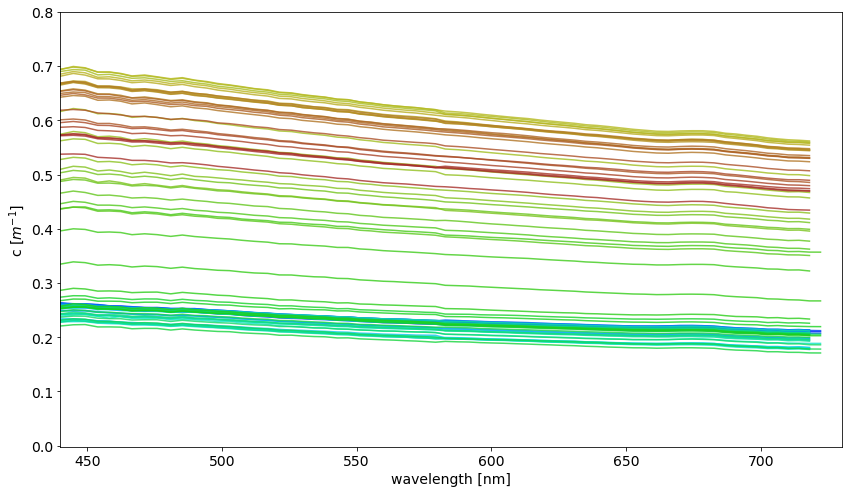

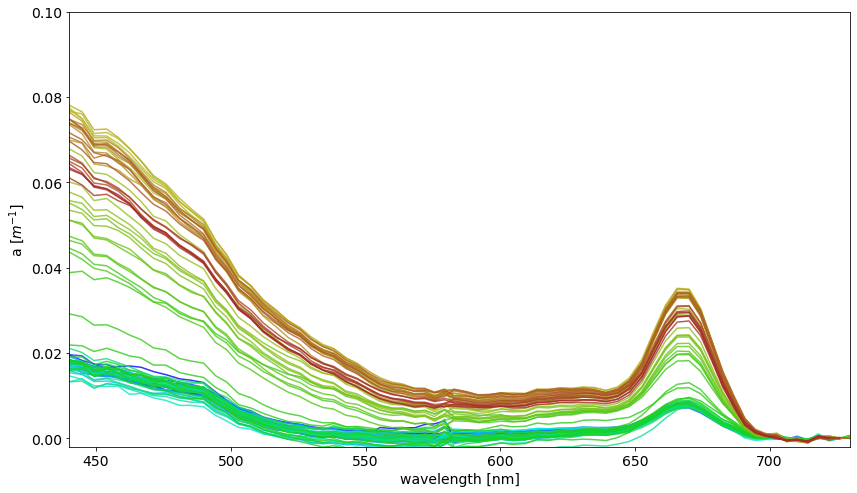

In [787]:
from colour import Color

df_subset = optical_df.loc[start_times[3]:end_times[3]]

colors = list(Color("blue").range_to(Color("brown"),len(df_subset)))
hex_colors = [j.hex for j in colors]

fig, ax = plt.subplots(figsize=(14,8))
for i in range(len(df_subset)):
    if ~df_subset.iloc[i,1:82].isnull().values.all():
        ax.plot(acs_wavelength,df_subset.iloc[i,1+83:82+83].rolling(window=1, win_type='triang').mean(), alpha=.8, c=hex_colors[i])
ax.set_ylim(-0.002,.8)
ax.set_xlim(440,730)
#ax.set_title('Particulate Abs')
ax.set_ylabel('c [$m^{-1}$]')
ax.set_xlabel('wavelength [nm]')  
# plt.title('Absorption colored by time (blue to brown) across an open ocean to coastal transect')
plt.savefig('figs/march_c_spec.png',dpi=300)
plt.show()


fig, ax = plt.subplots(figsize=(14,8))
for i in range(len(df_subset)):
    if ~df_subset.iloc[i,1:82].isnull().values.all():
        ax.plot(acs_wavelength,df_subset.iloc[i,1:82].rolling(window=1, win_type='triang').mean(), alpha=.8, c=hex_colors[i])
ax.set_ylim(-0.002,.1)
ax.set_xlim(440,730)
#ax.set_title('Particulate Abs')
ax.set_ylabel('a [$m^{-1}$]')
ax.set_xlabel('wavelength [nm]')  
# plt.title('Absorption colored by time (blue to brown) across an open ocean to coastal transect')
plt.savefig('figs/march_a_spec.png',dpi=300)
plt.show()

In [749]:
import sys
from math import log as ln

def sdi(data):
    """ Given a hash { 'species': count } , returns the SDI
    
    >>> sdi({'a': 10, 'b': 20, 'c': 30,})
    1.0114042647073518"""
    
    def p(n, N):
        """ Relative abundance """
        if n==0:
            return(0)
        else:
            return (float(n)/N) * ln(float(n)/N)
            
    N = sum(data.values())
    
    return (-sum(p(n, N) for n in data.values() if n != 0))





1.2181031226881176

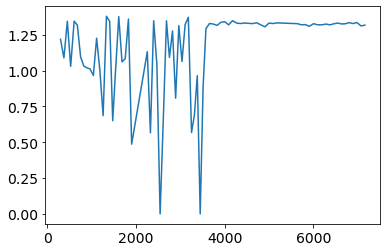

In [750]:
sdi(ppc_dict)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

0


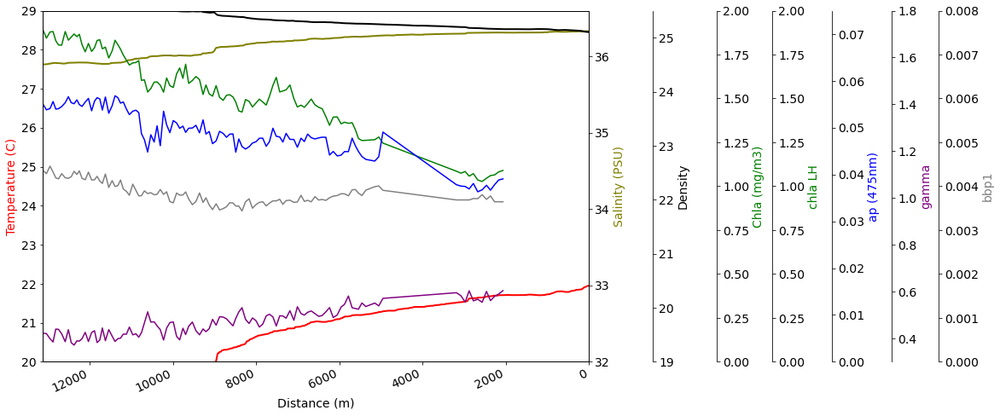

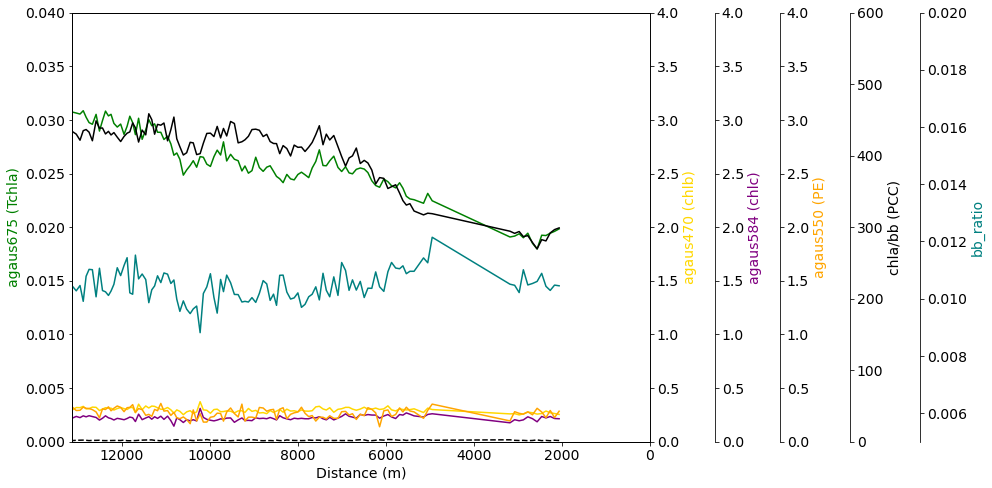

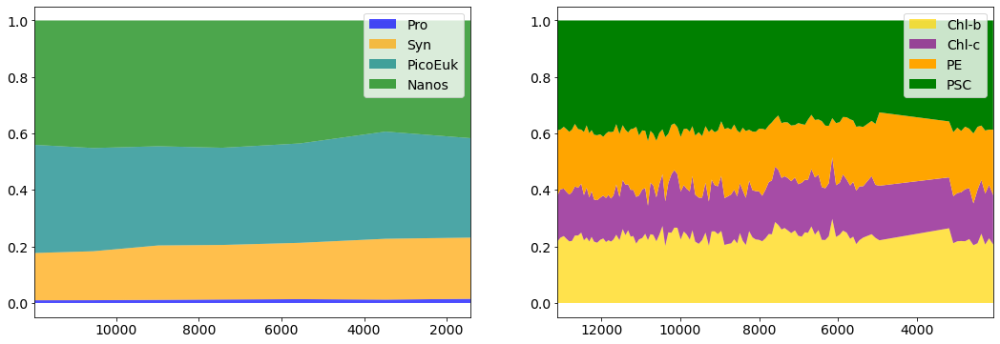

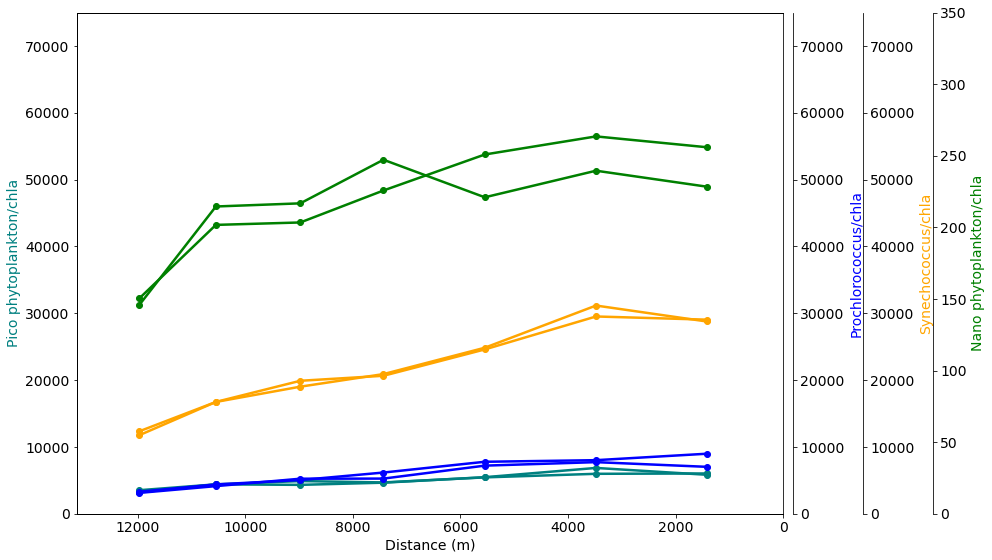

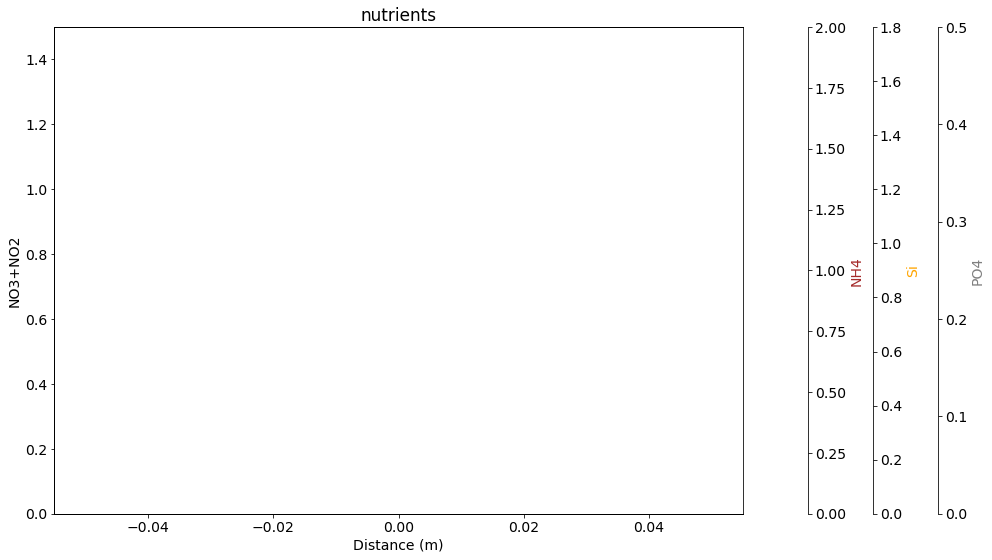

#######################################################################
1


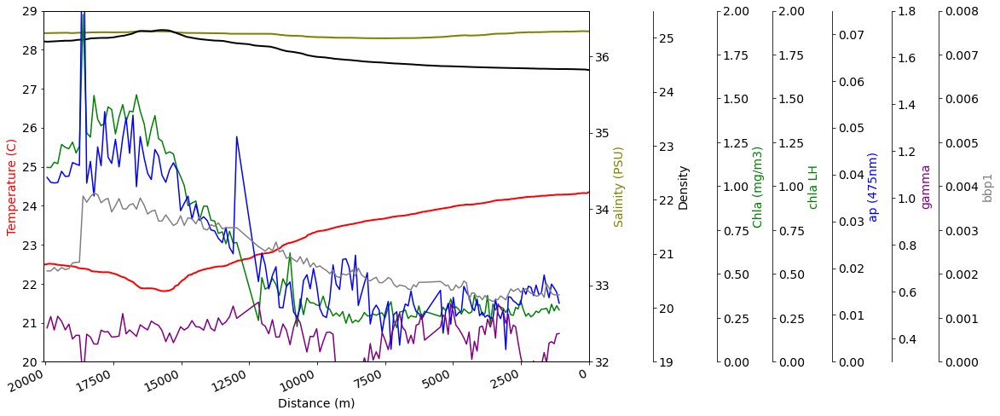

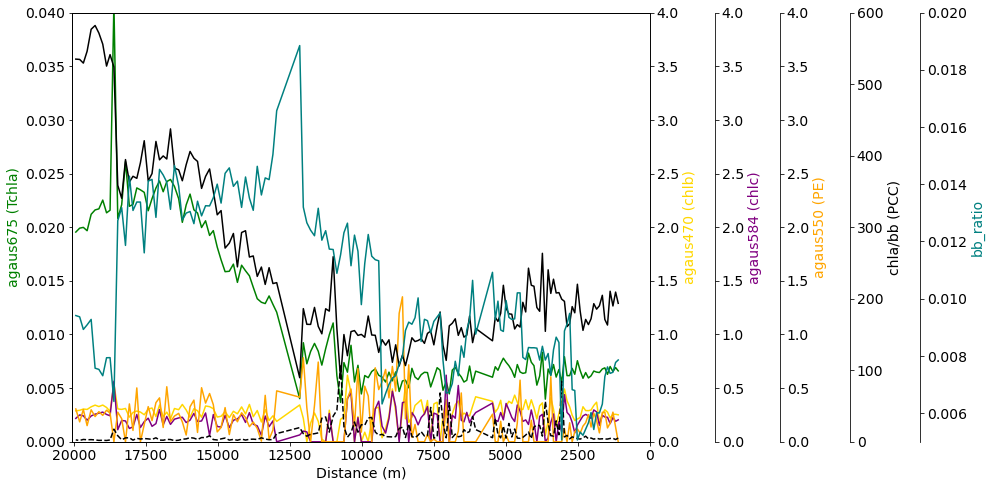

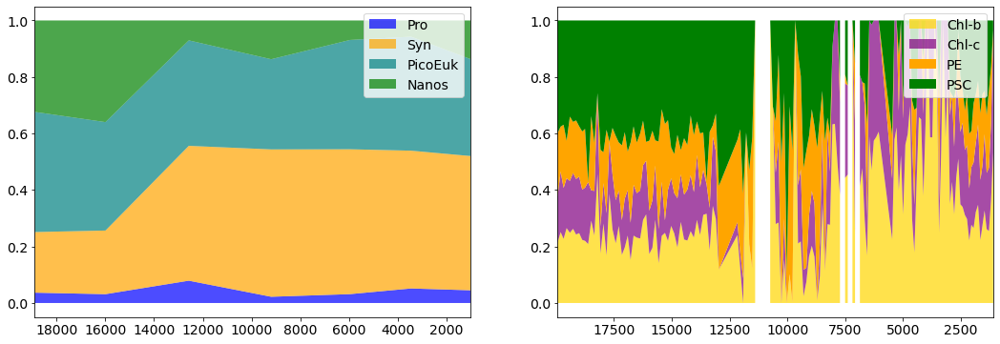

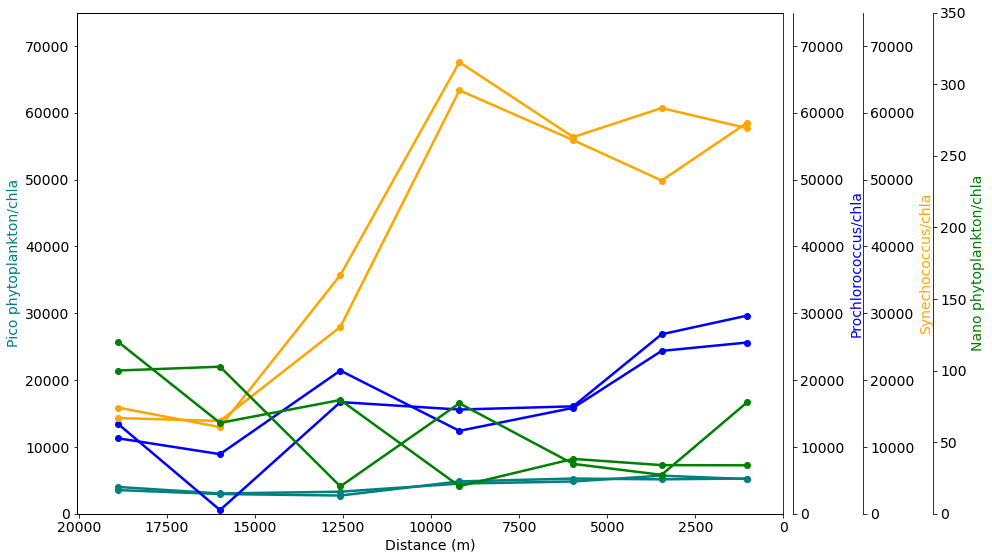

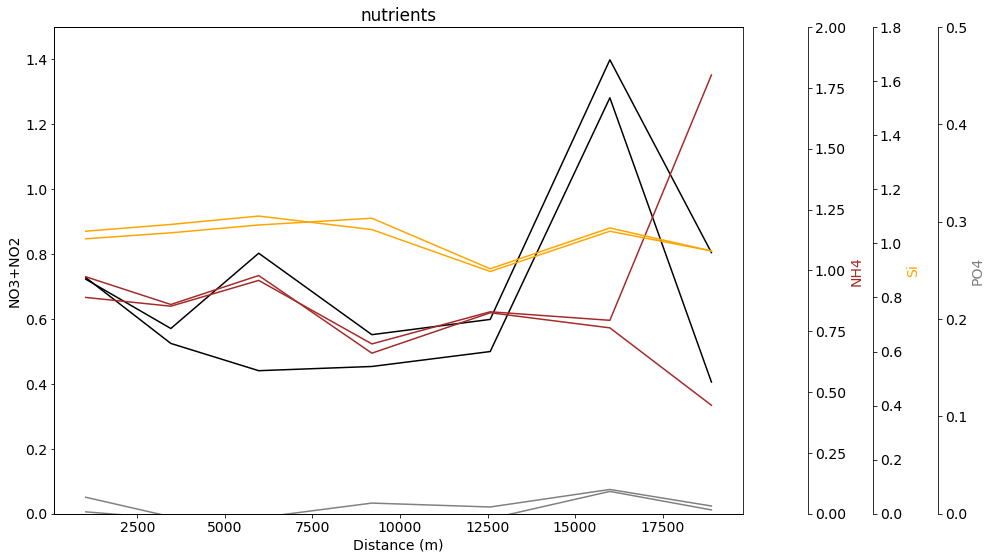

#######################################################################
2


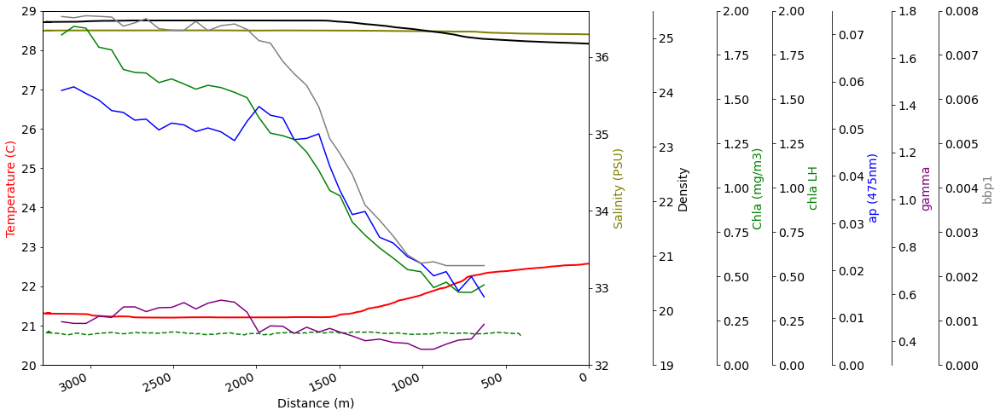

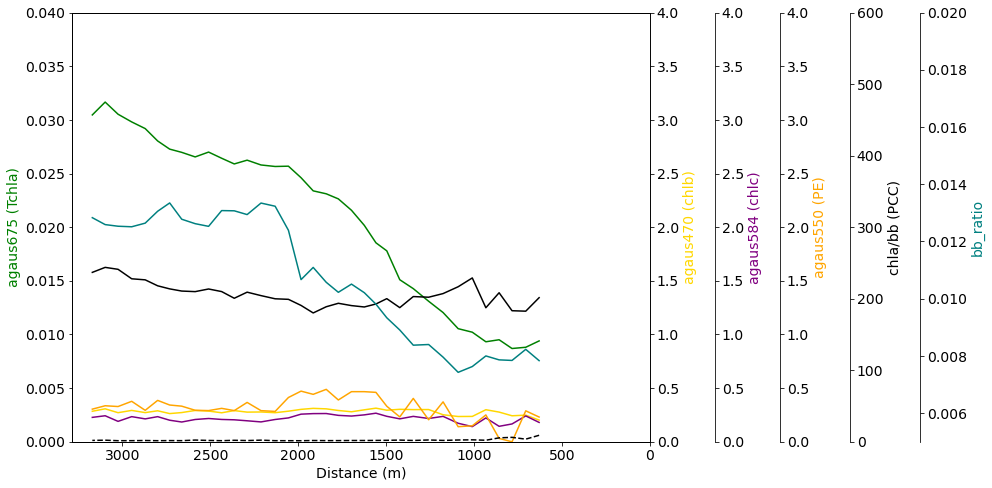

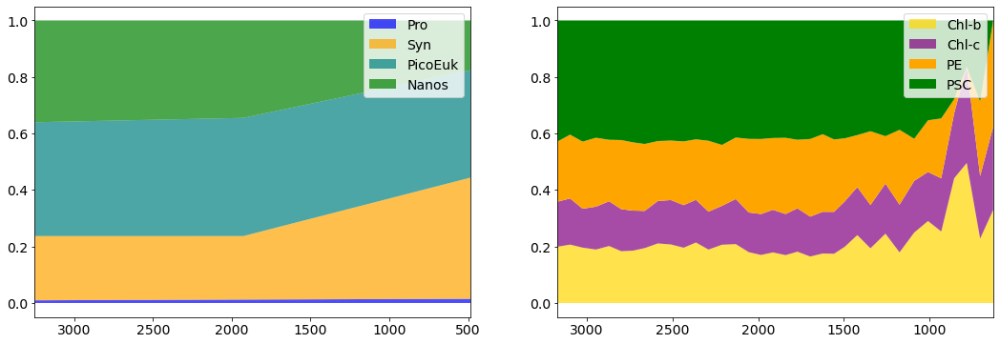

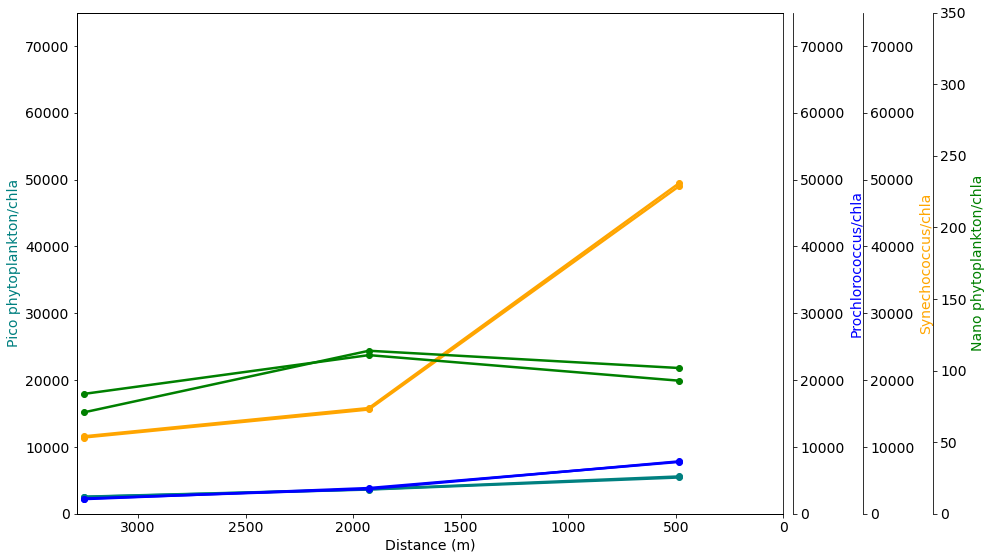

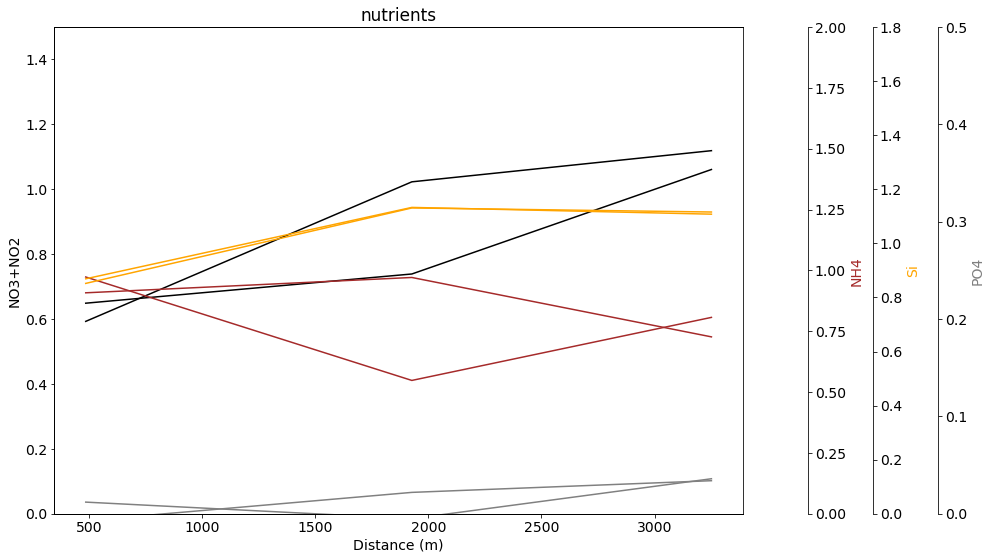

#######################################################################
3


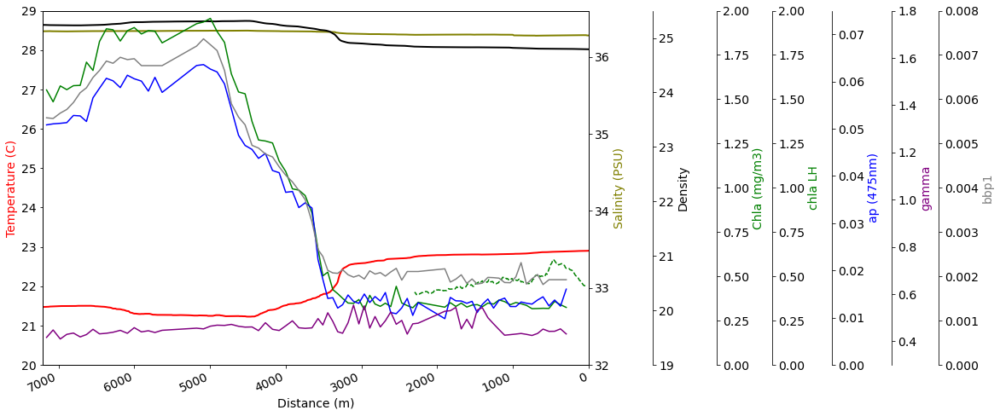

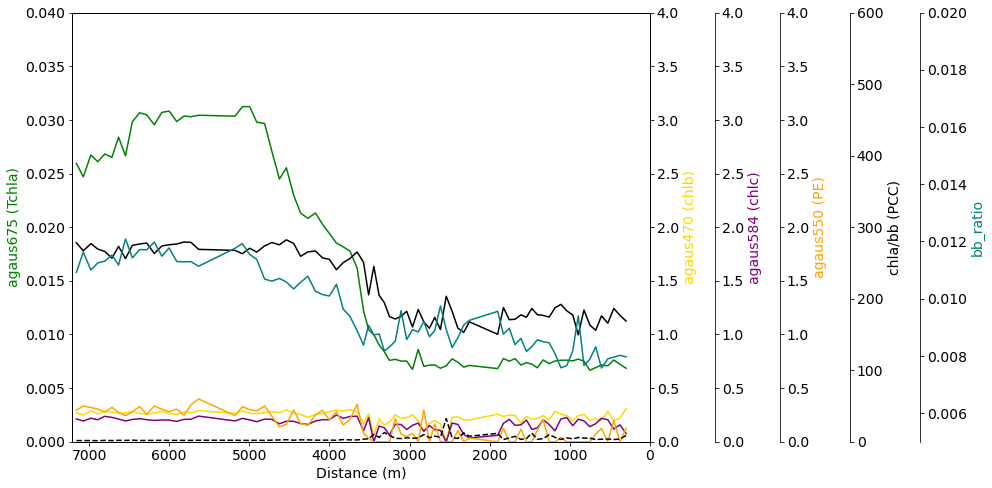

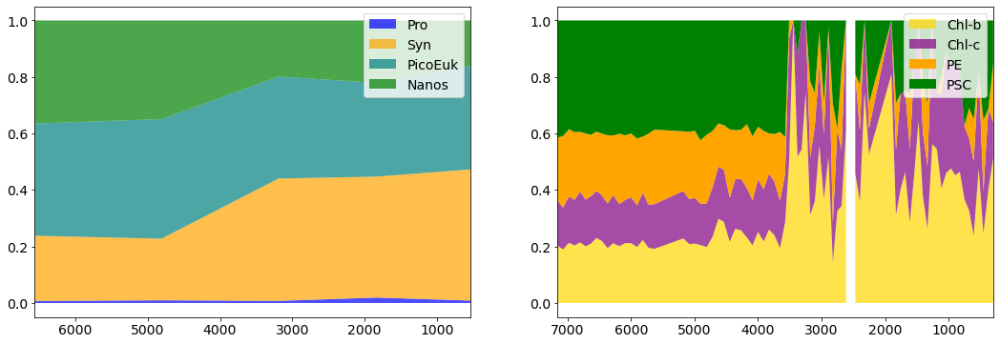

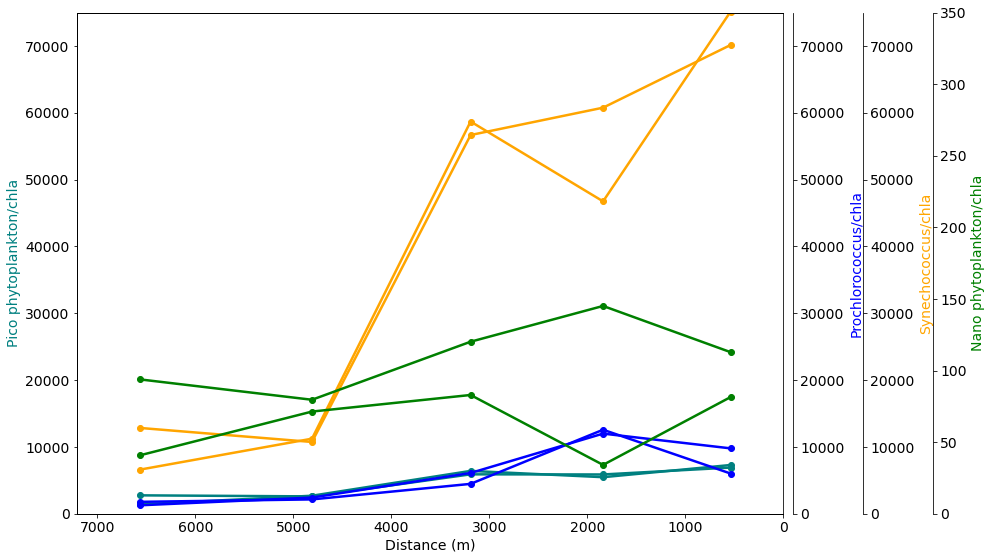

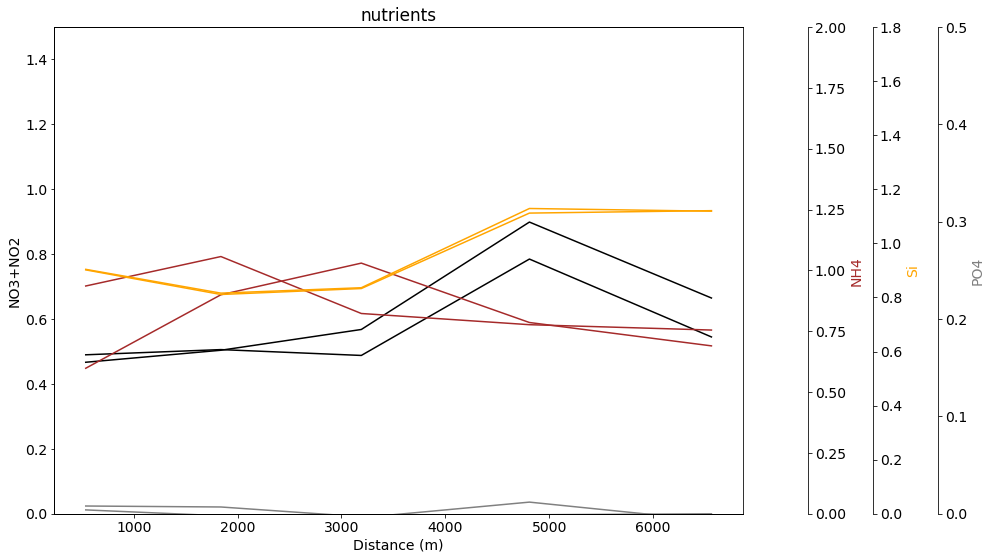

#######################################################################


In [705]:
df = tsg_df
for i in range(len(start_times)):
# for i in range(len(start_times)):
# for i in [0,1,2,5,7,9,10,12]:
#     if trios_df.loc[start_times[i]:end_times[i]]['chla_oci'].empty:
#         pass
#     if profiles.loc[start_times[i]:end_times[i]].empty:
#         pass
# # #     elif hplc_df.loc[start_times[i]:end_times[i]]['datetime'].empty:
# # #         pass
#     else:
        print(i)
#         if not trios_gdf.loc[start_times[i]:end_times[i]]['440'].empty:
#             print('we have trios data')
#         else:
#             print('no TriOS data')

        # time series plot
        fig, ax = plt.subplots(figsize=(16.5,7))
        
        

        ax1 = ax.twinx()
#         ax2 = ax.twinx()
        ax3 = ax.twinx()
        ax4 = ax.twinx()
#         ax5 = ax.twinx()
        ax6 = ax.twinx()
#         ax7 = ax.twinx()
        ax8 = ax.twinx()
        ax9 = ax.twinx()
        ax10 = ax.twinx()

        ax.set_ylim(20, 29)
        ax1.set_ylim(32, 36.6)
#         ax2.set_ylim(.0, .24)
        ax3.set_ylim(.0, 2)
#         ax4.set_ylim(.07, .50)
#         ax5.set_ylim(.07, .50)
        ax4.set_ylim(19, 25.5)
#         ax5.set_ylim(-.1, .1)
        ax6.set_ylim(0,2)
#         ax7.set_ylim(0,0.0085)
        ax8.set_ylim(0,.075)
        ax9.set_ylim(0.3,1.8)
        ax10.set_ylim(0,0.008)

        ax.set_xlabel("Distance (m)")
        ax.set_ylabel("Temperature (C)")
        ax1.set_ylabel("Salinity (PSU)")
#         ax2.set_ylabel("CDOM (volts)")
        ax3.set_ylabel("Chla (mg/m3)")
        ax4.set_ylabel("Density")
#         ax5.set_ylabel("Density Grad")
        ax6.set_ylabel("chla LH")
#         ax7.set_ylabel("agaus523 (phyco)")
        ax8.set_ylabel("ap (475nm)")
        ax9.set_ylabel("gamma")
        ax10.set_ylabel("bbp1")
        
        color1 = plt.cm.viridis(0)
        color2 = plt.cm.viridis(0.5)
        color3 = plt.cm.viridis(.9)
        
        df_distances = get_dist(df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        ax.set_xlim(df_distances[-1], df_distances[0])

        p1, = ax.plot(df_distances, df.loc[start_times[i]:end_times[i]]['Temp_smooth'], color='red', label='Temp', lw=2)
        p2, = ax1.plot(df_distances, df.loc[start_times[i]:end_times[i]]['Sal_smooth'], label='Salinity', color='olive', lw=2)
        
#         p3  = ax2.scatter(cdom_data_x, cdom_data_y, color='brown', label='CDOM', s=1)

        
        trios_df_distances = get_dist(trios_gdf.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
        
        trios_data_x = trios_gdf.loc[start_times[i]:end_times[i]].rolling(window=6*1).mean().index
        trios_data_y = trios_gdf.loc[start_times[i]:end_times[i]].rolling(window=6*1).mean()['chla_oci']
        p4  = ax3.plot(trios_df_distances, trios_data_y, color='green', label='Chla', ls='--')
        
#         p5 = ax4.scatter(hplc_df.loc[start_times[i]:end_times[i]].index, hplc_df.loc[start_times[i]:end_times[i]]['[TChl a]'], 
#                    color='orange', label='TChl a', s=50)
#         p6 = ax5.scatter(hplc_df.loc[start_times[i]:end_times[i]].index, hplc_df.loc[start_times[i]:end_times[i]]['[Zea]'], 
#                    color='purple', label='Zea', s=50)

#         ax.set_title(titles[i])

        p5, = ax4.plot(df_distances, tsg_df.loc[start_times[i]:end_times[i]]['sigma'],  color='black', lw=2)
#         p6, = ax5.plot(df_distances, tsg_df.loc[start_times[i]:end_times[i]]['sigma_grad'], label='Density grad',  color='grey')


        
#         df_subset = profiles.loc[start_times[i]:end_times[i]]
#         # now add in the proper locations for these guys
#         df_subset = profile_locs(df_subset)
        
        # integrate down to z depth
        #depths = [-2,-5,-10,-20,-40,-60,-80, -100]
#         depths=[-2,-10,-20,-40,-80]
        
#         colors = list(Color("black").range_to(Color("blue"),len(depths)))
#         hex_colors = [j.hex for j in colors]
        
#         for idx, z in enumerate(depths):
#             # cut it off at depth (dBars) >= z
#             df_tmp = df_subset[df_subset['depth (dBars)'] >= z] 
#             df_tmp_grouped = df_tmp.groupby('profile_num').median()
#             df_tmp_grouped['datetime'] = pd.to_datetime('2021-1-1') + pd.to_timedelta(df_tmp_grouped.time, unit='D') - pd.Timedelta(days=1)
#             df_subset_distances = get_dist(df_tmp_grouped, df.loc[start_times[i]:end_times[i]])


#             ax4.plot(df_subset_distances,df_tmp_grouped['potential density (kg/m^3 -1000)'], label='density mean(0'+str(z)+')', color=hex_colors[idx], ls='--')
#             ax4.scatter(df_subset_distances,df_tmp_grouped['potential density (kg/m^3 -1000)'], color=hex_colors[idx], ls='--')

            #             ax2.legend()

            
        # plot some optical data if it exists
        if optical_df.loc[start_times[i]:end_times[i]].empty:
            print('---no optical data this transect---')
        else:
            optical_df_distances = get_dist(optical_df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
            p7, = ax6.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['chl_ap676lh'], label='chl_ap676lh',  color='green')
#             p8, = ax7.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['agaus523'], label='agaus523',  color='gold')
            p9, = ax8.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]].iloc[:,16:20].mean(axis=1), label='ap(475)',  color='blue')
            p10, = ax9.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['gamma'], label='gamma',  color='purple')
            p11, = ax10.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['bbp_1'], label='bbp_1',  color='grey')
    

    #     p1, = ax.plot([0, 1, 2], [0, 1, 2],    color=color1, label="Density")
    #     p2, = ax1.plot([0, 1, 2], [0, 3, 2],    color=color2, label="Temperature")
    #     p3, = ax2.plot([0, 1, 2], [50, 30, 15], color=color3, label="Velocity")

#         ax4.legend(loc='lower left')
#         lns = [p1, p2, p4 p5, p6, p7, p9, p10]
        #ax.legend(handles=lns, loc='upper right')

        # right, left, top, bottom
#         ax2.spines['right'].set_position(('outward', 210))

        ax3.spines['right'].set_position(('outward', 215-65))
        
        ax4.spines['right'].set_position(('outward', 75))
        
#         ax5.spines['right'].set_position(('outward', 130))
        ax6.spines['right'].set_position(('outward', 280-65))
#         ax7.spines['right'].set_position(('outward', 280))
        ax8.spines['right'].set_position(('outward', 350-65))
        ax9.spines['right'].set_position(('outward', 420-65))
        ax10.spines['right'].set_position(('outward', 475-65))

        # no x-ticks                 
    #     ax2.xaxis.set_ticks([])
        fig.autofmt_xdate(rotation=25)
        #ax.xaxis.set_major_formatter(myFmt)

        # Sometimes handy, same for xaxis
        #par2.yaxis.set_ticks_position('right')

        # Move "Velocity"-axis to the left
        # par2.spines['left'].set_position(('outward', 60))
        # par2.spines['left'].set_visible(True)
        # par2.yaxis.set_label_position('left')
        # par2.yaxis.set_ticks_position('left')

        ax.yaxis.label.set_color(p1.get_color())
        ax1.yaxis.label.set_color(p2.get_color())
#         ax2.yaxis.label.set_color('brown')
        ax3.yaxis.label.set_color('green')
        ax4.yaxis.label.set_color('black')
#         ax5.yaxis.label.set_color('grey')
        ax6.yaxis.label.set_color('green')
#         ax7.yaxis.label.set_color('gold')
        ax8.yaxis.label.set_color('blue')
        ax9.yaxis.label.set_color('purple')
        ax10.yaxis.label.set_color('grey')


        # Adjust spacings w.r.t. figsize
        fig.tight_layout()
#         if i == 2:
#             fig.savefig('figs/psc_std_transect_1620utc_290821.png')
    #     plt.close()
#         fig.savefig('figs/transect_aug'+titles[i]+'.png')
#         plt.savefig('full_fig_march.png',dpi=300)
    
        plt.show()

    
    
    
                ###########################
        
        # gaussian decomp section
        
        fig, ax = plt.subplots(figsize=(14,7))
        
#         ax.set_xlim(pd.to_datetime(start_times[i]), pd.to_datetime(end_times[i]))

        ax1 = ax.twinx()
        ax2 = ax.twinx()
        ax3 = ax.twinx()
        ax4 = ax.twinx()
        ax5 = ax.twinx()
#         ax6 = ax.twinx()
#         ax4 = ax.twinx()
        
#         ax.set_ylim(20, 29)
#         ax1.set_ylim(32, 36.6)
#         ax2.set_ylim(.0, .24)
#         ax3.set_ylim(.0, 2)

        ax.set_xlabel("Distance (m)")
        ax.set_ylabel("agaus675 (Tchla)")
        ax1.set_ylabel("agaus470 (chlb)")
        ax2.set_ylabel("agaus584 (chlc)")
        ax3.set_ylabel("agaus550 (PE)")
        ax4.set_ylabel("chla/bb (PCC)")
        ax5.set_ylabel("bb_ratio")
#         ax6.set_ylabel("HH_G50")
#         ax3.set_ylabel("Chla (mg/m3)")
#         ax4.set_ylabel("Density")
#         ax5.set_ylabel("Density Grad")
        
        ax.set_xlim(df_distances[-1], df_distances[0])
  
            
        # plot some optical data if it exists
        if optical_df.loc[start_times[i]:end_times[i]].empty:
            print('---no optical data this transect---')
        else:
            optical_df_distances = get_dist(optical_df.loc[start_times[i]:end_times[i]],df.loc[start_times[i]:end_times[i]])
            
            window = 1
            
#             tchla = (optical_df.loc[start_times[i]:end_times[i]]['agaus675'] / np.exp(A))**(1/B)
            tchla = optical_df.loc[start_times[i]:end_times[i]]['agaus675'].rolling(window=window).mean()
            
#             PPC = (optical_df.loc[start_times[i]:end_times[i]]['agaus470'] / np.exp(A))**(1/B)
            chlb = optical_df.loc[start_times[i]:end_times[i]]['agaus660'].rolling(window=window).mean()/ tchla
            

#             PSC = (optical_df.loc[start_times[i]:end_times[i]]['agaus523'] / np.exp(A))**(1/B)
            chlc = optical_df.loc[start_times[i]:end_times[i]]['agaus638'].rolling(window=window).mean()/ tchla
            
            # this algorithm currently doesn't have a specific coefficient for PE
            PE = optical_df.loc[start_times[i]:end_times[i]]['agaus550'].rolling(window=window).mean()/ tchla
            
            agaus_mae = optical_df.loc[start_times[i]:end_times[i]]['agaus-mae'].rolling(window=window).mean()/ tchla
            
            ax.plot(optical_df_distances, tchla, label='agaus434',  color='green')
            ax1.plot(optical_df_distances, chlb, label='agaus470',  color='gold')
            ax2.plot(optical_df_distances, chlc, label='agaus584',  color='purple')
            ax3.plot(optical_df_distances, PE, label='agaus550',  color='orange')
            ax3.plot(optical_df_distances, agaus_mae, label='agaus_mae',  color='black',ls='--')
            
            ax4.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['chl_ap676lh']/optical_df.loc[start_times[i]:end_times[i]]['bbp_1'], label='chla/bb',  color='black')
            ax5.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['bbp_ratio_440'], label='bbp_ratio_440',  color='teal')
#             ax6.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['HH_G50'], label='HH_G50',  color='teal')
            
        
#        ax1.spines['right'].set_position(('outward', 65))    
        ax2.spines['right'].set_position(('outward', 65))
        ax3.spines['right'].set_position(('outward', 130))
        ax4.spines['right'].set_position(('outward', 200))
        ax5.spines['right'].set_position(('outward', 270))
#         ax6.spines['right'].set_position(('outward', 340))


        ax.yaxis.label.set_color('green')
        ax1.yaxis.label.set_color('gold')
        ax2.yaxis.label.set_color('purple')
        ax3.yaxis.label.set_color('orange')
        ax4.yaxis.label.set_color('black')
        ax5.yaxis.label.set_color('teal')
        
        ax.set_ylim(0,.04)
        ax1.set_ylim(0,.04*100)
        ax2.set_ylim(0,.04*100)
        ax3.set_ylim(0,.04*100)
        ax4.set_ylim(0,600)
        ax5.set_ylim(0.005,.02)



        # Adjust spacings w.r.t. figsize
        fig.tight_layout()
#         if i == 2:
#             fig.savefig('figs/psc_std_transect_1620utc_290821.png')
    #     plt.close()
#         fig.savefig('figs/transect_aug'+titles[i]+'.png')
#         plt.savefig('gauss_decom_fig_march_chlanorm.png',dpi=300)

        plt.show()
        ###########################
        
        samples_gdf_subset = samples_gdf.loc[start_times[i]:end_times[i]]
        sample_df_distances = get_dist(samples_gdf_subset,df.loc[start_times[i]:end_times[i]])
        
        fig, (ax,ax1) = plt.subplots(1,2,figsize=(18,6))
        # normalize by the total
        total_pop = samples_gdf_subset.prosa*v_for_sphere(.3) + samples_gdf_subset.synsa*v_for_sphere(.5) + samples_gdf_subset.picosa*v_for_sphere(1) +  samples_gdf_subset.nanosa*v_for_sphere(3)
        # total_pop = total_pop / samples_gdf_subset.chla_lh
        
        y = np.row_stack((samples_gdf_subset.prosa*v_for_sphere(.3)/total_pop, samples_gdf_subset.synsa*v_for_sphere(.5)/total_pop, samples_gdf_subset.picosa*v_for_sphere(1)/total_pop,  samples_gdf_subset.nanosa*v_for_sphere(3)/total_pop))  
        # this call to 'cumsum' (cumulative sum), passing in your y data, 
        # is necessary to avoid having to manually order the datasets
        x = sample_df_distances
        y_stack = np.cumsum(y, axis=0)   # a 3x10 array


        ax.fill_between(x, 0, y_stack[0,:], facecolor="blue", alpha=.7, label='Pro')
        ax.fill_between(x, y_stack[0,:], y_stack[1,:], facecolor="orange", alpha=.7, label='Syn')
        ax.fill_between(x, y_stack[1,:], y_stack[2,:], facecolor="teal",alpha=0.7, label='PicoEuk')
        ax.fill_between(x, y_stack[2,:], y_stack[3,:], facecolor="green",alpha=0.7,label='Nanos')
        
        ax.set_xlim(sample_df_distances[-1], sample_df_distances[0])
        
        ax.legend()
        
        if optical_df.loc[start_times[i]:end_times[i]].empty:
            pass
        else:
                        
            chlb = optical_df.loc[start_times[i]:end_times[i]]['agaus660']
            PSC = optical_df.loc[start_times[i]:end_times[i]]['agaus523']
            PPC = optical_df.loc[start_times[i]:end_times[i]]['agaus492']
            chlc = optical_df.loc[start_times[i]:end_times[i]]['agaus638']
            PE = optical_df.loc[start_times[i]:end_times[i]]['agaus550']

            total_pigment = chlb + chlc + PE +PSC# +PPC

            y = np.row_stack((chlb/total_pigment, chlc/total_pigment, PE/total_pigment, PSC/total_pigment))#, PPC/total_pigment))   
            # this call to 'cumsum' (cumulative sum), passing in your y data, 
            # is necessary to avoid having to manually order the datasets
            x = optical_df_distances
            y_stack = np.cumsum(y, axis=0)   # a 3x10 array


            ax1.fill_between(x, 0, y_stack[0,:], facecolor="gold", alpha=.7, label='Chl-b')
            ax1.fill_between(x, y_stack[0,:], y_stack[1,:], facecolor="purple", alpha=.7, label='Chl-c')
            ax1.fill_between(x, y_stack[1,:], y_stack[2,:], facecolor="orange", label='PE')
            ax1.fill_between(x, y_stack[2,:], y_stack[3,:], facecolor="green", label='PSC')
#             ax1.fill_between(x, y_stack[3,:], y_stack[4,:], facecolor="blue", label='PPC')

            ax1.set_xlim(optical_df_distances[-1], optical_df_distances[0])
            ax1.legend()
            
#         plt.savefig('pcc_gauss_march.png',dpi=300)
        
        plt.show()
        
        
        ###########################
        
        
        
#         trios_df_transect = trios_gdf.loc[start_times[i]:end_times[i]]
        
#         fig, ax = plt.subplots(figsize=(12.5,8))
#         # ax.plot(trios_df_transect['440'].rolling(window=1).mean())
#         # ax.plot(trios_df_transect['460'].rolling(window=1).mean())
#         # ax.plot(trios_df_transect['440'].rolling(window=6*3).mean())
#         # ax.plot(df_filtered['440'])

#         window = 7
#         ax.plot(trios_df_distances,trios_df_transect['440'].rolling(window=window).mean(),c='blue', label='440nm')
# #         ax.plot(trios_df_distances,trios_df_transect['440'].rolling(window=window).mean()+static_trios_df.rolling(6).mean()['440'].std(),c='blue',ls='--',alpha=0.5)
# #         ax.plot(trios_df_distances,trios_df_transect['440'].rolling(window=window).mean()-static_trios_df.rolling(6).mean()['440'].std(),c='blue',ls='--',alpha=0.5)

#         ax.plot(trios_df_distances,trios_df_transect['550'].rolling(window=window).mean(),c='green', label='550nm')
# #         ax.plot(trios_df_distances,trios_df_transect['550'].rolling(window=window).mean()+static_trios_df.rolling(6).mean()['550'].std(),c='green',ls='--',alpha=0.5)
# #         ax.plot(trios_df_distances,trios_df_transect['550'].rolling(window=window).mean()-static_trios_df.rolling(6).mean()['550'].std(),c='green',ls='--',alpha=0.5)

#         ax.plot(trios_df_distances,trios_df_transect['660'].rolling(window=window).mean(),c='red', label='660nm')
# #         ax.plot(trios_df_distances,trios_df_transect['660'].rolling(window=window).mean()+static_trios_df.rolling(6).mean()['660'].std(),c='red',ls='--',alpha=0.5)
# #         ax.plot(trios_df_distances,trios_df_transect['660'].rolling(window=window).mean()-static_trios_df.rolling(6).mean()['660'].std(),c='red',ls='--',alpha=0.5)

#         ax.set_ylabel('Remote sensing reflectance')
#         ax.set_xlabel('Distance (m)')
#         ax.set_ylim(0,0.008)
#         ax.set_xlim(df_distances[-1], df_distances[0])
#         ax.legend()
        
# #         plt.savefig('rrs_march_spectra.png',dpi=300)
#         plt.show()
        
        fig, ax = plt.subplots(figsize=(14,8))
        
        
#         samples_gdf_subset.plot('Category',ax=map_ax,lw=2, legend=True, facecolor='none', s=100)
        ax2 = ax.twinx()
        ax3 = ax.twinx()
        ax4 = ax.twinx()

#         ax.plot(sample_df_distances, (samples_gdf_subset.picosa+samples_gdf_subset.picosb)/2, color='teal', label='Picos')
# #         ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.picosb, color='teal', label='PicosB')

#         ax2.plot(sample_df_distances, (samples_gdf_subset.prosa+samples_gdf_subset.prosb)/2, color='blue', label='Pros')
# #         fcm_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.prosb, color='blue', label='ProsB')

#         ax3.plot(sample_df_distances, (samples_gdf_subset.synsa+samples_gdf_subset.synsb)/2, color='orange', label='Syns')
# #         fcm3_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.synsb, color='orange', label='SynsB')

#         ax4.plot(sample_df_distances, (samples_gdf_subset.nanosa+samples_gdf_subset.nanosb)/2, color='green', label='Nanos')
# #         fcm2_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.nanosb, color='green', label='NanosB')


        ax.plot(sample_df_distances, samples_gdf_subset.picosa/samples_gdf_subset.chla_lh, color='teal', label='Picos', ls='-',lw=2.5,marker='o')
        ax.plot(sample_df_distances, samples_gdf_subset.picosb/samples_gdf_subset.chla_lh, color='teal', label='Picos', ls='-',lw=2.5,marker='o')
#         ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.picosb, color='teal', label='PicosB')

        ax2.plot(sample_df_distances, samples_gdf_subset.prosa/samples_gdf_subset.chla_lh, color='blue', label='Pros',ls='-',lw=2.5,marker='o')
        ax2.plot(sample_df_distances, samples_gdf_subset.prosb/samples_gdf_subset.chla_lh, color='blue', label='Pros',ls='-',lw=2.5,marker='o')
#         fcm_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.prosb, color='blue', label='ProsB')

        ax3.plot(sample_df_distances, samples_gdf_subset.synsa/samples_gdf_subset.chla_lh, color='orange', label='Syns',ls='-',lw=2.5,marker='o')
        ax3.plot(sample_df_distances, samples_gdf_subset.synsb/samples_gdf_subset.chla_lh, color='orange', label='Syns',ls='-',lw=2.5,marker='o')
#         fcm3_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.synsb, color='orange', label='SynsB')

        ax4.plot(sample_df_distances, samples_gdf_subset.nanosa/samples_gdf_subset.chla_lh, color='green', label='Nanos',ls='-',lw=2.5,marker='o')
        ax4.plot(sample_df_distances, samples_gdf_subset.nanosb/samples_gdf_subset.chla_lh, color='green', label='Nanos',ls='-',lw=2.5,marker='o')
#         fcm2_ax.plot(samples_df.loc[start_times[i]:end_times[i]].index, samples_gdf_subset.nanosb, color='green', label='NanosB')

#         ax.set_ylim(0,30000)
#         ax2.set_ylim(0,30000)
#         ax3.set_ylim(0,30000)
#         ax4.set_ylim(0,200)
        ax.set_ylim(0,75000)
        ax2.set_ylim(0,75000)
        ax3.set_ylim(0,75000)
        ax4.set_ylim(0,350)

        ax.set_xlabel("Distance (m)")
        ax.set_ylabel("Pico phytoplankton/chla")
        ax2.set_ylabel("Prochlorococcus/chla")
        ax3.set_ylabel("Synechococcus/chla")
        ax4.set_ylabel("Nano phytoplankton/chla")
        
        ax2.spines['right'].set_position(('outward', 10))        
        ax3.spines['right'].set_position(('outward', 80))
        ax4.spines['right'].set_position(('outward', 150))

        ax.yaxis.label.set_color('teal')
        ax2.yaxis.label.set_color('blue')
        ax3.yaxis.label.set_color('orange')
        ax4.yaxis.label.set_color('green')
        ax.set_xlim(df_distances[-1], df_distances[0])
        
        fig.tight_layout()

#         plt.savefig('fcm_march_chlanorm.png',dpi=300)
        plt.show()
        
        ######
        
        fig, ax = plt.subplots(figsize=(14,8))
        
        ax.set_title('nutrients')
    
        # NO3+NO2A', 'NO2A', 'NH4A', 'PO4A', 'SiA', 'NO3+NO2B', 'NO2B', 'NH4B', 'PO4B', 'SiB'

        ax2 = ax.twinx()
        ax3 = ax.twinx()
        ax4 = ax.twinx()
        
        ax.plot(sample_df_distances, samples_gdf_subset['NO3+NO2A'], color='black', label='NO3')
        ax.plot(sample_df_distances, samples_gdf_subset['NO3+NO2B'], color='black')

        ax2.plot(sample_df_distances, samples_gdf_subset['NH4A'], color='brown', label='NH4')
        ax2.plot(sample_df_distances, samples_gdf_subset['NH4B'], color='brown')

        ax3.plot(sample_df_distances, samples_gdf_subset['SiA'], color='orange', label='Si')
        ax3.plot(sample_df_distances, samples_gdf_subset['SiB'], color='orange')
        
        ax4.plot(sample_df_distances, samples_gdf_subset['PO4A'], color='grey', label='PO4')
        ax4.plot(sample_df_distances, samples_gdf_subset['PO4B'], color='grey')

        ax2.spines['right'].set_position(('outward', 65))
        ax3.spines['right'].set_position(('outward', 130))
        ax4.spines['right'].set_position(('outward', 195))

        ax.set_xlabel("Distance (m)")
        ax.set_ylabel("NO3+NO2")
        ax2.set_ylabel("NH4")
        ax3.set_ylabel("Si")
        ax4.set_ylabel("PO4")

        ax.yaxis.label.set_color('black')
        ax2.yaxis.label.set_color('brown')
        ax3.yaxis.label.set_color('orange')
        ax4.yaxis.label.set_color('grey')

        ax.set_ylim(0,1.5)
        ax2.set_ylim(0,2)
        ax3.set_ylim(0,1.8)
        ax4.set_ylim(0,0.5)
        
        fig.tight_layout()
        
#         fig.savefig('nutrients_march.png',dpi=300)
        
        plt.show()
        
    
        

        print('#######################################################################')
        
#         plt.savefig('figs/trios_transect_aug'+titles[i]+'.png')
        

In [704]:
agaus_mae

dt
2022-03-11 16:09:00    0.059120
2022-03-11 16:10:00    0.026046
2022-03-11 16:11:00    0.021100
2022-03-11 16:12:00    0.026078
2022-03-11 16:13:00    0.023908
                         ...   
2022-03-11 17:31:00    0.013468
2022-03-11 17:32:00    0.010390
2022-03-11 17:33:00    0.011619
2022-03-11 17:34:00    0.011874
2022-03-11 17:35:00    0.011299
Length: 79, dtype: float64

In [695]:
optical_df.loc[start_times[i]:end_times[i]]['agaus-mae']

dt
2022-03-11 16:09:00    0.000405
2022-03-11 16:10:00    0.000188
2022-03-11 16:11:00    0.000161
2022-03-11 16:12:00    0.000185
2022-03-11 16:13:00    0.000171
                         ...   
2022-03-11 17:31:00    0.000361
2022-03-11 17:32:00    0.000271
2022-03-11 17:33:00    0.000311
2022-03-11 17:34:00    0.000293
2022-03-11 17:35:00    0.000293
Name: agaus-mae, Length: 79, dtype: float64

(array([25., 38., 11.,  3.,  1.,  0.,  0.,  0.,  0.,  1.]),
 array([0.00014521, 0.00028347, 0.00042173, 0.00055999, 0.00069825,
        0.00083651, 0.00097477, 0.00111303, 0.00125129, 0.00138955,
        0.00152781]),
 <BarContainer object of 10 artists>)

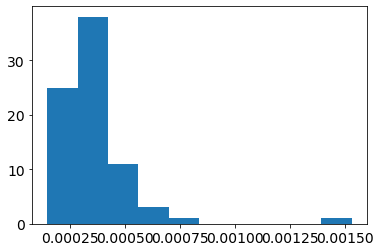

In [693]:
plt.hist(optical_df.loc[start_times[i]:end_times[i]]['agaus-mae'])

In [696]:
optical_df.loc[start_times[i]:end_times[i]]['agaus660']

dt
2022-03-11 16:09:00    0.002117
2022-03-11 16:10:00    0.001599
2022-03-11 16:11:00    0.001492
2022-03-11 16:12:00    0.002017
2022-03-11 16:13:00    0.001428
                         ...   
2022-03-11 17:31:00    0.007593
2022-03-11 17:32:00    0.006764
2022-03-11 17:33:00    0.007659
2022-03-11 17:34:00    0.006167
2022-03-11 17:35:00    0.007001
Name: agaus660, Length: 79, dtype: float64

(array([ 3., 25., 14.,  1.,  0.,  5.,  6.,  4., 12.,  9.]),
 array([0.        , 0.0008976 , 0.00179519, 0.00269279, 0.00359038,
        0.00448798, 0.00538557, 0.00628317, 0.00718076, 0.00807836,
        0.00897595]),
 <BarContainer object of 10 artists>)

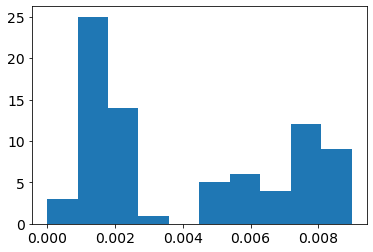

In [694]:
plt.hist(optical_df.loc[start_times[i]:end_times[i]]['agaus660'])

In [ ]:
        
#             tchla = (optical_df.loc[start_times[i]:end_times[i]]['agaus675'] / np.exp(A))**(1/B)
            tchla = optical_df.loc[start_times[i]:end_times[i]]['agaus675'].rolling(window=window).mean()
            
#             PPC = (optical_df.loc[start_times[i]:end_times[i]]['agaus470'] / np.exp(A))**(1/B)
            chlb = optical_df.loc[start_times[i]:end_times[i]]['agaus660'].rolling(window=window).mean()/ tchla
            

#             PSC = (optical_df.loc[start_times[i]:end_times[i]]['agaus523'] / np.exp(A))**(1/B)
            chlc = optical_df.loc[start_times[i]:end_times[i]]['agaus638'].rolling(window=window).mean()/ tchla
            
            # this algorithm currently doesn't have a specific coefficient for PE
            PE = optical_df.loc[start_times[i]:end_times[i]]['agaus550'].rolling(window=window).mean()/ tchla
            
            ax.plot(optical_df_distances, tchla, label='agaus434',  color='green')
            ax1.plot(optical_df_distances, chlb, label='agaus470',  color='gold')
            ax2.plot(optical_df_distances, chlc, label='agaus584',  color='purple')
            ax3.plot(optical_df_distances, PE, label='agaus550',  color='orange')
            
            ax4.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['chl_ap676lh']/optical_df.loc[start_times[i]:end_times[i]]['bbp_1'], label='chla/bb',  color='black')
            ax5.plot(optical_df_distances, optical_df.loc[start_times[i]:end_times[i]]['bbp_ratio_440'], label='bbp_ratio_440',  color='teal')

dt
2022-03-11 16:09:00    0.509282
2022-03-11 16:10:00    0.379203
2022-03-11 16:11:00    0.514739
2022-03-11 16:12:00    0.489934
2022-03-11 16:13:00    0.543432
                         ...   
2022-03-11 17:31:00    0.799755
2022-03-11 17:32:00    0.769849
2022-03-11 17:33:00    0.825547
2022-03-11 17:34:00    0.776994
2022-03-11 17:35:00    0.778011
Length: 79, dtype: float64

In [667]:
samples_gdf_subset.chla_lh

utc_dt
2022-03-11 16:12:03    0.318992
2022-03-11 16:30:05    0.351416
2022-03-11 16:49:05    0.349557
2022-03-11 17:09:00    1.820997
2022-03-11 17:28:01    1.662782
Name: chla_lh, dtype: float64

In [643]:
samples_gdf_subset['NO3+NO2A']

utc_dt
2022-03-11 16:12:03    0.490
2022-03-11 16:30:05    0.506
2022-03-11 16:49:05    0.488
2022-03-11 17:09:00    0.785
2022-03-11 17:28:01    0.545
Name: NO3+NO2A, dtype: float64

In [644]:
.5/0.008

62.5

In [645]:
samples_gdf_subset.PO4B # NO3+NO2A

utc_dt
2022-03-11 16:12:03    0.004
2022-03-11 16:30:05   -0.002
2022-03-11 16:49:05   -0.004
2022-03-11 17:09:00    0.012
2022-03-11 17:28:01   -0.007
Name: PO4B, dtype: float64

In [602]:
optical_df.loc[start_times[i]:end_times[i]]['bbp_1']

dt
2022-03-11 16:09:00    0.001925
2022-03-11 16:10:00    0.001925
2022-03-11 16:11:00    0.001925
2022-03-11 16:12:00    0.001925
2022-03-11 16:13:00    0.001816
                         ...   
2022-03-11 17:31:00    0.005927
2022-03-11 17:32:00    0.005769
2022-03-11 17:33:00    0.005688
2022-03-11 17:34:00    0.005565
2022-03-11 17:35:00    0.005581
Name: bbp_1, Length: 79, dtype: float64

## visualizing in T-S space

In [56]:
start_times

['2022-03-09 15:25',
 '2022-03-09 20:50',
 '2022-03-10 12:59',
 '2022-03-10 17:35',
 '2022-03-11 14:02',
 '2022-03-11 15:00',
 '2022-03-11 16:05']

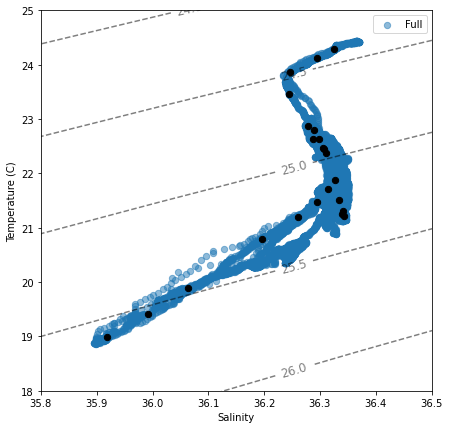

In [55]:
# Figure out boudaries (mins and maxs)
smin = 35.5
smax = 37
tmin = 15
tmax = 26

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000


    
# plot T and S diagrams first with distance from coast and then with other variables
fig, ax = plt.subplots(figsize=(7,7))
markersize=40

# ax.fill_between([smin,smax],temp_gs,temp_gs+5,color='blue',alpha=.2)
# ax.fill_between([sal_eddy_gs,smax],tmin,temp_gs,color='yellow',alpha=.2)
# ax.fill_between([smin,sal_shelf],tmin,temp_gs,color='brown',alpha=.2)
# ax.fill_between([sal_shelf,sal_eddy_gs],tmin,temp_gs,color='green',alpha=.2)


ax.set_xlim(35.8,36.5)
ax.set_ylim(18,25)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

CS = ax.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
ax.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
# ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
#                 edgecolor='k', fc='None', ls='--', lw=2)
# ax.add_patch(ellipse)
alpha=0.01

# colors=['blue','green','orange','red', 'aqua',]
ax.scatter(tsg_df.loc[start_times[0]:end_times[-1]].Sal_smooth, tsg_df.loc[start_times[0]:end_times[-1]].Temp_smooth, s=markersize,alpha=.5, label='Full')
for i in range(len(start_times)):
    df_subset_full = tsg_df.loc[start_times[i]:end_times[i]]
#     im = ax.scatter(df_subset_full.Sal_smooth, df_subset_full.Temp_smooth, s=markersize,alpha=1, label='Transect '+str(i+1))

ax.legend()
    

ax.scatter(samples_df.sal, samples_df.temp, s=markersize,alpha=1, color='black')


# optical_cp_subset = optical_df_quality[optical_df_quality['cp_12'] > .23]
# optical_cp_subset = optical_cp_subset[optical_cp_subset.water_mass == 'gulfstream']
# ax.scatter(optical_cp_subset.sal, optical_cp_subset.temp, c='black')


    
# ax.legend()
# fig.savefig('figs/simple_t_s_diagram_all_transects_with_divisions.png',dpi=300)


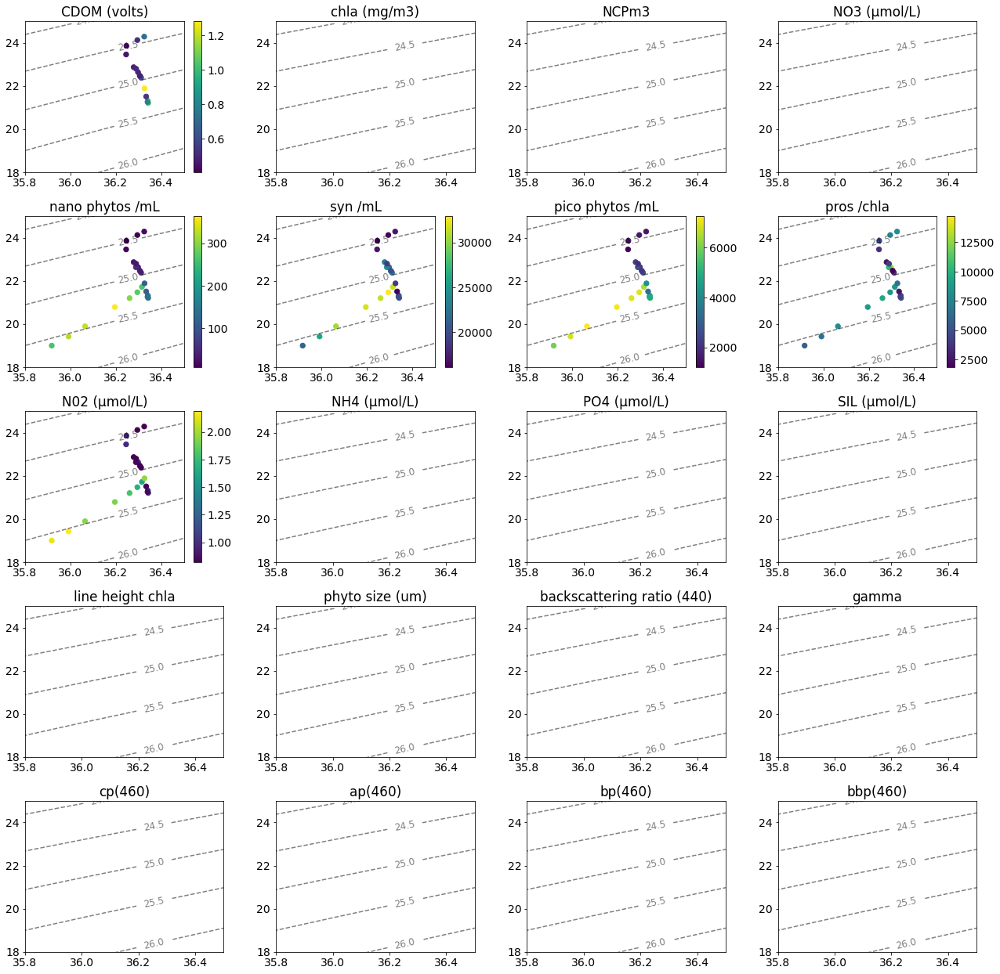

In [538]:
fig, ax = plt.subplots(5,4,figsize=(4.5*4,17.5))
  
# plot T and S diagrams first with distance from coast and then with other variables

# df_subset = tsg_df_subset[tsg_df_subset['BacteriaB'].notnull()]
markersize=40

titles = ['CDOM (volts)', 'chla (mg/m3)', 'NCPm3', 'NO3 (µmol/L)', 
           'nano phytos /mL', 'syn /mL',  'pico phytos /mL', 'pros /chla', 
          'N02 (µmol/L)', 'NH4 (µmol/L)', 'PO4 (µmol/L)', 'SIL (µmol/L)', 
         
          'line height chla', 'phyto size (um)', 'backscattering ratio (440)', 'gamma',
         'cp(460)', 'ap(460)', 'bp(460)', 'bbp(460)']

for idx,a in enumerate([ax[0,0], ax[0,1], ax[0,2], ax[0,3],
                        ax[1,0], ax[1,1], ax[1,2], ax[1,3],
                        ax[2,0], ax[2,1], ax[2,2], ax[2,3],
                       ax[3,0], ax[3,1], ax[3,2], ax[3,3],
                       ax[4,0], ax[4,1], ax[4,2], ax[4,3]]):
    a.set_xlim(35.8,36.5)
    a.set_ylim(18,25)
    a.set_title(titles[idx])
    CS = a.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
    a.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
    
#     ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
#                         edgecolor='k', fc='None', ls='--', lw=2)
#     a.add_patch(ellipse)
    
alpha=1
cmap='viridis'

        
### top column

## 'NO3+NO2A', 'NO2A', 'NH4A', 'PO4A', 'SiA', 'NO3+NO2B', 'NO2B', 'NH4B','PO4B', 'SiB'

im = ax[0,0].scatter(samples_df.sal, samples_df.temp, s=markersize, c=samples_df['NO3+NO2A'],alpha=alpha, cmap=cmap)
fig.colorbar(im,ax=ax[0,0])

# im=ax[0,1].scatter(df_subset.Sal, df_subset.Temp, s=markersize, c=df_subset.ChlaAvg, vmin=.1,vmax=.3,alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[0,1])

# # im = ax[0,2].scatter(df_subset.Sal, df_subset.Temp, s=markersize, c=((df_subset.NO3a+df_subset.NO3b)/2/(df_subset.PO4a+df_subset.PO4b)/2), vmin=.0,vmax=2,alpha=alpha, cmap=cmap)
# # fig.colorbar(im,ax=ax[0,2])
    
# im = ax[0,2].scatter(tsg_df_subset.Sal, tsg_df_subset.Temp, s=markersize, c=tsg_df_subset.NCPm3, vmin=.0,vmax=1,alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[0,2])    

# im = ax[0,3].scatter(df_subset.Sal, df_subset.Temp, s=markersize, c=((df_subset.NO3a+df_subset.NO3b)/2), vmin=.05,vmax=.18, alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[0,3])

# ### FCM

# 'nanosa', 'picosa', 'prosa', 'synsa', 'nanosb', 'picosb','prosb', 'synsb',

im=ax[1,0].scatter(samples_df.sal, samples_df.temp, s=markersize, c=(samples_df['nanosa']+samples_df['nanosb'])/2,alpha=alpha, cmap=cmap)
fig.colorbar(im,ax=ax[1,0])

im=ax[1,1].scatter(samples_df.sal, samples_df.temp, s=markersize, c=(samples_df['synsa']+samples_df['synsb'])/2,alpha=alpha, cmap=cmap)
fig.colorbar(im,ax=ax[1,1])

im=ax[1,2].scatter(samples_df.sal, samples_df.temp, s=markersize, c=(samples_df['picosa']+samples_df['picosb'])/2, alpha=alpha, cmap=cmap)
fig.colorbar(im,ax=ax[1,2])

im=ax[1,3].scatter(samples_df.sal, samples_df.temp, s=markersize, c=(samples_df['prosa']+samples_df['prosb'])/2, alpha=alpha, cmap=cmap)
fig.colorbar(im,ax=ax[1,3])

# ### random

im=ax[2,0].scatter(samples_df.sal, samples_df.temp, s=markersize, c=samples_df['chla'], alpha=alpha, cmap=cmap)
fig.colorbar(im,ax=ax[2,0])#  format='%.0e')

# im=ax[2,1].scatter(df_subset.Sal, df_subset.Temp, s=markersize, c=df_subset.SynA, vmin=10000,vmax=140000,alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[2,1], format='%.0e')

# # im=ax[2,2].scatter(df_subset.Sal, df_subset.Temp, s=markersize, c=df_subset.PeuksA, vmin=500,vmax=3500, alpha=alpha, cmap=cmap)
# # fig.colorbar(im,ax=ax[2,2],  format='%.0e')

# im=ax[2,2].scatter(df_subset.Sal, df_subset.Temp, s=markersize, c=(df_subset.BacteriaA+df_subset.BacteriaB)/2, vmin=400000,vmax=950000,alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[2,2],  format='%.0e')

# im=ax[2,3].scatter(df_subset.Sal, df_subset.Temp, s=markersize, c=(df_subset.BacteriaA+df_subset.BacteriaB)/2/df_subset.ChlaAvg, vmin=2e6,vmax=5e6,alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[2,3],  format='%.0e')

# ### optical

# # 'gamma', 'bbp_ratio_440', 'chl_ap676lh', 'bbp_1'

# # im=ax[3,0].scatter(df_subset.Sal, df_subset.Temp, s=markersize, c=df_subset.PicoCyanoA/df_subset.ChlaAvg, vmin=.2e6,vmax=1e6, alpha=alpha, cmap=cmap)
# # # im=ax[3,0].scatter(optical_df.sal, optical_df.temp, s=markersize, c=optical_df.agaus492, vmin=.0,vmax=.025, alpha=alpha, cmap=cmap)
# # fig.colorbar(im,ax=ax[3,0],  format='%.0e')
# # im=ax[3,1].scatter(optical_df.sal, optical_df.temp, s=markersize, c=optical_df.agaus523, vmin=.000,vmax=.012,alpha=alpha, cmap=cmap)
# im=ax[3,0].scatter(optical_df_quality.sal, optical_df_quality.temp, s=markersize, c=optical_df_quality.chl_ap676lh, vmin=0,vmax=.18, alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[3,0])

# im=ax[3,1].scatter(optical_df_quality.sal, optical_df_quality.temp, s=markersize, c=optical_df_quality.HH_G50, vmin=0,vmax=18, alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[3,1])

# im=ax[3,2].scatter(optical_df_quality.sal, optical_df_quality.temp, s=markersize, c=optical_df_quality.bbp_ratio_440, vmin=0.003,vmax=0.007, alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[3,2])

# im=ax[3,3].scatter(optical_df_quality.sal, optical_df_quality.temp, s=markersize, c=optical_df_quality.gamma, vmin=0.2,vmax=.6,alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[3,3])


# im=ax[4,0].scatter(optical_df_quality.sal, optical_df_quality.temp, s=markersize, c=optical_df_quality.cp_15, vmin=0.15,vmax=.35, alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[4,0])

# im=ax[4,1].scatter(optical_df_quality.sal, optical_df_quality.temp, s=markersize, c=optical_df_quality.ap_15, vmin=0,vmax=0.06, alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[4,1])

# im=ax[4,2].scatter(optical_df_quality.sal, optical_df_quality.temp, s=markersize, c=(optical_df_quality.cp_15- optical_df_quality.ap_15), vmin=0.1,vmax=0.3, alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[4,2])

# im=ax[4,3].scatter(optical_df_quality.sal, optical_df_quality.temp, s=markersize, c=optical_df_quality.bbp1, vmin=0.0005,vmax=.0018,alpha=alpha, cmap=cmap)
# fig.colorbar(im,ax=ax[4,3])

### fin

fig.tight_layout()
# fig.savefig('t_s_diagram_all_variables_010922.png',dpi=300)
plt.show()

## Visualizing the subset of transects

In [218]:
plt.rcParams.update({'font.size': 14})

In [16]:
df = tsg_df

In [364]:
len(start_times)

7

In [373]:
tsg_df.chla.min()

0.82

In [17]:
tsg_df_subset.Sal.max()

NameError: name 'tsg_df_subset' is not defined

In [449]:
import matplotlib.dates as mdates
myFmt = mdates.DateFormatter('%m/%d/%Y - %H:%M')

In [38]:
goes_ds_mean = goes_ds.sel(time=slice('2022-03-08 12:59', '2022-03-13 12:59')).mean(dim='time')

0


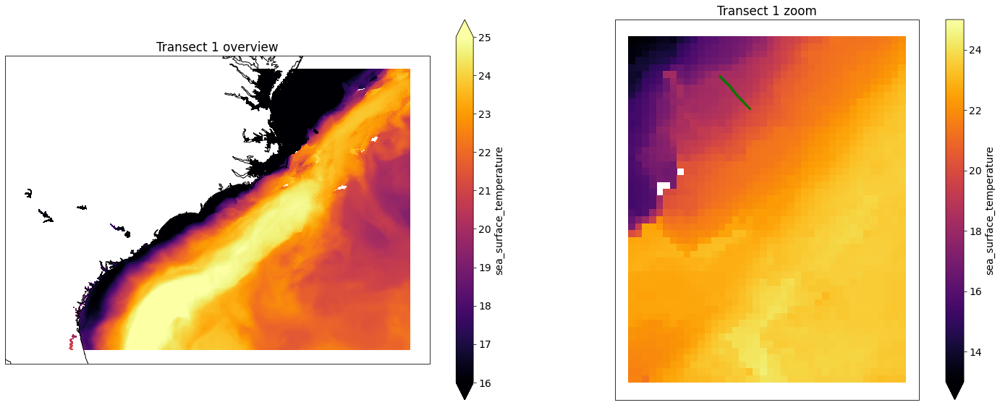

1


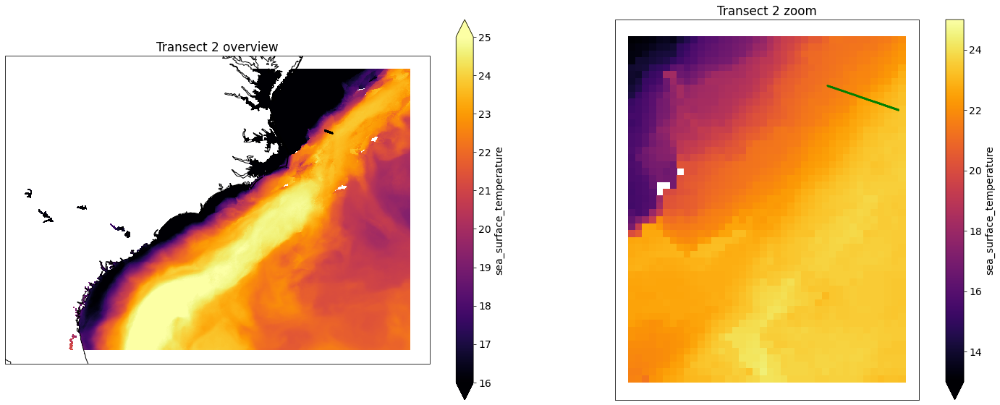

2


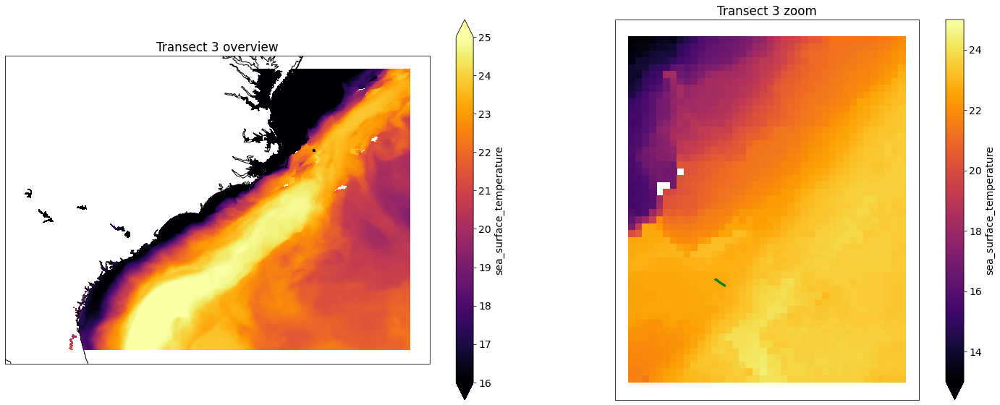

3


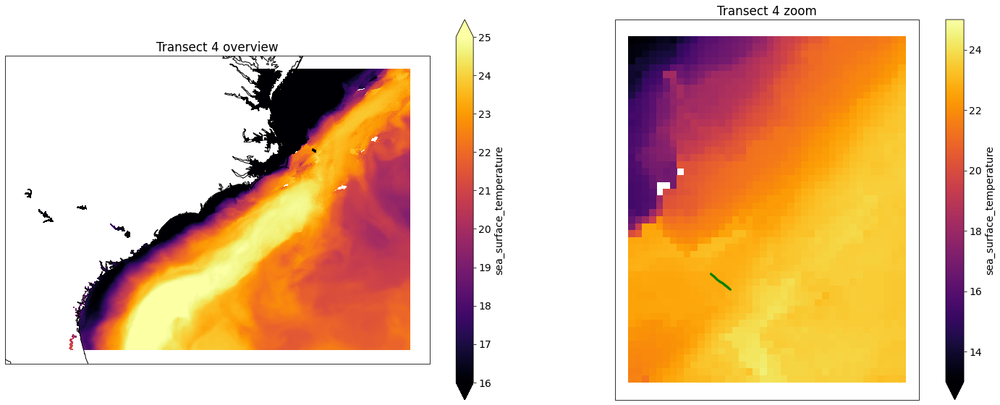

In [30]:
hours = [12,12,12,12,12,12,12,12,12,12,12,12,12]

titles = ['Transect 1', 'Transect 2', 'Transect 3', 'Transect 4', 
        'Transect 5', 'Transect 6', 'Transect 7', 'Transect 8',
        'Transect 9', 'Transect 10', 'Transect 11', 'Transect 12', 'Transect 13']

for i in range(4):
#     if trios_df.loc[start_times[i]:end_times[i]]['chla_oci'].empty:
#         pass
# #     elif hplc_df.loc[start_times[i]:end_times[i]]['datetime'].empty:
# #         pass
#     else:
        print(i)
        """

        # time series plot
        fig, ax = plt.subplots(figsize=(18,7))
        
        ax.set_xlim(pd.to_datetime(start_times[i]), pd.to_datetime(end_times[i]))

        ax1 = ax.twinx()
        ax2 = ax.twinx()
#         ax3 = ax.twinx()
#         ax4 = ax.twinx()
#         ax5 = ax.twinx()

        ax.set_ylim(18.3, 25)
        ax1.set_ylim(35.8, 36.5)
        ax2.set_ylim(0, 1.8)
#         ax3.set_ylim(.0, .50)
#         ax4.set_ylim(.07, .50)
#         ax5.set_ylim(.07, .50)

        ax.set_xlabel("Time (UTC)")
        ax.set_ylabel("Temperature (C)")
        ax1.set_ylabel("Salinity (PSU)")
        ax2.set_ylabel("Chla (mg/m3)")
#         ax2.set_ylabel("CDOM (volts)")
#         ax3.set_ylabel("Chla (mg/m3)")
#         ax4.set_ylabel("HPLC chl a (mg/m3)")
#         ax5.set_ylabel("HPLC Zea (mg/m3)")
        
        color1 = plt.cm.viridis(0)
        color2 = plt.cm.viridis(0.5)
        color3 = plt.cm.viridis(.9)

        p1, = ax.plot(df.loc[start_times[i]:end_times[i]].index, df.loc[start_times[i]:end_times[i]]['Temp'], color='red', label='Temp')
        p2, = ax1.plot(df.loc[start_times[i]:end_times[i]].index, df.loc[start_times[i]:end_times[i]]['Sal'].rolling(window=10).median(), label='Salinity')
        p3, = ax2.plot(df.loc[start_times[i]:end_times[i]].index, df.loc[start_times[i]:end_times[i]]['chla']-.72, color='green', label='Chla')
        
        
#         if cdom_df.loc[start_times[i]:end_times[i]].rolling(window=6*10).mean()['cdom_volts'].empty:
#             cdom_data_x = None
#             cdom_data_y = None
#         else:
#             cdom_data_x = cdom_df.loc[start_times[i]:end_times[i]].index, 
#             cdom_data_y = cdom_df.loc[start_times[i]:end_times[i]].rolling(window=60).mean()['cdom_volts']
#         p3  = ax2.scatter(cdom_data_x, cdom_data_y, color='brown', label='CDOM', s=1)
        
#         trios_data_x = trios_df.loc[start_times[i]:end_times[i]].rolling(window=6*1).mean().index
#         trios_data_y = trios_df.loc[start_times[i]:end_times[i]].rolling(window=6*1).mean()['chla_oci']
#         p4  = ax3.scatter(trios_data_x, trios_data_y, color='green', label='Chla', s=1)
        
#         p5 = ax4.scatter(hplc_df.loc[start_times[i]:end_times[i]].index, hplc_df.loc[start_times[i]:end_times[i]]['[TChl a]'], 
#                    color='orange', label='TChl a', s=50)
#         p6 = ax5.scatter(hplc_df.loc[start_times[i]:end_times[i]].index, hplc_df.loc[start_times[i]:end_times[i]]['[Zea]'], 
#                    color='purple', label='Zea', s=50)

#         ax.set_title(titles[i])


    #     p1, = ax.plot([0, 1, 2], [0, 1, 2],    color=color1, label="Density")
    #     p2, = ax1.plot([0, 1, 2], [0, 3, 2],    color=color2, label="Temperature")
    #     p3, = ax2.plot([0, 1, 2], [50, 30, 15], color=color3, label="Velocity")

        lns = [p1, p2, p3]
        ax.legend(handles=lns, loc='upper right')

        # right, left, top, bottom
        ax2.spines['right'].set_position(('outward', 70))

#         ax3.spines['right'].set_position(('outward', 150))
        
#         ax4.spines['right'].set_position(('outward', 210))
        
#         ax5.spines['right'].set_position(('outward', 280))

        # no x-ticks                 
    #     ax2.xaxis.set_ticks([])
        fig.autofmt_xdate(rotation=25)
        ax.xaxis.set_major_formatter(myFmt)

        # Sometimes handy, same for xaxis
        #par2.yaxis.set_ticks_position('right')

        # Move "Velocity"-axis to the left
        # par2.spines['left'].set_position(('outward', 60))
        # par2.spines['left'].set_visible(True)
        # par2.yaxis.set_label_position('left')
        # par2.yaxis.set_ticks_position('left')

        ax.yaxis.label.set_color(p1.get_color())
        ax1.yaxis.label.set_color(p2.get_color())
        ax2.yaxis.label.set_color('green')
#         ax3.yaxis.label.set_color('green')
#         ax4.yaxis.label.set_color('orange')
#         ax5.yaxis.label.set_color('purple')

        # Adjust spacings w.r.t. figsize
        fig.tight_layout()
#         fig.savefig('figs/'+titles[i] +'.png')
    #     plt.close()
        plt.show()
        
        # plot profile data if it exists
        
#         if profiles.loc[start_times[i]:end_times[i]].empty:
#             print('---no profile data this transect---')
#         else:
#             plot_profiles(profiles, start_times[i],end_times[i], ['temp (C)','salinity (PSU)','potential density (kg/m^3 -1000)', 'chla (ppb)'], 
#                           plot=True)
        """
        

#         # SST image

        fig, ax = plt.subplots(1,2, figsize=(20,8), subplot_kw=dict(projection=crs.PlateCarree()))
        ax[0].coastlines(resolution='10m')
#         goes_ds.sel(time=slice(pd.to_datetime(start_times[i])-timedelta(hours=hours[i]), pd.to_datetime(end_times[i])+timedelta(hours=hours[i]))).sea_surface_temperature[:,:,:].mean(dim='time').plot(ax=ax[0], vmin=24.5, vmax=30, cmap='inferno')
        
        goes_ds_mean.sea_surface_temperature.plot(ax=ax[0], vmin=16, vmax=25, cmap='inferno')
        gdf.loc[start_times[i]:end_times[i]].plot(ax=ax[0], markersize=2, color='black', alpha=.2)

        ax[1].coastlines(resolution='10m')
        #goes_ds.sel(time=slice(pd.to_datetime(start_times[i])-timedelta(hours=hours[i]), pd.to_datetime(end_times[i])+timedelta(hours=hours[i]))).sea_surface_temperature[:,100:130, 400:430].mean(dim='time').plot(ax=ax[1], vmin=24.5, vmax=30, cmap='inferno')
        goes_ds_mean.sea_surface_temperature[80:130, 400:440].plot(ax=ax[1], vmin=13, vmax=25, cmap='inferno')
        gdf.loc[start_times[i]:end_times[i]].plot(ax=ax[1], markersize=2, color='green', alpha=.2)
        # fig.savefig('sst_sept0523_studypoints.png',dpi=400)
        ax[0].set_title(titles[i] + ' overview')
        ax[1].set_title(titles[i] + ' zoom')
        fig.tight_layout()
    #     fig.savefig('figs/'+titles[i] +'sat_overview.png')
    #     plt.close()
        plt.show()    

        # fig.savefig('transect' + str(i) '_s_t.png')

In [45]:
goes_ds.sea_surface_temperature.hvplot.quadmesh(
    'longitude', 'latitude', projection=crs.PlateCarree(), project=True,
    dynamic=True, 
    frame_height=600, clim=(12,25), rasterize=True, cmap='inferno') #* df.loc['2021-09-5 11:00:00':'2021-09-7 13:45:00'].hvplot.points('lon', 'lat', geo=True, color='red', alpha=0.2)

:DynamicMap   [time]
   :Image   [longitude,latitude]   (sea_surface_temperature)

In [43]:
goes_ds_mean = goes_ds.sel(time=slice('2022-03-07 12:59', '2022-03-14 12:59')).mean(dim='time')
goes_ds_mean

<xarray.Dataset>
Dimensions:                  (latitude: 401, longitude: 551)
Coordinates:
  * latitude                 (latitude) float32 38.01 37.99 ... 30.03 30.01
  * longitude                (longitude) float32 -82.99 -82.97 ... -72.01 -71.99
Data variables:
    sea_surface_temperature  (latitude, longitude) float32 nan nan ... 22.39

In [89]:
goes_ds_mean.sea_surface_temperature[:250, 250:500].latitude.max()

<xarray.DataArray 'latitude' ()>
array(38.01000214)

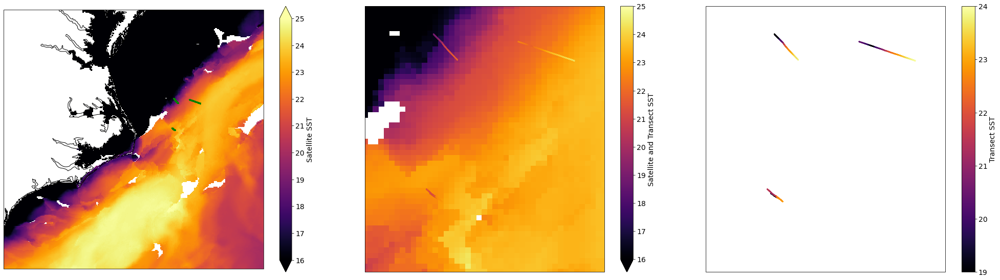

In [121]:
fig, ax = plt.subplots(1,3, figsize=(28,8), subplot_kw=dict(projection=crs.PlateCarree()))
ax[0].coastlines(resolution='10m')       
goes_ds_mean.sea_surface_temperature[:250, 250:500].plot(ax=ax[0], vmin=16, vmax=25, cmap='inferno', cbar_kwargs={'label': 'Satellite SST'})

ax[1].coastlines(resolution='10m')
goes_ds_mean.sea_surface_temperature[80:130, 400:445].plot(ax=ax[1], vmin=16, vmax=25, cmap='inferno', cbar_kwargs={'label': 'Satellite and Transect SST'})

ax[2].coastlines(resolution='10m')
        
        
for i in range(4):
    gdf.loc[start_times[i]:end_times[i]].plot(ax=ax[0], markersize=2, color='green')
    gdf.loc[start_times[i]:end_times[i]].plot(ax=ax[1], markersize=2,column="Temp", cmap='inferno', vmin=16, vmax=25, alpha=1, )#legend=True)

for i in range(3):
    gdf.loc[start_times[i]:end_times[i]].plot(ax=ax[2], markersize=2,column="Temp", cmap='inferno', alpha=1)
gdf.loc[start_times[i+1]:end_times[i+1]].plot(ax=ax[2], markersize=2,column="Temp", cmap='inferno', alpha=1, legend=True, vmin=19, vmax=24, legend_kwds={'label': 'Transect SST'})

ax[0].set_ylim(33.03000259,38.01000214)
ax[0].set_xlim(-77.99000549,-73.01000214)

ax[1].set_ylim(35.43000031,36.40999985)
ax[1].set_xlim(-74.99000549,-74.11000061)

ax[2].set_ylim(35.43000031,36.40999985)
ax[2].set_xlim(-74.99000549,-74.11000061)

fig.tight_layout()
plt.show()    

fig.savefig('march_transects_sst_040822.png',dpi=300)

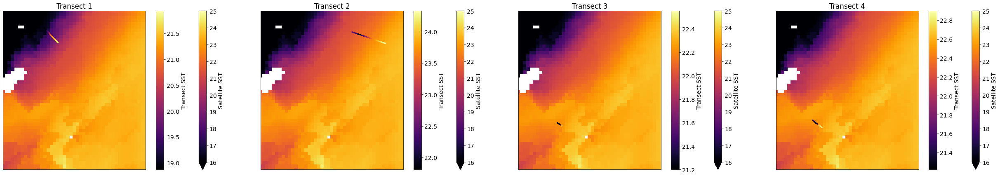

In [119]:
fig, ax = plt.subplots(1,4, figsize=(35,6), subplot_kw=dict(projection=crs.PlateCarree()))

for i in range(4):
    goes_ds_mean.sea_surface_temperature[80:130, 400:445].plot(ax=ax[i], vmin=16, vmax=25, cmap='inferno', cbar_kwargs={'label': 'Satellite SST'})
    ax[i].set_ylim(35.43000031,36.40999985)
    ax[i].set_xlim(-74.99000549,-74.11000061)
    ax[i].set_title('Transect ' + str(i+1))
    gdf.loc[start_times[i]:end_times[i]].plot(ax=ax[i], markersize=2,column="Temp", cmap='inferno', legend=True, legend_kwds={'label': 'Transect SST'})
    
fig.tight_layout()
plt.show()    

fig.savefig('march_individual_transects_sst_040822.png',dpi=300)

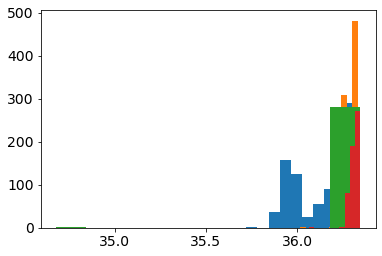

In [106]:
for i in range(4):
    plt.hist(gdf.loc[start_times[i]:end_times[i]].Sal)
plt.show()

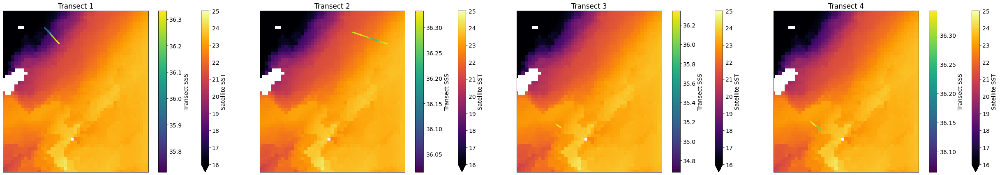

In [118]:
fig, ax = plt.subplots(1,4, figsize=(35,6), subplot_kw=dict(projection=crs.PlateCarree()))

for i in range(4):
    goes_ds_mean.sea_surface_temperature[80:130, 400:445].plot(ax=ax[i], vmin=16, vmax=25, cmap='inferno', cbar_kwargs={'label': 'Satellite SST'})
    ax[i].set_ylim(35.43000031,36.40999985)
    ax[i].set_xlim(-74.99000549,-74.11000061)
    ax[i].set_title('Transect ' + str(i+1))
    gdf.loc[start_times[i]:end_times[i]].plot(ax=ax[i], markersize=2,column="Sal", cmap='viridis', legend=True, legend_kwds={'label': 'Transect SSS'})
    
fig.tight_layout()
plt.show()    

fig.savefig('march_individual_transects_sst_sss_040822.png',dpi=300)

In [125]:
start_times

['2022-03-10 12:59',
 '2022-03-10 17:35',
 '2022-03-11 15:00',
 '2022-03-11 16:05']

In [122]:
dfs = []
for i in range(len(start_times)):
    dfs.append(tsg_df.loc[start_times[i]:end_times[i]])
tsg_df_subset = pd.concat(dfs)

In [123]:
tsg_df_subset.Temp.min()

18.8657

In [124]:
import gsw

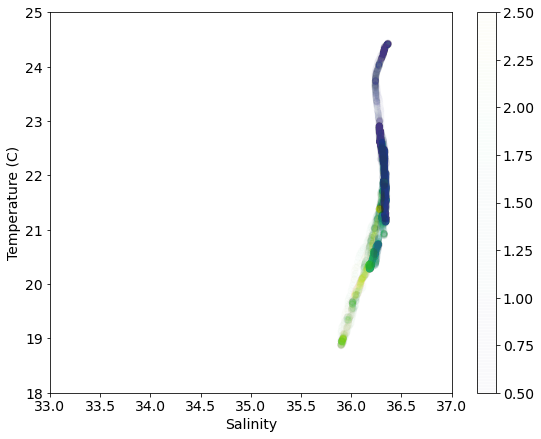

In [157]:
# Figure out boudaries (mins and maxs)
smin = 35.4
smax = 36.5
tmin = 18.3
tmax = 24.2

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000

fig, ax = plt.subplots(figsize=(9,7))

# plot T and S diagrams first with distance from coast and then with other variables

markersize=40

# ax.set_xlim(35.85,36.45)
ax.set_xlim(33,37)
ax.set_ylim(18,25)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

# CS = a.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
# a.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
# ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
#                 edgecolor='k', fc='None', ls='--', lw=2)
# ax.add_patch(ellipse)
alpha=0.2

# im = ax.scatter(tsg_df_subset.Sal, tsg_df_subset.Temp, s=markersize,alpha=0.2, c=tsg_df_subset.chla, label='Chla')
# ax.legend()


df_subset_full = tsg_df.loc[start_times[0]:end_times[-1]]
im = ax.scatter(df_subset_full.Sal.rolling(window=6).median(), df_subset_full.Temp, s=markersize,alpha=.01, c=df_subset_full.chla, vmin=0.5,vmax=2.5)
    
# fig.savefig('figs/simple_t_s_diagram_all_transects.png',dpi=300)
fig.colorbar(im)
plt.show()


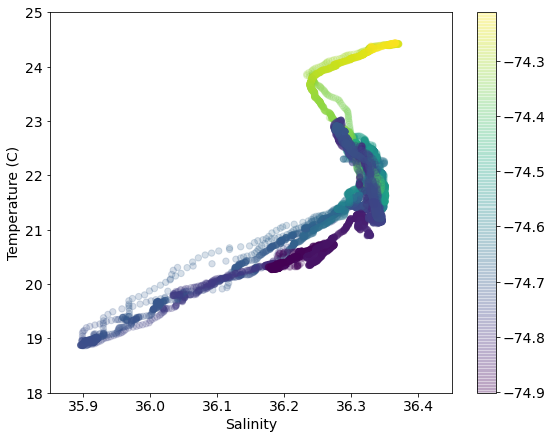

In [164]:
# Figure out boudaries (mins and maxs)
smin = 35.4
smax = 36.5
tmin = 18.3
tmax = 24.2

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000

fig, ax = plt.subplots(figsize=(9,7))

# plot T and S diagrams first with distance from coast and then with other variables

markersize=40

ax.set_xlim(35.85,36.45)
# ax.set_xlim(33,37)
ax.set_ylim(18,25)
ax.set_xlabel('Salinity')
ax.set_ylabel('Temperature (C)')

# CS = a.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
# a.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
# ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
#                 edgecolor='k', fc='None', ls='--', lw=2)
# ax.add_patch(ellipse)
alpha=0.2

# im = ax.scatter(tsg_df_subset.Sal, tsg_df_subset.Temp, s=markersize,alpha=0.2, c=tsg_df_subset.chla, label='Chla')
# ax.legend()


df_subset_full = tsg_df.loc[start_times[0]:end_times[-1]]
im = ax.scatter(df_subset_full.Sal.rolling(window=6).median(), df_subset_full.Temp, s=markersize,alpha=.2, c=df_subset_full.lon)
    
# fig.savefig('figs/simple_t_s_diagram_all_transects.png',dpi=300)
fig.colorbar(im)
plt.show()


In [162]:
df_subset_full.columns

Index(['DateTime', 'Temp', 'Sal', 'Unknown', 'datetime', 'lat', 'lon', 'chla',
       'geometry'],
      dtype='object')

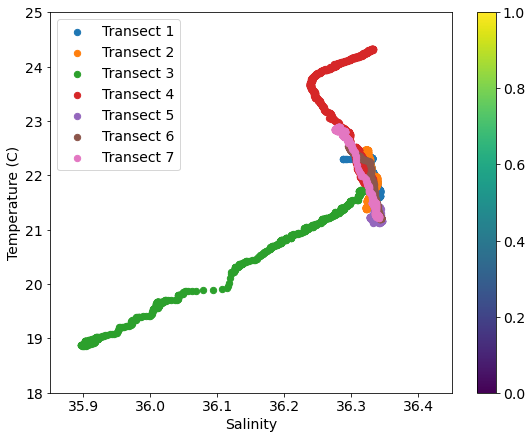

In [165]:
# Figure out boudaries (mins and maxs)
smin = 35.4
smax = 36.5
tmin = 18.3
tmax = 24.2

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000

fig, ax = plt.subplots(figsize=(9,7))
for i in range(len(start_times)):
    # plot T and S diagrams first with distance from coast and then with other variables
    
    markersize=40

    ax.set_xlim(35.85,36.45)
    # ax.set_xlim(33,37)
    ax.set_ylim(18,25)
    ax.set_xlabel('Salinity')
    ax.set_ylabel('Temperature (C)')

    # CS = a.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
    # a.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
    # ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
    #                 edgecolor='k', fc='None', ls='--', lw=2)
    # ax.add_patch(ellipse)
    alpha=0.2

    # im = ax.scatter(tsg_df_subset.Sal, tsg_df_subset.Temp, s=markersize,alpha=0.2, c=tsg_df_subset.chla, label='Chla')
    # ax.legend()


    df_subset_full = tsg_df.loc[start_times[i]:end_times[i]]
    im = ax.scatter(df_subset_full.Sal.rolling(window=6).median(), df_subset_full.Temp, s=markersize,alpha=1, label='Transect '+str(i+1))
    
    ax.legend()
# fig.savefig('figs/simple_t_s_diagram_all_transects.png',dpi=300)
fig.colorbar(im)
plt.show()


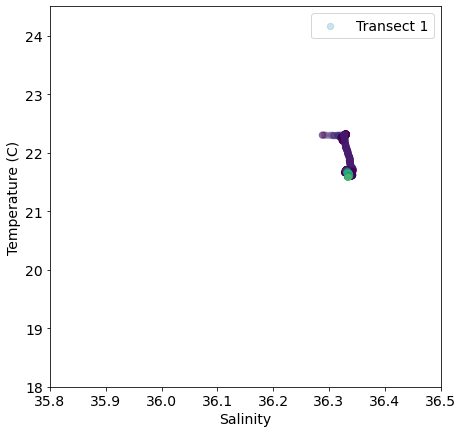

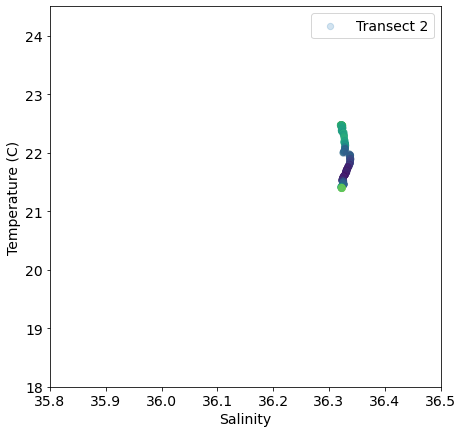

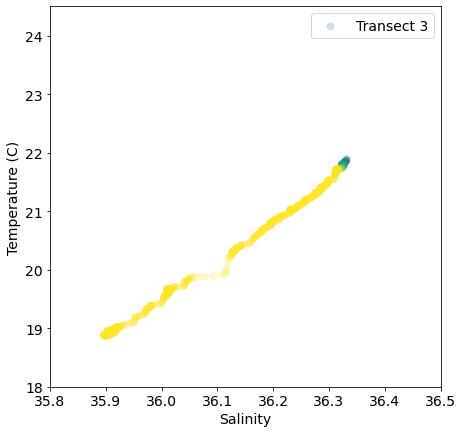

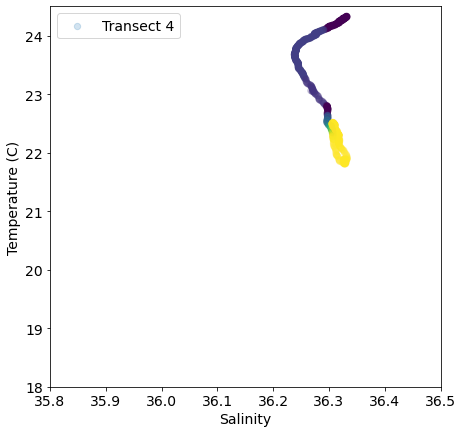

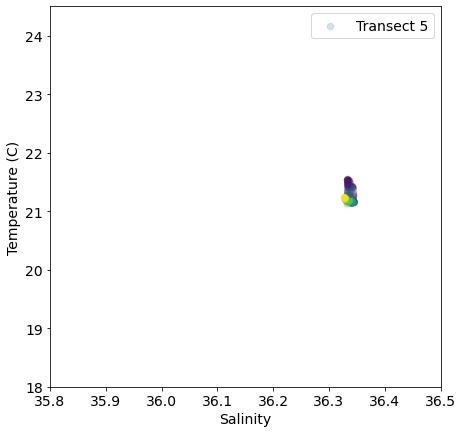

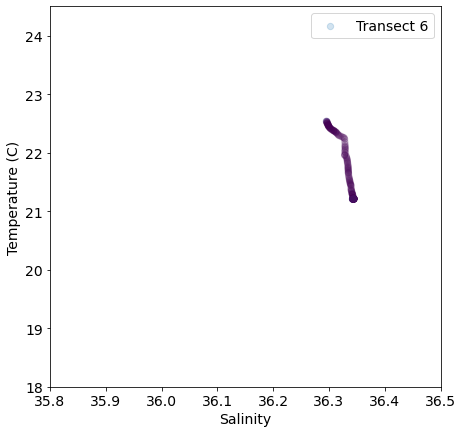

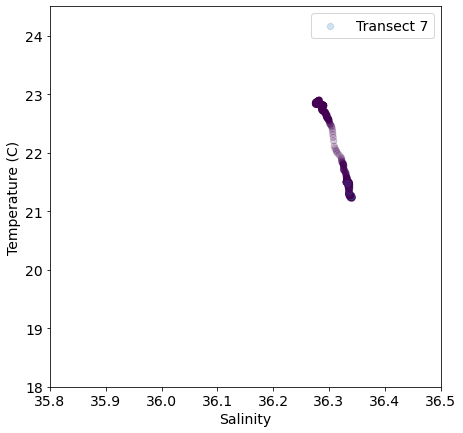

In [395]:
# Figure out boudaries (mins and maxs)
smin = 35.4
smax = 36.5
tmin = 18.3
tmax = 24.2

# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)

# Substract 1000 to convert to sigma-t
dens = dens - 1000


for i in range(len(start_times)):
    # plot T and S diagrams first with distance from coast and then with other variables
    fig, ax = plt.subplots(figsize=(7,7))
    markersize=40

    ax.set_xlim(35.8,36.5)
    ax.set_ylim(18,24.5)
    ax.set_xlabel('Salinity')
    ax.set_ylabel('Temperature (C)')

    # CS = a.contour(si,ti,dens, linestyles='dashed', colors='k', alpha=0.5)
    # a.clabel(CS, fontsize=12, inline=1, fmt='%1.1f') # Label every second level
    # ellipse = Ellipse(xy=(35.88, 28.05), width=0.5, height=1.2, angle=-20,
    #                 edgecolor='k', fc='None', ls='--', lw=2)
    # ax.add_patch(ellipse)
    alpha=0.2

    # im = ax.scatter(tsg_df_subset.Sal, tsg_df_subset.Temp, s=markersize,alpha=0.2, c=tsg_df_subset.chla, label='Chla')
    # ax.legend()


    df_subset_full = tsg_df.loc[start_times[i]:end_times[i]]
    im = ax.scatter(df_subset_full.Sal.rolling(window=6).median(), df_subset_full.Temp, c=df_subset_full.chla, vmin=.85,vmax=1.5, s=markersize,alpha=0.2, label='Transect '+str(i+1))
    ax.legend()
    # fig.savefig('figs/simple_t_s_diagram_all_transects.png',dpi=300)
    plt.show()


## Quantify uncertainty in the trios instrument on the SW

In this section I try to quantify uncertainty in the method by using a period where we didn't move much and then propogate that error to the chla measurement.

In [47]:
static_trios_df = trios_df.loc['2021-08-26 19:46:00':'2021-08-26 19:55:00']
len(static_trios_df)

55

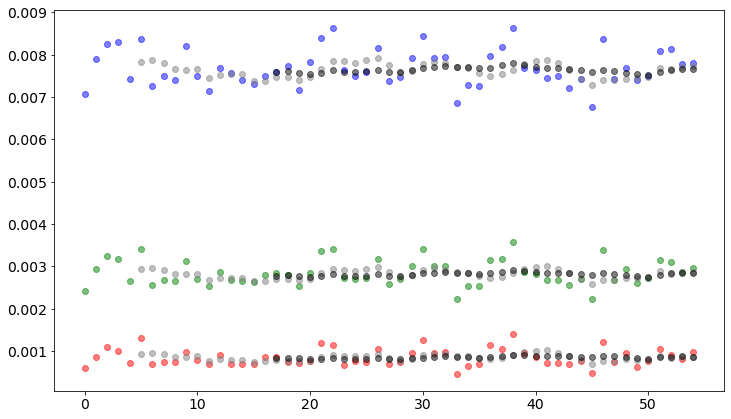

In [48]:
fig, ax = plt.subplots(figsize=(12,7))

for l,u,c in [[156,161,'blue'],[232,240,'green'],[346,351,'red']]:#,[232,240,'green'],[346,351,'red']]:
#     band_mean = static_trios_df.iloc[:, l:u].mean().mean()
#     band_std = static_trios_df.rolling(window=6*3).mean().iloc[:, l:u].mean(axis=1).std()
    
#     ax.axhline(band_mean,color=c)
#     ax.axhline(band_mean+band_std,color=c, ls='--')
#     ax.axhline(band_mean-band_std,color=c, ls='--')


    ax.scatter(range(len(static_trios_df)),static_trios_df.iloc[:, l:u].mean(axis=1),color=c, alpha=0.5)
    ax.scatter(range(len(static_trios_df)),static_trios_df.rolling(window=6).mean().iloc[:, l:u].mean(axis=1),color='grey', alpha=0.5)
    ax.scatter(range(len(static_trios_df)),static_trios_df.rolling(window=6*3).mean().iloc[:, l:u].mean(axis=1),color='black', alpha=0.5)
    
# ax.set_ylim(-0.001,0.004)
plt.show()

Text(0.5, 0, 'Repeated measurement count')

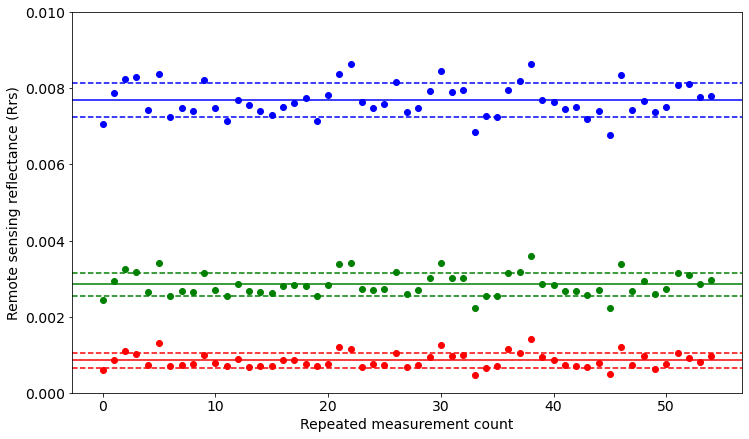

In [51]:
fig, ax = plt.subplots(figsize=(12,7))

for l,u,c in [[156,161,'blue'],[232,240,'green'],[346,351,'red']]:
    band_mean = static_trios_df.iloc[:, l:u].mean().mean()
    band_std = static_trios_df.iloc[:, l:u].mean(axis=1).std()
    
    
    ax.axhline(band_mean,color=c)
    ax.axhline(band_mean+band_std,color=c, ls='--')
    ax.axhline(band_mean-band_std,color=c, ls='--')


    ax.scatter(range(len(static_trios_df)),static_trios_df.iloc[:, l:u].mean(axis=1),color=c, alpha=1)
#     ax.scatter(range(len(static_trios_df)),static_trios_df.rolling(window=6).mean().iloc[:, l:u].mean(axis=1),color='silver', alpha=1)
#     ax.scatter(range(len(static_trios_df)),static_trios_df.rolling(window=6*3).mean().iloc[:, l:u].mean(axis=1),color='black', alpha=1)

ax.set_ylim(0,0.01)

ax.set_ylabel('Remote sensing reflectance (Rrs)')
ax.set_xlabel('Repeated measurement count')
# fig.savefig('repeated_measurements_trios.png',dpi=300)

Text(0.5, 0, 'Repeated measurement count')

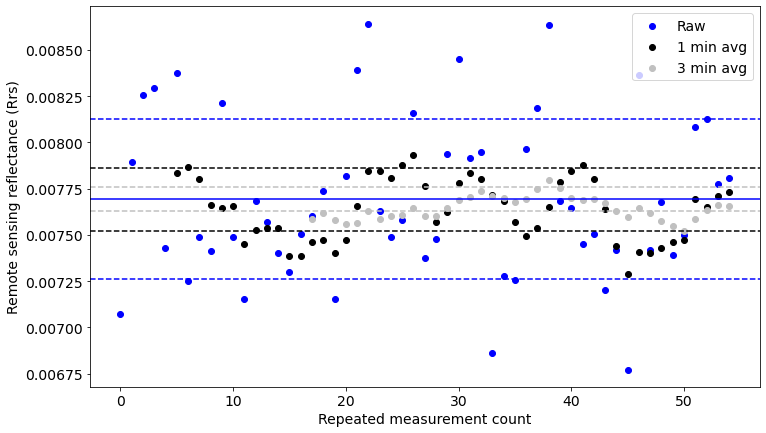

In [53]:
fig, ax = plt.subplots(figsize=(12,7))

for l,u,c in [[156,161,'blue']]:
    band_mean = static_trios_df.iloc[:, l:u].mean().mean()
    ax.axhline(band_mean,color=c)
    
    for i,c_std in [[1,'blue'],[6,'black'],[6*3,'silver']]:
        band_std = static_trios_df.rolling(window=i).mean().iloc[:, l:u].mean(axis=1).std()
        ax.axhline(band_mean+band_std,color=c_std, ls='--')
        ax.axhline(band_mean-band_std,color=c_std, ls='--')


    ax.scatter(range(len(static_trios_df)),static_trios_df.iloc[:, l:u].mean(axis=1),color=c, alpha=1, label='Raw')
    ax.scatter(range(len(static_trios_df)),static_trios_df.rolling(window=6).mean().iloc[:, l:u].mean(axis=1),color='black', alpha=1, label='1 min avg')
    ax.scatter(range(len(static_trios_df)),static_trios_df.rolling(window=6*3).mean().iloc[:, l:u].mean(axis=1),color='silver', alpha=1, label='3 min avg')
ax.legend(loc='upper right')    
ax.set_ylabel('Remote sensing reflectance (Rrs)')
ax.set_xlabel('Repeated measurement count')
# fig.savefig('repeated_measurements_blue_avg.png',dpi=300)

You need the uncertainties package for this.

In [54]:
# pip install --upgrade uncertainties

In [55]:
from uncertainties import ufloat
from uncertainties.umath import *  # sin(), etc.

In [56]:
blue_u = ufloat(static_trios_df.iloc[:, 156:161].mean().mean(), np.std(static_trios_df.iloc[:, 156:161].mean(axis=1).values))
green_u = ufloat(static_trios_df.iloc[:, 232:240].mean().mean(), np.std(static_trios_df.iloc[:, 232:240].mean(axis=1).values))
red_u = ufloat(static_trios_df.iloc[:, 346:351].mean().mean(), np.std(static_trios_df.iloc[:, 346:351].mean(axis=1).values))
blue_u, green_u, red_u

(0.007692916094545454+/-0.0004316484016933594,
 0.002850563672727273+/-0.0003025047880319788,
 0.000854057709090909+/-0.00020191965759646383)

In [57]:
blue_u = ufloat(static_trios_df.iloc[:, 156:161].mean().mean(), np.std(static_trios_df.iloc[:, 156:161].mean(axis=1).values))
green_u = ufloat(static_trios_df.iloc[:, 232:240].mean().mean(), np.std(static_trios_df.iloc[:, 232:240].mean(axis=1).values))
red_u = ufloat(static_trios_df.iloc[:, 346:351].mean().mean(), np.std(static_trios_df.iloc[:, 346:351].mean(axis=1).values))
blue_u, green_u, red_u

(0.007692916094545454+/-0.0004316484016933594,
 0.002850563672727273+/-0.0003025047880319788,
 0.000854057709090909+/-0.00020191965759646383)

Uncertainty based on the group of wavelengths used to calculate chla.

In [59]:
blue_uncert = np.std(static_trios_df.iloc[:, 156:161].mean(axis=1).values)
green_uncert = np.std(static_trios_df.iloc[:, 232:240].mean(axis=1).values)
red_uncert = np.std(static_trios_df.iloc[:, 346:351].mean(axis=1).values)
blue_uncert, green_uncert, red_uncert

(0.0004316484016933594, 0.0003025047880319788, 0.00020191965759646383)

Uncertainty based on a rolling window average of 6 measurements (1 minute)

In [306]:
blue_uncert = np.nanstd(static_trios_df.rolling(window=6).mean().iloc[:, 156:161].mean(axis=1).values)
green_uncert = np.nanstd(static_trios_df.rolling(window=6).mean().iloc[:, 232:240].mean(axis=1).values)
red_uncert = np.nanstd(static_trios_df.rolling(window=6).mean().iloc[:, 346:351].mean(axis=1).values)
blue_uncert, green_uncert, red_uncert

(0.00016776638783025022, 0.00010788283891465276, 7.161309946806462e-05)

In [62]:
chla_uncerts = []

for i in range(len(trios_df)):
    blue_u = ufloat(trios_df.iloc[i, 156:161].mean(), blue_uncert)
    green_u = ufloat(trios_df.iloc[i, 232:240].mean(), green_uncert) 
    red_u = ufloat(trios_df.iloc[i, 346:351].mean(), red_uncert)
    
    chla_u = oc_index(blue_u, green_u, red_u)
    
    chla_uncert = chla_u.s
    chla_uncerts.append(chla_uncert)

Example of calculating uncertainty

In [63]:
blue_u = ufloat(trios_df.iloc[i, 156:161].mean(), blue_uncert)
green_u = ufloat(trios_df.iloc[i, 232:240].mean(), green_uncert) 
red_u = ufloat(trios_df.iloc[i, 346:351].mean(), red_uncert)

chla_u = oc_index(blue_u, green_u, red_u)

In [64]:
trios_df.iloc[i, 156:161].mean(), blue_uncert

(0.0075986914000000004, 0.0004316484016933594)

In [65]:
-260.43*(10**(-.49+191.7*(0.0024-0.59*0.0064-.41*0.00068)))*0.000167

-0.006779260494532654

In [66]:
(441.41*(10**(-.49+191.7*(0.0024-0.59*0.0064-.41*0.00068)))*0.000107)

0.007362084289281303

In [67]:
(-180.98*(10**(-.49+191.7*(0.0024-0.59*0.0064-.41*0.00068)))*0.0000716)

-0.002019846872409247

In [68]:
import math
math.sqrt(0.0068**2+0.0074**2+0.002**2)

0.010246950765959599

In [69]:
blue_u, green_u, red_u

(0.0075986914000000004+/-0.0004316484016933594,
 0.004682888499999999+/-0.0003025047880319788,
 0.0030533482+/-0.00020191965759646383)

In [70]:
chla_u.error_components()

{0.0075986914000000004+/-0.0004316484016933594: 0.022862937692841537,
 0.0030533482+/-0.00020191965759646383: 0.007448298560927712,
 0.004682888499999999+/-0.0003025047880319788: 0.027181268898308585}

In [71]:
chla_u

0.20360693550654468+/-0.03629066615979417

In [72]:
chla_u

0.20360693550654468+/-0.03629066615979417

In [73]:
trios_df['chla_uncert'] = chla_uncerts

<ipython-input-74-779b19d7db1a>:5: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean(), color='black', lw=3)
<ipython-input-74-779b19d7db1a>:6: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean()+static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
<ipython-input-74-779b19d7db1a>:7: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean()-static_trios_df.iloc[:, :-2].std(), color='black', ls='--')


Text(0.5, 0, 'Wavelength (nm)')

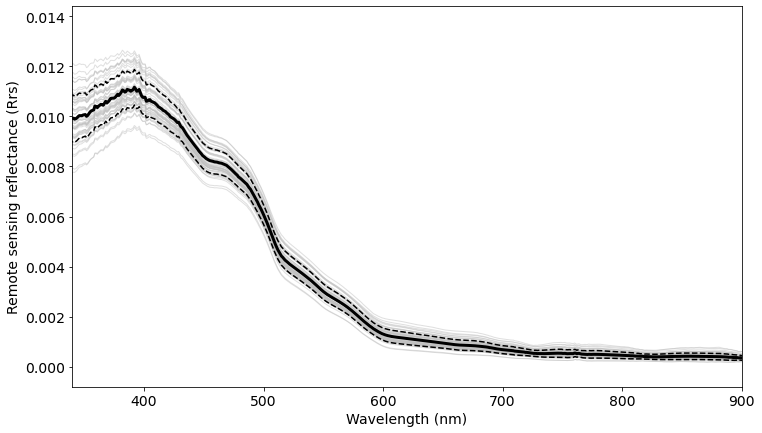

In [74]:
fig, ax = plt.subplots(figsize=(12,7))
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, 1:-2].values.T, color='silver', lw=1, alpha=0.5)
# ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, 1:-2]+static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
# ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, 1:-2]-static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean(), color='black', lw=3)
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean()+static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean()-static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
ax.set_xlim(340,900)
ax.set_ylabel('Remote sensing reflectance (Rrs)')
ax.set_xlabel('Wavelength (nm)')
# fig.savefig('spectrum_repeated.png',dpi=300)

(340.0, 900.0)

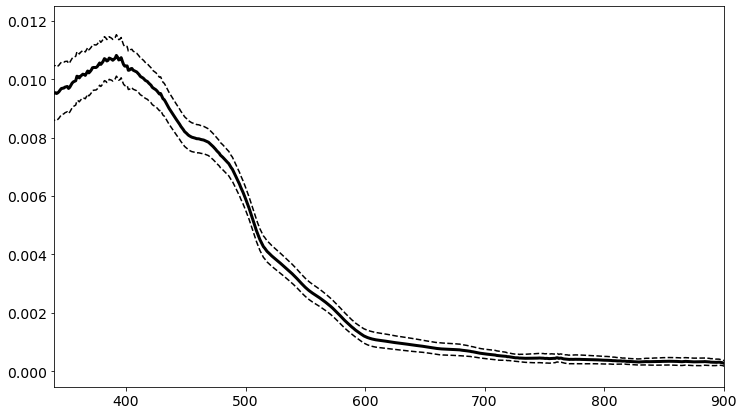

In [75]:
fig, ax = plt.subplots(figsize=(12,7))
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[50, 1:-2], color='black', lw=3)
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[50, 1:-2]+static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[50, 1:-2]-static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
ax.set_xlim(340,900)


<ipython-input-76-f8aafffdfa3d>:2: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean(), color='black', lw=3)
<ipython-input-76-f8aafffdfa3d>:3: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean()+static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
<ipython-input-76-f8aafffdfa3d>:4: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean()-static_trios_df.iloc[:, :-2].std(), color='black', ls='--')


(340.0, 900.0)

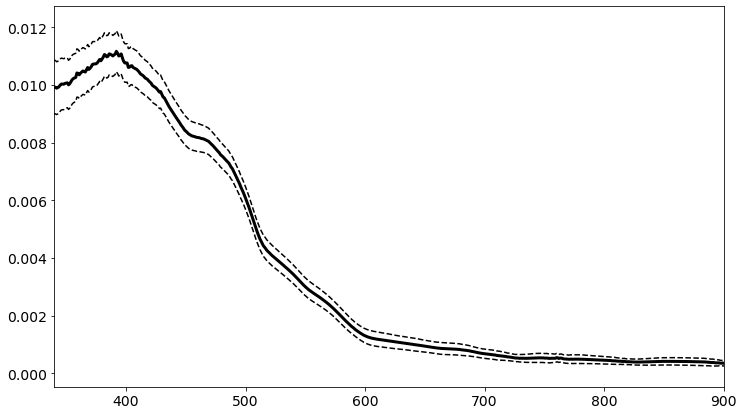

In [76]:
fig, ax = plt.subplots(figsize=(12,7))
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean(), color='black', lw=3)
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean()+static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), static_trios_df.iloc[:, :-1].mean()-static_trios_df.iloc[:, :-2].std(), color='black', ls='--')
ax.set_xlim(340,900)


### Now look at this on a specific transect

In [29]:
transect = 2
df_transect = df.loc[start_times[transect]:end_times[transect]]
trios_df_transect = trios_df.loc[start_times[transect]:end_times[transect]]
cdom_df_transect = cdom_df.loc[start_times[transect]:end_times[transect]]

Text(0.5, 1.0, '')

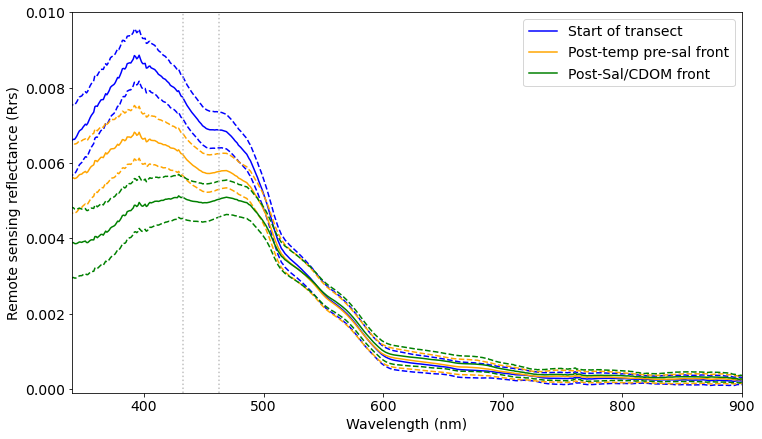

In [79]:
fig,ax = plt.subplots(figsize=(12,7))
ax.plot(static_trios_df.columns[1:-2].astype(int),trios_df_transect.loc['2021-08-27 16:15:00':'2021-08-27 16:20:00'].median(numeric_only=True).iloc[:-2],label='Start of transect', color='blue',)
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 16:15:00':'2021-08-27 16:20:00'].median(numeric_only=True).iloc[:-2]+static_trios_df.iloc[:, :-2].std(), color='blue', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 16:15:00':'2021-08-27 16:20:00'].median(numeric_only=True).iloc[:-2]-static_trios_df.iloc[:, :-2].std(), color='blue', ls='--')


# trios_df_transect.loc['2021-08-27 16:37:00':'2021-08-27 16:43:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-temp front')
# trios_df_transect.loc['2021-08-27 16:48:00':'2021-08-27 16:53:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-temp front')
# trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-Sal/CDOM front')


# trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-temp pre-sal front')
ax.plot(static_trios_df.columns[1:-2].astype(int),trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2],label='Post-temp pre-sal front', color='orange',)
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2]+static_trios_df.iloc[:, :-2].std(), color='orange', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2]-static_trios_df.iloc[:, :-2].std(), color='orange', ls='--')



ax.plot(static_trios_df.columns[1:-2].astype(int),trios_df_transect.loc['2021-08-27 17:34:00':'2021-08-27 17:38:00'].median(numeric_only=True).iloc[:-2],label='Post-Sal/CDOM front',  color='green', )
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 17:34:00':'2021-08-27 17:38:00'].median(numeric_only=True).iloc[:-2]+static_trios_df.iloc[:, :-2].std(), color='green', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 17:34:00':'2021-08-27 17:38:00'].median(numeric_only=True).iloc[:-2]-static_trios_df.iloc[:, :-2].std(), color='green', ls='--')


ax.axvline(443-10, color='silver', ls='dotted')
ax.axvline(443+20, color='silver', ls='dotted')

ax.legend()
ax.set_ylabel('Remote sensing reflectance (Rrs)')
ax.set_xlabel('Wavelength (nm)')

ax.set_xlim(340,900)
ax.set_ylim(-0.0001,0.01)

ax.set_title('')


# plt.savefig('radiometry_spectra_across_front.png',dpi=300)


(-0.0001, 0.01)

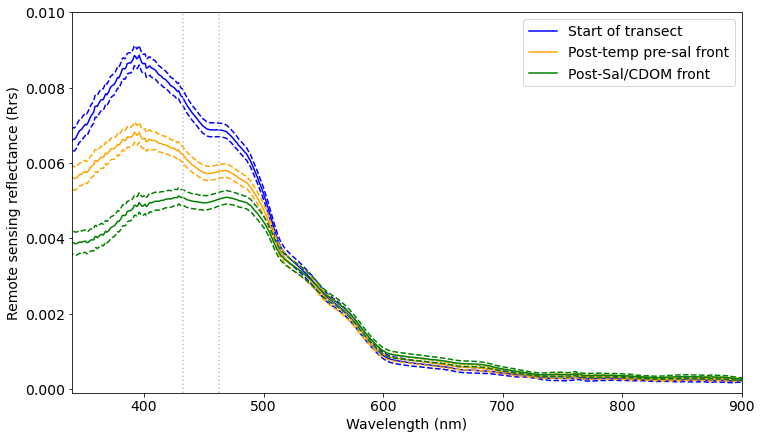

In [80]:
fig,ax = plt.subplots(figsize=(12,7))
ax.plot(static_trios_df.columns[1:-2].astype(int),trios_df_transect.loc['2021-08-27 16:15:00':'2021-08-27 16:20:00'].median(numeric_only=True).iloc[:-2],label='Start of transect', color='blue',)
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 16:15:00':'2021-08-27 16:20:00'].median(numeric_only=True).iloc[:-2]+static_trios_df.rolling(6).mean().iloc[:, :-2].std(), color='blue', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 16:15:00':'2021-08-27 16:20:00'].median(numeric_only=True).iloc[:-2]-static_trios_df.rolling(6).mean().iloc[:, :-2].std(), color='blue', ls='--')


# trios_df_transect.loc['2021-08-27 16:37:00':'2021-08-27 16:43:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-temp front')
# trios_df_transect.loc['2021-08-27 16:48:00':'2021-08-27 16:53:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-temp front')
# trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-Sal/CDOM front')

# trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-temp pre-sal front')
ax.plot(static_trios_df.columns[1:-2].astype(int),trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2],label='Post-temp pre-sal front', color='orange',)
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2]+static_trios_df.rolling(6).mean().iloc[:, :-2].std(), color='orange', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2]-static_trios_df.rolling(6).mean().iloc[:, :-2].std(), color='orange', ls='--')



ax.plot(static_trios_df.columns[1:-2].astype(int),trios_df_transect.loc['2021-08-27 17:34:00':'2021-08-27 17:38:00'].median(numeric_only=True).iloc[:-2],label='Post-Sal/CDOM front',  color='green', )
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 17:34:00':'2021-08-27 17:38:00'].median(numeric_only=True).iloc[:-2]+static_trios_df.rolling(6).mean().iloc[:, :-2].std(), color='green', ls='--')
ax.plot(static_trios_df.columns[1:-2].astype(int), trios_df_transect.loc['2021-08-27 17:34:00':'2021-08-27 17:38:00'].median(numeric_only=True).iloc[:-2]-static_trios_df.rolling(6).mean().iloc[:, :-2].std(), color='green', ls='--')


ax.axvline(443-10, color='silver', ls='dotted')
ax.axvline(443+20, color='silver', ls='dotted')

ax.legend()
ax.set_ylabel('Remote sensing reflectance (Rrs)')
ax.set_xlabel('Wavelength (nm)')

ax.set_xlim(340,900)
ax.set_ylim(-0.0001,0.01)



# plt.savefig('radiometry_spectra_across_front_binned.png',dpi=300)


In [81]:
start_times[transect]

'2021-08-27 16:09:00'

In [82]:
end_times[transect]

'2021-08-27 17:40:00'

In [83]:
plt.rcParams.update({'font.size': 16})

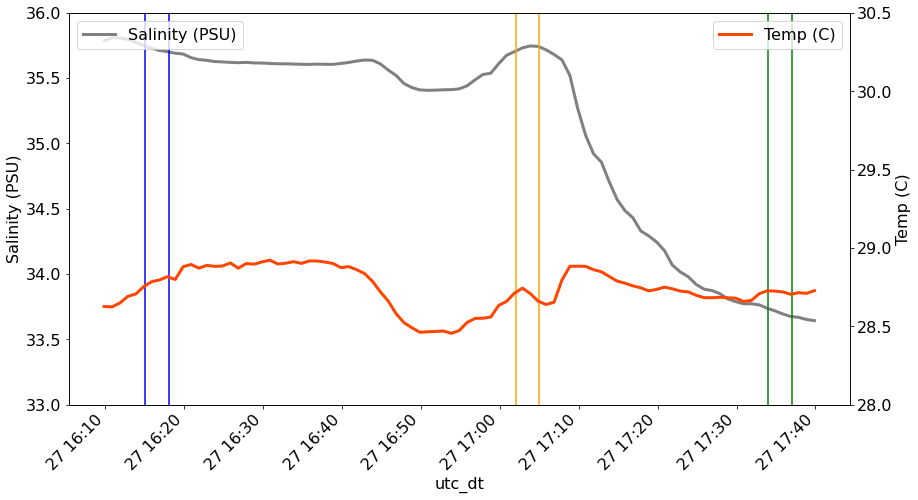

In [84]:
fig, ax = plt.subplots(figsize=(14,8))

df_transect.plot(y='TSG--sal',ax=ax, linewidth=3, color='grey', label='Salinity (PSU)')
ax.set_ylim(33,36)

ax1 = ax.twinx()
df_transect.plot(y='TSG--temp-SBE38',ax=ax1, linewidth=3, color='orangered', label='Temp (C)')
ax1.set_ylim(28,30.5)

ax.axvline('2021-08-27 16:15:00',color='blue')
ax.axvline('2021-08-27 16:18:00',color='blue')

ax.axvline('2021-08-27 17:02:00',color='orange')
ax.axvline('2021-08-27 17:05:00',color='orange')

ax.axvline('2021-08-27 17:34:00',color='green')
ax.axvline('2021-08-27 17:37:00',color='green')

ax.legend(loc='upper left')
ax1.legend(loc='upper right')
ax.set_ylabel('Salinity (PSU)')
ax1.set_ylabel('Temp (C)')

# ax.set_ylim(0.000,0.012)
fig.autofmt_xdate(rotation=45)
# fig.savefig('sal_temp_front.png')

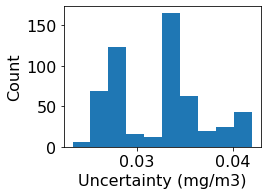

In [86]:
fig, ax = plt.subplots(figsize=(4,3))
ax.hist(trios_df_transect['chla_uncert'])
ax.set_ylabel('Count')
ax.set_xlabel('Uncertainty (mg/m3)')
fig.tight_layout()
# fig.savefig('uncertanty_distribution.png',dpi=300)

In [87]:
trios_df_transect['chla_oci']

utc_dt
2021-08-27 16:09:00    0.151699
2021-08-27 16:09:10    0.153381
2021-08-27 16:09:20    0.151364
2021-08-27 16:09:30    0.147087
2021-08-27 16:09:40    0.149037
                         ...   
2021-08-27 17:39:20    0.232420
2021-08-27 17:39:30    0.227189
2021-08-27 17:39:40    0.233379
2021-08-27 17:39:50    0.235517
2021-08-27 17:40:00    0.221562
Name: chla_oci, Length: 541, dtype: float64

The uncertainty is basically proportional to the chla

In [88]:
np.unique(trios_df_transect['chla_uncert']/trios_df_transect['chla_oci'])

array([0.17823885, 0.17823885, 0.17823885, 0.17823885])

In [325]:
trios_df_transect['chla_oci']

utc_dt
2021-08-27 16:09:00    0.151699
2021-08-27 16:09:10    0.153381
2021-08-27 16:09:20    0.151364
2021-08-27 16:09:30    0.147087
2021-08-27 16:09:40    0.149037
                         ...   
2021-08-27 17:39:20    0.232420
2021-08-27 17:39:30    0.227189
2021-08-27 17:39:40    0.233379
2021-08-27 17:39:50    0.235517
2021-08-27 17:40:00    0.221562
Name: chla_oci, Length: 541, dtype: float64

In [89]:
trios_df_transect['chla_uncert']

utc_dt
2021-08-27 16:09:00    0.027039
2021-08-27 16:09:10    0.027338
2021-08-27 16:09:20    0.026979
2021-08-27 16:09:30    0.026217
2021-08-27 16:09:40    0.026564
                         ...   
2021-08-27 17:39:20    0.041426
2021-08-27 17:39:30    0.040494
2021-08-27 17:39:40    0.041597
2021-08-27 17:39:50    0.041978
2021-08-27 17:40:00    0.039491
Name: chla_uncert, Length: 541, dtype: float64

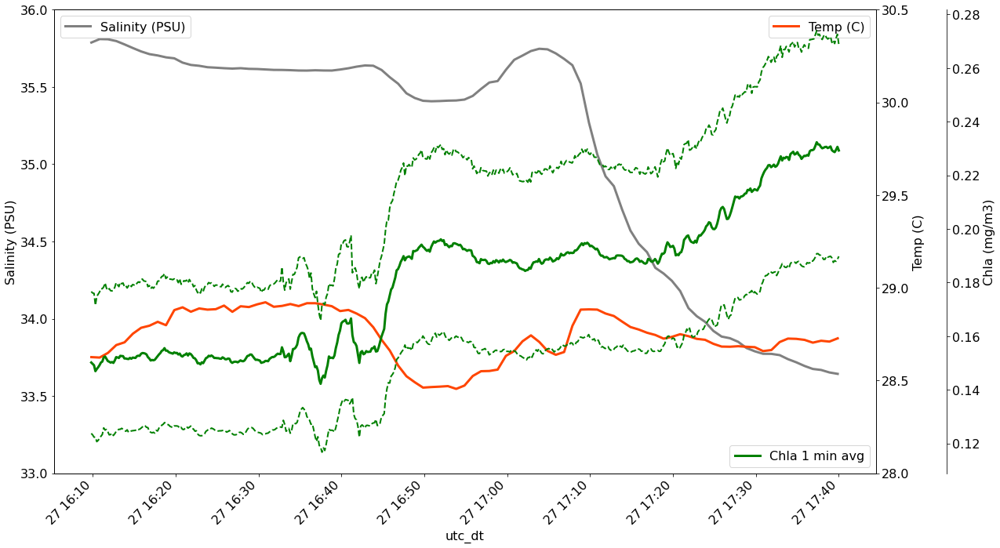

In [90]:
fig, ax = plt.subplots(figsize=(18,10))

df_transect.plot(y='TSG--sal',ax=ax, linewidth=3, color='grey', label='Salinity (PSU)')
ax.set_ylim(33,36)

ax1 = ax.twinx()
df_transect.plot(y='TSG--temp-SBE38',ax=ax1, linewidth=3, color='orangered', label='Temp (C)')
ax1.set_ylim(28,30.5)

ax2 = ax.twinx()

trios_df_transect['chla_oci'].rolling(window=6).mean().plot(ax=ax2, color='green', label='Chla 1 min avg', linewidth=3)
(trios_df_transect['chla_oci'].rolling(window=6).mean()-trios_df_transect['chla_uncert']).plot(ax=ax2, color='green', label='', linewidth=2, ls='--')
(trios_df_transect['chla_oci'].rolling(window=6).mean()+trios_df_transect['chla_uncert']).plot(ax=ax2, color='green', label='', linewidth=2, ls='--')

# ax.axvline('2021-08-27 16:15:00',color='blue')
# ax.axvline('2021-08-27 16:18:00',color='blue')

# ax.axvline('2021-08-27 17:02:00',color='orange')
# ax.axvline('2021-08-27 17:05:00',color='orange')

# ax.axvline('2021-08-27 17:34:00',color='green')
# ax.axvline('2021-08-27 17:37:00',color='green')

ax.legend(loc='upper left')
ax1.legend(loc='upper right')
ax2.legend(loc='lower right')

ax.set_ylabel('Salinity (PSU)')
ax1.set_ylabel('Temp (C)')
ax2.set_ylabel('Chla (mg/m3)')

ax2.spines['right'].set_position(('outward', 90))

# ax.set_ylim(0.000,0.012)
fig.autofmt_xdate(rotation=45)
fig.tight_layout()
# fig.savefig('chla_uncert_sal_temp.png')

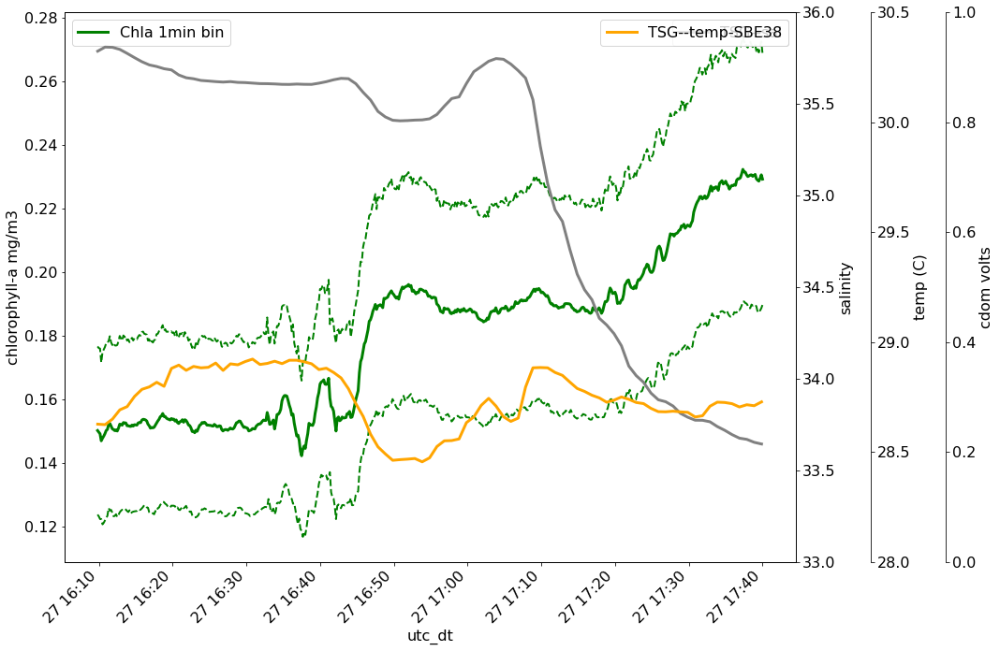

In [91]:
fig, ax = plt.subplots(figsize=(14,12))

ax2 = ax.twinx()
ax3 = ax.twinx()
ax4 = ax.twinx()

ax3.spines['right'].set_position(('outward', 80))
ax4.spines['right'].set_position(('outward', 160))


df_transect.plot(y='TSG--sal',ax=ax2, linewidth=3, color='grey')
ax2.set_ylim(33,36)

df_transect.plot(y='TSG--temp-SBE38',ax=ax3, linewidth=3, color='orange')
ax3.set_ylim(28,30.5)

trios_df_transect['chla_oci'].rolling(window=6).mean().plot(ax=ax, color='green', label='Chla 1min bin', linewidth=3)
(trios_df_transect['chla_oci'].rolling(window=6).mean()-trios_df_transect['chla_uncert']).plot(ax=ax, color='green', label='', linewidth=2, ls='--')
(trios_df_transect['chla_oci'].rolling(window=6).mean()+trios_df_transect['chla_uncert']).plot(ax=ax, color='green', label='', linewidth=2, ls='--')

ax.legend(loc='upper left')
ax.set_ylabel('chlorophyll-a mg/m3')
ax2.set_ylabel('salinity')
ax3.set_ylabel('temp (C)')
ax4.set_ylabel('cdom volts')


# ax.set_ylim(0.000,0.012)
fig.autofmt_xdate(rotation=45)
# fig.savefig('chla_uncert_sal_temp.png')

### Explore the radiometer data a bit more

Checking out and clustering a transect

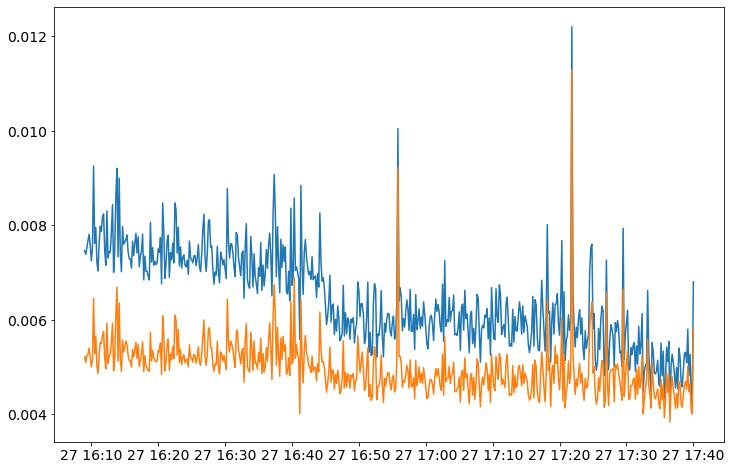

In [79]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(trios_df_transect['440'].rolling(window=1).mean())
ax.plot(trios_df_transect['500'].rolling(window=1).mean())


In [317]:
len(start_times)

13

In [34]:
transect = 12
df_transect = df.loc[start_times[transect]:end_times[transect]]
trios_df_transect = trios_df.loc[start_times[transect]:end_times[transect]]
cdom_df_transect = cdom_df.loc[start_times[transect]:end_times[transect]]


In [35]:
# Calculate rolling median
rolling_440 = trios_df_transect['440'].rolling(window=6*2).median()
upper_threshold = 0.0005
lower_threshold = -0.0005

# all in one line 
df_filtered = trios_df_transect.drop(trios_df_transect[(trios_df_transect['440']-rolling_440>upper_threshold)|(trios_df_transect['440']- rolling_440<lower_threshold)].index) 
# if you want to drop the column as well
# del df["rolling_temp"]

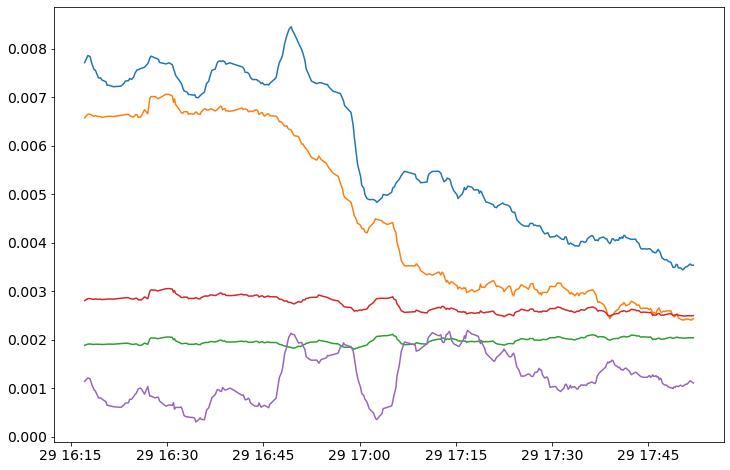

In [36]:
fig, ax = plt.subplots(figsize=(12,8))
# ax.plot(trios_df_transect['440'].rolling(window=1).mean())
# ax.plot(trios_df_transect['460'].rolling(window=1).mean())
# ax.plot(trios_df_transect['440'].rolling(window=6*3).mean())
# ax.plot(df_filtered['440'])
ax.plot(df_filtered['440'].rolling(window=6*2).mean())
ax.plot(df_filtered['440'].rolling(window=6*2).mean()-df_filtered['660'].rolling(window=6*2).mean())
ax.plot(df_filtered['550'].rolling(window=6*2).mean()-df_filtered['660'].rolling(window=6*2).mean())

ax.plot(df_filtered['520'].rolling(window=6*2).mean()-df_filtered['660'].rolling(window=6*2).mean())


ax.plot(df_filtered['660'].rolling(window=6*2).mean())

# ax.set_ylim(0.002,0.01)
# trios_df_transect.plot('440')

In [37]:
df_filtered.iloc[:,1:-2]

,320,321,322,323,324,325,326,327,328,329,...,941,942,943,944,945,946,947,948,949,950
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-29 16:15:10,0.005114,0.005222,0.005263,0.005213,0.005151,0.005104,0.005136,0.005065,0.004927,0.004996,...,-0.000540,-0.000588,-0.000501,-0.000380,-0.000261,-0.000355,-0.000570,-0.000821,-0.000906,-0.000869
2021-08-29 16:15:20,0.005856,0.005944,0.005960,0.005886,0.005808,0.005748,0.005771,0.005692,0.005550,0.005628,...,0.000032,-0.000098,0.000016,0.000121,0.000225,0.000099,-0.000029,-0.000143,-0.000068,0.000041
2021-08-29 16:15:30,0.007062,0.007106,0.007089,0.007012,0.006933,0.006873,0.006898,0.006812,0.006656,0.006719,...,0.000774,0.000721,0.000598,0.000537,0.000477,0.000580,0.000604,0.000588,0.000598,0.000657
2021-08-29 16:15:40,0.006130,0.006210,0.006234,0.006173,0.006105,0.006053,0.006076,0.005999,0.005859,0.005925,...,0.000475,0.000510,0.000535,0.000505,0.000473,0.000465,0.000465,0.000468,0.000540,0.000640
2021-08-29 16:15:50,0.006626,0.006690,0.006703,0.006633,0.006552,0.006487,0.006513,0.006442,0.006306,0.006369,...,-0.000072,-0.000043,0.000073,0.000190,0.000306,0.000350,0.000381,0.000411,0.000389,0.000327
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-29 17:50:50,0.003403,0.003446,0.003451,0.003403,0.003342,0.003295,0.003297,0.003224,0.003109,0.003144,...,0.000499,0.000532,0.000503,0.000487,0.000472,0.000479,0.000473,0.000461,0.000465,0.000468
2021-08-29 17:51:00,0.003165,0.003203,0.003202,0.003158,0.003104,0.003064,0.003071,0.003000,0.002887,0.002922,...,0.000216,0.000156,0.000135,0.000163,0.000192,0.000211,0.000224,0.000234,0.000240,0.000236
2021-08-29 17:51:30,0.003332,0.003375,0.003376,0.003336,0.003281,0.003240,0.003246,0.003172,0.003055,0.003089,...,0.001219,0.001187,0.001195,0.001245,0.001295,0.001343,0.001358,0.001360,0.001333,0.001300


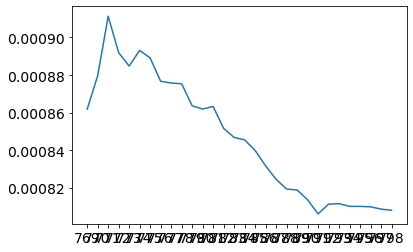

In [38]:
plt.plot(df_filtered.iloc[:,450:480].mean())

In [39]:
corrected_specs = []
for i in range(len(df_filtered.iloc[:,1:-2])):
    corrected_specs.append(df_filtered.iloc[i,1:-2] - df_filtered.iloc[i,450:480].mean())

In [40]:
corrected_specs = pd.DataFrame(corrected_specs, columns=df_filtered.columns[1:-2] )

In [41]:
corrected_specs['chla_oci'] = oc_index(corrected_specs.iloc[:, 156:161].mean(axis=1).values, corrected_specs.iloc[:, 232:240].mean(axis=1).values, corrected_specs.iloc[:, 346:351].mean(axis=1).values)

In [42]:
corrected_specs['TimeStamp'] = df_filtered['TimeStamp']

<AxesSubplot:xlabel='utc_dt'>

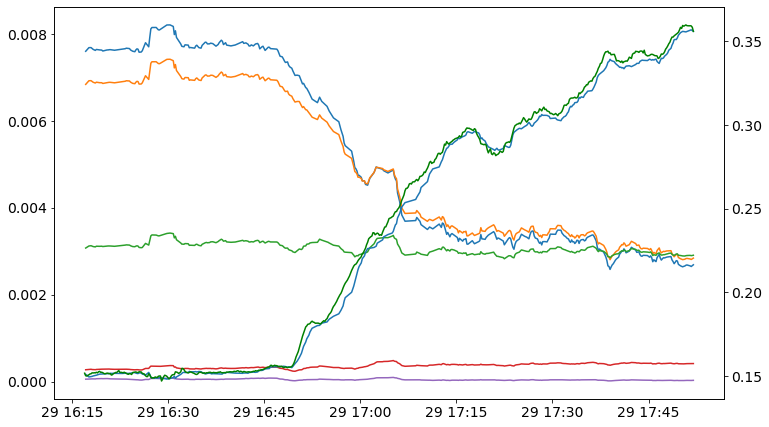

In [43]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(corrected_specs['420'].rolling(window=6*2).mean())
ax.plot(corrected_specs['440'].rolling(window=6*2).mean())

ax.plot(corrected_specs['520'].rolling(window=6*2).mean())


ax.plot(corrected_specs['660'].rolling(window=6*2).mean())
ax.plot(corrected_specs['750'].rolling(window=6*2).mean())

ax2 = ax.twinx()
ax2.plot(corrected_specs['chla_oci'].rolling(window=6*2).mean())
trios_df_transect['chla_oci'].rolling(window=6*2).mean().plot(ax=ax2, color='green')

# ax.set_ylim(0.002,0.01)
# trios_df_transect.plot('440')

In [100]:
trios_df_transect

,TimeStamp,320,321,322,323,324,325,326,327,328,...,943,944,945,946,947,948,949,950,datetime,chla_oci
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-29 16:15:10,8/29/2021 12:15:10,0.005114,0.005222,0.005263,0.005213,0.005151,0.005104,0.005136,0.005065,0.004927,...,-0.000501,-0.000380,-0.000261,-0.000355,-0.000570,-0.000821,-0.000906,-0.000869,2021-08-29 12:15:10,0.169043
2021-08-29 16:15:20,8/29/2021 12:15:20,0.005856,0.005944,0.005960,0.005886,0.005808,0.005748,0.005771,0.005692,0.005550,...,0.000016,0.000121,0.000225,0.000099,-0.000029,-0.000143,-0.000068,0.000041,2021-08-29 12:15:20,0.150944
2021-08-29 16:15:30,8/29/2021 12:15:30,0.007062,0.007106,0.007089,0.007012,0.006933,0.006873,0.006898,0.006812,0.006656,...,0.000598,0.000537,0.000477,0.000580,0.000604,0.000588,0.000598,0.000657,2021-08-29 12:15:30,0.150044
2021-08-29 16:15:40,8/29/2021 12:15:40,0.006130,0.006210,0.006234,0.006173,0.006105,0.006053,0.006076,0.005999,0.005859,...,0.000535,0.000505,0.000473,0.000465,0.000465,0.000468,0.000540,0.000640,2021-08-29 12:15:40,0.146196
2021-08-29 16:15:50,8/29/2021 12:15:50,0.006626,0.006690,0.006703,0.006633,0.006552,0.006487,0.006513,0.006442,0.006306,...,0.000073,0.000190,0.000306,0.000350,0.000381,0.000411,0.000389,0.000327,2021-08-29 12:15:50,0.148591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-29 17:51:20,8/29/2021 13:51:20,0.004854,0.004898,0.004895,0.004826,0.004736,0.004664,0.004668,0.004576,0.004427,...,0.001078,0.001156,0.001232,0.001153,0.001040,0.000924,0.000928,0.001006,2021-08-29 13:51:20,0.351027
2021-08-29 17:51:30,8/29/2021 13:51:30,0.003332,0.003375,0.003376,0.003336,0.003281,0.003240,0.003246,0.003172,0.003055,...,0.001195,0.001245,0.001295,0.001343,0.001358,0.001360,0.001333,0.001300,2021-08-29 13:51:30,0.361415
2021-08-29 17:51:40,8/29/2021 13:51:40,0.002666,0.002694,0.002687,0.002651,0.002599,0.002559,0.002560,0.002492,0.002386,...,0.000652,0.000668,0.000681,0.000725,0.000757,0.000782,0.000729,0.000647,2021-08-29 13:51:40,0.364495


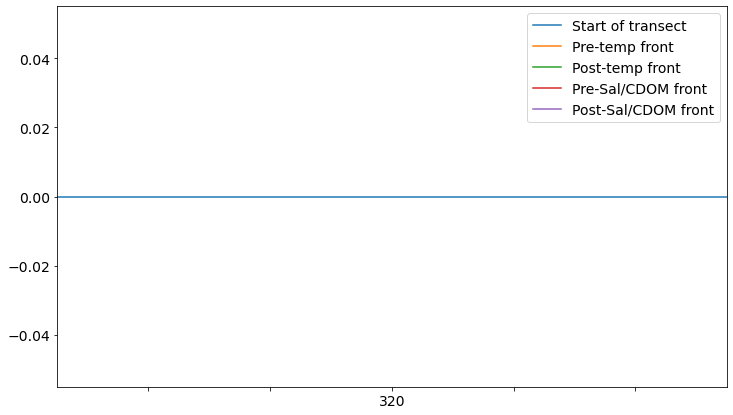

In [96]:
fig,ax = plt.subplots(figsize=(12,7))
trios_df_transect.loc['2021-08-27 16:15:00':'2021-08-27 16:20:00'].median(numeric_only=True).iloc[:-2].plot(label='Start of transect')

trios_df_transect.loc['2021-08-27 16:37:00':'2021-08-27 16:43:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-temp front')
trios_df_transect.loc['2021-08-27 16:48:00':'2021-08-27 16:53:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-temp front')
trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-Sal/CDOM front')
trios_df_transect.loc['2021-08-27 17:23:00':'2021-08-27 17:38:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-Sal/CDOM front')

ax.axhline(0)

ax.legend()
# plt.savefig('radiometry_spectra.png')


In [ ]:
fig,ax = plt.subplots(figsize=(12,7))
trios_df_transect.loc['2021-08-27 16:15:00':'2021-08-27 16:20:00'].median(numeric_only=True).iloc[:-2].plot(label='Start of transect')

trios_df_transect.loc['2021-08-27 16:37:00':'2021-08-27 16:43:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-temp front')
trios_df_transect.loc['2021-08-27 16:48:00':'2021-08-27 16:53:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-temp front')
trios_df_transect.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-Sal/CDOM front')
trios_df_transect.loc['2021-08-27 17:23:00':'2021-08-27 17:38:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-Sal/CDOM front')

ax.axhline(0)

ax.legend()
# plt.savefig('radiometry_spectra.png')


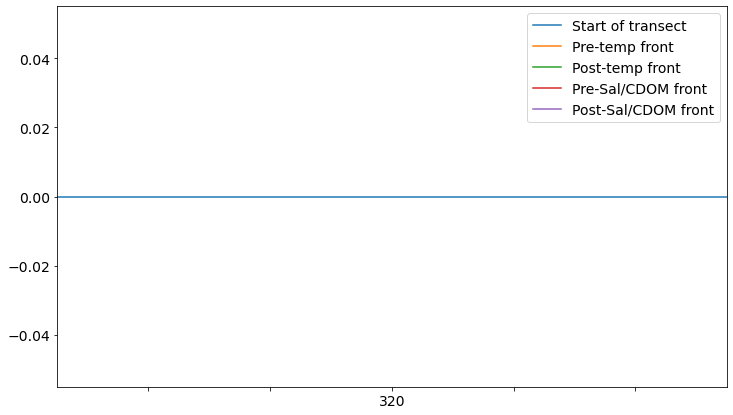

In [45]:
fig,ax = plt.subplots(figsize=(12,7))
corrected_specs.loc['2021-08-27 16:15:00':'2021-08-27 16:20:00'].median(numeric_only=True).iloc[:-2].plot(label='Start of transect')

corrected_specs.loc['2021-08-27 16:37:00':'2021-08-27 16:43:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-temp front')
corrected_specs.loc['2021-08-27 16:48:00':'2021-08-27 16:53:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-temp front')
corrected_specs.loc['2021-08-27 17:02:00':'2021-08-27 17:08:00'].median(numeric_only=True).iloc[:-2].plot(label='Pre-Sal/CDOM front')
corrected_specs.loc['2021-08-27 17:23:00':'2021-08-27 17:38:00'].median(numeric_only=True).iloc[:-2].plot(label='Post-Sal/CDOM front')

ax.axhline(0)

ax.legend()
# plt.savefig('radiometry_spectra.png')


In [ ]:
16:20-16:30, pelgic side of front, 16:53-16:56 at front, 17:15-17:20 coastal side of front before secondary front, 17:40-17:45 coastal side of both fronts

In [106]:
corrected_specs.loc['2021-08-29 16:20:00':'2021-08-29 16:25:00'].median(numeric_only=True).iloc[:-5]

320    0.005382
321    0.005458
322    0.005472
323    0.005399
324    0.005313
         ...   
946   -0.000337
947   -0.000295
948   -0.000282
949   -0.000279
950   -0.000264
Length: 631, dtype: float64

In [117]:
corrected_specs.loc['2021-08-29 17:53:00':'2021-08-29 17:59:00']

,320,321,322,323,324,325,326,327,328,329,...,948,949,950,chla_oci,TimeStamp,lat,lon,sal,temp,geometry


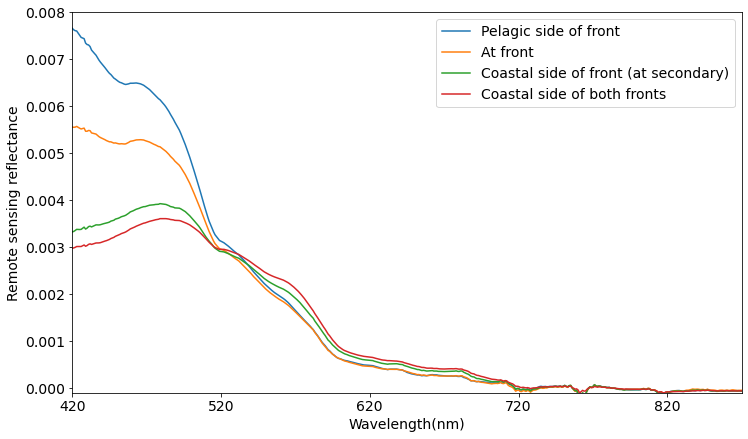

In [129]:
fig,ax = plt.subplots(figsize=(12,7))
corrected_specs.loc['2021-08-29 16:20:00':'2021-08-29 16:25:00'].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front')
corrected_specs.loc['2021-08-29 16:53:00':'2021-08-29 16:56:00'].median(numeric_only=True).iloc[:-5].plot(label='At front')
corrected_specs.loc['2021-08-29 17:15:00':'2021-08-29 17:20:00'].median(numeric_only=True).iloc[:-5].plot(label='Coastal side of front (at secondary)')
corrected_specs.loc['2021-08-29 17:40:00':'2021-08-29 17:45:00'].median(numeric_only=True).iloc[:-5].plot(label='Coastal side of both fronts')

# ax.axhline(0)
ax.set_xlim(100,550)
ax.set_ylim(-0.0001,0.008)
ax.set_xlabel('Wavelength(nm)')
ax.set_ylabel('Remote sensing reflectance')

ax.legend()
plt.savefig('figs/aug2916_radiometry_spectra.png')


In [229]:
trios_subset[kmeans.labels_==0].iloc[:,:-7].values.T.mean(axis=1).shape

(631,)

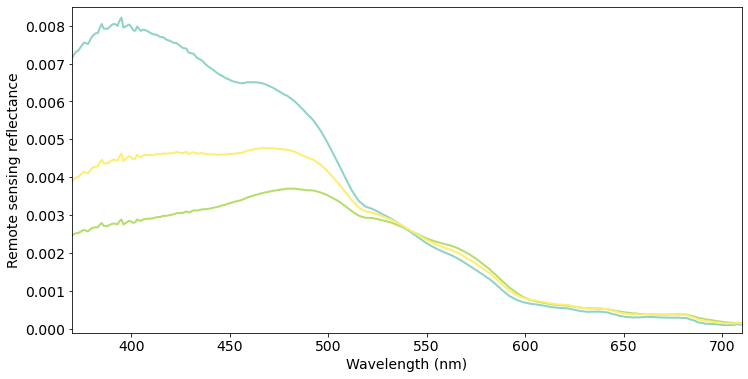

In [238]:
color_list = plt.cm.Set3(np.linspace(0, 1, 3))
color_list

fig, ax = plt.subplots(figsize=(12,6))
ax.set_xlim(370,710)
ax.set_ylim(-0.0001,0.0085)
# ax.axvline(120, c='k', ls='--')
# ax.axvline(535-125, c='k', ls='--')
# ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==0].iloc[:,:-7].values.T,c=color_list[1], alpha=.01)
# ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==1].iloc[:,:-7].values.T,c=color_list[0], alpha=.01)
# ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==2].iloc[:,:-7].values.T,c=color_list[2], alpha=.01)

ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==0].iloc[:,:-7].values.T.mean(axis=1),c=color_list[1], alpha=1, lw=2)
ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==1].iloc[:,:-7].values.T.mean(axis=1),c=color_list[0], alpha=1, lw=2)
ax.plot(trios_subset.columns[:-7].astype(int), trios_subset[kmeans.labels_==2].iloc[:,:-7].values.T.mean(axis=1),c=color_list[2], alpha=1, lw=2)

# trios_subset[kmeans.labels_==0].iloc[:,:-8].plot(label='Pelagic side of front', ax=ax, c=color_list[1], lw=3)
# trios_subset[kmeans.labels_==1].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[0], lw=3)
# trios_subset[kmeans.labels_==2].median(numeric_only=True).iloc[:-5].plot(label='Pelagic side of front', ax=ax, c=color_list[2], lw=3)

ax.set_xlabel('Wavelength (nm)')
ax.set_ylabel('Remote sensing reflectance')

fig.savefig('figs/aug2916_trios_clusters_spectra.png',dpi=300)

In [243]:
trios_subset['cluster'] = kmeans.labels_

/srv/conda/envs/notebook/lib/python3.8/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [245]:
trios_subset.to_csv('trios_clusters_spectra.csv')

In [242]:
trios_subset.shape

(344, 638)

In [46]:
lats = []
lons = []
sals = []
temps = []
for i in range(len(corrected_specs)):
    row = df.iloc[df.index.get_loc(pd.to_datetime(corrected_specs.iloc[i].TimeStamp) + timedelta(hours=4), method='nearest')]
    lats.append(row.lat)
    lons.append(row.lon)
    sals.append(row['TSG--sal'])
    temps.append(row['TSG--temp-SBE38'])

In [47]:
corrected_specs['lat'] = lats
corrected_specs['lon'] = lons
corrected_specs['sal'] = sals
corrected_specs['temp'] = temps

In [48]:
trios_gdf = gpd.GeoDataFrame(
    corrected_specs, geometry=gpd.points_from_xy(corrected_specs.lon, corrected_specs.lat))

<AxesSubplot:>

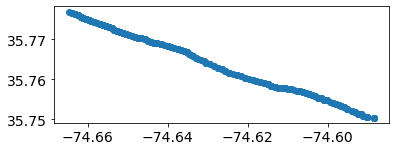

In [49]:
trios_gdf.plot()

In [50]:
trios_gdf.columns

Index(['320', '321', '322', '323', '324', '325', '326', '327', '328', '329',
       ...
       '948', '949', '950', 'chla_oci', 'TimeStamp', 'lat', 'lon', 'sal',
       'temp', 'geometry'],
      dtype='object', length=638)

In [51]:
chlci = trios_gdf.chla_oci.values

In [52]:
trios_gdf.iloc[:,1:-7]

,321,322,323,324,325,326,327,328,329,330,...,941,942,943,944,945,946,947,948,949,950
2021-08-29 16:15:10,0.005342,0.005383,0.005333,0.005271,0.005224,0.005256,0.005184,0.005047,0.005116,0.005195,...,-0.000420,-0.000468,-0.000381,-0.000260,-0.000141,-0.000235,-0.000450,-0.000701,-0.000786,-0.000749
2021-08-29 16:15:20,0.005442,0.005458,0.005385,0.005306,0.005246,0.005269,0.005190,0.005048,0.005126,0.005227,...,-0.000469,-0.000600,-0.000486,-0.000381,-0.000276,-0.000403,-0.000530,-0.000644,-0.000569,-0.000461
2021-08-29 16:15:30,0.005799,0.005783,0.005705,0.005626,0.005566,0.005592,0.005506,0.005350,0.005413,0.005506,...,-0.000533,-0.000585,-0.000709,-0.000770,-0.000830,-0.000726,-0.000702,-0.000719,-0.000709,-0.000649
2021-08-29 16:15:40,0.005119,0.005142,0.005082,0.005014,0.004962,0.004985,0.004908,0.004768,0.004834,0.004930,...,-0.000616,-0.000581,-0.000557,-0.000587,-0.000618,-0.000626,-0.000626,-0.000623,-0.000551,-0.000451
2021-08-29 16:15:50,0.005650,0.005663,0.005593,0.005512,0.005448,0.005473,0.005402,0.005266,0.005329,0.005418,...,-0.001112,-0.001083,-0.000967,-0.000850,-0.000734,-0.000690,-0.000659,-0.000629,-0.000651,-0.000712
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-29 17:50:50,0.002661,0.002665,0.002617,0.002556,0.002509,0.002511,0.002439,0.002323,0.002358,0.002402,...,-0.000287,-0.000253,-0.000283,-0.000298,-0.000314,-0.000306,-0.000312,-0.000325,-0.000320,-0.000317
2021-08-29 17:51:00,0.002705,0.002704,0.002660,0.002607,0.002566,0.002573,0.002503,0.002389,0.002424,0.002466,...,-0.000282,-0.000342,-0.000362,-0.000335,-0.000305,-0.000286,-0.000274,-0.000263,-0.000257,-0.000262
2021-08-29 17:51:30,0.002004,0.002005,0.001965,0.001910,0.001868,0.001874,0.001801,0.001684,0.001718,0.001763,...,-0.000152,-0.000184,-0.000176,-0.000126,-0.000076,-0.000028,-0.000013,-0.000011,-0.000038,-0.000071
2021-08-29 17:51:40,0.001947,0.001940,0.001903,0.001852,0.001812,0.001813,0.001745,0.001639,0.001675,0.001718,...,-0.000132,-0.000139,-0.000095,-0.000079,-0.000066,-0.000023,0.000010,0.000035,-0.000018,-0.000100


In [53]:
chlci[chlci>.5] = .5

(0.1, 0.4)

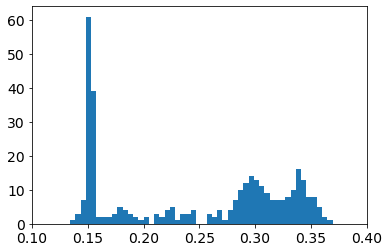

In [54]:
plt.hist(chlci, bins=50)
plt.xlim(0.1,.4)

Run some clustering

In [55]:
trios_gdf.columns[1:-7]

Index(['321', '322', '323', '324', '325', '326', '327', '328', '329', '330',
       ...
       '941', '942', '943', '944', '945', '946', '947', '948', '949', '950'],
      dtype='object', length=630)

In [56]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=5, random_state=0).fit(trios_gdf.values[:,1:-7])

In [57]:
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3, 4], dtype=int32), array([ 18,  95, 109,  38,  84]))

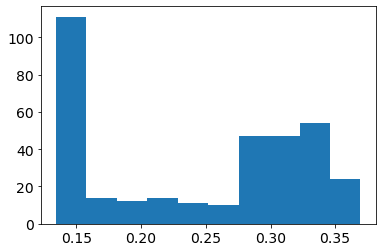

In [58]:
plt.hist(trios_gdf.chla_oci)
plt.show()

Text(0.5, 1.0, 'August 27th Trios Radiometer based Chla')

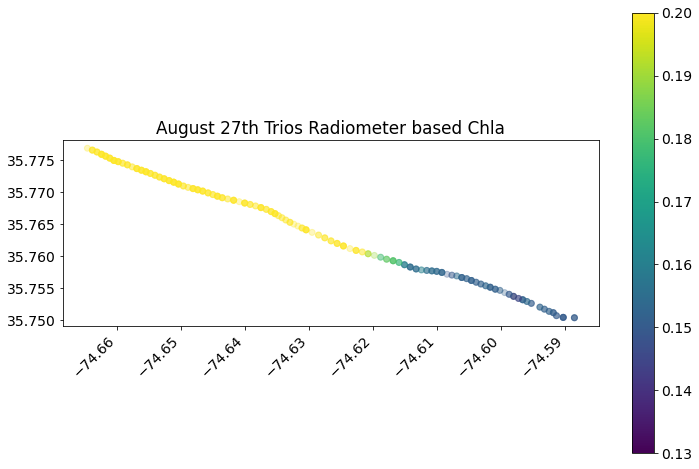

In [59]:
kmeans = KMeans(n_clusters=3, random_state=0).fit(trios_gdf.values[:,1:-7])
fig, ax = plt.subplots(figsize=(12,9))
sc = trios_gdf.plot('chla_oci', ax=ax, vmin=.13,vmax=.20, cmap='viridis', alpha=0.3, label='CI Chla', legend=True)
# ss = ax.scatter(trios_gdf.lon, trios_gdf.lat, c=trios_gdf.chl, s=100)
# fig.colorbar(sc,ax=ax)
# fig.colorbar(sc, ax=ax)
fig.autofmt_xdate(rotation=45)
ax.set_title('August 27th Trios Radiometer based Chla')
# fig.savefig('trios_radiometers_chlaci.png')

<AxesSubplot:>

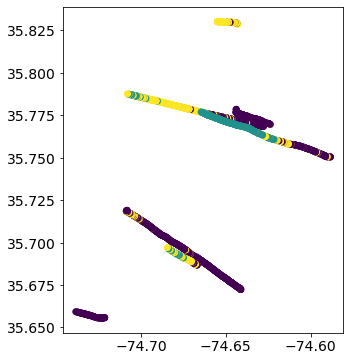

In [134]:
fig, ax = plt.subplots(figsize=(8,6))
trios_gdf.plot(c=kmeans.labels_,ax=ax)

In [135]:
trios_gdf_transect = trios_gdf#.loc['2021-08-27 16:15:00':'2021-08-27 17:30:00']

In [219]:
x = trios_gdf_transect.rolling(window=6).mean().values[:,1:-7]

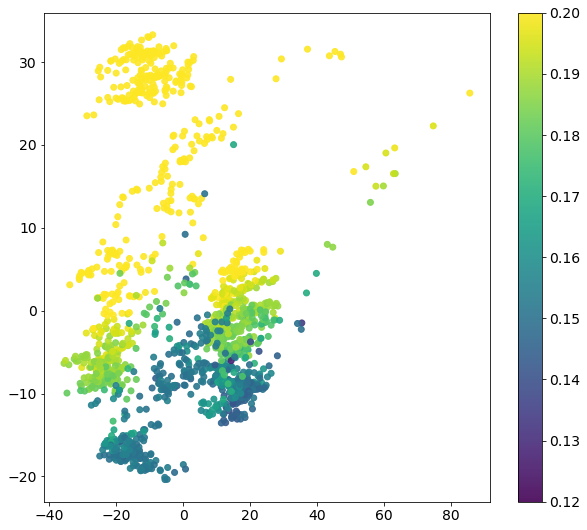

In [220]:
x = trios_gdf_transect.rolling(window=6).mean().values[:,1:-7]
x = x[12:,:]
from sklearn.preprocessing import StandardScaler
# Standardizing the features
x = StandardScaler().fit_transform(x)
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)

fig, ax = plt.subplots(figsize=(10,9))
sc = ax.scatter(principalComponents[:,0], principalComponents[:,1], alpha=0.9, c=trios_gdf_transect['chla_oci'].iloc[12:], vmin=.12,vmax=.20, cmap='viridis', label='chla')
fig.colorbar(sc)

In [221]:
from sklearn.preprocessing import StandardScaler
# Standardizing the features
x = StandardScaler().fit_transform(x)

In [222]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)

In [140]:
principalComponents.shape

(1544, 2)

<AxesSubplot:>

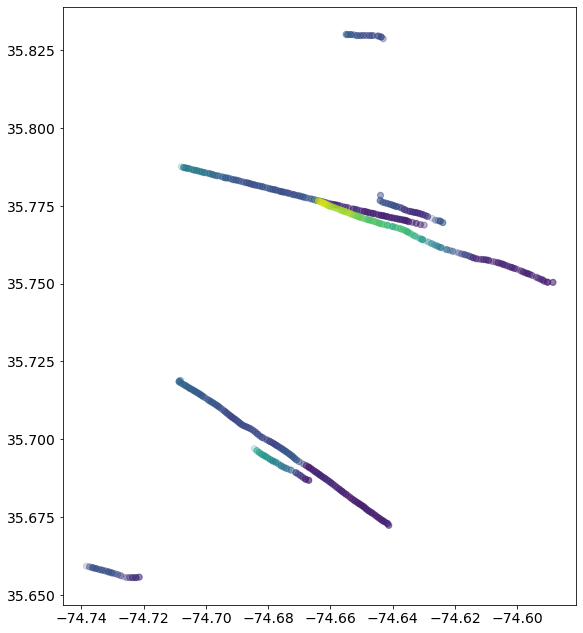

In [141]:
fig, ax = plt.subplots(figsize=(14,11))
trios_gdf_transect.iloc[12:].plot(c=trios_gdf_transect.iloc[12:].chla_oci,ax=ax, alpha=0.2, vmin=0.2, vmax=.24)
# fig.savefig('chla_transect.png')

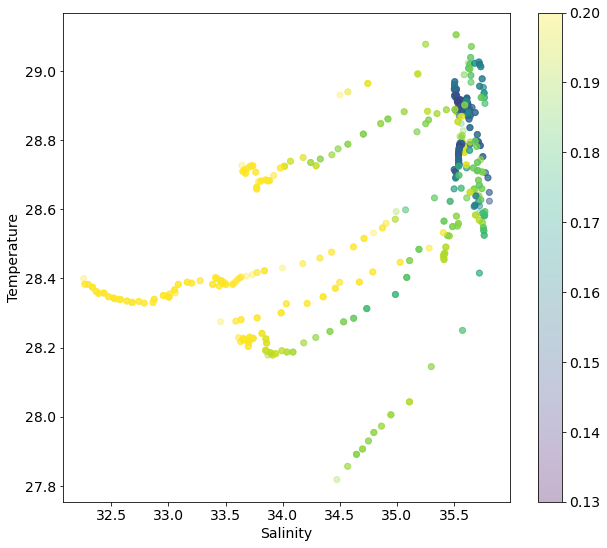

In [144]:
fig, ax = plt.subplots(figsize=(10,9))
sc = ax.scatter(trios_gdf_transect['sal'].iloc[12:], trios_gdf_transect['temp'].iloc[12:], alpha=0.3, c=trios_gdf_transect['chla_oci'].iloc[12:], vmin=.13,vmax=.20, cmap='viridis', label='chla')

ax.set_xlabel("Salinity")
ax.set_ylabel("Temperature")


fig.colorbar(sc)
# ax.set_ylim(-3,2)
# ax.set_xlim(-6,8)
# fig.savefig('pca_transect.png')

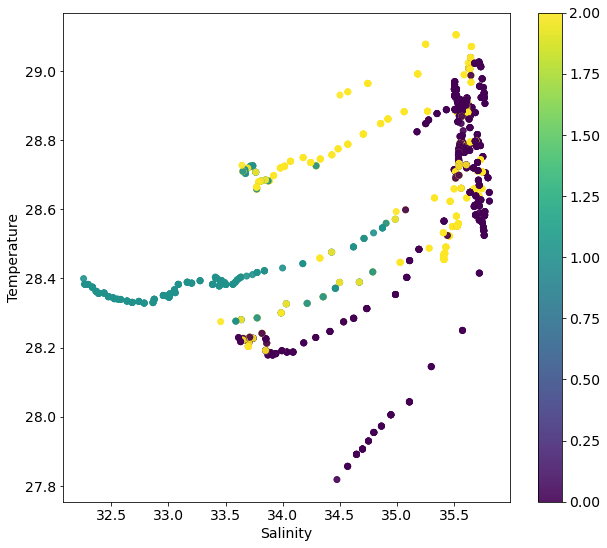

In [145]:
fig, ax = plt.subplots(figsize=(10,9))
sc = ax.scatter(trios_gdf_transect['sal'].iloc[12:], trios_gdf_transect['temp'].iloc[12:], alpha=0.9, c=kmeans.labels_[12:], cmap='viridis', label='chla')

ax.set_xlabel("Salinity")
ax.set_ylabel("Temperature")


fig.colorbar(sc)
# ax.set_ylim(-3,2)
# ax.set_xlim(-6,8)
# fig.savefig('pca_transect.png')

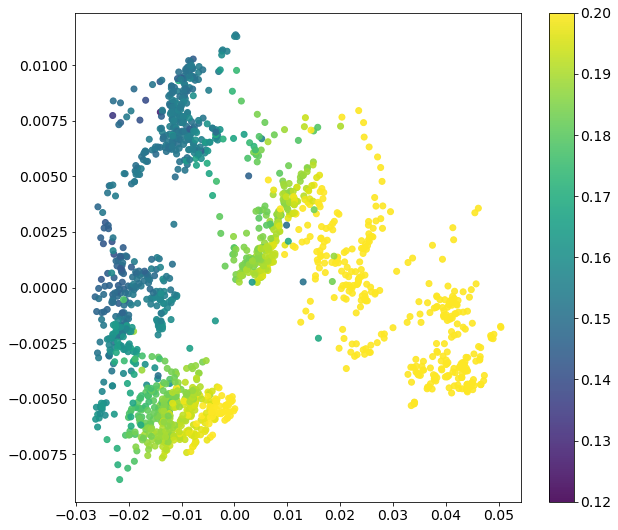

In [190]:
fig, ax = plt.subplots(figsize=(10,9))
sc = ax.scatter(principalComponents[:,0], principalComponents[:,1], alpha=0.9, c=trios_gdf_transect['chla_oci'].iloc[12:], vmin=.12,vmax=.20, cmap='viridis', label='chla')
fig.colorbar(sc)
# ax.set_ylim(-3,2)
# ax.set_xlim(-6,8)
# fig.savefig('pca_transect.png')

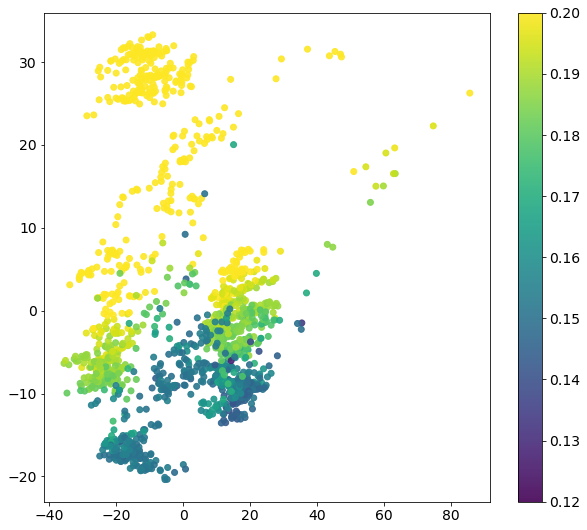

In [146]:
fig, ax = plt.subplots(figsize=(10,9))
sc = ax.scatter(principalComponents[:,0], principalComponents[:,1], alpha=0.9, c=trios_gdf_transect['chla_oci'].iloc[12:], vmin=.12,vmax=.20, cmap='viridis', label='chla')
fig.colorbar(sc)
# ax.set_ylim(-3,2)
# ax.set_xlim(-6,8)
# fig.savefig('pca_transect.png')

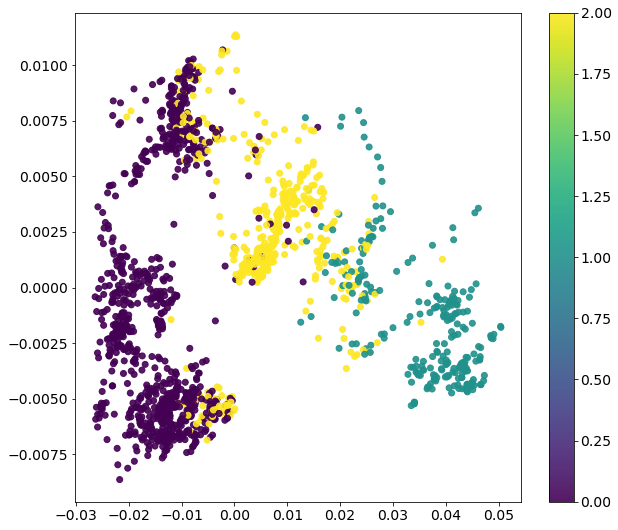

In [193]:
fig, ax = plt.subplots(figsize=(10,9))
sc = ax.scatter(principalComponents[:,0], principalComponents[:,1], alpha=0.9, c=kmeans.labels_[12:], cmap='viridis', label='chla')
fig.colorbar(sc)
# ax.set_ylim(-3,2)
# ax.set_xlim(-6,8)
# fig.savefig('pca_transect.png')

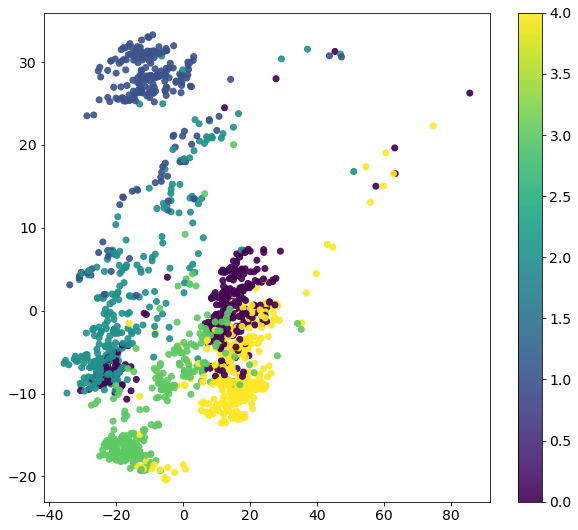

In [223]:
fig, ax = plt.subplots(figsize=(10,9))
sc = ax.scatter(principalComponents[:,0], principalComponents[:,1], alpha=0.9, c=kmeans.labels_[12:], cmap='viridis', label='chla')
fig.colorbar(sc)
# ax.set_ylim(-3,2)
# ax.set_xlim(-6,8)
# fig.savefig('pca_transect.png')

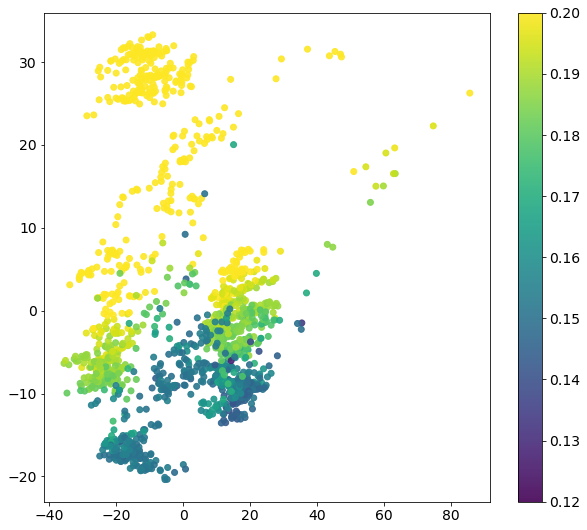

In [148]:
fig, ax = plt.subplots(figsize=(10,9))
sc = ax.scatter(principalComponents[:,0], principalComponents[:,1], alpha=0.9, c=trios_gdf_transect['chla_oci'].iloc[12:], vmin=.12,vmax=.20, cmap='viridis', label='chla')
fig.colorbar(sc)
# ax.set_ylim(-3,2)
# ax.set_xlim(-6,8)
# fig.savefig('pca_transect.png')

In [149]:
# from sklearn.cluster import KMeans
# kmeans = KMeans(n_clusters=5, random_state=0).fit(x)
# np.unique(kmeans.labels_, return_counts=True)

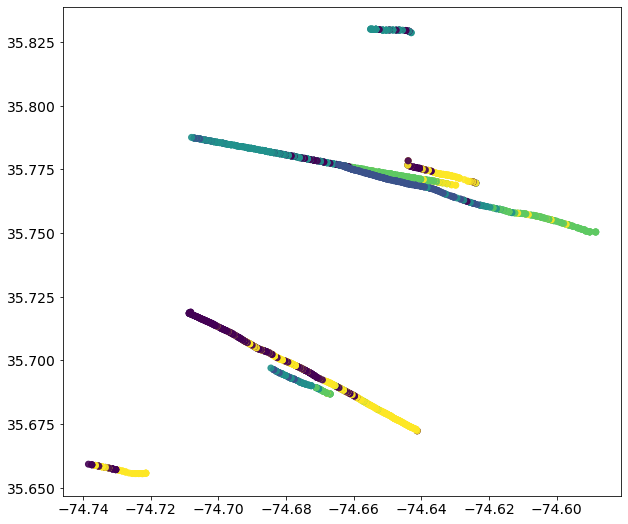

In [215]:
fig, ax = plt.subplots(figsize=(10,9))
sc = ax.scatter(trios_gdf_transect['lon'].iloc[12:], trios_gdf_transect['lat'].iloc[12:], alpha=0.9, c=kmeans.labels_[12:], cmap='viridis', label='chla')

ValueError: array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 2, 1, 1,
       1, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2,
       2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0,
       0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 0, 2,
       2, 0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0,
       2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 0, 0, 0,
       2, 2, 0, 0, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2,
       0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2,
       0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2], dtype=int32) is not a valid value for color

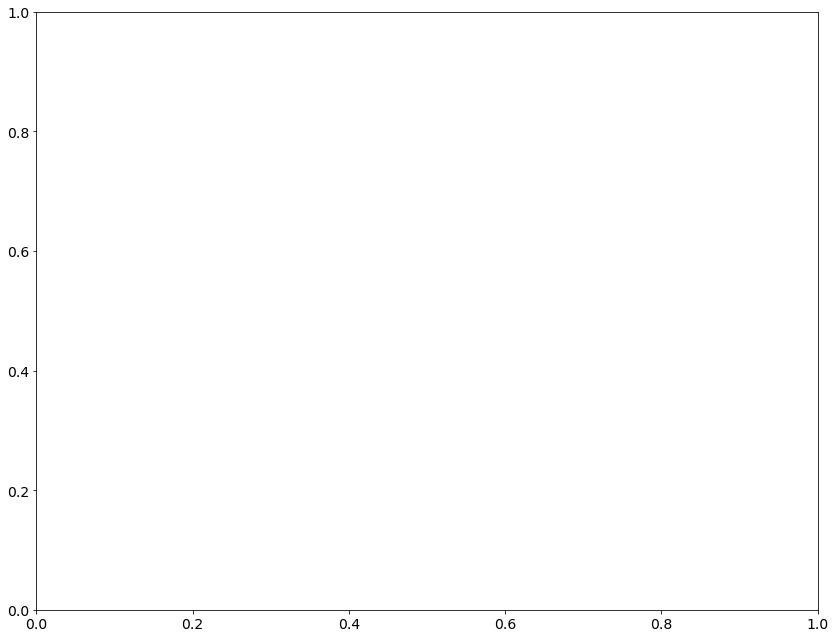

In [209]:
fig, ax = plt.subplots(figsize=(14,11))
ax.plot(trios_gdf_transect.iloc[12:].lon,trios_gdf_transect.iloc[12:].lon,c=kmeans.labels_,ax=ax, alpha=0.2, cmap='Set1')`a


In [151]:
len(x), len(kmeans.labels_[12:])

(1544, 1544)

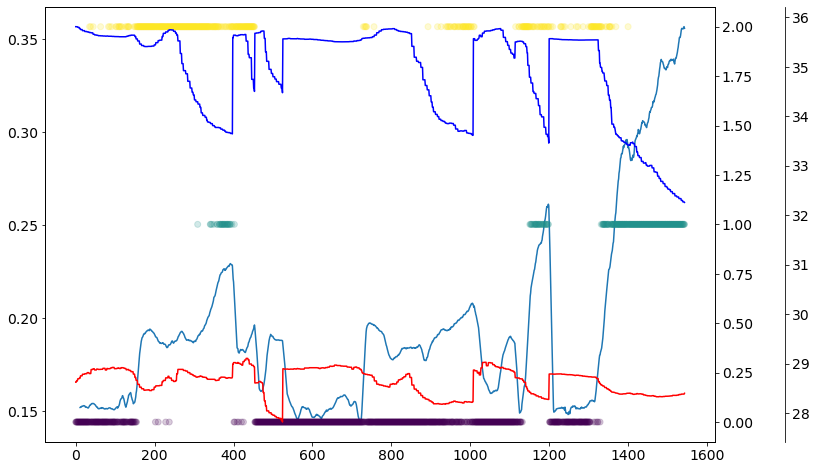

In [152]:
fig, ax  =plt.subplots(figsize=(12,8))
ax.plot(np.arange(0,len(x)),trios_gdf_transect.chla_oci.iloc[12:].rolling(window=12).mean())

ax2=ax.twinx()
ax2.scatter(np.arange(0,len(x)), kmeans.labels_[12:], alpha=0.2, c=kmeans.labels_[12:])

ax3 = ax.twinx()
ax3.plot(np.arange(0,len(x)),trios_gdf_transect['sal'].iloc[12:], color='blue')
ax3.plot(np.arange(0,len(x)),trios_gdf_transect['temp'].iloc[12:], color='red')
ax3.spines['right'].set_position(('outward', 70))

# fig.savefig('cluster_chla.png')

In [126]:
acs_device_file = """C399.6	A401.2	8	-1.383813	-1.066823		0.060252	0.051557	0.046522	0.044713	0.042715	0.040001	0.037303	0.03545	0.037248	0.032625	0.029873	0.032147	0.024443	0.027135	0.026485	0.018729	0.019909	0.014787	0.010355	0.008871	0.007876	0.005683	0.002318	0.002538	-0.000071	0	-0.000517	0.004021	0.001437	0.003682	0.003449	0.003614	0.004246	0.007185	0.015037	0.021388		0.269036	0.256804	0.239715	0.22147	0.203317	0.179577	0.158033	0.13612	0.119143	0.106312	0.098681	0.091583	0.081262	0.072483	0.070274	0.062959	0.056527	0.052112	0.043262	0.037851	0.027792	0.024797	0.020994	0.014378	0.010976	0	-0.00054	-0.003323	-0.003902	-0.003782	-0.010391	-0.014753	-0.017805	-0.021754	-0.031734	-0.030839		"; C and A offset, and C and A temperature correction info"
C403.2	A405.1	10	-1.055362	-0.715377		0.040446	0.037387	0.034597	0.030453	0.030017	0.031986	0.032867	0.030632	0.027846	0.026569	0.023514	0.023522	0.022554	0.020594	0.02007	0.016056	0.013668	0.015054	0.010358	0.008342	0.007171	0.00597	0.003334	0.002575	0.002691	0	-0.001309	0.003034	0.001606	0.003447	0.004092	0.007236	0.006167	0.011777	0.013282	0.018961		0.249905	0.239502	0.22367	0.206362	0.190552	0.167808	0.146584	0.125943	0.111151	0.098645	0.09101	0.083596	0.074522	0.067714	0.066221	0.057476	0.052098	0.047393	0.040615	0.035777	0.023931	0.020457	0.017008	0.011362	0.009981	0	-0.001389	-0.002747	-0.004318	-0.003782	-0.010352	-0.014665	-0.018384	-0.020722	-0.03179	-0.02496		"; C and A offset, and C and A temperature correction info"
C406.9	A408.4	11	-0.709445	-0.399667		0.015174	0.016838	0.017907	0.022477	0.023197	0.024926	0.024155	0.022103	0.019289	0.018116	0.018443	0.017446	0.013469	0.01617	0.014846	0.01412	0.012213	0.009665	0.008691	0.006729	0.002215	0.004255	0.002029	0.001681	-0.002094	0	-0.003811	0.001393	0.000139	0.000095	0.000579	0.000386	0.003485	0.00425	0.008425	0.008217		0.232193	0.222888	0.20935	0.19526	0.179832	0.157904	0.136596	0.117918	0.103622	0.092275	0.084807	0.077884	0.068112	0.062493	0.059795	0.05469	0.04789	0.043487	0.036974	0.033126	0.024019	0.0219	0.015107	0.010651	0.009624	0	-0.000416	-0.001758	-0.003867	-0.003681	-0.009578	-0.014524	-0.016843	-0.020541	-0.029061	-0.024795		"; C and A offset, and C and A temperature correction info"
C410.1	A411.9	12	-0.417007	-0.095672		0.001053	0.006131	0.01502	0.01873	0.017803	0.021619	0.025369	0.023228	0.022844	0.021352	0.01699	0.017676	0.016139	0.017023	0.015301	0.012118	0.012817	0.012649	0.008945	0.008051	0.007385	0.007335	0.006369	0.002206	0.000488	0	-0.001481	0.00073	-0.001605	0.001025	-0.000286	0.002339	0.00139	0.003176	0.005684	0.005547		0.215795	0.207907	0.195507	0.181597	0.166624	0.146029	0.126135	0.108131	0.093702	0.083635	0.076087	0.070176	0.062299	0.057035	0.05421	0.048634	0.042971	0.03825	0.034064	0.028939	0.021335	0.018599	0.015061	0.010544	0.007921	0	-0.001262	-0.002686	-0.004932	-0.004792	-0.009104	-0.013433	-0.016608	-0.020413	-0.027211	-0.033927		"; C and A offset, and C and A temperature correction info"
C414.1	A415.7	13	-0.131524	0.186856		-0.013749	-0.004901	0.004959	0.009604	0.015508	0.019541	0.022394	0.021486	0.021014	0.017695	0.016646	0.015821	0.015438	0.013427	0.013856	0.011563	0.010601	0.009212	0.008907	0.007179	0.008227	0.005633	0.003677	0.000941	0.002081	0	-0.001249	-0.000338	-0.00192	-0.001003	-0.001995	-0.001143	-0.003124	-0.000872	-0.001279	0.000254		0.200652	0.192846	0.180773	0.168361	0.154535	0.134873	0.114476	0.097444	0.084271	0.07441	0.067496	0.061103	0.054574	0.048327	0.04595	0.040878	0.036811	0.032772	0.028023	0.023389	0.016964	0.014803	0.011397	0.006949	0.0058	0	-0.000981	-0.002682	-0.004957	-0.005185	-0.009776	-0.013315	-0.015649	-0.019558	-0.025951	-0.028503		"; C and A offset, and C and A temperature correction info"
C417.8	A419.8	15	0.125898	0.45101		-0.024389	-0.014822	-0.00233	0.005343	0.007828	0.01372	0.015072	0.015623	0.015143	0.013023	0.012042	0.012038	0.01138	0.013317	0.012579	0.00922	0.010279	0.008549	0.007355	0.00779	0.004961	0.005645	0.003555	0.002604	0.000494	0	-0.004161	-0.003755	-0.003753	-0.003153	-0.004478	-0.003711	-0.005256	-0.005602	-0.006989	-0.006849		0.188458	0.18166	0.170678	0.158691	0.145512	0.126077	0.106271	0.089821	0.077313	0.067872	0.061419	0.0556	0.049003	0.044139	0.041932	0.037912	0.032744	0.030104	0.025861	0.022166	0.016251	0.014088	0.011462	0.007011	0.006018	0	0.000149	-0.00125	-0.003738	-0.003069	-0.007041	-0.010614	-0.012936	-0.015698	-0.021437	-0.02057		"; C and A offset, and C and A temperature correction info"
C421.9	A424.0	16	0.357364	0.702295		-0.027076	-0.015887	-0.002337	0.002425	0.004629	0.010971	0.013105	0.014027	0.015399	0.014355	0.011326	0.012387	0.010703	0.011407	0.010163	0.01008	0.009467	0.008685	0.006494	0.007958	0.006894	0.007114	0.004956	0.003603	0.002329	0	-0.001945	-0.0003	-0.003889	-0.003393	-0.003418	-0.00342	-0.0055	-0.006684	-0.007581	-0.002036		0.175852	0.169613	0.159169	0.147707	0.135244	0.1164	0.097528	0.081756	0.069623	0.060201	0.053796	0.048325	0.04279	0.037694	0.036529	0.032126	0.027604	0.025088	0.021349	0.018925	0.013153	0.011313	0.009004	0.005325	0.004386	0	-0.000708	-0.002149	-0.003853	-0.00392	-0.007057	-0.010196	-0.011785	-0.014628	-0.018509	-0.023355		"; C and A offset, and C and A temperature correction info"
C426.3	A428.5	17	0.564953	0.937346		-0.031821	-0.021183	-0.009541	-0.003827	0.000978	0.004547	0.007916	0.007923	0.007651	0.006493	0.006255	0.007296	0.007004	0.006684	0.00754	0.00797	0.006789	0.006448	0.00579	0.005366	0.006342	0.004239	0.004164	0.003356	0.001967	0	-0.001513	-0.002477	-0.002331	-0.001362	-0.002281	-0.003184	-0.00597	-0.007669	-0.011952	-0.014404		0.164016	0.15809	0.148109	0.137618	0.126021	0.107143	0.088517	0.073017	0.061406	0.052868	0.047625	0.042201	0.036902	0.032653	0.030911	0.027236	0.02375	0.021646	0.01821	0.01558	0.011049	0.009719	0.007237	0.004165	0.003962	0	-0.000746	-0.001638	-0.003036	-0.002843	-0.005901	-0.008502	-0.009581	-0.011886	-0.016055	-0.016981		"; C and A offset, and C and A temperature correction info"
C430.4	A432.4	18	0.76592	1.161043		-0.032838	-0.0235	-0.012882	-0.007974	-0.007196	-0.003605	-0.000555	0.001355	0.001843	0.001134	0.002124	0.001912	0.00283	0.004178	0.003545	0.003733	0.004272	0.0033	0.003685	0.004142	0.003922	0.004221	0.002689	0.002269	0.000363	0	-0.001246	-0.00139	-0.00266	-0.002281	-0.003737	-0.002442	-0.005657	-0.00692	-0.011305	-0.012964		0.152385	0.147314	0.13857	0.128795	0.116643	0.098833	0.080727	0.066142	0.055212	0.047601	0.041546	0.036858	0.032061	0.028932	0.026746	0.024016	0.020629	0.019179	0.016149	0.014606	0.010216	0.009224	0.007016	0.004968	0.003539	0	0.000701	-0.000102	-0.001971	-0.001556	-0.003518	-0.005808	-0.007484	-0.009202	-0.013285	-0.012587		"; C and A offset, and C and A temperature correction info"
C434.3	A436.3	20	0.938264	1.376242		-0.032122	-0.023741	-0.015459	-0.013532	-0.011763	-0.008484	-0.00717	-0.005559	-0.004191	-0.003079	-0.003427	-0.002392	-0.001487	-0.001657	-0.0009	-0.000961	-0.000058	0.000851	0.00032	0.0014	0.001586	0.00155	0.001511	0.000332	-0.000098	0	-0.001725	-0.00042	-0.001789	-0.001184	-0.000521	-0.001182	-0.002928	-0.005138	-0.010043	-0.014009		0.142358	0.137846	0.129405	0.119696	0.10867	0.091009	0.073696	0.059764	0.049591	0.041544	0.036527	0.032301	0.027714	0.024404	0.022811	0.020163	0.017446	0.015439	0.013464	0.0117	0.007703	0.007058	0.00561	0.003897	0.00344	0	0.000547	-0.000195	-0.001256	-0.001	-0.003142	-0.005008	-0.006246	-0.00718	-0.010544	-0.009726		"; C and A offset, and C and A temperature correction info"
C438.4	A440.0	21	1.110186	1.578256		-0.032544	-0.026645	-0.02141	-0.0186	-0.017248	-0.016185	-0.01516	-0.013181	-0.011734	-0.010562	-0.008906	-0.007321	-0.007413	-0.00505	-0.004527	-0.003155	-0.002511	-0.002516	-0.001768	-0.002784	-0.00064	0.000259	0.00046	0.000449	0.000852	0	0.000703	0.001505	0.000994	0.003267	0.001776	0.002598	0.001025	-0.000819	-0.004693	-0.008188		0.131864	0.12775	0.119722	0.110541	0.099676	0.082675	0.065982	0.052827	0.042866	0.035713	0.03117	0.027269	0.023507	0.019962	0.018751	0.015943	0.013863	0.01217	0.011069	0.009279	0.006093	0.005669	0.003823	0.002128	0.002185	0	-0.000073	-0.000431	-0.001618	-0.001676	-0.002628	-0.004341	-0.005472	-0.006331	-0.00932	-0.010208		"; C and A offset, and C and A temperature correction info"
C442.6	A444.8	22	1.25737	1.775079		-0.032476	-0.028519	-0.02544	-0.024958	-0.025599	-0.024804	-0.02369	-0.020779	-0.018892	-0.016852	-0.015305	-0.013567	-0.012684	-0.01092	-0.009176	-0.008533	-0.007547	-0.007103	-0.006636	-0.005278	-0.004478	-0.00391	-0.002735	-0.001887	-0.001885	0	-0.000689	0.001397	0.001131	0.001778	0.003373	0.004456	0.002724	0.002311	-0.000957	-0.001021		0.124037	0.119791	0.111749	0.102566	0.091735	0.075831	0.05986	0.047563	0.038267	0.031719	0.027166	0.023572	0.020058	0.017441	0.01607	0.013814	0.011836	0.010612	0.009459	0.007699	0.005215	0.004501	0.003615	0.002544	0.00191	0	0.000434	-0.000283	-0.000874	-0.000953	-0.002044	-0.003439	-0.004232	-0.004341	-0.007446	-0.007322		"; C and A offset, and C and A temperature correction info"
C447.0	A449.2	23	1.399575	1.962298		-0.032008	-0.030128	-0.029782	-0.030712	-0.030526	-0.030641	-0.02986	-0.026791	-0.024466	-0.022701	-0.020244	-0.018941	-0.017541	-0.015611	-0.013672	-0.012534	-0.01129	-0.010122	-0.009264	-0.008282	-0.007591	-0.005863	-0.004241	-0.003414	-0.001781	0	0.001321	0.003099	0.004056	0.006244	0.006763	0.008184	0.008196	0.00799	0.005961	0.00482		0.116237	0.112338	0.104417	0.096085	0.085856	0.070471	0.055002	0.043214	0.034328	0.028207	0.023978	0.020798	0.017306	0.015024	0.013543	0.01189	0.010048	0.008727	0.007953	0.006709	0.004505	0.003771	0.003282	0.002014	0.002348	0	0.000683	0.000295	-0.00066	-0.000435	-0.000848	-0.002108	-0.002452	-0.003329	-0.005396	-0.005831		"; C and A offset, and C and A temperature correction info"
C451.8	A453.9	LtBlue	1.535057	2.143054		-0.0314	-0.031885	-0.034249	-0.035404	-0.036042	-0.037602	-0.037251	-0.033886	-0.031444	-0.02864	-0.02541	-0.022918	-0.021343	-0.018935	-0.01731	-0.01544	-0.014526	-0.013154	-0.0122	-0.011415	-0.010137	-0.007838	-0.005942	-0.003927	-0.00253	0	0.001564	0.004939	0.005618	0.008181	0.009434	0.011662	0.012527	0.013387	0.012233	0.010892		0.108553	0.104734	0.097403	0.089701	0.079939	0.06482	0.04987	0.038697	0.030623	0.025048	0.021116	0.018105	0.014982	0.012811	0.011812	0.010169	0.008522	0.007493	0.006614	0.005279	0.003549	0.003223	0.002168	0.001352	0.001949	0	0.000921	0.000305	-0.000043	-0.00004	-0.000701	-0.001747	-0.001839	-0.001991	-0.004054	-0.003152		"; C and A offset, and C and A temperature correction info"
C456.4	A458.2	26	1.654428	2.31342		-0.029229	-0.031706	-0.035141	-0.038637	-0.039939	-0.041086	-0.04103	-0.037395	-0.034837	-0.031217	-0.028904	-0.02699	-0.024936	-0.022606	-0.020418	-0.019049	-0.017269	-0.015613	-0.014343	-0.013237	-0.011461	-0.009728	-0.008227	-0.005014	-0.002866	0	0.002337	0.005878	0.007512	0.00983	0.011993	0.014975	0.01644	0.01891	0.019859	0.020367		0.100828	0.097409	0.090706	0.083011	0.073608	0.059556	0.045236	0.034867	0.027108	0.021953	0.018245	0.015504	0.012549	0.010494	0.009376	0.008198	0.006581	0.005812	0.005266	0.004298	0.002644	0.001913	0.001423	0.001001	0.001285	0	0.000147	0.00015	-0.000098	0.000077	-0.000023	-0.001148	-0.001376	-0.001541	-0.003054	-0.003999		"; C and A offset, and C and A temperature correction info"
C460.4	A462.4	27	1.75579	2.47824		-0.027367	-0.031495	-0.037941	-0.04025	-0.041564	-0.043718	-0.044269	-0.040959	-0.038169	-0.034788	-0.031753	-0.029397	-0.027497	-0.025047	-0.022416	-0.020678	-0.019321	-0.017111	-0.015975	-0.014639	-0.013304	-0.010548	-0.008693	-0.00578	-0.003347	0	0.003811	0.007587	0.00984	0.012325	0.014272	0.017794	0.020507	0.023816	0.025817	0.027996		0.094766	0.091688	0.08501	0.07804	0.069322	0.055451	0.042143	0.031789	0.024316	0.019569	0.016297	0.013535	0.01093	0.009218	0.008378	0.007229	0.005491	0.005122	0.004809	0.003618	0.00248	0.002071	0.001703	0.001043	0.001598	0	0.000684	0.000585	0.000623	0.000668	0.000404	-0.000215	-0.00019	-0.000076	-0.001618	-0.001869		"; C and A offset, and C and A temperature correction info"
C464.7	A466.6	28	1.860282	2.635667		-0.026696	-0.032512	-0.039427	-0.042526	-0.045092	-0.047049	-0.046799	-0.043515	-0.040179	-0.037316	-0.03368	-0.030749	-0.029626	-0.026515	-0.024288	-0.022599	-0.021009	-0.019184	-0.018318	-0.017206	-0.015377	-0.01291	-0.00944	-0.006894	-0.004099	0	0.003237	0.007498	0.010071	0.012974	0.015859	0.019789	0.022643	0.026758	0.030499	0.031614		0.088062	0.085161	0.07917	0.072497	0.0638	0.050746	0.037669	0.028286	0.021334	0.016859	0.013854	0.011437	0.008867	0.00738	0.006627	0.005706	0.004258	0.003924	0.003436	0.002721	0.001503	0.001523	0.001164	0.000793	0.001064	0	0.000587	0.000626	0.000593	0.001145	0.00099	0.000478	0.000467	0.000627	-0.000442	-0.001196		"; C and A offset, and C and A temperature correction info"
C469.2	A471.3	30	1.959591	2.784946		-0.025909	-0.032154	-0.039684	-0.043732	-0.044829	-0.046137	-0.046174	-0.042681	-0.040562	-0.036874	-0.034049	-0.032127	-0.029393	-0.027809	-0.024907	-0.023625	-0.02183	-0.019567	-0.017843	-0.016741	-0.014805	-0.01273	-0.010161	-0.006709	-0.003841	0	0.004056	0.008239	0.010928	0.013918	0.017362	0.021567	0.025648	0.030662	0.035045	0.037341		0.08241	0.079667	0.073652	0.067255	0.058951	0.046393	0.033927	0.025061	0.018441	0.01415	0.011294	0.009088	0.006769	0.005651	0.004771	0.004086	0.003014	0.002727	0.002386	0.001788	0.000599	0.000901	0.000464	0.000285	0.000749	0	0.000497	0.000487	0.000651	0.001159	0.000855	0.000812	0.000771	0.001138	0.000028	0.000469		"; C and A offset, and C and A temperature correction info"
C474.3	A475.9	31	2.0491	2.930072		-0.025402	-0.032537	-0.040473	-0.042941	-0.044201	-0.045856	-0.04563	-0.042805	-0.040415	-0.037324	-0.034633	-0.031669	-0.030167	-0.02771	-0.024816	-0.02278	-0.021793	-0.01969	-0.019008	-0.017325	-0.015918	-0.013136	-0.010699	-0.008086	-0.00416	0	0.004046	0.0079	0.010774	0.013963	0.017107	0.021469	0.025878	0.031235	0.03678	0.042202		0.077809	0.074996	0.069014	0.062866	0.054964	0.042617	0.030714	0.02197	0.015908	0.011972	0.00938	0.00764	0.005368	0.004459	0.003626	0.002999	0.002023	0.001902	0.001512	0.001044	0.000224	0.000411	0.000222	0.000056	0.000348	0	0.000517	0.000761	0.000689	0.001453	0.001438	0.001074	0.001533	0.001549	0.001019	0.000009		"; C and A offset, and C and A temperature correction info"
C478.7	A481.0	32	2.13146	3.070095		-0.025981	-0.032772	-0.039429	-0.042143	-0.043722	-0.044279	-0.042918	-0.040213	-0.037448	-0.03471	-0.031675	-0.030154	-0.028192	-0.025689	-0.023654	-0.02226	-0.020144	-0.01919	-0.017225	-0.016543	-0.014511	-0.012877	-0.009535	-0.006557	-0.003897	0	0.003692	0.008133	0.011169	0.014294	0.017317	0.022194	0.026377	0.032289	0.038459	0.040117		0.072941	0.070118	0.064417	0.058317	0.050709	0.038986	0.027583	0.019599	0.013706	0.010089	0.007776	0.005907	0.004116	0.003185	0.002834	0.002059	0.001301	0.001329	0.001005	0.00068	-0.000209	0.0002	0.000022	0.000085	0.00055	0	0.000464	0.000738	0.001004	0.001623	0.001917	0.001762	0.002052	0.002304	0.001728	0.001429		"; C and A offset, and C and A temperature correction info"
C483.8	A485.3	34	2.219625	3.204797		-0.026791	-0.032699	-0.038388	-0.040446	-0.040123	-0.039716	-0.039392	-0.036347	-0.034486	-0.032423	-0.030123	-0.028172	-0.026495	-0.024307	-0.022138	-0.020366	-0.019205	-0.017572	-0.016163	-0.014867	-0.013394	-0.010962	-0.008971	-0.006475	-0.003331	0	0.003576	0.007984	0.010665	0.013703	0.017062	0.021303	0.02627	0.031588	0.037944	0.043288		0.067656	0.064958	0.059221	0.053679	0.046341	0.035088	0.02427	0.016587	0.011112	0.007906	0.005443	0.004073	0.002445	0.001539	0.001383	0.000788	0.000033	0.000172	0.000138	-0.00022	-0.00077	-0.000545	-0.000381	-0.000274	0.000201	0	0.000461	0.000672	0.000923	0.001723	0.001893	0.001903	0.00214	0.00253	0.002042	0.002592		"; C and A offset, and C and A temperature correction info"
C488.0	A489.9	35	2.291979	3.336087		-0.028773	-0.034012	-0.037982	-0.038293	-0.038297	-0.037624	-0.036245	-0.033771	-0.031879	-0.029716	-0.027592	-0.02577	-0.024036	-0.022177	-0.020012	-0.018568	-0.017596	-0.015746	-0.015046	-0.013944	-0.01266	-0.010573	-0.008246	-0.006021	-0.003159	0	0.003314	0.006982	0.009548	0.012306	0.015167	0.019379	0.023305	0.029147	0.035822	0.038511		0.065008	0.062152	0.056531	0.051144	0.044001	0.0329	0.022446	0.015046	0.009972	0.006807	0.004865	0.003459	0.001937	0.001148	0.001015	0.00052	-0.000048	0.000056	-0.000276	-0.000137	-0.000808	-0.000627	-0.000516	-0.000232	0.000228	0	0.000736	0.000952	0.001335	0.002001	0.002212	0.002381	0.00293	0.003407	0.003065	0.00389		"; C and A offset, and C and A temperature correction info"
C492.5	A494.4	36	2.371804	3.460286		-0.030151	-0.033732	-0.035414	-0.035644	-0.034923	-0.032636	-0.03042	-0.02812	-0.02663	-0.025081	-0.023372	-0.022285	-0.020729	-0.01871	-0.017284	-0.016064	-0.014859	-0.013641	-0.012776	-0.011367	-0.010107	-0.008272	-0.006252	-0.003882	-0.002202	0	0.002649	0.006385	0.008954	0.011633	0.014242	0.018246	0.021956	0.027223	0.033213	0.036074		0.061279	0.058568	0.05319	0.047888	0.040905	0.030435	0.020351	0.013356	0.008529	0.00557	0.003644	0.002437	0.001121	0.000363	0.000169	-0.000181	-0.000566	-0.000601	-0.00061	-0.000665	-0.001243	-0.000794	-0.000514	-0.000271	0.000244	0	0.000559	0.001156	0.001277	0.002302	0.00265	0.002784	0.00333	0.003736	0.003521	0.003565		"; C and A offset, and C and A temperature correction info"
C496.7	A498.4	37	2.446298	3.576218		-0.033137	-0.035096	-0.035113	-0.033414	-0.03132	-0.028622	-0.026505	-0.024963	-0.023621	-0.022372	-0.021292	-0.019851	-0.018546	-0.016923	-0.015594	-0.014226	-0.01349	-0.012014	-0.011069	-0.01008	-0.008625	-0.00729	-0.005948	-0.004357	-0.002334	0	0.001974	0.005455	0.007212	0.0092	0.01171	0.015013	0.018639	0.023264	0.028765	0.033952		0.05734	0.054812	0.049581	0.044637	0.038124	0.028076	0.018274	0.011615	0.007015	0.004359	0.002478	0.001414	0.000369	-0.000137	-0.000386	-0.000587	-0.001067	-0.001036	-0.000923	-0.001027	-0.001252	-0.000877	-0.000717	-0.000412	0.000259	0	0.000704	0.001194	0.00156	0.002371	0.002883	0.003132	0.00367	0.004041	0.004025	0.004521		"; C and A offset, and C and A temperature correction info"
C501.0	A502.8	39	2.506622	3.686126		-0.035949	-0.036452	-0.033978	-0.031375	-0.029587	-0.02602	-0.023	-0.021185	-0.019712	-0.019228	-0.018002	-0.016707	-0.015714	-0.014121	-0.012887	-0.0119	-0.01116	-0.010191	-0.009213	-0.008197	-0.007171	-0.005764	-0.004259	-0.003215	-0.001751	0	0.001705	0.00393	0.005496	0.008024	0.009834	0.012799	0.015392	0.019351	0.023839	0.027224		0.053568	0.051212	0.046495	0.041807	0.035381	0.025717	0.016376	0.010082	0.005746	0.003204	0.001591	0.000636	-0.000566	-0.000825	-0.000965	-0.001246	-0.001695	-0.00142	-0.001264	-0.001371	-0.001642	-0.001185	-0.000919	-0.000603	0.000132	0	0.000861	0.001224	0.001473	0.002283	0.00273	0.003192	0.003737	0.004278	0.004226	0.005133		"; C and A offset, and C and A temperature correction info"
C505.7	A507.4	40	2.564408	3.789976		-0.036775	-0.035569	-0.031394	-0.028443	-0.025621	-0.020996	-0.017917	-0.016405	-0.015711	-0.015271	-0.014793	-0.013785	-0.012511	-0.011462	-0.010281	-0.009582	-0.008624	-0.007681	-0.006861	-0.005919	-0.004833	-0.003872	-0.002706	-0.001552	-0.001062	0	0.001115	0.00323	0.004673	0.006577	0.00819	0.010781	0.013203	0.015981	0.019765	0.022195		0.050139	0.048066	0.043651	0.039143	0.033059	0.023756	0.014821	0.008852	0.004709	0.002317	0.000796	-0.000012	-0.001007	-0.001337	-0.001442	-0.0015	-0.001836	-0.001798	-0.001602	-0.001568	-0.001928	-0.001373	-0.001096	-0.000756	-0.000195	0	0.000515	0.000915	0.001466	0.002337	0.002928	0.003333	0.003793	0.004453	0.004412	0.005608		"; C and A offset, and C and A temperature correction info"
C510.4	A512.0	41	2.622192	3.889237		-0.039825	-0.037161	-0.031396	-0.026756	-0.023433	-0.018957	-0.015833	-0.014597	-0.013487	-0.013475	-0.012776	-0.011946	-0.011026	-0.009979	-0.009042	-0.008044	-0.007343	-0.006269	-0.005785	-0.004659	-0.003613	-0.002913	-0.002341	-0.001691	-0.000851	0	0.00077	0.002151	0.002738	0.004176	0.005711	0.007633	0.009025	0.011346	0.014102	0.016677		0.046159	0.044341	0.040305	0.036165	0.030548	0.021612	0.013175	0.007399	0.003541	0.001528	-0.000091	-0.000768	-0.001642	-0.001831	-0.001674	-0.001897	-0.002104	-0.00199	-0.00168	-0.001685	-0.001905	-0.001519	-0.000963	-0.000867	-0.000119	0	0.000793	0.001138	0.001713	0.002672	0.003023	0.003519	0.004158	0.004598	0.004736	0.005056		"; C and A offset, and C and A temperature correction info"
C515.1	A517.0	42	2.666617	3.988719		-0.041376	-0.037469	-0.029763	-0.025207	-0.021998	-0.016739	-0.013121	-0.011668	-0.010783	-0.010876	-0.010823	-0.009962	-0.008821	-0.008046	-0.007268	-0.006449	-0.005644	-0.005004	-0.004291	-0.003143	-0.002224	-0.001396	-0.000846	-0.000303	-0.000305	0	0.000372	0.001181	0.001859	0.003648	0.004354	0.005965	0.006829	0.00843	0.009998	0.011041		0.043107	0.041246	0.037481	0.033425	0.027847	0.019242	0.011297	0.005871	0.002459	0.000476	-0.000798	-0.001414	-0.002195	-0.002262	-0.002116	-0.002274	-0.002368	-0.002263	-0.002037	-0.001837	-0.00198	-0.001528	-0.001279	-0.000858	-0.000049	0	0.00068	0.001322	0.001674	0.002623	0.003108	0.003652	0.004334	0.004834	0.005043	0.005281		"; C and A offset, and C and A temperature correction info"
C519.9	A521.3	44	2.71415	4.085283		-0.04241	-0.037296	-0.028843	-0.023713	-0.019711	-0.014151	-0.010772	-0.009732	-0.009167	-0.009286	-0.009149	-0.008851	-0.007787	-0.006896	-0.006208	-0.005474	-0.004454	-0.003803	-0.002915	-0.002085	-0.001071	-0.000598	-0.000211	0.000363	0.000235	0	-0.000141	0.000535	0.00081	0.001973	0.002751	0.003825	0.004188	0.0048	0.0054	0.005837		0.040682	0.038815	0.035008	0.031227	0.025854	0.017817	0.010019	0.00498	0.001668	-0.000214	-0.001333	-0.00188	-0.002421	-0.002591	-0.002412	-0.002389	-0.00258	-0.002249	-0.002113	-0.001922	-0.002292	-0.00146	-0.001292	-0.000964	-0.000205	0	0.000724	0.001017	0.001596	0.002661	0.003225	0.003711	0.004435	0.004931	0.005156	0.005298		"; C and A offset, and C and A temperature correction info"
C524.2	A525.8	45	2.756441	4.17758		-0.043239	-0.037413	-0.028015	-0.022299	-0.0185	-0.013387	-0.010026	-0.00908	-0.008252	-0.008697	-0.008609	-0.007595	-0.006717	-0.006205	-0.005621	-0.004536	-0.004062	-0.003272	-0.002456	-0.001188	-0.000494	0.000163	0.000343	0.000285	0.000376	0	-0.000243	-0.000075	0.000018	0.00091	0.001502	0.002142	0.001919	0.001939	0.001621	0.002418		0.037298	0.035495	0.031913	0.028392	0.023373	0.015462	0.008319	0.00363	0.00054	-0.001095	-0.00198	-0.002305	-0.002936	-0.0028	-0.002618	-0.002574	-0.002692	-0.002554	-0.002254	-0.002062	-0.00221	-0.001618	-0.001285	-0.000905	-0.000155	0	0.000677	0.001242	0.001762	0.002785	0.00325	0.00388	0.004539	0.004949	0.005291	0.005426		"; C and A offset, and C and A temperature correction info"
C528.5	A529.8	46	2.795598	4.268547		-0.04369	-0.037023	-0.027076	-0.021916	-0.018576	-0.012755	-0.009086	-0.008114	-0.007473	-0.007725	-0.007711	-0.007087	-0.006247	-0.005743	-0.005094	-0.004443	-0.003441	-0.002879	-0.001937	-0.000929	-0.000002	0.000507	0.001149	0.001024	0.000691	0	-0.000524	-0.000639	-0.000718	0.000472	0.000535	0.000963	0.000292	-0.000227	-0.001476	-0.002624		0.033381	0.031586	0.028295	0.024957	0.020162	0.012861	0.006105	0.00177	-0.000863	-0.00215	-0.003023	-0.003208	-0.003643	-0.003477	-0.003208	-0.003022	-0.003116	-0.002678	-0.002483	-0.002186	-0.002356	-0.001733	-0.001511	-0.000852	-0.000323	0	0.000811	0.001272	0.001736	0.002829	0.003248	0.004011	0.00454	0.005158	0.00534	0.005893		"; C and A offset, and C and A temperature correction info"
C532.7	A534.2	47	2.832073	4.356407		-0.044786	-0.037451	-0.027417	-0.021801	-0.017895	-0.012707	-0.009764	-0.008782	-0.008202	-0.008309	-0.008314	-0.007789	-0.006829	-0.006152	-0.005514	-0.004544	-0.003745	-0.002934	-0.002133	-0.000867	0.000058	0.000458	0.000667	0.000679	0.000551	0	-0.000966	-0.001	-0.001151	-0.000484	-0.000334	-0.0002	-0.00097	-0.002031	-0.004053	-0.004349		0.029465	0.027683	0.024445	0.021431	0.017031	0.010177	0.003843	-0.000032	-0.002423	-0.0035	-0.004142	-0.004109	-0.004451	-0.004152	-0.003924	-0.003641	-0.003613	-0.003139	-0.002897	-0.002562	-0.002565	-0.001955	-0.001589	-0.001171	-0.000305	0	0.000604	0.000959	0.001776	0.002748	0.003265	0.003858	0.004477	0.005102	0.005367	0.006098		"; C and A offset, and C and A temperature correction info"
C536.8	A538.2	49	2.870777	4.440335		-0.044272	-0.036896	-0.026569	-0.021219	-0.017916	-0.013402	-0.010291	-0.009318	-0.008337	-0.008563	-0.008332	-0.007609	-0.006644	-0.006021	-0.005521	-0.004443	-0.003659	-0.002987	-0.001955	-0.000853	0.00008	0.000868	0.000968	0.000928	0.000714	0	-0.000808	-0.000948	-0.001304	-0.000678	-0.00056	-0.000639	-0.001726	-0.003134	-0.005382	-0.006427		0.025633	0.023831	0.020915	0.018072	0.013918	0.007518	0.001834	-0.001651	-0.003613	-0.004597	-0.004953	-0.004751	-0.004995	-0.004592	-0.004227	-0.003981	-0.003733	-0.003303	-0.002876	-0.002617	-0.002617	-0.00194	-0.001448	-0.001083	-0.000258	0	0.000619	0.001182	0.001752	0.002735	0.003337	0.003884	0.00468	0.005124	0.005405	0.005869		"; C and A offset, and C and A temperature correction info"
C541.1	A542.8	LtCyan	2.904051	4.521371		-0.043208	-0.035687	-0.02621	-0.021628	-0.018456	-0.013714	-0.010907	-0.00991	-0.009388	-0.009294	-0.009055	-0.008428	-0.0075	-0.006825	-0.006118	-0.005263	-0.004237	-0.003347	-0.002456	-0.001321	-0.000259	0.000448	0.000983	0.001033	0.000667	0	-0.000758	-0.001032	-0.001299	-0.000552	-0.000575	-0.000547	-0.001732	-0.003396	-0.006328	-0.008053		0.021909	0.020164	0.017524	0.014851	0.011069	0.005284	0.000056	-0.003047	-0.00466	-0.005412	-0.005596	-0.005323	-0.005318	-0.005001	-0.00445	-0.004143	-0.003939	-0.003339	-0.003076	-0.002601	-0.002633	-0.001839	-0.001457	-0.000922	-0.000265	0	0.000851	0.0013	0.001862	0.002756	0.003468	0.004142	0.004827	0.00526	0.005537	0.005692		"; C and A offset, and C and A temperature correction info"
C545.6	A546.8	51	2.94027	4.595425		-0.042133	-0.034921	-0.026098	-0.021442	-0.018384	-0.014888	-0.012814	-0.011604	-0.010794	-0.010638	-0.010331	-0.009419	-0.008584	-0.007598	-0.006948	-0.005904	-0.00494	-0.004216	-0.00298	-0.001787	-0.000776	-0.000143	0.00003	0.000381	0.000401	0	-0.000847	-0.001035	-0.001416	-0.000837	-0.000747	-0.000923	-0.002088	-0.003823	-0.00682	-0.007871		0.017949	0.016233	0.013839	0.011562	0.008083	0.002774	-0.001976	-0.004582	-0.006053	-0.00647	-0.006572	-0.006079	-0.006029	-0.005462	-0.004856	-0.00455	-0.004256	-0.003852	-0.00323	-0.002815	-0.002682	-0.002152	-0.00177	-0.001106	-0.000462	0	0.000665	0.000992	0.001668	0.002586	0.0032	0.00376	0.004415	0.004931	0.005312	0.005362		"; C and A offset, and C and A temperature correction info"
C549.9	A551.2	52	2.976811	4.666566		-0.039442	-0.032749	-0.024628	-0.020903	-0.018708	-0.015557	-0.013337	-0.01235	-0.011313	-0.01105	-0.010629	-0.009813	-0.00887	-0.008134	-0.007347	-0.006209	-0.005424	-0.00433	-0.003396	-0.002122	-0.001112	-0.00019	0.00036	0.000538	0.000461	0	-0.000574	-0.000603	-0.000883	-0.00018	-0.000212	-0.000193	-0.001447	-0.003171	-0.006223	-0.007896		0.014404	0.012743	0.010701	0.00862	0.005428	0.000525	-0.003635	-0.005861	-0.006938	-0.007261	-0.007074	-0.00654	-0.006397	-0.005821	-0.005072	-0.004788	-0.004399	-0.003794	-0.003202	-0.002885	-0.002848	-0.001987	-0.001594	-0.001029	-0.000412	0	0.000662	0.001049	0.001664	0.002617	0.00321	0.003823	0.004447	0.004927	0.005239	0.005489		"; C and A offset, and C and A temperature correction info"
C554.1	A555.3	54	3.001121	4.734801		-0.036828	-0.030542	-0.02391	-0.020904	-0.018726	-0.016043	-0.014528	-0.013473	-0.012749	-0.012228	-0.011715	-0.010924	-0.009834	-0.009035	-0.008063	-0.007062	-0.006075	-0.005099	-0.004004	-0.002837	-0.001667	-0.000888	-0.000131	0.000211	0.000123	0	-0.000361	-0.00049	-0.000626	0.000202	0.000322	0.000273	-0.000735	-0.002355	-0.005362	-0.007581		0.011348	0.009746	0.007841	0.006039	0.003158	-0.001239	-0.005012	-0.006886	-0.007829	-0.007937	-0.007606	-0.007078	-0.006729	-0.006119	-0.005429	-0.004915	-0.004581	-0.004032	-0.003373	-0.002956	-0.002727	-0.002063	-0.001605	-0.001118	-0.000387	0	0.000671	0.001099	0.001647	0.002522	0.003159	0.003739	0.004344	0.004826	0.005081	0.005778		"; C and A offset, and C and A temperature correction info"
C558.4	A559.8	55	3.03235	4.799603		-0.033587	-0.028254	-0.022706	-0.02006	-0.018591	-0.017082	-0.016055	-0.014832	-0.013875	-0.013173	-0.012527	-0.011358	-0.010649	-0.009576	-0.008731	-0.007708	-0.006526	-0.00563	-0.004664	-0.003479	-0.002554	-0.001602	-0.001074	-0.00048	-0.000109	0	-0.00028	-0.000096	-0.000208	0.00038	0.000591	0.00069	-0.00015	-0.001659	-0.004258	-0.005652		0.008762	0.007294	0.005682	0.004134	0.001522	-0.00263	-0.005996	-0.007734	-0.008424	-0.008432	-0.00804	-0.007357	-0.007014	-0.006342	-0.005603	-0.005144	-0.00474	-0.004066	-0.003491	-0.003001	-0.002696	-0.002001	-0.001561	-0.001005	-0.000339	0	0.000687	0.001193	0.001725	0.002588	0.003134	0.003637	0.004222	0.004729	0.005026	0.005249		"; C and A offset, and C and A temperature correction info"
C563.0	A563.9	56	3.059106	4.859994		-0.029726	-0.025015	-0.020537	-0.019076	-0.01832	-0.017026	-0.016102	-0.015068	-0.014021	-0.013325	-0.012395	-0.011666	-0.010761	-0.009943	-0.008979	-0.008005	-0.007019	-0.006053	-0.005185	-0.003888	-0.003039	-0.001949	-0.001042	-0.00051	-0.000288	0	0.000014	0.00039	0.000327	0.0012	0.001514	0.001737	0.00107	-0.000119	-0.002599	-0.004569		0.007658	0.006104	0.004505	0.002937	0.000358	-0.003509	-0.006662	-0.008281	-0.008842	-0.008724	-0.008335	-0.007624	-0.007248	-0.00648	-0.005836	-0.005298	-0.00492	-0.004205	-0.003563	-0.003131	-0.002682	-0.002065	-0.001477	-0.000989	-0.000364	0	0.000716	0.001161	0.001739	0.002628	0.003106	0.003715	0.004283	0.004745	0.00504	0.005325		"; C and A offset, and C and A temperature correction info"
C566.9	A568.3	57	3.083703	4.915238		-0.026624	-0.022785	-0.019878	-0.018714	-0.018009	-0.017443	-0.01709	-0.015953	-0.015204	-0.014205	-0.013263	-0.01229	-0.01135	-0.010376	-0.009286	-0.008442	-0.007457	-0.006422	-0.005531	-0.004551	-0.003534	-0.002571	-0.001763	-0.00106	-0.000474	0	0.000163	0.000486	0.000806	0.001607	0.00192	0.002402	0.002013	0.0011	-0.001133	-0.002504		0.008049	0.006595	0.005018	0.00357	0.001116	-0.002747	-0.005983	-0.0076	-0.008276	-0.008243	-0.0079	-0.007324	-0.006869	-0.006317	-0.005646	-0.005107	-0.004758	-0.004109	-0.003527	-0.003066	-0.002757	-0.002048	-0.001611	-0.001033	-0.000437	0	0.000687	0.001062	0.001587	0.002435	0.003041	0.003617	0.004152	0.004673	0.004929	0.004786		"; C and A offset, and C and A temperature correction info"
C570.8	A572.0	59	3.106085	4.96573		-0.023153	-0.020318	-0.018421	-0.017959	-0.017981	-0.018169	-0.018048	-0.016831	-0.015639	-0.014527	-0.013496	-0.01246	-0.01168	-0.010637	-0.009715	-0.008715	-0.007821	-0.006845	-0.006015	-0.005026	-0.004083	-0.00318	-0.002342	-0.001496	-0.000629	0	0.000338	0.000942	0.001335	0.002187	0.002679	0.003253	0.003028	0.002437	0.000812	-0.000026		0.008827	0.007476	0.005977	0.004556	0.002055	-0.00189	-0.005207	-0.006966	-0.007743	-0.007835	-0.007566	-0.006915	-0.006674	-0.006106	-0.005601	-0.005085	-0.004698	-0.004128	-0.00352	-0.002945	-0.002702	-0.001977	-0.001541	-0.000982	-0.000392	0	0.000627	0.001106	0.001654	0.002537	0.003098	0.003596	0.004244	0.004685	0.005094	0.005365		"; C and A offset, and C and A temperature correction info"
C574.6	A575.6	60	3.121756	5.010847		-0.019617	-0.017494	-0.016895	-0.017275	-0.017513	-0.017934	-0.01797	-0.016697	-0.015735	-0.01451	-0.013323	-0.012394	-0.01163	-0.010756	-0.009716	-0.008816	-0.007901	-0.007023	-0.006282	-0.005465	-0.004596	-0.003641	-0.002496	-0.00164	-0.000732	0	0.000665	0.00149	0.001968	0.002895	0.003449	0.004238	0.004319	0.004093	0.002792	0.00177		0.010302	0.009082	0.007646	0.006055	0.00351	-0.000569	-0.004128	-0.006126	-0.007096	-0.007312	-0.007273	-0.006771	-0.006487	-0.006106	-0.005614	-0.005154	-0.004795	-0.004244	-0.003623	-0.003184	-0.002776	-0.002166	-0.001614	-0.001031	-0.000447	0	0.000656	0.001114	0.001686	0.002464	0.003049	0.003659	0.004245	0.004693	0.00509	0.005709		"; C and A offset, and C and A temperature correction info"
C578.1	A579.3	61	3.140959	5.051346		-0.017464	-0.016281	-0.016733	-0.017321	-0.017784	-0.018821	-0.019237	-0.017821	-0.016774	-0.015233	-0.014015	-0.013062	-0.012198	-0.011102	-0.010222	-0.00927	-0.008388	-0.007587	-0.006719	-0.00611	-0.005209	-0.00423	-0.003299	-0.002233	-0.001189	0	0.000738	0.001754	0.002389	0.003229	0.004038	0.004886	0.005321	0.005472	0.004695	0.004393		0.012618	0.011495	0.009993	0.008449	0.005714	0.001314	-0.00276	-0.00499	-0.006279	-0.006657	-0.006737	-0.006549	-0.006326	-0.006059	-0.005609	-0.005126	-0.004896	-0.004288	-0.003753	-0.003265	-0.002866	-0.002225	-0.001752	-0.001126	-0.000432	0	0.000658	0.001075	0.001633	0.002486	0.003034	0.003675	0.004337	0.004907	0.005296	0.005284		"; C and A offset, and C and A temperature correction info"
C581.9	A582.9	62	3.152032	5.087119		-0.014903	-0.014577	-0.015889	-0.017209	-0.018159	-0.019458	-0.019833	-0.018359	-0.017071	-0.015536	-0.014145	-0.013179	-0.012435	-0.011417	-0.010431	-0.009524	-0.008811	-0.00788	-0.007235	-0.006477	-0.005698	-0.004685	-0.003603	-0.002389	-0.001314	0	0.000987	0.002221	0.003053	0.003944	0.004835	0.005979	0.006597	0.007132	0.006956	0.007025		0.014993	0.014042	0.012524	0.010809	0.007874	0.003094	-0.001259	-0.003957	-0.005437	-0.006169	-0.00635	-0.00626	-0.006288	-0.006039	-0.005689	-0.005352	-0.00506	-0.004463	-0.003929	-0.00343	-0.003065	-0.002387	-0.001867	-0.001227	-0.000554	0	0.000648	0.000993	0.001515	0.002427	0.003017	0.003583	0.004273	0.004938	0.005395	0.005235		"; C and A offset, and C and A temperature correction info"
C586.1	A587.6	64	3.152394	5.074265		-0.007757	-0.00821	-0.009959	-0.011694	-0.012867	-0.014131	-0.01393	-0.012096	-0.010562	-0.009127	-0.007859	-0.007435	-0.007452	-0.006912	-0.00633	-0.005763	-0.005247	-0.00437	-0.004019	-0.003627	-0.003289	-0.002707	-0.002022	-0.001517	-0.000862	0	0.000843	0.001884	0.002376	0.002766	0.003184	0.00387	0.004157	0.004632	0.004565	0.004398		0.045076	0.044004	0.040844	0.03755	0.031854	0.022386	0.012574	0.005355	0.000331	-0.003096	-0.005326	-0.007004	-0.008321	-0.008941	-0.00919	-0.009156	-0.00885	-0.007963	-0.007015	-0.006044	-0.005195	-0.004021	-0.00289	-0.001839	-0.000755	0	0.000879	0.001542	0.002077	0.003162	0.003935	0.004861	0.005974	0.007058	0.007966	0.008209		"; C and A offset, and C and A temperature correction info"
C590.0	A591.8	65	3.15659	5.102298		-0.006826	-0.008113	-0.010977	-0.013043	-0.014152	-0.015507	-0.015673	-0.013658	-0.01239	-0.010698	-0.009403	-0.008982	-0.008825	-0.008243	-0.007679	-0.006937	-0.006249	-0.005457	-0.005099	-0.004748	-0.004317	-0.003652	-0.002862	-0.001976	-0.001151	0	0.001032	0.002469	0.002988	0.003608	0.0041	0.005069	0.005864	0.006697	0.007189	0.006886		0.044763	0.043817	0.040622	0.037224	0.031518	0.021972	0.012022	0.004712	-0.000465	-0.003984	-0.006343	-0.008039	-0.009248	-0.00991	-0.010074	-0.009946	-0.009486	-0.008516	-0.007464	-0.006416	-0.005351	-0.004234	-0.002914	-0.001815	-0.000709	0	0.00095	0.001618	0.002264	0.003375	0.004284	0.005203	0.006271	0.007376	0.008246	0.008634		"; C and A offset, and C and A temperature correction info"
C594.4	A596.0	66	3.152377	5.12823		-0.005564	-0.007578	-0.011087	-0.013232	-0.014561	-0.016302	-0.016536	-0.014532	-0.013033	-0.011324	-0.009994	-0.009407	-0.009273	-0.008633	-0.007936	-0.00741	-0.006908	-0.006059	-0.005705	-0.00544	-0.004978	-0.004321	-0.003323	-0.002424	-0.001344	0	0.001182	0.002602	0.00361	0.004247	0.004938	0.006093	0.007221	0.008533	0.009743	0.010635		0.044723	0.043765	0.040539	0.037121	0.031378	0.021783	0.011686	0.004262	-0.000947	-0.004403	-0.006823	-0.008537	-0.009783	-0.01043	-0.010589	-0.010443	-0.009936	-0.0089	-0.007759	-0.006635	-0.005489	-0.004333	-0.003019	-0.001912	-0.000792	0	0.001037	0.001733	0.002321	0.003456	0.004348	0.005347	0.006464	0.007674	0.008549	0.009093		"; C and A offset, and C and A temperature correction info"
C598.7	A600.4	67	3.148892	5.155177		-0.00444	-0.007019	-0.011134	-0.013864	-0.015414	-0.017182	-0.017272	-0.015224	-0.013646	-0.011872	-0.010509	-0.009953	-0.009811	-0.009151	-0.008529	-0.007872	-0.00727	-0.006424	-0.00611	-0.005943	-0.005467	-0.00471	-0.00375	-0.002674	-0.001537	0	0.001579	0.003282	0.004281	0.005064	0.00604	0.007483	0.008862	0.01065	0.012295	0.013234		0.043684	0.042905	0.039878	0.036458	0.030769	0.021261	0.011338	0.004017	-0.001232	-0.004693	-0.00716	-0.008904	-0.010251	-0.010912	-0.011049	-0.0108	-0.010312	-0.009182	-0.007999	-0.006824	-0.005587	-0.004338	-0.003065	-0.00195	-0.000809	0	0.001127	0.001823	0.002444	0.003538	0.004425	0.005514	0.006614	0.00789	0.008861	0.008975		"; C and A offset, and C and A temperature correction info"
C603.1	A604.6	69	3.154607	5.18877		-0.003259	-0.006483	-0.011296	-0.013925	-0.015341	-0.017151	-0.017485	-0.015449	-0.01393	-0.012065	-0.010625	-0.009969	-0.009789	-0.009188	-0.008521	-0.008004	-0.007437	-0.00682	-0.006558	-0.006425	-0.005983	-0.005144	-0.004193	-0.003019	-0.001655	0	0.001763	0.003496	0.004652	0.00556	0.006697	0.008297	0.009936	0.012182	0.014292	0.015586		0.042255	0.041609	0.038628	0.035378	0.029755	0.020403	0.010516	0.003217	-0.001929	-0.005363	-0.007761	-0.009552	-0.010761	-0.011363	-0.011502	-0.011283	-0.010612	-0.009413	-0.008174	-0.006947	-0.005667	-0.004485	-0.003021	-0.001849	-0.000752	0	0.001165	0.001853	0.002528	0.003692	0.00463	0.005605	0.006819	0.008023	0.009064	0.009274		"; C and A offset, and C and A temperature correction info"
C607.6	A609.3	70	3.164983	5.230089		-0.002561	-0.006158	-0.011197	-0.013992	-0.015606	-0.017469	-0.017719	-0.015694	-0.01413	-0.012254	-0.010808	-0.010154	-0.009933	-0.009237	-0.00863	-0.008078	-0.007656	-0.007024	-0.006749	-0.006724	-0.006239	-0.005467	-0.00444	-0.003229	-0.001824	0	0.001766	0.003705	0.005012	0.006062	0.007207	0.009039	0.010936	0.013397	0.016153	0.017727		0.040809	0.04013	0.03721	0.034082	0.028585	0.019301	0.009609	0.002441	-0.002636	-0.006021	-0.008458	-0.010141	-0.011462	-0.011968	-0.012027	-0.011767	-0.01106	-0.009751	-0.00839	-0.007071	-0.005942	-0.004568	-0.003263	-0.002027	-0.000802	0	0.001063	0.001781	0.002382	0.003617	0.004587	0.005621	0.006823	0.00813	0.009087	0.009614		"; C and A offset, and C and A temperature correction info"
C612.2	A613.7	71	3.180517	5.275228		-0.001757	-0.005595	-0.010861	-0.013709	-0.015173	-0.016855	-0.017026	-0.014995	-0.013555	-0.011697	-0.010318	-0.009619	-0.009415	-0.008835	-0.008207	-0.00781	-0.007442	-0.006884	-0.006685	-0.006624	-0.006322	-0.005596	-0.004581	-0.003234	-0.001798	0	0.00189	0.004019	0.005335	0.006426	0.007708	0.009624	0.011832	0.014524	0.017561	0.019151		0.039296	0.038657	0.035953	0.032788	0.027406	0.01829	0.008818	0.001785	-0.003178	-0.006532	-0.008828	-0.01049	-0.011729	-0.01228	-0.012252	-0.011922	-0.011172	-0.009846	-0.008528	-0.007173	-0.005966	-0.004611	-0.003289	-0.002018	-0.000838	0	0.001116	0.001786	0.002439	0.003678	0.004641	0.005747	0.006928	0.00818	0.009162	0.009799		"; C and A offset, and C and A temperature correction info"
C616.5	A618.0	72	3.200373	5.321248		-0.001559	-0.005558	-0.010818	-0.01354	-0.014933	-0.016607	-0.016743	-0.014792	-0.013281	-0.011496	-0.01005	-0.009394	-0.009203	-0.008615	-0.008064	-0.007602	-0.007353	-0.006824	-0.006724	-0.006756	-0.006417	-0.005663	-0.004659	-0.003415	-0.001889	0	0.001909	0.004084	0.005453	0.006519	0.007906	0.009939	0.012297	0.01519	0.018644	0.020709		0.03799	0.037319	0.034558	0.03157	0.02631	0.017435	0.008015	0.001116	-0.003792	-0.006975	-0.009231	-0.010888	-0.012052	-0.012524	-0.012514	-0.012104	-0.011292	-0.010021	-0.008597	-0.007275	-0.005954	-0.004672	-0.003196	-0.002025	-0.000737	0	0.001119	0.001802	0.002448	0.00369	0.004724	0.005817	0.006979	0.008238	0.009183	0.009758		"; C and A offset, and C and A temperature correction info"
C621.0	A622.2	74	3.224478	5.366895		-0.001031	-0.005094	-0.01028	-0.012942	-0.014257	-0.015689	-0.015714	-0.013768	-0.012294	-0.010628	-0.009372	-0.008679	-0.00847	-0.008028	-0.007497	-0.007146	-0.006925	-0.006525	-0.006509	-0.006487	-0.006225	-0.005513	-0.004567	-0.003357	-0.001861	0	0.002013	0.004122	0.005504	0.0067	0.008114	0.010171	0.012538	0.015676	0.019406	0.021504		0.036774	0.036214	0.033593	0.030589	0.02535	0.016588	0.007399	0.000654	-0.004167	-0.007311	-0.009429	-0.011018	-0.012163	-0.012576	-0.012545	-0.012135	-0.011348	-0.010042	-0.00859	-0.007192	-0.006009	-0.004692	-0.003356	-0.00208	-0.000904	0	0.000978	0.001751	0.002369	0.003604	0.004585	0.005663	0.006901	0.008146	0.009179	0.009699		"; C and A offset, and C and A temperature correction info"
C625.0	A626.7	LtGreen	3.239672	5.41148		-0.000804	-0.004818	-0.009812	-0.012286	-0.013452	-0.014645	-0.014578	-0.012704	-0.011388	-0.009773	-0.008521	-0.008002	-0.00783	-0.007429	-0.007004	-0.006613	-0.006578	-0.00622	-0.006258	-0.006344	-0.006166	-0.005524	-0.004631	-0.003424	-0.001989	0	0.001861	0.003867	0.005362	0.006466	0.007871	0.010002	0.012448	0.015561	0.0195	0.021663		0.035773	0.035248	0.032684	0.029762	0.024601	0.016093	0.007057	0.000428	-0.004254	-0.007301	-0.009548	-0.011029	-0.012138	-0.012539	-0.012425	-0.011979	-0.011202	-0.009822	-0.008478	-0.007061	-0.005825	-0.004576	-0.003159	-0.002	-0.000835	0	0.001139	0.001817	0.002469	0.003742	0.004716	0.005822	0.007073	0.008223	0.009262	0.009462		"; C and A offset, and C and A temperature correction info"
C629.4	A630.9	76	3.258573	5.454171		-0.000647	-0.004463	-0.009086	-0.011366	-0.012404	-0.013357	-0.013119	-0.01146	-0.010058	-0.008663	-0.007476	-0.006947	-0.006843	-0.006441	-0.006125	-0.005903	-0.005878	-0.005642	-0.005759	-0.00585	-0.005679	-0.005122	-0.004222	-0.003149	-0.001797	0	0.001831	0.003887	0.005264	0.006452	0.007855	0.009948	0.012425	0.015584	0.019585	0.021687		0.034735	0.034256	0.031724	0.028969	0.023909	0.015476	0.006601	0.000147	-0.004497	-0.007466	-0.009619	-0.011082	-0.012177	-0.012451	-0.012366	-0.011888	-0.01111	-0.009749	-0.008401	-0.006962	-0.005769	-0.004432	-0.003107	-0.00195	-0.00079	0	0.001131	0.00181	0.002531	0.003657	0.004712	0.005824	0.007031	0.008283	0.009193	0.009757		"; C and A offset, and C and A temperature correction info"
C633.7	A635.0	77	3.279254	5.496046		-0.000518	-0.004136	-0.008399	-0.010279	-0.011139	-0.011847	-0.011619	-0.009924	-0.008703	-0.007354	-0.006376	-0.005842	-0.005734	-0.005475	-0.005309	-0.005081	-0.005048	-0.005076	-0.00516	-0.005394	-0.005264	-0.00479	-0.004068	-0.00306	-0.001829	0	0.001737	0.003698	0.004973	0.006079	0.007489	0.009515	0.01185	0.015106	0.019105	0.021333		0.033846	0.033372	0.030968	0.028153	0.023221	0.014972	0.006325	-0.00006	-0.004596	-0.007583	-0.009589	-0.011101	-0.012149	-0.012498	-0.01231	-0.011856	-0.011048	-0.009735	-0.008443	-0.007055	-0.005836	-0.004596	-0.003247	-0.002067	-0.000877	0	0.001023	0.001733	0.00241	0.003641	0.004669	0.005669	0.006884	0.00814	0.009158	0.009746		"; C and A offset, and C and A temperature correction info"
C638.0	A639.3	79	3.282582	5.535688		-0.000599	-0.003858	-0.007545	-0.009101	-0.009759	-0.010176	-0.009627	-0.008059	-0.00694	-0.00579	-0.00486	-0.004443	-0.004438	-0.004241	-0.004199	-0.004105	-0.004264	-0.004257	-0.004494	-0.004722	-0.004723	-0.004344	-0.003717	-0.002881	-0.001658	0	0.001519	0.003366	0.004699	0.005744	0.007035	0.00897	0.011324	0.014405	0.018321	0.020565		0.033177	0.032715	0.030279	0.027536	0.022799	0.01466	0.006128	-0.000147	-0.004613	-0.007497	-0.009574	-0.011043	-0.012034	-0.012411	-0.01225	-0.011794	-0.010895	-0.009649	-0.00832	-0.006941	-0.00575	-0.004508	-0.003057	-0.001962	-0.000813	0	0.001062	0.001834	0.002484	0.003769	0.004705	0.005819	0.006984	0.00824	0.009204	0.009472		"; C and A offset, and C and A temperature correction info"
C642.3	A643.6	80	3.303876	5.570661		-0.001058	-0.00387	-0.00695	-0.008337	-0.00869	-0.008747	-0.008027	-0.006646	-0.005547	-0.004647	-0.003864	-0.003541	-0.003513	-0.003386	-0.003391	-0.003358	-0.003505	-0.003573	-0.003835	-0.004113	-0.004064	-0.003706	-0.003305	-0.002379	-0.001383	0	0.00146	0.003367	0.004554	0.005508	0.006768	0.008618	0.010884	0.013829	0.017613	0.019845		0.032621	0.032125	0.029753	0.027119	0.022394	0.014313	0.005899	-0.000267	-0.004658	-0.007538	-0.009506	-0.010965	-0.011993	-0.012228	-0.012053	-0.011639	-0.01078	-0.00953	-0.008195	-0.006835	-0.005719	-0.004455	-0.003203	-0.001979	-0.000798	0	0.000984	0.001741	0.002454	0.003737	0.004653	0.005719	0.006879	0.008126	0.009079	0.00969		"; C and A offset, and C and A temperature correction info"
C646.6	A647.9	81	3.314914	5.60334		-0.001683	-0.004094	-0.006474	-0.007218	-0.007336	-0.007097	-0.00626	-0.00493	-0.003972	-0.003102	-0.002463	-0.002171	-0.002192	-0.002208	-0.002382	-0.002232	-0.002582	-0.002776	-0.003188	-0.003424	-0.003569	-0.003327	-0.002904	-0.002255	-0.001401	0	0.001294	0.002832	0.003943	0.004868	0.006088	0.007706	0.009785	0.012577	0.016323	0.018521		0.032578	0.0321	0.029725	0.027002	0.022311	0.0144	0.006066	-0.000003	-0.004342	-0.007194	-0.009157	-0.0106	-0.011567	-0.011848	-0.011735	-0.011333	-0.010573	-0.009225	-0.008019	-0.006653	-0.005559	-0.004252	-0.003024	-0.001859	-0.000791	0	0.001119	0.001934	0.002532	0.003762	0.004729	0.005754	0.006967	0.008132	0.009133	0.00978		"; C and A offset, and C and A temperature correction info"
C651.1	A652.6	82	3.317172	5.63167		-0.001739	-0.00358	-0.005168	-0.005798	-0.005881	-0.005295	-0.004156	-0.0029	-0.002072	-0.001496	-0.001025	-0.000904	-0.000998	-0.001038	-0.001295	-0.001427	-0.001777	-0.002016	-0.002376	-0.002722	-0.002828	-0.002695	-0.002348	-0.001876	-0.001172	0	0.001099	0.002446	0.003508	0.0044	0.005464	0.007026	0.008857	0.011404	0.014837	0.016962		0.03201	0.031479	0.029054	0.026405	0.021878	0.013965	0.005727	-0.000297	-0.00463	-0.007388	-0.009366	-0.010708	-0.011685	-0.011872	-0.011689	-0.011278	-0.010542	-0.009214	-0.007946	-0.006726	-0.005545	-0.004317	-0.002988	-0.00187	-0.000816	0	0.001047	0.001804	0.002411	0.003771	0.004647	0.00567	0.006871	0.008016	0.008978	0.009332		"; C and A offset, and C and A temperature correction info"
C655.4	A656.8	84	3.322501	5.658212		-0.002776	-0.004031	-0.005012	-0.005065	-0.004616	-0.003575	-0.002419	-0.001319	-0.000604	-0.000062	0.000191	0.000382	0.000264	0.000014	-0.000265	-0.000382	-0.000742	-0.001049	-0.001483	-0.001948	-0.001962	-0.002111	-0.001932	-0.001445	-0.000878	0	0.001011	0.002368	0.003109	0.00387	0.004844	0.00633	0.007997	0.010367	0.013399	0.015388		0.031539	0.030947	0.028635	0.026075	0.021565	0.013861	0.005811	-0.000073	-0.00425	-0.00698	-0.008932	-0.010271	-0.011189	-0.011482	-0.011391	-0.010901	-0.010239	-0.008975	-0.007781	-0.006532	-0.005607	-0.004321	-0.002993	-0.001883	-0.000855	0	0.001075	0.001819	0.002343	0.003655	0.004579	0.005628	0.006838	0.00796	0.008906	0.009313		"; C and A offset, and C and A temperature correction info"
C660.1	A661.4	85	3.328964	5.685718		-0.003857	-0.004624	-0.004691	-0.004223	-0.003783	-0.002537	-0.001272	-0.000102	0.000617	0.00097	0.001274	0.001362	0.001207	0.001006	0.000501	0.000398	0.000081	-0.000531	-0.00091	-0.001214	-0.001468	-0.00159	-0.001507	-0.001274	-0.0008	0	0.000822	0.00181	0.002545	0.003207	0.004098	0.005308	0.00664	0.008769	0.011687	0.013303		0.031998	0.031499	0.029153	0.026501	0.021976	0.014356	0.006286	0.000391	-0.003775	-0.006547	-0.008489	-0.009829	-0.010821	-0.011054	-0.011032	-0.010637	-0.009963	-0.008788	-0.007632	-0.006357	-0.005272	-0.004203	-0.002991	-0.001847	-0.000743	0	0.001043	0.001784	0.002413	0.003639	0.004521	0.00564	0.006697	0.007897	0.008946	0.009616		"; C and A offset, and C and A temperature correction info"
C664.6	A665.7	86	3.328262	5.715279		-0.004742	-0.00469	-0.003787	-0.003212	-0.002531	-0.000718	0.00096	0.001931	0.002549	0.002655	0.002696	0.002598	0.002478	0.002012	0.001603	0.001375	0.000878	0.000394	-0.000069	-0.00042	-0.000685	-0.000924	-0.000898	-0.000773	-0.000632	0	0.000466	0.001389	0.00207	0.002679	0.003378	0.004459	0.005677	0.007522	0.009933	0.011491		0.031961	0.031339	0.028886	0.026276	0.021876	0.014215	0.006225	0.000434	-0.003716	-0.006413	-0.008328	-0.00958	-0.010555	-0.010918	-0.010765	-0.010394	-0.009772	-0.008598	-0.007519	-0.006296	-0.005362	-0.004193	-0.002911	-0.001868	-0.000782	0	0.000971	0.001688	0.002337	0.003557	0.004515	0.005537	0.006652	0.007839	0.008747	0.009456		"; C and A offset, and C and A temperature correction info"
C668.8	A670.1	87	3.343854	5.744764		-0.005859	-0.005282	-0.003822	-0.00257	-0.001394	0.000518	0.002008	0.002864	0.003359	0.003538	0.003412	0.003338	0.003268	0.002825	0.002394	0.00217	0.001712	0.001196	0.000639	0.000256	0.000053	-0.00037	-0.000618	-0.000521	-0.000347	0	0.000521	0.001295	0.001702	0.002053	0.002799	0.003686	0.004721	0.006224	0.008295	0.009679		0.031584	0.030995	0.02867	0.026104	0.021566	0.01409	0.006274	0.000547	-0.003469	-0.00614	-0.008032	-0.009354	-0.010254	-0.010541	-0.010447	-0.010074	-0.009495	-0.008443	-0.00731	-0.006091	-0.00526	-0.00405	-0.002879	-0.001712	-0.000766	0	0.000999	0.001707	0.002341	0.003556	0.004474	0.005481	0.006577	0.007691	0.008648	0.009203		"; C and A offset, and C and A temperature correction info"
C673.4	A674.4	89	3.356492	5.772428		-0.00751	-0.006372	-0.003833	-0.002098	-0.001172	0.001068	0.002921	0.004016	0.0045	0.004428	0.004381	0.004254	0.004079	0.003648	0.003123	0.002872	0.002304	0.001726	0.001232	0.000988	0.000439	0.000095	-0.000126	-0.000374	-0.000153	0	0.000076	0.000595	0.000935	0.001418	0.001984	0.00261	0.003307	0.004509	0.006315	0.007102		0.031485	0.030897	0.028539	0.025958	0.02164	0.014309	0.006559	0.000945	-0.00313	-0.005773	-0.007577	-0.008902	-0.009796	-0.010147	-0.010027	-0.00966	-0.009144	-0.008072	-0.006982	-0.005999	-0.004997	-0.003914	-0.002739	-0.001681	-0.000596	0	0.001174	0.001808	0.002359	0.003677	0.004455	0.005507	0.006561	0.007659	0.008573	0.008744		"; C and A offset, and C and A temperature correction info"
C677.5	A678.5	90	3.363126	5.79507		-0.007928	-0.005924	-0.002873	-0.001355	0.000122	0.002905	0.005047	0.00572	0.006035	0.005786	0.005571	0.005246	0.005087	0.004534	0.004036	0.003691	0.003021	0.002586	0.002092	0.001535	0.001399	0.000816	0.000462	0.000239	-0.00002	0	0.000064	0.000361	0.00069	0.001003	0.001369	0.001987	0.002627	0.003457	0.004688	0.006099		0.030972	0.030389	0.02805	0.025615	0.021313	0.014089	0.006479	0.00096	-0.002965	-0.005547	-0.007346	-0.00858	-0.009488	-0.009775	-0.009713	-0.009347	-0.008755	-0.007922	-0.006788	-0.005715	-0.004844	-0.00372	-0.002638	-0.001742	-0.000702	0	0.001125	0.001701	0.002271	0.003593	0.004346	0.005348	0.006358	0.007303	0.008206	0.008982		"; C and A offset, and C and A temperature correction info"
C681.7	A682.7	91	3.362756	5.810147		-0.009479	-0.007129	-0.003418	-0.000817	0.000878	0.003499	0.005261	0.006002	0.006374	0.00617	0.005963	0.005798	0.00566	0.0052	0.004567	0.004472	0.003853	0.003299	0.002645	0.002174	0.001731	0.001302	0.000707	0.00045	0.000183	0	-0.000034	0.000396	0.000119	0.000255	0.000657	0.001079	0.00124	0.001888	0.002691	0.003247		0.0298	0.02934	0.027219	0.024783	0.020676	0.013634	0.006248	0.000945	-0.002789	-0.005404	-0.007102	-0.008281	-0.00916	-0.00943	-0.009314	-0.009039	-0.008517	-0.007621	-0.006594	-0.005635	-0.004739	-0.00373	-0.002612	-0.001704	-0.000666	0	0.001026	0.001597	0.002179	0.003376	0.004142	0.00517	0.006084	0.007094	0.007926	0.008291		"; C and A offset, and C and A temperature correction info"
C685.9	A686.9	92	3.342666	5.816586		-0.010305	-0.00729	-0.002535	-0.00014	0.001256	0.004349	0.006693	0.007539	0.00785	0.007365	0.007046	0.006692	0.0064	0.005878	0.005211	0.004974	0.004311	0.003662	0.003269	0.002974	0.002372	0.001526	0.001372	0.000739	0.000301	0	-0.000432	-0.000433	-0.000448	-0.000148	-0.000059	0.000009	0.00006	0.000379	0.000973	0.000887		0.02946	0.029034	0.026873	0.024526	0.020519	0.013639	0.006399	0.001259	-0.002504	-0.004915	-0.006652	-0.007846	-0.00865	-0.00897	-0.008883	-0.008566	-0.008091	-0.007243	-0.006306	-0.005328	-0.004578	-0.003497	-0.002529	-0.001618	-0.000644	0	0.001089	0.001625	0.002193	0.003314	0.004094	0.004999	0.005935	0.00691	0.007728	0.008469		"; C and A offset, and C and A temperature correction info"
C689.8	A690.8	94	3.323436	5.810547		-0.010823	-0.007335	-0.002585	-0.000007	0.00223	0.00557	0.007878	0.008223	0.008474	0.007894	0.00743	0.007136	0.006842	0.006346	0.005601	0.005345	0.004752	0.004336	0.003728	0.003196	0.002949	0.002302	0.001711	0.000949	0.00045	0	-0.000537	-0.000408	-0.000605	-0.000555	-0.000623	-0.000502	-0.000587	-0.000665	-0.000786	-0.000369		0.028704	0.02829	0.02617	0.023929	0.019968	0.013205	0.0062	0.001191	-0.002397	-0.004799	-0.006362	-0.007407	-0.008396	-0.008554	-0.008443	-0.008204	-0.007822	-0.006937	-0.006104	-0.005215	-0.004496	-0.003423	-0.002436	-0.001534	-0.000685	0	0.000934	0.001546	0.002114	0.003193	0.003931	0.004841	0.00574	0.006659	0.007365	0.007705		"; C and A offset, and C and A temperature correction info"
C693.7	A694.7	95	3.284184	5.791638		-0.012455	-0.008532	-0.002867	0.000663	0.00245	0.005538	0.007611	0.008321	0.008591	0.008285	0.007675	0.007477	0.007296	0.006951	0.006103	0.005902	0.005429	0.00468	0.00412	0.00378	0.003055	0.002413	0.001713	0.001157	0.00045	0	-0.000709	-0.000686	-0.001307	-0.001391	-0.001313	-0.00142	-0.002081	-0.002225	-0.002538	-0.003147		0.028522	0.02815	0.026094	0.023813	0.019963	0.01349	0.006711	0.001799	-0.001692	-0.00398	-0.005528	-0.006597	-0.007533	-0.007783	-0.007731	-0.007434	-0.007036	-0.006285	-0.005566	-0.004616	-0.004025	-0.003137	-0.002088	-0.001258	-0.000489	0	0.001028	0.00159	0.002069	0.003203	0.003964	0.004745	0.005599	0.00647	0.00719	0.007472		"; C and A offset, and C and A temperature correction info"
C697.8	A698.6	96	3.233428	5.757792		-0.011842	-0.007451	-0.001329	0.001394	0.00326	0.006995	0.009434	0.010113	0.010046	0.009364	0.008686	0.008315	0.00797	0.007432	0.006688	0.006379	0.00574	0.004968	0.004587	0.004294	0.003717	0.00299	0.002449	0.001678	0.000859	0	-0.000835	-0.001144	-0.001442	-0.001366	-0.001558	-0.00194	-0.002491	-0.003053	-0.0037	-0.004271		0.02787	0.027386	0.025241	0.023	0.019361	0.012973	0.006338	0.001602	-0.001751	-0.003977	-0.005416	-0.006312	-0.007152	-0.00733	-0.007332	-0.007093	-0.006849	-0.006109	-0.005292	-0.004526	-0.003892	-0.00314	-0.002237	-0.001386	-0.000626	0	0.000916	0.001441	0.001937	0.00293	0.003571	0.004433	0.005265	0.006197	0.006825	0.006725		"; C and A offset, and C and A temperature correction info"
C701.5	A702.6	97	3.157954	5.706186		-0.012339	-0.007581	-0.00162	0.001883	0.004447	0.007859	0.009973	0.010089	0.010194	0.009317	0.008818	0.008355	0.008174	0.007612	0.00691	0.006631	0.006031	0.005669	0.005145	0.004525	0.004298	0.003404	0.002555	0.001797	0.00089	0	-0.00076	-0.001109	-0.001624	-0.001977	-0.002146	-0.002566	-0.00311	-0.004102	-0.005203	-0.004657		0.027054	0.026535	0.024461	0.022282	0.018625	0.012479	0.006187	0.001698	-0.00158	-0.003586	-0.004922	-0.005893	-0.006733	-0.006824	-0.006841	-0.006556	-0.006317	-0.005671	-0.00486	-0.004093	-0.003724	-0.002877	-0.002034	-0.00136	-0.000556	0	0.000893	0.001483	0.001915	0.002891	0.003508	0.004292	0.005061	0.005925	0.006536	0.00664		"; C and A offset, and C and A temperature correction info"
C705.5	A706.3	99	3.072051	5.631719		-0.013664	-0.008682	-0.001702	0.002101	0.003884	0.007243	0.009288	0.00998	0.010204	0.009508	0.008863	0.00849	0.008203	0.007829	0.007054	0.006694	0.006319	0.005663	0.004961	0.004876	0.004134	0.003456	0.002657	0.001798	0.000781	0	-0.00125	-0.001428	-0.002376	-0.002492	-0.002729	-0.003295	-0.004455	-0.00537	-0.006511	-0.007396		0.026375	0.025858	0.023763	0.021514	0.018142	0.012225	0.006196	0.001845	-0.001258	-0.003196	-0.004555	-0.005402	-0.006078	-0.00628	-0.006258	-0.006057	-0.005818	-0.005174	-0.004673	-0.003904	-0.003465	-0.002718	-0.001901	-0.001181	-0.000422	0	0.000926	0.001346	0.001739	0.002724	0.003454	0.004101	0.004901	0.005656	0.00622	0.006241		"; C and A offset, and C and A temperature correction info"
C709.4	A710.2	Yellow	2.955528	5.531824		-0.012915	-0.007448	-0.000544	0.002487	0.004645	0.008633	0.010941	0.011236	0.011043	0.010267	0.009439	0.008701	0.008473	0.007829	0.007277	0.006901	0.006342	0.005736	0.005373	0.005069	0.004687	0.00374	0.003026	0.001964	0.001143	0	-0.001287	-0.001821	-0.002211	-0.002459	-0.002914	-0.003702	-0.004688	-0.005991	-0.007637	-0.009056		0.025591	0.02502	0.022939	0.020854	0.017474	0.011704	0.005874	0.001761	-0.00124	-0.003094	-0.004201	-0.00517	-0.005789	-0.005902	-0.00581	-0.005527	-0.005431	-0.004796	-0.004212	-0.003672	-0.003237	-0.002594	-0.00183	-0.001166	-0.000482	0	0.000952	0.001185	0.001646	0.002535	0.003227	0.003816	0.004524	0.005312	0.005741	0.005883		"; C and A offset, and C and A temperature correction info"
C713.1	A714.2	101	2.814352	5.402975		-0.012913	-0.007535	-0.0008	0.003271	0.005824	0.008889	0.010712	0.010735	0.010874	0.009902	0.009318	0.008946	0.008693	0.008192	0.007472	0.007253	0.006775	0.006434	0.005714	0.005261	0.005025	0.004	0.003052	0.001974	0.001055	0	-0.001083	-0.001645	-0.002642	-0.002914	-0.003407	-0.004022	-0.005314	-0.006519	-0.00865	-0.008946		0.025627	0.025047	0.022958	0.02082	0.017491	0.011854	0.006316	0.002271	-0.000584	-0.00252	-0.003536	-0.004352	-0.005095	-0.005137	-0.005098	-0.004885	-0.004727	-0.004349	-0.003763	-0.00322	-0.003002	-0.002344	-0.00156	-0.000921	-0.000287	0	0.000891	0.00119	0.001677	0.002653	0.003229	0.003826	0.004454	0.005314	0.005748	0.005766		"; C and A offset, and C and A temperature correction info"
C717.3	A718.1	102	2.640331	5.241922		-0.013817	-0.00809	-0.000424	0.003181	0.004699	0.008314	0.010334	0.011117	0.011065	0.010388	0.009525	0.009015	0.008773	0.008193	0.007363	0.007172	0.006925	0.006134	0.005734	0.00573	0.004925	0.004129	0.003421	0.002545	0.001184	0	-0.001327	-0.002063	-0.002893	-0.003174	-0.003502	-0.00453	-0.006163	-0.007607	-0.009405	-0.011248		0.025559	0.025024	0.022839	0.02074	0.017537	0.012029	0.006515	0.002667	-0.000217	-0.002003	-0.003162	-0.003858	-0.004613	-0.004838	-0.004642	-0.004529	-0.004377	-0.00402	-0.003503	-0.002907	-0.002607	-0.002066	-0.001419	-0.000846	-0.000183	0	0.000928	0.001388	0.001687	0.002638	0.003206	0.003719	0.00444	0.005015	0.005513	0.005677		"; C and A offset, and C and A temperature correction info"
C721.4	A722.2	103	2.428568	5.047498		-0.014058	-0.008003	-0.000847	0.002609	0.005098	0.00893	0.011091	0.011062	0.010896	0.01015	0.009148	0.008541	0.008544	0.007652	0.007219	0.007114	0.006441	0.006147	0.005765	0.005484	0.005237	0.00432	0.003433	0.002273	0.00134	0	-0.001383	-0.002182	-0.003006	-0.003305	-0.003903	-0.00493	-0.005992	-0.008023	-0.010436	-0.011797		0.026015	0.025491	0.023447	0.021347	0.018051	0.012626	0.007048	0.003171	0.000405	-0.001485	-0.002555	-0.003281	-0.004045	-0.004321	-0.00421	-0.004112	-0.004099	-0.003725	-0.003115	-0.002867	-0.00256	-0.002034	-0.001642	-0.001019	-0.000205	0	0.000902	0.001063	0.001373	0.002434	0.002867	0.003348	0.004045	0.00486	0.005217	0.005079		"; C and A offset, and C and A temperature correction info"
C724.9	A725.9	104	2.202141	4.829023		-0.015169	-0.009323	-0.001913	0.002412	0.004459	0.0076	0.009549	0.009648	0.01025	0.009253	0.008818	0.008564	0.008287	0.008256	0.007232	0.007234	0.006966	0.006568	0.006023	0.00538	0.005089	0.004399	0.003466	0.002158	0.001009	0	-0.001327	-0.00215	-0.003355	-0.003734	-0.004426	-0.005293	-0.00694	-0.008752	-0.01113	-0.011911		0.027439	0.026871	0.024678	0.02246	0.019139	0.01366	0.008069	0.004139	0.00133	-0.000688	-0.001831	-0.002594	-0.003421	-0.003662	-0.003762	-0.003576	-0.003613	-0.003314	-0.002695	-0.002425	-0.002172	-0.001825	-0.001388	-0.000746	-0.000038	0	0.001044	0.001165	0.001581	0.002488	0.002858	0.003348	0.004034	0.004791	0.004969	0.004992		"; C and A offset, and C and A temperature correction info"
C728.9	A729.7	105	1.950726	4.598172		-0.01615	-0.009861	-0.00193	0.001683	0.003227	0.007052	0.00929	0.010219	0.009883	0.009556	0.008636	0.008128	0.007788	0.007483	0.006888	0.006574	0.006428	0.005946	0.005508	0.005677	0.004972	0.004116	0.003686	0.002452	0.001206	0	-0.001611	-0.002617	-0.003384	-0.003758	-0.00436	-0.005439	-0.007374	-0.009008	-0.011527	-0.013824		0.027767	0.02721	0.024983	0.022878	0.019607	0.013957	0.008353	0.004401	0.001352	-0.000508	-0.001862	-0.002714	-0.00347	-0.003771	-0.003625	-0.003596	-0.003611	-0.00332	-0.002791	-0.002592	-0.002193	-0.001878	-0.001251	-0.000802	-0.000009	0	0.000767	0.001254	0.00152	0.002403	0.002825	0.00332	0.003929	0.004615	0.00505	0.004744		"; C and A offset, and C and A temperature correction info"
C732.9	A733.4	106	1.71737	4.382427		-0.016292	-0.010134	-0.003135	0.000545	0.00351	0.006878	0.008858	0.008886	0.008901	0.00826	0.007635	0.007497	0.007168	0.007113	0.0065	0.006862	0.006194	0.005961	0.005756	0.005219	0.005271	0.004606	0.003372	0.002233	0.001291	0	-0.001799	-0.001952	-0.003342	-0.003669	-0.004394	-0.005659	-0.007101	-0.009283	-0.011981	-0.013023		0.027909	0.027589	0.025445	0.023246	0.019873	0.014335	0.008777	0.004754	0.001807	-0.000158	-0.001356	-0.00225	-0.003137	-0.003399	-0.003447	-0.00333	-0.003407	-0.002903	-0.002565	-0.002269	-0.002253	-0.00179	-0.001131	-0.000624	-0.000015	0	0.000978	0.001329	0.001594	0.002374	0.002764	0.003448	0.004133	0.004709	0.00508	0.005413		"; C and A offset, and C and A temperature correction info"
C736.1	A737.0	107	1.535104	4.208583		-0.017334	-0.011325	-0.00371	0.000377	0.002204	0.005067	0.007151	0.007809	0.0083	0.007879	0.007612	0.007363	0.007349	0.007197	0.006658	0.006626	0.00632	0.006066	0.005437	0.00565	0.004967	0.004296	0.00349	0.002556	0.00112	0	-0.001161	-0.001743	-0.003172	-0.003572	-0.004256	-0.005103	-0.00725	-0.009022	-0.011738	-0.013178		0.028023	0.027754	0.025639	0.023459	0.020225	0.014819	0.009193	0.005133	0.002126	-0.000011	-0.001053	-0.001956	-0.002962	-0.003336	-0.003193	-0.003138	-0.003207	-0.002861	-0.002383	-0.002082	-0.00198	-0.001411	-0.001041	-0.000508	0.000092	0	0.001014	0.001456	0.001721	0.002721	0.002936	0.003401	0.004112	0.004717	0.00499	0.004907		"; C and A offset,"""

acs_lambda = []
for line in acs_device_file.splitlines():
    acs_lambda.append(float(line[8:13]))
acs_wavelength = np.array(acs_lambda)

In [246]:
#!/usr/bin/env python
import sys
import numpy as np
import netCDF4
import pyproj

def load_latlon(path):

    with netCDF4.Dataset(path) as nc_file:
        lat = nc_file.variables['lat'][:]
        lon = nc_file.variables['lon'][:]

    return lat, lon

def calculate_latlon(path):
    with netCDF4.Dataset(path) as nc_file:
        x = nc_file.variables['ni'][:]
        y = nc_file.variables['nj'][:]

        geo_var = nc_file.variables['geostationary']

        latitude_of_projection_origin  = geo_var.latitude_of_projection_origin
        longitude_of_projection_origin = geo_var.longitude_of_projection_origin
        perspective_point_height       = geo_var.perspective_point_height
        false_easting                  = geo_var.false_easting
        false_northing                 = geo_var.false_northing
        sweep_angle_axis               = geo_var.sweep_angle_axis

    p = pyproj.Proj(proj='geos', h=perspective_point_height, lon_0=longitude_of_projection_origin, sweep=sweep_angle_axis, datum='WGS84')

    X, Y = np.meshgrid(x*perspective_point_height, y*perspective_point_height)

    lon, lat = p(X, Y, inverse=True)

    # fill space pixels with NANs
    lon[np.abs(lon) > 360.0] = np.nan
    lat[np.abs(lat) > 90.0]  = np.nan

    return lat, lon

def add_latlon(path):
    lat, lon = calculate_latlon(path)

    with netCDF4.Dataset(path, mode='a') as nc_file:
        if 'lat' in nc_file.variables or 'lon' in nc_file.variables:
            print('file already has lat/lon variables')
            return

        lat_var = nc_file.createVariable('lat', np.float32, dimensions=('nj', 'ni'))
        lon_var = nc_file.createVariable('lon', np.float32, dimensions=('nj', 'ni'))

        lat_var.long_name = 'latitude'
        lat_var.standard_name = 'latitude'
        lat_var.units = 'degrees_north'
        lat_var.coordinates = 'nj ni'
        lat_var.valid_max = float(90.0)
        lat_var.valid_min = float(-90.0)

        lon_var.long_name = 'longitude'
        lon_var.standard_name = 'longitude'
        lon_var.units = 'degrees_east'
        lon_var.coordinates = 'nj ni'
        lon_var.valid_max = float(180.0)
        lon_var.valid_min = float(-180.0)

        lat_var[:, :] = lat.astype(np.float32)
        lon_var[:, :] = lon.astype(np.float32)
        
# add_latlon(sys.argv[1])